# THE IMPACT OF COVID-19 ON DIGITAL LEARNING IN THE U.S.
> ### An analysis of relevant data by Joseph Shuffield, Springboard Data Analysis Career Track 

<a id="top"></a>
#### <u>TABLE OF CONTENTS</u>

[Introduction](#intro)

[PART 1: PREPARING THE DATA](#part1)  
1. [The Districts File](#dists)    
 - [Orphan Districts](#nostates)
 - [State Level Aggregations of District Demographics](#stateagg)      
 - [Choosing States To Work With](#choices)  
 - [EXPLORING WITH VISUALS: Demographic Comparison: Illinois, Utah, Washington](#tristate)  


2. [The Products File](#products)  


3. [The State COVID Policy File](#policy)  
 - [Deciphering the policy codes](#codelist)  


4. [The Kids Count Data](#kidscount)  
 - [The Income Loss Data](#incloss)  
 - [The Web/Device Access & Change In Education Method Data](#wd_change_ed)  
 - [Parsing the 'Change in Education' Data Using a Function](#firstfunc)  


5. [The Engagement Data Files](#engagement)  
 - [Arizona District #9007](#az)  
      - [Trimming the data: Observations](#azobs)
      - [Finding 5 most-used apps, for the year, the quarter, the month](#top5)
      - [Advantages of the 'Monthly' view](#monthly)
      - [FIRST LOOK: Plotting the engagement index](#firstplot)
       - [Adding COVID Policy Dates to the plot](#policydates)  
 - [Consolidating the Engagement Files](#chosenstates)
 - [Preparing the consolidated engagement data](#picard)  
 
 
[PART 2: EXPLORING THE DATA](#part2)
1. [Plotting the engagement_index: All Districts + State Aggregations](#part2)
 - [Preparing to run the plot code](#prep)
 - [Plotting Illinois, Utah, Washington](#plotstates)  
 - [Washington: Some Problems](#washprobs)  


2. [Adding New York state in place of Washington](#nysub)
 - [DEMOGRAPHIC COMPARISON: Illinois, New York, Utah](#nycompare)
 - [Plotting Illinois, New York, Utah](#newplots)  
    - [Step 1: Incorporating and Preparing New York's engagement data](#newplots)  
    - [Step 2: The Plots](#replot)  
      - [Observations](#plotobs)  
      - [FUNCTION: Sorting districts by yearly engagement average before plotting](#distsort)  
      
      
3. [Correlating the engagement data with the Kids Count Statistics](#correlations)
 - [Observations](#corrobs)  


[PART 3: CONCLUSIONS](#conclusions)

<a id="intro"></a>
## <span style='color:green'><u>INTRODUCTION</u></span>

COVID-19's impact on the world and U.S. economies continues to be a subject of analysis, but less is understood about how the virus has impacted education.  Media stories covering this dimension of the pandemic have focused on the politics of school closures, openings, and mask mandates, and in some cases the transition from in-class instruction to distance learning via Zoom or other platforms--but there has been no in-depth analysis of the impacts on schoolchildren of the change in venues and instruction methods.  

### LearnPlatform

To begin to address the need for "hard data" on COVID's impact on education, LearnPlatform, a company devoted to increasing accessibility to computer and web-based education tools for all students in the U.S., has released data for 233 districts in 22 states and the District of Columbia, along with a call for analysts to use the data in combination with data from other sources, to assess how the pandemic impacted education in 2020.  

> Link: https://www.kaggle.com/c/learnplatform-covid19-impact-on-digital-learning/overview

LearnPlatform released the data on Kaggle, as part of a competition they sponsored, with the following challenge: 

<b>We challenge the Kaggle community to explore</b>
1. the state of digital learning in 2020 and 
2. how the engagement of digital learning relates to factors such as district demographics, broadband access, and state/national level policies and events.

We encourage you to guide the analysis with questions that are related to the themes that are described above. Below are some examples of questions that relate to our problem statement:

* What is the picture of digital connectivity and engagement in 2020?
* What is the effect of the COVID-19 pandemic on online and distance learning, and how might this also evolve in the future?
* How does student engagement with different types of education technology change over the course of the pandemic?
* How does student engagement with online learning platforms relate to different geography? Demographic context (e.g., race/ethnicity, ESL, learning disability)? Learning context? Socioeconomic status?
* Do certain state interventions, practices or policies (e.g., stimulus, reopening, eviction moratorium) correlate with the increase or decrease in online engagement?

### THE DATA

### LearnPlatform's Files

LearnPlatform released the following data: 

1. <b>Engagement data</b> for 233 school districts, comprising daily measurements of page loads per 1000 students for individual software applications and web services (each identified with a numeric ID assigned by LearnPlatform), as well as the percentage of students in the district that had at least one page load of each application each day.  Date ranges for each file are usually Jan 1, 2020 - December 31, 2020
<br>

2. <b>District Demographics</b> for each district, detailing 
 * the district locale (city, suburban, town, or rural); 
 * the percentage of Black and Hispanic students; 
 * the percentage of free and reduced lunches; 
 * county connection ratios (# of high-speed connections per household); 
 * combined local and federal annual per pupil spending

> <b>Anonymized Data: </b>The districts are anonymized using a numeric district ID, and demographics above are expressed as ranges of percents (0-20%, 20%-40%, etc.), or ranges of dollar amounts in thousands (4000 - 6000, etc.), decreasing the likelihood that a given district can be identified from this information. 

3. <b>A Products File</b> listing over 300 applications most widely used in the districts that LearnPlatform services, together with
* the target audience for each app (K-12, Higher Ed, Corporate, or All)
* the purpose of the app (Curriculum & Learning, Classroom Management, School & District Operations, or All)
* LearnPlatform's numeric ID, the app name, and the corporation that owns the app. 

<b>LearnPlatform encourages using this data in combination with at least two additional sources of data:</b> 

### The State COVID-19 Policy Database

> Link: https://www.openicpsr.org/openicpsr/project/119446/version/V130/view

This dataset, published on the data portal of the Inter-university Consortium for Political and Social Research (ICPSR), details the dates of important COVID policy changes enacted in each state in the U.S.

### The Kids Count Data Center
> Link: https://datacenter.kidscount.org

Kids Count, an ongoing project of the Annie E. Casey foundation, collects important data regarding the lives of children in the U.S., and it has published relevant statistics related to the impact of the pandemic on children's education, from which I selected the following time-based datasets: 


* Households with children who lost employment income by race/ethnicity
* Households with children with access to both a high speed connection and a device/computer <u>available for education purposes</u> by race/ethnicity
* Change in how households with children received education due to the coronavirus pandemic by race/ethnicity.  This is really five statistics in one, and it will be easier to parse by each statistic so that each will be easier to compare by race/ethnicity.  The five different changes in education venue/method are: 
    * Classes Cancelled
    * Online Distance Learning
    * Paper Distance Learning
    * Other (Classes changed in some other way)
    * Schools Open 
    
<b>(NOTE: Each of the Kids Count statistics are recorded as percentages of total state populations (i.e., 72% of Black/Hispanic households in the state with schoolchildren) on a weekly basis beginning April 23, 2020.)</b>

## The Task
Map the health of digital learning in the U.S. during the pandemic by exploring: 
- Varying digital engagement levels for different demographic segments (race, ethnicity, wealth, locale)
- The impact of statewide COVID policy changes on digital engagement
- Correlating changes in state-level statistics (household income loss, household access to digital environments, and changes in how households received education) to the engagement data
- Digital infrastructure, by investigating engagement levels and applications used prior to and during the pandemic.  

<b>Desired Outcomes</b>
1. A multi-dimensional understanding of how various forces represented in the listed data sources interact to impact engagement levels. 
2. An interactive visual that allows stakeholders to explore these various insights.  

### Some Constraints

1. <b>Size of the dataset(s): </b>The combined data sources for this project are a bit large for my project, therefore, I will be searching for ways to subset the data that still allow for a meaningful exploration of the problem.  

2.  <b>Incomplete data: </b> The LearnPlatform data is not comprehensive; for example, many districts did not report all demographics.  Also, the engagement data for most districts contains data for 1000s of applications, but of these, only approximately 300 are identifiable via LearnPlatform's Products File. This incomplete data already suggests options for reducing the size of the datasets.   

3. <b>Time Series resolution: </b> The Kid's Count statistics were collected each week from the end of April 2020 to the present.  The district engagement files begin in January 2020 and continue through the end of December 2020, and that data is collected <u>daily</u>, so coordinating these two elements will require some resampling.  

4. <b>Python/Jupyter Notebook: </b>Springboard requires the bulk of the analysis to be done using Python, in a Jupyter notebook; however, once my analysis has moved from the exploratory and descriptive phases to the inferential, I plan to streamline the presentation and visualizations using Tableau.  

<a id="part1"></a>
## <span style='color:green'><u>PART 1: PREPARING THE DATA</u></span>

Preparing the data includes
- Cleaning the data 
 - making sure the data is the correct type (dates as datetime, ID numbers as strings, etc.)
 - purging the data of empty values and trimming it of data points that are not relevant to the project
- Shaping the data - choosing a format that makes the data accessible and easily combined with other data sources
- Some initial exploration, especially to 
 - investigate options for constraining the project's scope to a meaningful subset of the data  
 - test code on smaller portions of the data, prior to use on the entire dataset

#### Import Libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set_context('talk')
sns.set_style('ticks')

<a id="dists"></a> 
[Back To Top](#top)
### <u><b>1. The Districts File</b></u>
Of the files provided by LearnPlatform, the district file is the most important, because the information in it determines the scope of the project. A quick look at the file reveals that districts are anonymized using a 4 digit district id number, and we can see many null values even in the first few rows.  

<a id="nostates"></a> 
#### DISTRICTS WITH NO REPORTED STATE (orphans)  

Because engagement data will ultimately need to be aggregated at the state level, districts with null values for the state will not be of much use.  It also appears that districts without state information generally have more null values for all metrics.  

In [2]:
districts = pd.read_csv('districts_info.csv')
districts.head()

,district_id,state,locale,pct_black/hispanic,pct_free/reduced,county_connections_ratio,pp_total_raw
0,8815,Illinois,Suburb,"[0, 0.2[","[0, 0.2[","[0.18, 1[","[14000, 16000["
1,2685,NaN,NaN,NaN,NaN,NaN,NaN
2,4921,Utah,Suburb,"[0, 0.2[","[0.2, 0.4[","[0.18, 1[","[6000, 8000["
3,3188,NaN,NaN,NaN,NaN,NaN,NaN
4,2238,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
districts.isnull().sum()

district_id                   0
state                        57
locale                       57
pct_black/hispanic           57
pct_free/reduced             85
county_connections_ratio     71
pp_total_raw                115
dtype: int64

In [4]:
districts.state.unique()

array(['Illinois', nan, 'Utah', 'Wisconsin', 'North Carolina', 'Missouri',
       'Washington', 'Connecticut', 'Massachusetts', 'New York',
       'Indiana', 'Virginia', 'Ohio', 'New Jersey', 'California',
       'District Of Columbia', 'Minnesota', 'Arizona', 'Texas',
       'Tennessee', 'Florida', 'North Dakota', 'New Hampshire',
       'Michigan'], dtype=object)

In [5]:
districts.state.value_counts()

Connecticut             30
Utah                    29
Massachusetts           21
Illinois                18
California              12
Ohio                    11
New York                 8
Indiana                  7
Missouri                 6
Washington               6
North Carolina           4
Virginia                 4
Wisconsin                3
District Of Columbia     3
Texas                    2
New Jersey               2
Michigan                 2
New Hampshire            2
Tennessee                2
North Dakota             1
Florida                  1
Minnesota                1
Arizona                  1
Name: state, dtype: int64

In [6]:
len(pd.unique(districts.state))

24

As the previous queries reveal, the 'state' column has 24 unique values, including NaN and the District of Columbia, which is not a state, but for the purposes of this study will be treated as an equivalent.  There are a total of 57 districts with no state information. Before deleting them from the districts list, I will copy these districts into a separate dataframe, to allow for the potential use of the engagement data from these districts for other purposes.  

In [7]:
districts_without_state = districts[districts.state.isna()]

In [8]:
districts_without_state.isnull().sum()

district_id                  0
state                       57
locale                      57
pct_black/hispanic          57
pct_free/reduced            57
county_connections_ratio    57
pp_total_raw                57
dtype: int64

Now that I know that ALL districts with no state information also have no other values, I can reduce this dataframe to a list of district IDs. The engagement files for these districts may still be useful at a later stage in the project, so it may be helpful to have this list.  

In [9]:
districts_without_state = districts_without_state[['district_id']]

In [10]:
districts_without_state.head()

,district_id
1,2685
3,3188
4,2238
17,8515
19,2339


Now, I can drop rows with NaN in the state column from the districts dataframe. 

In [11]:
districts.dropna(subset=['state'], inplace=True)

In [12]:
districts.isnull().sum()

district_id                  0
state                        0
locale                       0
pct_black/hispanic           0
pct_free/reduced            28
county_connections_ratio    14
pp_total_raw                58
dtype: int64

In [13]:
districts.shape

(176, 7)

#### <b><u>Creating a 'States' list for filtering other data</b></u>  
A list of unique states (and DC) will be useful for filtering other datasets.  

In [14]:
states = districts[['state']].drop_duplicates()

In [15]:
states = states.reset_index()

In [16]:
states = states.drop('index', axis='columns') # I often forget the argument in the reset_index function that drops the original index!

In [17]:
states

,state
0,Illinois
1,Utah
2,Wisconsin
3,North Carolina
4,Missouri
5,Washington
6,Connecticut
7,Massachusetts
8,New York
9,Indiana


#### District <u>O</u>f Columbia, or <u>o</u>f?
In the district file, it's spelled with uppercase 'O'. Not so elsewhere, however.   
I need to decide on a spelling.  I'm choosing lowercase 'o' 'of'.  


In [18]:
states = states.replace({'District Of Columbia':'District of Columbia'})

In [19]:
districts = districts.replace({'District Of Columbia':'District of Columbia'})

In [20]:
districts[districts.state=='District of Columbia']

,district_id,state,locale,pct_black/hispanic,pct_free/reduced,county_connections_ratio,pp_total_raw
49,7964,District of Columbia,City,"[0.8, 1[",NaN,"[0.18, 1[","[18000, 20000["
63,6418,District of Columbia,City,"[0.4, 0.6[",NaN,"[0.18, 1[","[18000, 20000["
203,5479,District of Columbia,City,"[0.8, 1[",NaN,"[0.18, 1[","[18000, 20000["


#### Data in the Districts DF
The data in this file is in the form of ranges.  It will be helpful to understand how many ranges there are.  

In [21]:
districts['pct_black/hispanic'].unique()

array(['[0, 0.2[', '[0.2, 0.4[', '[0.4, 0.6[', '[0.8, 1[', '[0.6, 0.8['],
      dtype=object)

In [22]:
districts['pct_free/reduced'].unique()

array(['[0, 0.2[', '[0.2, 0.4[', '[0.4, 0.6[', '[0.6, 0.8[', nan,
       '[0.8, 1['], dtype=object)

In [23]:
districts['county_connections_ratio'].unique()

array(['[0.18, 1[', nan, '[1, 2['], dtype=object)

In [24]:
districts['pp_total_raw'].unique()

array(['[14000, 16000[', '[6000, 8000[', '[10000, 12000[',
       '[8000, 10000[', '[12000, 14000[', nan, '[16000, 18000[',
       '[20000, 22000[', '[18000, 20000[', '[22000, 24000[',
       '[4000, 6000[', '[32000, 34000['], dtype=object)

##### Ranges, Pt. 1
* The two percent columns have 5 unique ranges plus NaN. 
* The connections ratio column has 2 unique ranges plus NaN.  This particular demographic is essentially useless, since all districts but one have the same connection ratio, of .2 to 1.0 connection per household <b>This column can be deleted!</b>
* The per pupil expenditure has 11 unique values plus NaN.  

Given that these are ranges, and that they will be best suited to lumping districts together based on which ranges they fit into, using categorical values for these rather than numeric values seems best.  



In [25]:
#dropping the 'county_connections_ratio' column
districts = districts[['district_id', 'state', 'locale', 'pct_black/hispanic', 'pct_free/reduced', 'pp_total_raw']]

In [26]:
districts.head()

,district_id,state,locale,pct_black/hispanic,pct_free/reduced,pp_total_raw
0,8815,Illinois,Suburb,"[0, 0.2[","[0, 0.2[","[14000, 16000["
2,4921,Utah,Suburb,"[0, 0.2[","[0.2, 0.4[","[6000, 8000["
5,5987,Wisconsin,Suburb,"[0, 0.2[","[0, 0.2[","[10000, 12000["
6,3710,Utah,Suburb,"[0, 0.2[","[0.4, 0.6[","[6000, 8000["
7,7177,North Carolina,Suburb,"[0.2, 0.4[","[0.2, 0.4[","[8000, 10000["


##### Ranges, Pt. 2
* THE ANNOYING '/' NEEDS TO BE REMOVED FROM THE COLUMN NAMES
* Ranges need to be tidied and made into categorical values. 
* The left brackets `[` must be deleted.

In [27]:
#RENAMING COLUMNS
districts = districts.rename({'pct_black/hispanic': 'pct_black_hisp', 'pct_free/reduced': 'pct_free_red'}, axis='columns')

In [28]:
#remove '[' from columns
#df=df.replace({';':''}, regex=True)
cols_to_check = ['pct_black_hisp', 'pct_free_red', 'pp_total_raw']
#df[cols_to_check].str.replace(r'[][]+', '', regex=True)
districts[cols_to_check] = districts[cols_to_check].replace(r'[][]+', '', regex=True)   #thank you, stack overflow!

districts = districts.reset_index(drop=True)
#sort alpha by state
districts = districts.sort_values('state', ignore_index=True)

In [29]:
districts.head(10)

,district_id,state,locale,pct_black_hisp,pct_free_red,pp_total_raw
0,9007,Arizona,City,"0.8, 1",NaN,NaN
1,3412,California,City,"0.6, 0.8","0.4, 0.6",NaN
2,2321,California,Rural,"0, 0.2","0, 0.2",NaN
3,2106,California,Suburb,"0.2, 0.4","0, 0.2",NaN
4,2074,California,Suburb,"0.4, 0.6","0.2, 0.4",NaN
5,7975,California,City,"0.6, 0.8","0.6, 0.8",NaN
6,5604,California,Suburb,"0, 0.2","0, 0.2",NaN
7,4550,California,City,"0.8, 1","0.6, 0.8",NaN
8,1570,California,Suburb,"0.2, 0.4","0.2, 0.4",NaN
9,2172,California,City,"0, 0.2","0, 0.2",NaN


In [30]:
districts.dtypes

district_id        int64
state             object
locale            object
pct_black_hisp    object
pct_free_red      object
pp_total_raw      object
dtype: object

<a id="stateagg"></a>

[Back To Top](#top)
### Interlude: STATE AGGREGATIONS OF THE DISTRICTS DF
Eventually, I converted the values in the districts file to categorical ranges, BUT, before I did that, I thought it might be useful to aggregate these values at the state level, gathering the aggregated mean and median values for each demographic, together with the number of districts reporting that particular demographic for that state. I created a dataframe of these state level stats, and exported it to .csv.  

I performed this aggregation in a roundabout way, which you can see in my working Jupyter notebook.  I'll place the code I used here, and then reload the resulting dataframe.  

First, I converted the ranges to a single number--the mean of each range.  

    0, 0.2 became 0.1, for example.  

Then, I created separate dataframes for each demographic, using the individual means for each district to calculate the state level mean and median, along with number of districts reporting that demographic.  

Here's the percent black and hispanic dataframe:

    state_race_eth_stats = pd.DataFrame()
    state_race_eth_stats['avg_pcent_bh']=''
    state_race_eth_stats['median_pcent_bh']=''
    state_race_eth_stats.head()
    state_race_eth_stats['avg_pcent_bh']=districts_race_eth.groupby('state').pct_black_hisp_mean.mean()
    state_race_eth_stats['median_pcent_bh']=districts_race_eth.groupby('state').pct_black_hisp_mean.median()
    state_race_eth_stats['total_dists_RE']=districts_race_eth.groupby('state').district_id.count()
The free and reduced lunch dataframe:

    state_free_lunch_stats = pd.DataFrame()
    state_free_lunch_stats['avg_pcent_fr_red']= districts_free_red.groupby('state').pct_free_red_mean.mean() 
    state_free_lunch_stats['median_pcent_fr_red']=districts_free_red.groupby('state').pct_free_red_mean.median()
    state_free_lunch_stats['total_dists_fr_red']=districts_free_red.groupby('state').district_id.count()
    state_free_lunch_stats

The per pupil expenditure dataframe:

    state_ppupil = pd.DataFrame()
    state_ppupil['avg_ppupil_spent']=districts_ppupil_spend.groupby('state').pp_total_raw_mean.mean()
    state_ppupil['median_ppupil_spent']=districts_ppupil_spend.groupby('state').pp_total_raw_mean.median()
    state_ppupil['total_dists_pp_rep']=districts_ppupil_spend.groupby('state').district_id.count()
    state_ppupil

Then I created an empty dataframe to put these aggregations into: 

    learnPlat_state_stats = pd.DataFrame()
    #total districts reporting for the state
    learnPlat_state_stats['total_dists_rep'] = districts.groupby('state').district_id.count()
    
    #race ethnicity, and % of total districts reporting that demographic
    learnPlat_state_stats = learnPlat_state_stats.merge(state_race_eth_stats, how='left', on='state')
    learnPlat_state_stats['pcent_dists_reporting_RE']=learnPlat_state_stats.total_dists_RE/learnPlat_state_stats.total_dists_rep


    #free & reduced lunch, plus % of total districts reporting that demographic
    learnPlat_state_stats = learnPlat_state_stats.merge(state_free_lunch_stats, how='left', on='state')
    learnPlat_state_stats['pcent_dists_reporting_fr']=learnPlat_state_stats.total_dists_fr_red/learnPlat_state_stats.total_dists_rep

    #per pupil expense, plus % of total districts reporting that demographic
    learnPlat_state_stats = learnPlat_state_stats.merge(state_ppupil, how='left', on='state')
    learnPlat_state_stats['pcent_dists_reporting_pp']=learnPlat_state_stats.total_dists_pp_rep/learnPlat_state_stats.total_dists_rep

    learnPlat_state_stats.reset_index(inplace=True)
    
Needless to say, I could've accomplished this without all of these contortions, and by the end of the project I understood there were far simpler and better ways to get the same result.  

### The Result - the learnPlat_state_stats DataFrame

I initially kept the connection speed data, so after reloading the df I will need to delete those columns, which are of no value since the values are essentially the same for all but one district.  

In [31]:
learnPlat_state_stats = pd.read_csv('lp_state_stats.csv')
learnPlat_state_stats = learnPlat_state_stats.round(2)
learnPlat_state_stats = learnPlat_state_stats.drop(['avg_house_hispeed_con', 'median_house_hispeed_con', 'total_dists_conn_speed', 'pcent_dists_reporting_conn'], axis='columns')
learnPlat_state_stats.head()

,state,total_dists_rep,avg_pcent_bh,median_pcent_bh,total_dists_RE,pcent_dists_reporting_RE,avg_pcent_fr_red,median_pcent_fr_red,total_dists_fr_red,pcent_dists_reporting_fr,avg_ppupil_spent,median_ppupil_spent,total_dists_pp_rep,pcent_dists_reporting_pp
0,Arizona,1,0.90,0.9,1,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,California,12,0.42,0.4,12,1.0,0.33,0.3,12.0,1.0,NaN,NaN,NaN,NaN
2,Connecticut,30,0.21,0.1,30,1.0,0.27,0.3,30.0,1.0,NaN,NaN,NaN,NaN
3,District of Columbia,3,0.77,0.9,3,1.0,NaN,NaN,NaN,NaN,19000.0,19000.0,3.0,1.0
4,Florida,1,0.50,0.5,1,1.0,0.50,0.5,1.0,1.0,7000.0,7000.0,1.0,1.0


##### Ranges, Pt. 3
What remained to do is convert the comma-separated ranges in the districts df into categorical ranges.  

In [32]:
print(districts['pct_black_hisp'].unique(), districts['pct_free_red'].unique(), districts['pp_total_raw'].unique())

['0.8, 1' '0.6, 0.8' '0, 0.2' '0.2, 0.4' '0.4, 0.6'] [nan '0.4, 0.6' '0, 0.2' '0.2, 0.4' '0.6, 0.8' '0.8, 1'] [nan '18000, 20000' '6000, 8000' '16000, 18000' '12000, 14000'
 '14000, 16000' '10000, 12000' '8000, 10000' '20000, 22000' '22000, 24000'
 '32000, 34000' '4000, 6000']


In [33]:
range_replace = {'0, 0.2': '0 - 20%', 
                '0.2, 0.4':'20% - 40%', 
                '0.4, 0.6':'40% - 60%',
                '0.6, 0.8':'60% - 80%',
                '0.8, 1':'80% - 100%', 
                '4000, 6000': '4000 - 6000', 
                '6000, 8000':'6000 - 8000', 
                '8000, 10000':'8000 - 10000', 
                '10000, 12000':'10000 - 12000', 
                '12000, 14000':'12000 - 14000', 
                '14000, 16000':'14000 - 16000', 
                '16000, 18000':'16000 - 18000', 
                '18000, 20000':'18000 - 20000', 
                '20000, 22000': '20000 - 22000', 
                '22000, 24000':'22000 - 24000', 
                '32000, 34000':'32000 - 34000'}
districts = districts.replace(range_replace)

In [34]:
districts.head(10)

,district_id,state,locale,pct_black_hisp,pct_free_red,pp_total_raw
0,9007,Arizona,City,80% - 100%,NaN,NaN
1,3412,California,City,60% - 80%,40% - 60%,NaN
2,2321,California,Rural,0 - 20%,0 - 20%,NaN
3,2106,California,Suburb,20% - 40%,0 - 20%,NaN
4,2074,California,Suburb,40% - 60%,20% - 40%,NaN
5,7975,California,City,60% - 80%,60% - 80%,NaN
6,5604,California,Suburb,0 - 20%,0 - 20%,NaN
7,4550,California,City,80% - 100%,60% - 80%,NaN
8,1570,California,Suburb,20% - 40%,20% - 40%,NaN
9,2172,California,City,0 - 20%,0 - 20%,NaN


In [35]:
districts = districts.rename({'pct_free_red':'pct_freered_lunch', 'pp_total_raw':'ann_perpupil_exp'}, axis = 'columns')

### Making Districts into Ordered Categorical values


In [36]:
districts.pct_black_hisp = pd.Categorical(districts.pct_black_hisp, categories = ['0 - 20%', '20% - 40%', '40% - 60%', '60% - 80%', '80% - 100%'], ordered = True)
districts.head()

,district_id,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
0,9007,Arizona,City,80% - 100%,NaN,NaN
1,3412,California,City,60% - 80%,40% - 60%,NaN
2,2321,California,Rural,0 - 20%,0 - 20%,NaN
3,2106,California,Suburb,20% - 40%,0 - 20%,NaN
4,2074,California,Suburb,40% - 60%,20% - 40%,NaN


In [37]:
districts.pct_freered_lunch = pd.Categorical(districts.pct_freered_lunch, categories = ['0 - 20%', '20% - 40%', '40% - 60%', '60% - 80%', '80% - 100%'], ordered=True)
districts.head()

,district_id,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
0,9007,Arizona,City,80% - 100%,NaN,NaN
1,3412,California,City,60% - 80%,40% - 60%,NaN
2,2321,California,Rural,0 - 20%,0 - 20%,NaN
3,2106,California,Suburb,20% - 40%,0 - 20%,NaN
4,2074,California,Suburb,40% - 60%,20% - 40%,NaN


In [38]:
districts.ann_perpupil_exp.unique()

array([nan, '18000 - 20000', '6000 - 8000', '16000 - 18000',
       '12000 - 14000', '14000 - 16000', '10000 - 12000', '8000 - 10000',
       '20000 - 22000', '22000 - 24000', '32000 - 34000', '4000 - 6000'],
      dtype=object)

In [39]:
districts['ann_perpupil_exp'] = pd.Categorical(districts.ann_perpupil_exp, categories=['4000 - 6000', 
                                                                                       '6000 - 8000', 
                                                                                       '8000 - 10000', 
                                                                                       '10000 - 12000', 
                                                                                       '12000 - 14000', 
                                                                                       '14000 - 16000', 
                                                                                       '16000 - 18000', 
                                                                                       '18000 - 20000',
                                                                                       '20000 - 22000',
                                                                                       '22000 - 24000',
                                                                                       '32000 - 34000'], ordered=True)
districts.head()

,district_id,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
0,9007,Arizona,City,80% - 100%,NaN,NaN
1,3412,California,City,60% - 80%,40% - 60%,NaN
2,2321,California,Rural,0 - 20%,0 - 20%,NaN
3,2106,California,Suburb,20% - 40%,0 - 20%,NaN
4,2074,California,Suburb,40% - 60%,20% - 40%,NaN


In [40]:
districts.locale = pd.Categorical(districts.locale, categories=['City', 'Suburb', 'Town', 'Rural'], ordered=True)
print(districts.locale.unique(), districts.dtypes)

['City', 'Rural', 'Suburb', 'Town']
Categories (4, object): ['City' < 'Suburb' < 'Town' < 'Rural'] district_id             int64
state                  object
locale               category
pct_black_hisp       category
pct_freered_lunch    category
ann_perpupil_exp     category
dtype: object


I've checked the values, and they are set.  This will be handy in a moment.  

### `districts` vs. `learnPlat_state_stats`
The learnPlat_state_stats df is an aggregated snapshot of the districts df, with numerical rather than categorical values. Using it, we can gain a quick understanding of which states have the most complete demographic data.  

By dropping all rows with null values, we can acquire a shortlist of states with complete demographics, along with an understanding of the variety of the data in each state.  

In [41]:
full_states = learnPlat_state_stats.dropna()
full_states

,state,total_dists_rep,avg_pcent_bh,median_pcent_bh,total_dists_RE,pcent_dists_reporting_RE,avg_pcent_fr_red,median_pcent_fr_red,total_dists_fr_red,pcent_dists_reporting_fr,avg_ppupil_spent,median_ppupil_spent,total_dists_pp_rep,pcent_dists_reporting_pp
4,Florida,1,0.50,0.5,1,1.0,0.50,0.5,1.0,1.0,7000.00,7000.0,1.0,1.00
5,Illinois,18,0.31,0.2,18,1.0,0.36,0.3,18.0,1.0,13555.56,13000.0,18.0,1.00
6,Indiana,7,0.36,0.1,7,1.0,0.61,0.5,7.0,1.0,9000.00,9000.0,7.0,1.00
8,Michigan,2,0.50,0.5,2,1.0,0.60,0.6,2.0,1.0,12000.00,12000.0,2.0,1.00
9,Minnesota,1,0.50,0.5,1,1.0,0.70,0.7,1.0,1.0,15000.00,15000.0,1.0,1.00
10,Missouri,6,0.10,0.1,6,1.0,0.30,0.3,6.0,1.0,9666.67,9000.0,6.0,1.00
12,New Jersey,2,0.10,0.1,2,1.0,0.10,0.1,2.0,1.0,17000.00,17000.0,2.0,1.00
13,New York,8,0.20,0.1,8,1.0,0.42,0.3,8.0,1.0,20714.29,19000.0,7.0,0.88
14,North Carolina,4,0.40,0.4,4,1.0,0.50,0.5,4.0,1.0,9500.00,9000.0,4.0,1.00
18,Texas,2,0.60,0.6,2,1.0,0.50,0.5,2.0,1.0,9000.00,9000.0,2.0,1.00


<a id="choices"></a>

[Back To Top](#top)
### Choosing which states to work with
This shortlist of states with full demographic data above allows me to choose a small subset of states to work with.

<b>Illinois, Utah, and Washington</b> look like excellent choices because:
* These states have suitably contrasting demographics
* They are in three contrasting geographic regions of the country
* Each has several districts, and the difference between the mean and median for each demographic also indicates some variety among the districts in the state as far as ethnic and economic diversity, and per pupil spending for each district.  

##### Illinois, Utah, and Washington are my tentative choices for more in-depth analysis.  

For reasons having to do with the roundabout way I created the learnPlat_state_stats (first finding the means of each range), I initially created a subset dataframe called 'district_means', then subset it for the three states I was most interested in, calling it 'chosen_distmeans'. 

I can recreate that df now by subsetting the districts file for Illinois, Utah, and Washington, and I will use the same name for convenience. 

In [42]:
#chosen_distmeans = district_means[district_means.state.isin(['Illinois', 'Utah', 'Washington'])]
chosen_distmeans = districts[districts.state.isin(['Illinois', 'Utah', 'Washington'])]
chosen_distmeans.head()

,district_id,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
47,1052,Illinois,Suburb,20% - 40%,20% - 40%,16000 - 18000
48,2285,Illinois,Suburb,0 - 20%,40% - 60%,12000 - 14000
49,9553,Illinois,Suburb,0 - 20%,0 - 20%,14000 - 16000
50,5042,Illinois,Town,20% - 40%,80% - 100%,10000 - 12000
51,3248,Illinois,Suburb,60% - 80%,60% - 80%,12000 - 14000


The highest value for the annual per pupil expense column for these three states is 18000-20000; therefore I'm going to trim the categories for this column. 

In [43]:
chosen_distmeans['ann_perpupil_exp'] = pd.Categorical(chosen_distmeans.ann_perpupil_exp, categories=['4000 - 6000', 
                                                                                       '6000 - 8000', 
                                                                                       '8000 - 10000', 
                                                                                       '10000 - 12000', 
                                                                                       '12000 - 14000', 
                                                                                       '14000 - 16000', 
                                                                                       '16000 - 18000', 
                                                                                       '18000 - 20000'], ordered=True)

<ipython-input-43-0f14e37b38ad>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chosen_distmeans['ann_perpupil_exp'] = pd.Categorical(chosen_distmeans.ann_perpupil_exp, categories=['4000 - 6000',


<a id="tristate"></a>

[Back To Top](#top)
### Demographic Comparison: Illinois, Utah, Washington
Now, the ordered categories I created will be useful for getting a visual summary of the demographics for the districts in these states.  

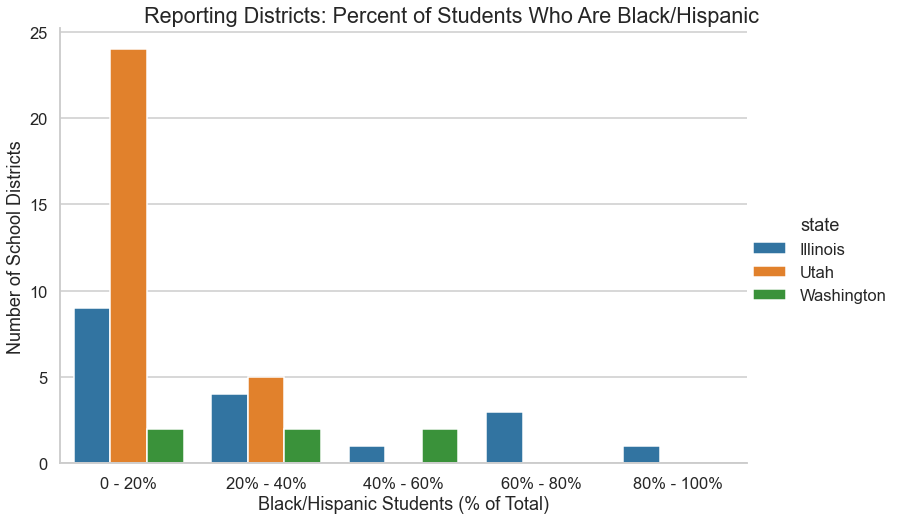

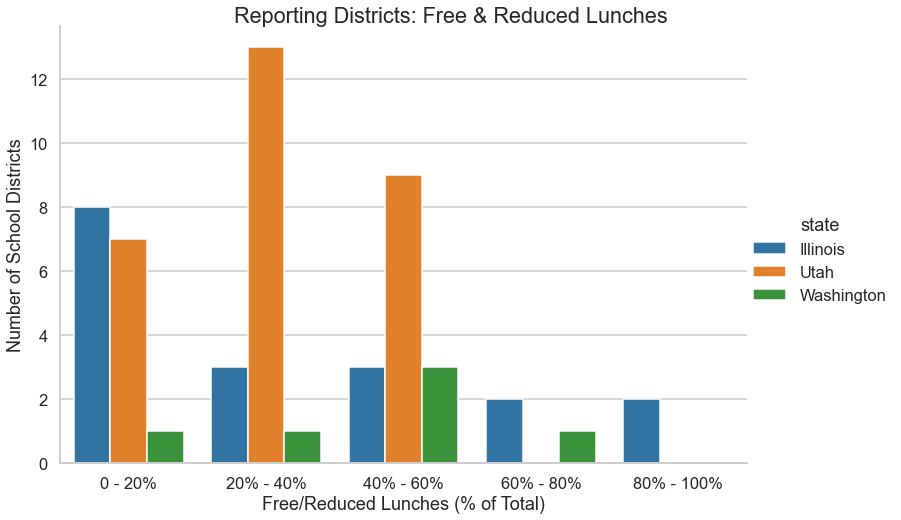

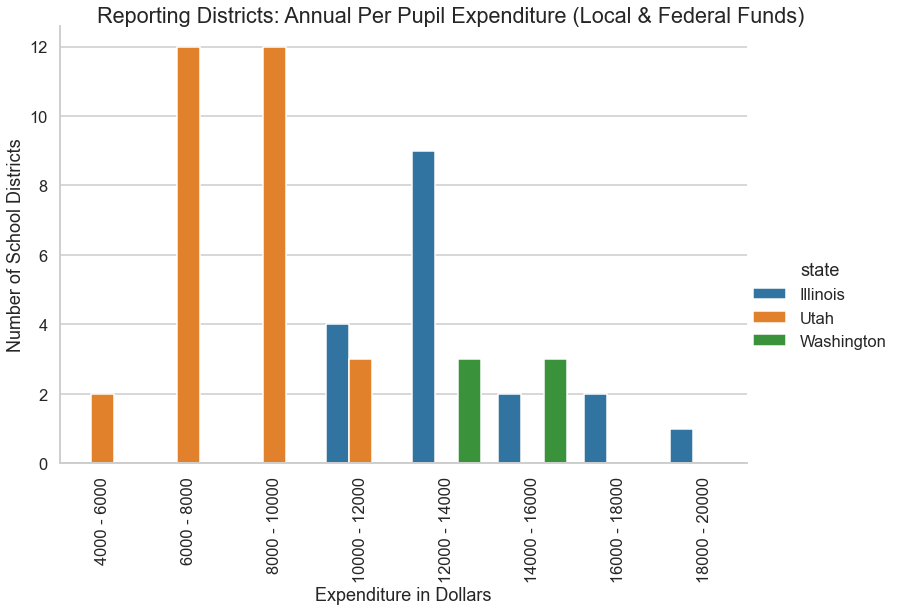

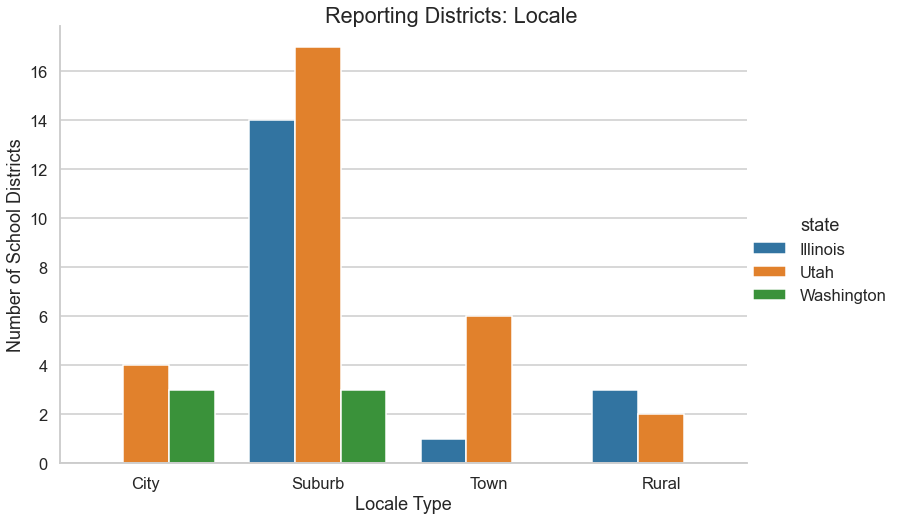

In [44]:
sns.set_style('whitegrid')
g = sns.catplot(x='pct_black_hisp', data = chosen_distmeans, kind='count', hue='state', height = 7, aspect = 1.5)
g.fig.suptitle ('Reporting Districts: Percent of Students Who Are Black/Hispanic', y=1)
g.set(xlabel = 'Black/Hispanic Students (% of Total)',
     ylabel = 'Number of School Districts')
print('       ')
g = sns.catplot(x='pct_freered_lunch', data = chosen_distmeans, kind='count', hue='state', height = 7, aspect = 1.5)
g.fig.suptitle ('Reporting Districts: Free & Reduced Lunches', y=1)
g.set(xlabel = 'Free/Reduced Lunches (% of Total)',
     ylabel = 'Number of School Districts')

g = sns.catplot(x='ann_perpupil_exp', data = chosen_distmeans, kind='count', hue='state', height = 7, aspect = 1.5)
g.fig.suptitle ('Reporting Districts: Annual Per Pupil Expenditure (Local & Federal Funds)', y=1)
g.set(xlabel = 'Expenditure in Dollars',
     ylabel = 'Number of School Districts')
g.set_xticklabels(rotation=90)

g = sns.catplot(x='locale', data = chosen_distmeans, kind='count', hue='state', height = 7, aspect = 1.5)
g.fig.suptitle ('Reporting Districts: Locale', y=1)
g.set(xlabel = 'Locale Type',
     ylabel = 'Number of School Districts')

plt.show()

### Revelations 

First, It's important to remember that Utah has 29 total districts reporting, Illinois has 18, and Washington, 6.  

<b>Still, </b>these three states have full demographic data, unlike Connecticut, which, though it has 30 reporting districts, did not report per pupil spending.  These three states also have contrasting demographics, as the bar graphs above illustrate.  

1.  Utah, with 29 districts reporting, is the least racially diverse, and has lower percentages of free/reduced lunches, but is also the lowest state for per pupil spending--the districts that spend the most in Utah spend as much as the districts that spend the least in Illinois.  


2.  Illinois, with 18 districts reporting, is the most racially and economically diverse, with districts in all five bins in the ethnicity and free lunch metrics.  Illinois also spends the most per pupil annually, with a range of 10K - 20K, in contrast to Utah, which has a range of 4K - 12K.  


3. Washington's 6 districts offer a middle ground between Illinois and Utah--they are more ethnically and economically diverse than Utah, but not at the level of Illinois.  They also spend between 12K - 16K per pupil annually.  


4.  Finally, Utah's districts have the most diversity in locale, with districts in each of the 4 local types.  Illinois is next, and Washington is last.  


These distributions suggest that these three states are ideal for comparing the engagement data; for example, it will be interesting to compare districts from each state that are similar in two or more metrics, to see whether one particular metric is more predictive of engagement patterns.  

#### POSTCODES: The Final Step for the districts and chosen_distmeans dataframes
To make both dataframes easier to subset by state, I'll be adding the POSTCODES column from another source, when I get to it.  It's easier to subset by a two-letter code than a state name, so once I've reached that source I'll add that information to these dataframes.  

<a id="products"></a>

---
# <b>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</b>
---

[Back To Top](#top)
### <u>2. The Products File</u>

In [45]:
lp_products = pd.read_csv('products_info.csv')
lp_products.head(100)

,LP ID,URL,Product Name,Provider/Company Name,Sector(s),Primary Essential Function
0,13117,https://www.splashmath.com,SplashLearn,StudyPad Inc.,PreK-12,LC - Digital Learning Platforms
1,66933,https://abcmouse.com,ABCmouse.com,"Age of Learning, Inc",PreK-12,LC - Digital Learning Platforms
2,50479,https://www.abcya.com,ABCya!,"ABCya.com, LLC",PreK-12,"LC - Sites, Resources & Reference - Games & Si..."
3,92993,http://www.aleks.com/,ALEKS,McGraw-Hill PreK-12,PreK-12; Higher Ed,LC - Digital Learning Platforms
4,73104,https://www.achieve3000.com/,Achieve3000,Achieve3000,PreK-12,LC - Digital Learning Platforms
...,...,...,...,...,...,...
95,65358,http://www.prezi.com,Prezi,Prezi Inc.,PreK-12; Higher Ed; Corporate,LC - Content Creation & Curation
96,64948,https://prodigygame.com/,Prodigy,SMARTeacher Inc.,PreK-12,"LC - Sites, Resources & Reference - Games & Si..."
97,49570,http://www.ptable.com/,Ptable,Michael Dayah,PreK-12; Higher Ed,"LC - Sites, Resources & Reference"
98,23483,http://owl.english.purdue.edu/,Purdue Online Writing Lab,Online Writing Lab,PreK-12; Higher Ed,"LC - Sites, Resources & Reference"


#### Observations
1. The Primary Essential Function column should be parsed so that the two letter code is separate from the remainder.  

2. The url column is probably least helpful and can likely be cut. 

3. Column names can be simplified

In [46]:
lp_products.isna().sum()

LP ID                          0
URL                            0
Product Name                   0
Provider/Company Name          1
Sector(s)                     20
Primary Essential Function    20
dtype: int64

In [47]:
lp_products['Primary Essential Function'].fillna('NO -', inplace=True)
lp_products['Primary Essential Function'].value_counts()

LC - Digital Learning Platforms                                              74
LC - Sites, Resources & Reference                                            47
LC - Content Creation & Curation                                             36
LC - Study Tools                                                             25
NO -                                                                         20
LC - Courseware & Textbooks                                                  18
LC - Sites, Resources & Reference - Games & Simulations                      18
LC/CM/SDO - Other                                                            16
LC - Sites, Resources & Reference - Digital Collection & Repository          15
CM - Classroom Engagement & Instruction - Classroom Management               11
LC - Sites, Resources & Reference - Streaming Services                        9
CM - Virtual Classroom - Video Conferencing & Screen Sharing                  7
LC - Study Tools - Q&A                  

In [48]:
#CREATE A 'CATEGORY' COLUMN
lp_products['category']=''
for i in range(0, len(lp_products)): 
    cat = lp_products.iloc[i]['Primary Essential Function'].split(' -', 1)[0]
    if cat == 'LC':
        lp_products.at[i, 'category'] = 'Learning & Curriculum'
    elif cat == 'CM':
        lp_products.at[i, 'category'] = 'Classroom Management'
    elif cat == 'SDO':
        lp_products.at[i, 'category'] = 'School & District Ops'
    elif cat == 'NO':
        lp_products.at[i, 'category'] = 'Unknown'
    else:
        lp_products.at[i, 'category'] = 'All'
lp_products['category'].value_counts()

Learning & Curriculum    272
Classroom Management      34
School & District Ops     30
Unknown                   20
All                       16
Name: category, dtype: int64

In [49]:
#CREATE A TWO-LETTER 'CATEGORY CODE' ('cat_code')
lp_products['cat_code']=''
for i in range(0, len(lp_products)): 
    cat = lp_products.iloc[i]['Primary Essential Function'].split(' -', 1)[0]
    if cat == 'LC':
        lp_products.at[i, 'cat_code'] = 'LC'
    elif cat == 'CM':
        lp_products.at[i, 'cat_code'] = 'CM'
    elif cat == 'SDO':
        lp_products.at[i, 'cat_code'] = 'SDO'
    elif cat == 'NO':
        lp_products.at[i, 'cat_code'] = 'UNK'
    else:
        lp_products.at[i, 'cat_code'] = 'All'
lp_products.head(20)

,LP ID,URL,Product Name,Provider/Company Name,Sector(s),Primary Essential Function,category,cat_code
0,13117,https://www.splashmath.com,SplashLearn,StudyPad Inc.,PreK-12,LC - Digital Learning Platforms,Learning & Curriculum,LC
1,66933,https://abcmouse.com,ABCmouse.com,"Age of Learning, Inc",PreK-12,LC - Digital Learning Platforms,Learning & Curriculum,LC
2,50479,https://www.abcya.com,ABCya!,"ABCya.com, LLC",PreK-12,"LC - Sites, Resources & Reference - Games & Si...",Learning & Curriculum,LC
3,92993,http://www.aleks.com/,ALEKS,McGraw-Hill PreK-12,PreK-12; Higher Ed,LC - Digital Learning Platforms,Learning & Curriculum,LC
4,73104,https://www.achieve3000.com/,Achieve3000,Achieve3000,PreK-12,LC - Digital Learning Platforms,Learning & Curriculum,LC
5,37600,http://www.activelylearn.com/,Actively Learn,Actively Learn,PreK-12,LC - Digital Learning Platforms,Learning & Curriculum,LC
6,18663,http://www.adaptedmind.com,AdaptedMind,GloWorld,PreK-12,LC - Digital Learning Platforms,Learning & Curriculum,LC
7,65131,http://www.amplify.com/,Amplify,"Amplify Education, Inc.",PreK-12,LC - Courseware & Textbooks,Learning & Curriculum,LC
8,26491,http://www.answers.com/,Answers,Answers,PreK-12; Higher Ed,LC - Study Tools - Q&A,Learning & Curriculum,LC
9,56441,http://www.audible.com,Audible,"Amazon.com, Inc.",PreK-12; Higher Ed; Corporate,"LC - Sites, Resources & Reference - Streaming ...",Learning & Curriculum,LC


### Simplifying the 'Primary Essential Function' column
This column has detailed information about each app or program, but it's too detailed to be of much use for aggregating the engagement data.  Fortunately, the two-letter code gives the GENERAL purpose of each app/program:
* LC - Learning & Curriculum (primarily students, some teacher use)
* CM - Classroom Management (primarily teachers, some admins, some students)
* SDO - School & District Operations (primarily admins, some teachers)
* LC/CM/SDO - all purpose (EVERYONE uses!)
* there were some NaNs, which I changed to 'NO -' (only aliens use these)

These codes are far more helpful for aggregation, and generally point to WHO is the primary user of the program--students, teachers, or administrators (or everyone).  I have used a function to create 'category' and 'cat_code' columns to list this info in more usable form.  Now we can determine a bit more easily the number of apps in each category.  

In [50]:
lp_products.cat_code.value_counts()

LC     272
CM      34
SDO     30
UNK     20
All     16
Name: cat_code, dtype: int64

<b>I have questions about the unknowns though.  Maybe it's easy to determine their purpose.  </b>

In [51]:
lp_products.loc[lp_products.cat_code == 'UNK']

,LP ID,URL,Product Name,Provider/Company Name,Sector(s),Primary Essential Function,category,cat_code
61,33562,http://www.ixl.com/,IXL Language,IXL Learning,NaN,NO -,Unknown,UNK
146,83394,https://www.yelp.com/,Yelp,"Yelp, Inc",NaN,NO -,Unknown,UNK
158,63178,http://www.learnplatform.com/,LearnPlatform,Lea(R)n,NaN,NO -,Unknown,UNK
174,32340,http://genius.com/static/education,Education Genius,Genius Media Group,NaN,NO -,Unknown,UNK
183,85991,http://www.microsoft.com/en-us/education/produ...,Microsoft Office 365,Microsoft,NaN,NO -,Unknown,UNK
210,37891,http://www.classzone.com/cz/index.htm,ClassZone,Houghton Mifflin Harcourt,NaN,NO -,Unknown,UNK
237,45716,http://student.classdojo.com/#/login,ClassDojo for Students,"ClassDojo, Inc.",NaN,NO -,Unknown,UNK
248,53775,https://play.google.com/music/listen?u=0#/sulp,Google Play Music,Google LLC,NaN,NO -,Unknown,UNK
262,45811,https://sciencejournal.withgoogle.com/,Google Science Journal,Google LLC,NaN,NO -,Unknown,UNK
265,84099,https://edutrainingcenter.withgoogle.com/,Google Training Center,Google LLC,NaN,NO -,Unknown,UNK


#### Impressions
I think it will be fairly easy to determine the proper categories for these, but time is also a factor.  If I can do it quickly, I will. I will first convert the apps that are expressly NOT LC--and the remaining UNK can then be switched to LC

In [52]:
sdo_list = [158, 265]
all_list = [183, 248, 305, 314]

for i in sdo_list:
    lp_products.at[i, 'category'] = 'School & District Operations'
    lp_products.at[i, 'cat_code'] = 'SDO'
for i in all_list: 
    lp_products.at[i, 'category'] = 'LC/CM/SDO'
    lp_products.at[i, 'cat_code'] = 'All'
print(lp_products.iloc[sdo_list])
print(lp_products.iloc[all_list])

     LP ID                                        URL            Product Name  \
158  63178              http://www.learnplatform.com/           LearnPlatform   
265  84099  https://edutrainingcenter.withgoogle.com/  Google Training Center   

    Provider/Company Name Sector(s) Primary Essential Function  \
158               Lea(R)n       NaN                       NO -   
265            Google LLC       NaN                       NO -   

                         category cat_code  
158  School & District Operations      SDO  
265  School & District Operations      SDO  
     LP ID                                                URL  \
183  85991  http://www.microsoft.com/en-us/education/produ...   
248  53775     https://play.google.com/music/listen?u=0#/sulp   
305  53399                 https://spark.adobe.com/about/page   
314  87762  https://chrome.google.com/webstore/detail/gram...   

             Product Name Provider/Company Name Sector(s)  \
183  Microsoft Office 365          

In [53]:
#OOPS, for the 'All category I actually just used 'All' in both columns.  
for i in all_list: 
    lp_products.at[i, 'category'] = 'All'

Now to change the remaining unknowns to 'LC', 'Learning & Curriculum'  

In [54]:
for i in range (0, len(lp_products)):
    if lp_products.iloc[i].cat_code == 'UNK':
        lp_products.at[i, 'category'] = 'Learning & Curriculum'
        lp_products.at[i, 'cat_code'] = 'LC'

In [55]:
lp_products.cat_code.value_counts()

LC     286
CM      34
SDO     32
All     20
Name: cat_code, dtype: int64

In [56]:
#RENAME THOSE AWKWARD COLUMNS
lp_products = lp_products.rename({'LP ID': 'lp_id', 'URL':'url', 'Product Name':'prod_name', 'Provider/Company Name':'company', 'Sector(s)':'sectors', 'Primary Essential Function':'function'}, axis='columns')
lp_products.head(3)

,lp_id,url,prod_name,company,sectors,function,category,cat_code
0,13117,https://www.splashmath.com,SplashLearn,StudyPad Inc.,PreK-12,LC - Digital Learning Platforms,Learning & Curriculum,LC
1,66933,https://abcmouse.com,ABCmouse.com,"Age of Learning, Inc",PreK-12,LC - Digital Learning Platforms,Learning & Curriculum,LC
2,50479,https://www.abcya.com,ABCya!,"ABCya.com, LLC",PreK-12,"LC - Sites, Resources & Reference - Games & Si...",Learning & Curriculum,LC


In [57]:
#CREATE A STREAMLINED VERSION WITH MOST RELEVANT/USEFUL DATA
lp_product_cats = lp_products.loc[:, ['lp_id', 'prod_name', 'company', 'category', 'cat_code']]

In [58]:
lp_product_cats.head()

,lp_id,prod_name,company,category,cat_code
0,13117,SplashLearn,StudyPad Inc.,Learning & Curriculum,LC
1,66933,ABCmouse.com,"Age of Learning, Inc",Learning & Curriculum,LC
2,50479,ABCya!,"ABCya.com, LLC",Learning & Curriculum,LC
3,92993,ALEKS,McGraw-Hill PreK-12,Learning & Curriculum,LC
4,73104,Achieve3000,Achieve3000,Learning & Curriculum,LC


#### THE PRODUCTS DATAFRAMES ( `lp_products` & `lp_product_cats` ) ARE NOW MORE USER-FRIENDLY.  
<a id="policy"></a>

---
# <b>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</b>
---

[Back To Top](#top)
### <u>3. The State COVID Policy Data</u>
This file contains dates on which important policy changes relativing to COVID occurred for all 50 states and DC.  This data can now be subset by the states list from the 'districts' df.  It will also need further subsetting, to a much shorter list of dates relevant to this inquiry.  

In [59]:
state_policy_dates = pd.read_excel('COVID-19 US state policy database 8_27_2021.xlsx')

In [60]:
state_policy_dates.head(10)

,STATE,POSTCODE,FIPS,STEMERG,STEMERGEND,STEMERG2,CLSCHOOL,CLDAYCR,OPNCLDCR,CLNURSHM,...,MINWAGEMAR2019,MINWAGEJUL2019,MINWAGEOCT2019,MINWAGEJAN2020,MINWAGEJUL2020,MINWAGESEP2020,MINWAGEOCT2020,TIPMINWAGE2020,MINWAGE2021,SMALLBUSMINWAGE
0,State,State Abbreviation,FIPS Code,State of emergency issued,State of emergency lifted,State of emergency reinstated,Date closed K-12 public schools,Closed day cares,Reopen day cares,Date banned visitors to nursing homes,...,Mar 29 2019 Minimum Wage,Jul 1 2019 Minimum Wage,Oct 1 2019 Minimum Wage,Jan 1 2020 Minimum Wage,Jul 1 2020 Minimum Wage,Sep 1 2020 Minimum Wage,Oct 1 2020 Minimum Wage,2020 Minimum Wage for Tipped Workers,2021 Minimum Wage,Different Minimum Wage for Smaller Businesses
1,category,NaN,NaN,state_of_emergency,state_of_emergency,state_of_emergency,physical_distance_closure,physical_distance_closure,Reopening,physical_distance_closure,...,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage
2,type,note,note,start,end,start,start,start,end,start,...,quantity,quantity,quantity,quantity,quantity,quantity,quantity,quantity,quantity,attribute
3,unit,text,attribute,date,date,date,date,date,date,date,...,dollars,dollars,dollars,dollars,dollars,dollars,dollars,dollars,dollars,flag
4,Alabama,AL,1,2020-03-13 00:00:00,2021-07-06 00:00:00,2021-08-13 00:00:00,2020-03-20 00:00:00,2020-03-20 00:00:00,2020-05-23 00:00:00,2020-03-19 00:00:00,...,7.25,7.25,7.25,7.25,7.25,7.25,7.25,2.13,7.25,0
5,Alaska,AK,2,2020-03-11 00:00:00,2021-04-30 00:00:00,0,2020-03-16 00:00:00,0,0,0,...,9.89,9.89,9.89,10.19,10.19,10.19,10.19,10.19,10.34,0
6,Arizona,AZ,4,2020-03-11 00:00:00,0,0,2020-03-16 00:00:00,0,0,0,...,11,11,11,12,12,12,12,9,12.15,0
7,Arkansas,AR,5,2020-03-11 00:00:00,2021-05-30 00:00:00,2021-07-29 00:00:00,2020-03-17 00:00:00,0,0,2020-03-13 00:00:00,...,9.25,9.25,9.25,10,10,10,10,2.63,11,1
8,California,CA,6,2020-03-04 00:00:00,0,0,2020-03-23 00:00:00,0,0,0,...,12,12,12,13,13,13,13,13,14,1
9,Colorado,CO,8,2020-03-11 00:00:00,2021-07-08 00:00:00,0,2020-03-23 00:00:00,0,0,2020-03-12 00:00:00,...,11.1,11.1,11.1,12,12,12,12,8.98,12.32,1


The first 4 rows of this dataset are identifiers that may not be entirely useful, and will also make it more difficult to subset the data easily.  The first row DOES give a full explanation of what the column names mean, which could be useful; however, there is a separate Code Book file that correlates the abbreviated column names with what they mean, so it will probably be best to delete rows indexed 0-3.  
    
Here are the steps I'll take to prepare this file: 
1. Delete rows 0-3
2. Use states dataframe to subset the file for states with data from LearnPlatform
3. Further subset to a much smaller number of columns with dates relevant to inquiry  
  

Here are the data columns I'm going to keep: 
* STATE
* POSTCODE
* CLSCHOOL - date state closed k-12 schools
* STAYHOME - start date of shelter-in-place (SIP)
* END_STHM - SIP ends
* CLBSNS - date non-essential businesses closed
* END_BSNS - reopening date 
* EMSTART - eviction moratorium starts
* EMEND - EM ends
* EMSTART2 - 2nd EM starts
* EMEND2 - 2nd EM ends
* EMSTART3 - 3rd EM starts
* EMEND3 - 3rd EM ends
* C19START - date state prohibition of eviction process begins
* C19END - state prohibition lifted

This reduces the dataframe from 285 to 16 columns.  

In [61]:
state_policy_dates.STATE.unique() # 'of' in 'District of Columbia' is not capitalized--good! 

array(['State', 'category', 'type', 'unit', 'Alabama', 'Alaska',
       'Arizona', 'Arkansas', 'California', 'Colorado', 'Connecticut',
       'Delaware', 'District of Columbia', 'Florida', 'Georgia', 'Hawaii',
       'Idaho', 'Illinois', 'Indiana', 'Iowa', 'Kansas', 'Kentucky',
       'Louisiana', 'Maine', 'Maryland', 'Massachusetts', 'Michigan',
       'Minnesota', 'Mississippi', 'Missouri', 'Montana', 'Nebraska',
       'Nevada', 'New Hampshire', 'New Jersey', 'New Mexico', 'New York',
       'North Carolina', 'North Dakota', 'Ohio', 'Oklahoma', 'Oregon',
       'Pennsylvania', 'Rhode Island', 'South Carolina', 'South Dakota',
       'Tennessee', 'Texas', 'Utah', 'Vermont', 'Virginia', 'Washington',
       'West Virginia', 'Wisconsin', 'Wyoming'], dtype=object)

In [62]:
policy_df = states.merge(state_policy_dates, how='left', left_on = 'state', right_on='STATE')

In [63]:
policy_df.head(10)

,state,STATE,POSTCODE,FIPS,STEMERG,STEMERGEND,STEMERG2,CLSCHOOL,CLDAYCR,OPNCLDCR,...,MINWAGEMAR2019,MINWAGEJUL2019,MINWAGEOCT2019,MINWAGEJAN2020,MINWAGEJUL2020,MINWAGESEP2020,MINWAGEOCT2020,TIPMINWAGE2020,MINWAGE2021,SMALLBUSMINWAGE
0,Illinois,Illinois,IL,17,2020-03-09 00:00:00,0,0,2020-03-17 00:00:00,2020-03-23 00:00:00,2020-05-29 00:00:00,...,8.25,8.25,8.25,9.25,10,10,10,6,11,1
1,Utah,Utah,UT,49,2020-03-06 00:00:00,0,0,2020-03-16 00:00:00,0,0,...,7.25,7.25,7.25,7.25,7.25,7.25,7.25,2.13,7.25,0
2,Wisconsin,Wisconsin,WI,55,2020-03-12 00:00:00,0,0,2020-03-18 00:00:00,0,0,...,7.25,7.25,7.25,7.25,7.25,7.25,7.25,2.33,7.25,0
3,North Carolina,North Carolina,NC,37,2020-03-10 00:00:00,0,0,2020-03-16 00:00:00,0,0,...,7.25,7.25,7.25,7.25,7.25,7.25,7.25,2.13,7.25,0
4,Missouri,Missouri,MO,29,2020-03-13 00:00:00,0,0,2020-03-23 00:00:00,0,0,...,8.6,8.6,8.6,9.45,9.45,9.45,9.45,4.73,10.3,1
5,Washington,Washington,WA,53,2020-02-29 00:00:00,0,0,2020-03-17 00:00:00,0,0,...,12,12,12,13.5,13.5,13.5,13.5,13.5,13.69,0
6,Connecticut,Connecticut,CT,9,2020-03-10 00:00:00,0,0,2020-03-17 00:00:00,0,0,...,10.1,10.1,11,11,11,12,12,6.38,12,0
7,Massachusetts,Massachusetts,MA,25,2020-03-10 00:00:00,2021-06-15 00:00:00,0,2020-03-17 00:00:00,2020-03-23 00:00:00,2020-06-08 00:00:00,...,12,12,12,12.75,12.75,12.75,12.75,4.95,13.5,0
8,New York,New York,NY,36,2020-03-07 00:00:00,2021-06-25 00:00:00,0,2020-03-18 00:00:00,0,0,...,11.1,11.1,11.1,11.8,11.8,11.8,11.8,7.85,12.5,0
9,Indiana,Indiana,IN,18,2020-03-06 00:00:00,0,0,2020-03-20 00:00:00,0,0,...,7.25,7.25,7.25,7.25,7.25,7.25,7.25,2.13,7.25,1


<b>TRIM</b> time: Now the df will be trimmed to just the columns above, and postcode set as the index. 

In [64]:
C19_policy_dates = policy_df[['STATE', 'POSTCODE', 'CLSCHOOL', 'STAYHOME', 'END_STHM', 'CLBSNS', 'END_BSNS', 'EMSTART', 'EMEND', 'EMSTART2', 'EMEND2', 'EMSTART3', 'EMEND3', 'C19START', 'C19END']]
C19_policy_dates.set_index('POSTCODE', inplace=True)
C19_policy_dates.sort_index()

,STATE,CLSCHOOL,STAYHOME,END_STHM,CLBSNS,END_BSNS,EMSTART,EMEND,EMSTART2,EMEND2,EMSTART3,EMEND3,C19START,C19END
POSTCODE,,,,,,,,,,,,,,
AZ,Arizona,2020-03-16 00:00:00,2020-03-31 00:00:00,2020-05-16 00:00:00,2020-03-31 00:00:00,2020-05-08 00:00:00,2020-03-24 00:00:00,2020-10-31 00:00:00,0,0,0,0,2020-03-24 00:00:00,2020-10-31 00:00:00
CA,California,2020-03-23 00:00:00,2020-03-19 00:00:00,2021-01-25 00:00:00,2020-03-19 00:00:00,2020-05-08 00:00:00,2020-03-27 00:00:00,0,0,0,0,0,2020-03-27 00:00:00,2020-06-01 00:00:00
CT,Connecticut,2020-03-17 00:00:00,0,2020-05-20 00:00:00,2020-03-23 00:00:00,2020-05-20 00:00:00,2020-03-16 00:00:00,^,0,0,0,0,0,0
DC,District of Columbia,2020-03-16 00:00:00,2020-04-01 00:00:00,2020-05-29 00:00:00,2020-03-25 00:00:00,2020-05-29 00:00:00,2020-03-15 00:00:00,^,0,0,0,0,0,0
FL,Florida,2020-03-17 00:00:00,2020-04-03 00:00:00,2020-05-18 00:00:00,2020-04-03 00:00:00,2020-05-18 00:00:00,2020-04-02 00:00:00,2020-10-01 00:00:00,0,0,0,0,2020-07-29 00:00:00,2020-10-01 00:00:00
IL,Illinois,2020-03-17 00:00:00,2020-03-21 00:00:00,2020-05-29 00:00:00,2020-03-21 00:00:00,2020-05-29 00:00:00,2020-03-21 00:00:00,0,0,0,0,0,2020-11-13 00:00:00,0
IN,Indiana,2020-03-20 00:00:00,2020-03-25 00:00:00,2020-05-18 00:00:00,2020-03-25 00:00:00,2020-05-18 00:00:00,2020-03-19 00:00:00,2020-08-15 00:00:00,0,0,0,0,0,0
MA,Massachusetts,2020-03-17 00:00:00,2020-03-24 00:00:00,2020-05-18 00:00:00,2020-03-24 00:00:00,2020-05-18 00:00:00,2020-03-13 00:00:00,2020-10-18 00:00:00,2020-12-31 00:00:00,^,0,0,0,0
MI,Michigan,2020-03-16 00:00:00,2020-03-24 00:00:00,2020-06-01 00:00:00,2020-03-24 00:00:00,2020-05-26 00:00:00,2020-03-20 00:00:00,2020-07-16 00:00:00,0,0,0,0,0,0


### Turning C19_policy_dates inside out

Having dates as an index, states across the top, and the codes as data would allow 
* Melding with other time-series data
* Subsetting specific codes by state.  

This can be accomplished by melting and then pivoting, I believe.  

In [65]:
C19_policy_dates = C19_policy_dates.reset_index()
state_covid_dates = C19_policy_dates.melt(id_vars=['POSTCODE', 'STATE'], var_name=['pol_code'], value_name='date')
state_covid_dates.head(10)

,POSTCODE,STATE,pol_code,date
0,IL,Illinois,CLSCHOOL,2020-03-17 00:00:00
1,UT,Utah,CLSCHOOL,2020-03-16 00:00:00
2,WI,Wisconsin,CLSCHOOL,2020-03-18 00:00:00
3,NC,North Carolina,CLSCHOOL,2020-03-16 00:00:00
4,MO,Missouri,CLSCHOOL,2020-03-23 00:00:00
5,WA,Washington,CLSCHOOL,2020-03-17 00:00:00
6,CT,Connecticut,CLSCHOOL,2020-03-17 00:00:00
7,MA,Massachusetts,CLSCHOOL,2020-03-17 00:00:00
8,NY,New York,CLSCHOOL,2020-03-18 00:00:00
9,IN,Indiana,CLSCHOOL,2020-03-20 00:00:00


#### The 'date' column
Before I can make the date column into datetime type, I need to check for unusual values.  

In [66]:
state_covid_dates.date

0      2020-03-17 00:00:00
1      2020-03-16 00:00:00
2      2020-03-18 00:00:00
3      2020-03-16 00:00:00
4      2020-03-23 00:00:00
              ...         
294                      0
295    2020-10-01 00:00:00
296                      0
297                      0
298                      0
Name: date, Length: 299, dtype: object

In [67]:
state_covid_dates.drop(state_covid_dates.loc[state_covid_dates['date']==0].index, inplace=True)
state_covid_dates.date #there are some carats(^) in the data too

0      2020-03-17 00:00:00
1      2020-03-16 00:00:00
2      2020-03-18 00:00:00
3      2020-03-16 00:00:00
4      2020-03-23 00:00:00
              ...         
277    2020-05-16 00:00:00
284                      ^
289    2020-06-01 00:00:00
292    2020-10-31 00:00:00
295    2020-10-01 00:00:00
Name: date, Length: 163, dtype: object

In [68]:
#df.drop(df.loc[df['line_race']==0].index, inplace=True)
state_covid_dates.drop(state_covid_dates.loc[state_covid_dates['date']=='^'].index, inplace=True)

In [69]:
state_covid_dates.sort_values(['POSTCODE', 'date'], ignore_index=True, inplace=True)
state_covid_dates.head(20)

,POSTCODE,STATE,pol_code,date
0,AZ,Arizona,CLSCHOOL,2020-03-16 00:00:00
1,AZ,Arizona,EMSTART,2020-03-24 00:00:00
2,AZ,Arizona,C19START,2020-03-24 00:00:00
3,AZ,Arizona,STAYHOME,2020-03-31 00:00:00
4,AZ,Arizona,CLBSNS,2020-03-31 00:00:00
5,AZ,Arizona,END_BSNS,2020-05-08 00:00:00
6,AZ,Arizona,END_STHM,2020-05-16 00:00:00
7,AZ,Arizona,EMEND,2020-10-31 00:00:00
8,AZ,Arizona,C19END,2020-10-31 00:00:00
9,CA,California,STAYHOME,2020-03-19 00:00:00


In [70]:
smaller_dates = state_covid_dates.drop('STATE', axis='columns')
smaller_dates.head()

,POSTCODE,pol_code,date
0,AZ,CLSCHOOL,2020-03-16 00:00:00
1,AZ,EMSTART,2020-03-24 00:00:00
2,AZ,C19START,2020-03-24 00:00:00
3,AZ,STAYHOME,2020-03-31 00:00:00
4,AZ,CLBSNS,2020-03-31 00:00:00


In [71]:
#df1 = df.pivot_table(index='name',columns='window_num',values='channel', aggfunc=','.join)
state_c19_dates = smaller_dates.pivot_table(index='date', columns='POSTCODE', values='pol_code', aggfunc=', '.join)
state_c19_dates.head(20)

POSTCODE,AZ,CA,CT,DC,FL,IL,IN,MA,MI,MN,...,NH,NJ,NY,OH,TN,TX,UT,VA,WA,WI
date,,,,,,,,,,,,,,,,,,,,,
2020-03-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,EMSTART,NaN,NaN,...,NaN,NaN,NaN,NaN,EMSTART,NaN,NaN,NaN,NaN,NaN
2020-03-15,NaN,NaN,NaN,EMSTART,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-03-16,CLSCHOOL,NaN,EMSTART,CLSCHOOL,NaN,NaN,NaN,NaN,CLSCHOOL,EMSTART,...,CLSCHOOL,EMSTART,EMSTART,NaN,NaN,NaN,CLSCHOOL,"CLSCHOOL, EMSTART",NaN,NaN
2020-03-17,NaN,NaN,CLSCHOOL,NaN,CLSCHOOL,CLSCHOOL,NaN,CLSCHOOL,NaN,NaN,...,EMSTART,NaN,NaN,CLSCHOOL,NaN,NaN,NaN,NaN,CLSCHOOL,NaN
2020-03-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CLSCHOOL,...,NaN,CLSCHOOL,CLSCHOOL,NaN,NaN,NaN,NaN,NaN,EMSTART,CLSCHOOL
2020-03-19,NaN,"STAYHOME, CLBSNS",NaN,NaN,NaN,NaN,EMSTART,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,EMSTART,NaN,NaN,NaN,NaN
2020-03-20,NaN,NaN,NaN,NaN,NaN,NaN,CLSCHOOL,NaN,EMSTART,NaN,...,NaN,NaN,NaN,NaN,CLSCHOOL,NaN,NaN,NaN,NaN,NaN
2020-03-21,NaN,NaN,NaN,NaN,NaN,"STAYHOME, CLBSNS, EMSTART",NaN,NaN,NaN,NaN,...,NaN,"STAYHOME, CLBSNS",NaN,NaN,NaN,CLSCHOOL,NaN,NaN,NaN,NaN
2020-03-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,"STAYHOME, CLBSNS",NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### MISSION ACCOMPLISHED
state_c19_dates is now time-series data, with all information needed.  

#### INTERLUDE: Adding postcodes to the states list and districts dfs
Since the state_covid_dates df has both states and postcodes, I can create this list from here--and then add postcodes to the districts dfs too, for easier subsetting by state. 

In [72]:
pcode_state = state_covid_dates[['POSTCODE', 'STATE']].drop_duplicates(subset='POSTCODE')
pcode_state.head()

,POSTCODE,STATE
0,AZ,Arizona
9,CA,California
17,CT,Connecticut
22,DC,District of Columbia
28,FL,Florida


In [73]:
pcode_state = pcode_state.reset_index(drop=True)
pcode_state

,POSTCODE,STATE
0,AZ,Arizona
1,CA,California
2,CT,Connecticut
3,DC,District of Columbia
4,FL,Florida
5,IL,Illinois
6,IN,Indiana
7,MA,Massachusetts
8,MI,Michigan
9,MN,Minnesota


In [74]:
districts.head()

,district_id,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
0,9007,Arizona,City,80% - 100%,NaN,NaN
1,3412,California,City,60% - 80%,40% - 60%,NaN
2,2321,California,Rural,0 - 20%,0 - 20%,NaN
3,2106,California,Suburb,20% - 40%,0 - 20%,NaN
4,2074,California,Suburb,40% - 60%,20% - 40%,NaN


In [75]:
districts = districts.merge(pcode_state, how='inner', left_on='state', right_on='STATE')
districts.head()

,district_id,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp,POSTCODE,STATE
0,9007,Arizona,City,80% - 100%,NaN,NaN,AZ,Arizona
1,3412,California,City,60% - 80%,40% - 60%,NaN,CA,California
2,2321,California,Rural,0 - 20%,0 - 20%,NaN,CA,California
3,2106,California,Suburb,20% - 40%,0 - 20%,NaN,CA,California
4,2074,California,Suburb,40% - 60%,20% - 40%,NaN,CA,California


In [76]:
districts = districts[['district_id', 'POSTCODE', 'state', 'locale', 'pct_black_hisp', 'pct_freered_lunch', 'ann_perpupil_exp']]
#districts.head()

In [77]:
districts.shape

(176, 7)

In [78]:
chosen_distmeans.head()

,district_id,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
47,1052,Illinois,Suburb,20% - 40%,20% - 40%,16000 - 18000
48,2285,Illinois,Suburb,0 - 20%,40% - 60%,12000 - 14000
49,9553,Illinois,Suburb,0 - 20%,0 - 20%,14000 - 16000
50,5042,Illinois,Town,20% - 40%,80% - 100%,10000 - 12000
51,3248,Illinois,Suburb,60% - 80%,60% - 80%,12000 - 14000


In [79]:
chosen_distmeans = chosen_distmeans.merge(pcode_state, how='inner', left_on='state', right_on='STATE')

In [80]:
chosen_distmeans = chosen_distmeans[['district_id', 'POSTCODE', 'state', 'locale', 'pct_black_hisp', 'pct_freered_lunch', 'ann_perpupil_exp']]

In [81]:
chosen_distmeans = chosen_distmeans.sort_values('POSTCODE', ignore_index=True)

In [82]:
state_c19_dates = state_c19_dates.reset_index() # just wanted to check if the date column was datetime, and it is!

[Back To Top](#top)
<a id="codelist"></a>
#### WHAT DO THE CODES IN THE STATE COVID DATES DF MEAN?  
For labeling purposes in visualizations, I will need to correlate these codes with descriptions. Creating a separate dataframe with these correlations is my strategy.    

In [83]:
pcodes = pcode_state.POSTCODE.tolist()

In [84]:
code_list = []
for pc in pcodes:
    list = state_c19_dates[pc].tolist()
    list = [x for x in list if str(x) != 'nan']
    code_list.append(list)
code_list

[['CLSCHOOL',
  'EMSTART, C19START',
  'STAYHOME, CLBSNS',
  'END_BSNS',
  'END_STHM',
  'EMEND, C19END'],
 ['STAYHOME, CLBSNS',
  'CLSCHOOL',
  'EMSTART, C19START',
  'END_BSNS',
  'C19END',
  'END_STHM'],
 ['EMSTART', 'CLSCHOOL', 'CLBSNS', 'END_STHM, END_BSNS'],
 ['EMSTART', 'CLSCHOOL', 'CLBSNS', 'STAYHOME', 'END_STHM, END_BSNS'],
 ['CLSCHOOL',
  'EMSTART',
  'STAYHOME, CLBSNS',
  'END_STHM, END_BSNS',
  'C19START',
  'EMEND, C19END'],
 ['CLSCHOOL', 'STAYHOME, CLBSNS, EMSTART', 'END_STHM, END_BSNS', 'C19START'],
 ['EMSTART', 'CLSCHOOL', 'STAYHOME, CLBSNS', 'END_STHM, END_BSNS', 'EMEND'],
 ['EMSTART',
  'CLSCHOOL',
  'STAYHOME, CLBSNS',
  'END_STHM, END_BSNS',
  'EMEND',
  'EMSTART2'],
 ['CLSCHOOL', 'EMSTART', 'STAYHOME, CLBSNS', 'END_BSNS', 'END_STHM', 'EMEND'],
 ['EMSTART', 'CLSCHOOL', 'STAYHOME, CLBSNS', 'END_BSNS', 'END_STHM'],
 ['CLSCHOOL', 'CLBSNS', 'STAYHOME', 'END_STHM, END_BSNS'],
 ['CLSCHOOL, EMSTART',
  'STAYHOME, CLBSNS',
  'END_BSNS',
  'END_STHM',
  'EMEND',
  'EMSTART2'

In [85]:
code_list = pd.Series(code_list)

#s = s.apply(pd.Series).stack().reset_index(drop = True)
code_list = code_list.apply(pd.Series).stack().reset_index(drop=True)

code_list.drop_duplicates(inplace=True)
#code_list.reset_index()

code_list.reset_index(drop=True, inplace=True)
code_list

0                      CLSCHOOL
1             EMSTART, C19START
2              STAYHOME, CLBSNS
3                      END_BSNS
4                      END_STHM
5                 EMEND, C19END
6                        C19END
7                       EMSTART
8                        CLBSNS
9            END_STHM, END_BSNS
10                     STAYHOME
11                     C19START
12    STAYHOME, CLBSNS, EMSTART
13                        EMEND
14                     EMSTART2
15            CLSCHOOL, EMSTART
16                       EMEND2
17                     EMSTART3
18                       EMEND3
dtype: object

In [86]:
code_list = pd.DataFrame(code_list)
code_list['definition']= ['Schools Close', 
                          'Evictions Halted (EH)', 
                          'Shelter In Place (SIP), Businesses Close', 
                          'Businesses Re-open', 
                          'Shelter In Place ends', 
                          'Evictions Resume', 
                          'Evictions Resume', 
                          'Evictions Halted (EH)',
                          'Businesses Close', 
                          'SIP Ends, Businesses Re-open', 
                          'Shelter In Place (SIP)', 
                          'Ev. Proceedings Halted', 
                          'Shelter In Place, Businesses Close, Evictions Halted', 
                          'Evictions Resume', 
                          '2nd EH Begins', 
                          'Schools Close, Evictions Halted (EH)', 
                          '2nd EH Ends', 
                          '3rd EH Begins',
                          '3rd EH Ends']
code_list

,0,definition
0,CLSCHOOL,Schools Close
1,"EMSTART, C19START",Evictions Halted (EH)
2,"STAYHOME, CLBSNS","Shelter In Place (SIP), Businesses Close"
3,END_BSNS,Businesses Re-open
4,END_STHM,Shelter In Place ends
5,"EMEND, C19END",Evictions Resume
6,C19END,Evictions Resume
7,EMSTART,Evictions Halted (EH)
8,CLBSNS,Businesses Close
9,"END_STHM, END_BSNS","SIP Ends, Businesses Re-open"


#### WHY THE APPARENT REDUNDANCIES? 
To account for the fact that some states enacted multiple policies on the same date, the code column ('0') has all the instances in which this occurred for the states in the districts file.  

For example, several states halted evictions (EMSTART) and stopped legal eviction proceedings (C19START) on the same date, whereas other states did not.  Having an entry for the combination of several codes as well as individual entries for each code will facilitate labelling graphs with the appropriate definitions for these codes without having to iterate to gather multiple definitions for a single date.

This will all become clearer when the engagement data is plotted together with the dates in the state_c19_dates.  

In [87]:
code_list.rename(columns = {0:'code'}, inplace=True)
code_list.head(3)

,code,definition
0,CLSCHOOL,Schools Close
1,"EMSTART, C19START",Evictions Halted (EH)
2,"STAYHOME, CLBSNS","Shelter In Place (SIP), Businesses Close"


In [88]:
#corrects a capitalization error
code_list.definition = code_list.definition.replace({'Shelter In Place ends':'Shelter In Place Ends'})

In [89]:
#code_list
code_list.shape

(19, 2)

### The State COVID-19 Policy Data should be usable at this point.  

<a id="kidscount"></a>  

---
# <b>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</b>
---

[Back To Top](#top)
### <u> 4. The Kids Count Statistics</u>
The Kids Count statistics that seem most relevant to this project are measured as weekly percentages for various ethnicities, and include: 
* Households with schoolchildren that lost income due to COVID.  
* Households with access to both a computer/device and a high speed connection, specifically for educational purposes.
* Households with schoolchildren that experienced a change in education venue or method, as follows: 
    * Classes Cancelled
    * Online Distance Learning
    * Paper Distance Learning
    * Schools Open 
    * Other (classes change in some other way)

It is easier to break this final measurement into five separate statistics, with separate measurements for various ethnicities.  

I also initially chose two additional measurements: households with access to EITHER a high speed connection OR a computer/device specifically for educational purposes; of these two, the high speed access revealed itself to be more important; however, neither of these were as significant as the measurement for household access to both--so I am omitting them here.  

Because all this data is structured similarly, I will demonstrate how I prepared it using the lost income data. 
<a id="incloss"></a>

[Back To Top](#top)
### The Income Loss Data 

In [90]:
lost_income = pd.read_excel('Lost income RE.xlsx')

In [91]:
lost_income.head(10)

,LocationType,Location,Race Group,TimeFrame,DataFormat,Data
0,Nation,United States,Total,"Apr 23-May 12, 2020",Percent,0.51
1,Nation,United States,Asian,"Apr 23-May 12, 2020",Percent,0.52
2,Nation,United States,Black or African American,"Apr 23-May 12, 2020",Percent,0.55
3,Nation,United States,Hispanic or Latino,"Apr 23-May 12, 2020",Percent,0.59
4,Nation,United States,Two or more races/ Other race,"Apr 23-May 12, 2020",Percent,0.61
5,Nation,United States,Non-Hispanic White,"Apr 23-May 12, 2020",Percent,0.47
6,Nation,United States,Non-Hispanic White,"May 7-May 19, 2020",Percent,0.47
7,Nation,United States,Two or more races/ Other race,"May 7-May 19, 2020",Percent,0.6
8,Nation,United States,Hispanic or Latino,"May 7-May 19, 2020",Percent,0.61
9,Nation,United States,Black or African American,"May 7-May 19, 2020",Percent,0.58


In [92]:
lost_income.shape

(7488, 6)

Each of these stats are measured both at the national AND state levels.  An easy way to filter for just the states in the districts file is to merge it with pcode_state.  

In [93]:
lost_income.Location.value_counts()

Arkansas                144
Maine                   144
Pennsylvania            144
California              144
Virginia                144
Maryland                144
Kentucky                144
Massachusetts           144
Alabama                 144
Rhode Island            144
North Dakota            144
Colorado                144
Nevada                  144
New Hampshire           144
West Virginia           144
Tennessee               144
Florida                 144
Iowa                    144
Illinois                144
Texas                   144
Louisiana               144
Mississippi             144
Arizona                 144
Washington              144
Missouri                144
Indiana                 144
New Mexico              144
Wyoming                 144
Kansas                  144
Montana                 144
District of Columbia    144
Nebraska                144
Oklahoma                144
South Dakota            144
New Jersey              144
New York            

23 states (including DC) x 144 = 3312--so that's how many rows there should be after the merge.  

In [94]:
income_loss = pcode_state.merge(lost_income, how='left', left_on='STATE', right_on='Location')
income_loss.shape

(3312, 8)

In [95]:
income_loss.head(10)

,POSTCODE,STATE,LocationType,Location,Race Group,TimeFrame,DataFormat,Data
0,AZ,Arizona,State,Arizona,Total,"Mar 3-Mar 29, 2021",Percent,0.45
1,AZ,Arizona,State,Arizona,Two or more races/ Other race,"Mar 3-Mar 29, 2021",Percent,0.54
2,AZ,Arizona,State,Arizona,Asian,"Mar 3-Mar 29, 2021",Percent,S
3,AZ,Arizona,State,Arizona,Black or African American,"Mar 3-Mar 29, 2021",Percent,S
4,AZ,Arizona,State,Arizona,Hispanic or Latino,"Mar 3-Mar 29, 2021",Percent,0.49
5,AZ,Arizona,State,Arizona,Non-Hispanic White,"Mar 3-Mar 29, 2021",Percent,0.38
6,AZ,Arizona,State,Arizona,Non-Hispanic White,"Feb 17-Mar 15, 2021",Percent,0.44
7,AZ,Arizona,State,Arizona,Hispanic or Latino,"Feb 17-Mar 15, 2021",Percent,0.53
8,AZ,Arizona,State,Arizona,Black or African American,"Feb 17-Mar 15, 2021",Percent,0.55
9,AZ,Arizona,State,Arizona,Asian,"Feb 17-Mar 15, 2021",Percent,0.66


#### The TimeFrame column
This data is time series data, and should function as such.  I need to separate these ranges into start_range and end_range.  I did this for all the dataframes using nested `for` loops, but the innermost loop is what subsets the string in TimeFrame, adds a year to the first half, and creates two new columns.  

In [96]:
#creating the start range column, with the date before the hyphen in each row, plus the year at the end.  
for i in range(0, len(income_loss)):
    year = income_loss.iloc[i]['TimeFrame'].rpartition(', ')[2] #selects year from income_loss.TimeFrame at index [i]
    start = income_loss.iloc[i]['TimeFrame'].rpartition('-')[0]+', '+year #selects month and date before hyphen from income_loss.TimeFrame at index[i]
    income_loss.at[i, 'start_range'] = start
print(income_loss.start_range.value_counts())  

Oct 28, 2020    138
Mar 3, 2021     138
Sep 30, 2020    138
Apr 23, 2020    138
Jun 4, 2020     138
Jun 25, 2020    138
Nov 11, 2020    138
Jul 2, 2020     138
Jun 11, 2020    138
Aug 19, 2020    138
Feb 3, 2021     138
May 7, 2020     138
Sep 16, 2020    138
Sep 2, 2020     138
Feb 17, 2021    138
Jul 9, 2020     138
Nov 25, 2020    138
May 14, 2020    138
Jan 6, 2021     138
Jun 18, 2020    138
Oct 14, 2020    138
Jan 20, 2021    138
May 21, 2020    138
May 28, 2020    138
Name: start_range, dtype: int64


In [97]:
#create the end_range column
for i in range(0, len(income_loss)):
    #selects year from income_loss.TimeFrame at index [i]
    end = income_loss.iloc[i]['TimeFrame'].rpartition('-')[2] #selects M/D/Y AFTER hyphen from income_loss.TimeFrame at index[i]
    income_loss.at[i, 'end_range'] = end
print(income_loss.end_range.value_counts())

Jun 9, 2020     138
Sep 14, 2020    138
Jun 30, 2020    138
Nov 23, 2020    138
Mar 1, 2021     138
Jun 23, 2020    138
Jul 7, 2020     138
Nov 9, 2020     138
Dec 7, 2020     138
Jun 2, 2020     138
Sep 28, 2020    138
Oct 12, 2020    138
Jul 14, 2020    138
Mar 15, 2021    138
May 12, 2020    138
Dec 21, 2020    138
May 26, 2020    138
Jun 16, 2020    138
Feb 1, 2021     138
May 19, 2020    138
Jul 21, 2020    138
Mar 29, 2021    138
Feb 15, 2021    138
Oct 26, 2020    138
Name: end_range, dtype: int64


In [98]:
income_loss.head(10) #I refreshed this, so this output may show income_loss in its final transformation--apologies.  

,POSTCODE,STATE,LocationType,Location,Race Group,TimeFrame,DataFormat,Data,start_range,end_range
0,AZ,Arizona,State,Arizona,Total,"Mar 3-Mar 29, 2021",Percent,0.45,"Mar 3, 2021","Mar 29, 2021"
1,AZ,Arizona,State,Arizona,Two or more races/ Other race,"Mar 3-Mar 29, 2021",Percent,0.54,"Mar 3, 2021","Mar 29, 2021"
2,AZ,Arizona,State,Arizona,Asian,"Mar 3-Mar 29, 2021",Percent,S,"Mar 3, 2021","Mar 29, 2021"
3,AZ,Arizona,State,Arizona,Black or African American,"Mar 3-Mar 29, 2021",Percent,S,"Mar 3, 2021","Mar 29, 2021"
4,AZ,Arizona,State,Arizona,Hispanic or Latino,"Mar 3-Mar 29, 2021",Percent,0.49,"Mar 3, 2021","Mar 29, 2021"
5,AZ,Arizona,State,Arizona,Non-Hispanic White,"Mar 3-Mar 29, 2021",Percent,0.38,"Mar 3, 2021","Mar 29, 2021"
6,AZ,Arizona,State,Arizona,Non-Hispanic White,"Feb 17-Mar 15, 2021",Percent,0.44,"Feb 17, 2021","Mar 15, 2021"
7,AZ,Arizona,State,Arizona,Hispanic or Latino,"Feb 17-Mar 15, 2021",Percent,0.53,"Feb 17, 2021","Mar 15, 2021"
8,AZ,Arizona,State,Arizona,Black or African American,"Feb 17-Mar 15, 2021",Percent,0.55,"Feb 17, 2021","Mar 15, 2021"
9,AZ,Arizona,State,Arizona,Asian,"Feb 17-Mar 15, 2021",Percent,0.66,"Feb 17, 2021","Mar 15, 2021"


#### Converting `start_range` and `end_range` to datetime format

In [99]:
#name.start_range = pd.to_datetime(name.start_range, infer_datetime_format=True)
income_loss.start_range = pd.to_datetime(income_loss.start_range, infer_datetime_format=True)
income_loss.end_range = pd.to_datetime(income_loss.end_range, infer_datetime_format=True)

In [100]:
income_loss.dtypes

POSTCODE                object
STATE                   object
LocationType            object
Location                object
Race Group              object
TimeFrame               object
DataFormat              object
Data                    object
start_range     datetime64[ns]
end_range       datetime64[ns]
dtype: object

#### Dropping unnecessary columns

In [101]:
income_loss = income_loss.drop(['STATE', 'LocationType', 'TimeFrame'], axis='columns')
income_loss.head()

,POSTCODE,Location,Race Group,DataFormat,Data,start_range,end_range
0,AZ,Arizona,Total,Percent,0.45,2021-03-03,2021-03-29
1,AZ,Arizona,Two or more races/ Other race,Percent,0.54,2021-03-03,2021-03-29
2,AZ,Arizona,Asian,Percent,S,2021-03-03,2021-03-29
3,AZ,Arizona,Black or African American,Percent,S,2021-03-03,2021-03-29
4,AZ,Arizona,Hispanic or Latino,Percent,0.49,2021-03-03,2021-03-29


<a id="wd_change_ed"></a>





[Back To Top](#top)
### THE WEB & DEVICE ACCESS  and CHANGE IN EDUCATION VENUE/METHOD DFs
I cleaned the dataframes for these two statistics in a similar way.  Here's what the cleaned data looks like: 

In [102]:
web_and_device_yes = pd.read_csv('web_and_device_yes.csv', parse_dates = ['start_range', 'end_range'])
web_and_device_yes.head()


,Location,Race Group,DataFormat,Data,start_range,end_range
0,Illinois,Asian,Percent,0.95,2020-04-23,2020-05-12
1,Illinois,Black or African American,Percent,0.73,2020-04-23,2020-05-12
2,Illinois,Hispanic or Latino,Percent,S,2020-04-23,2020-05-12
3,Illinois,Non-Hispanic White,Percent,0.86,2020-04-23,2020-05-12
4,Illinois,Two or more races/ Other race,Percent,S,2020-04-23,2020-05-12


In [103]:
#the tidied version of the web_and_device data
wd_wide = pd.read_csv('wd_wide.csv', parse_dates = ['start_range'])

In [104]:
wd_wide.head()

,POSTCODE,start_range,Black,Hispanic,White,Total,Black_Hisp
0,AZ,2020-04-23,0.92,0.81,0.89,0.85,0.865
1,AZ,2020-05-07,NaN,0.87,0.92,0.89,0.870
2,AZ,2020-05-14,NaN,0.84,0.91,0.85,0.840
3,AZ,2020-05-21,NaN,0.80,0.86,0.81,0.800
4,AZ,2020-05-28,NaN,0.73,0.85,0.77,0.730


In [105]:
wd_wide = wd_wide[['start_range', 'POSTCODE', 'Black_Hisp', 'White', 'Total']]

In [106]:
wd_wide = wd_wide.rename(columns={'Black_Hisp':'black_hisp', 'White':'white', 'Total':'total'})

In [107]:
change_ed = pd.read_csv('change_ed.csv', parse_dates = ['start_range', 'end_range'])
change_ed.head()

,Location,Race Group,COVIDImpactEduc,DataFormat,Data,start_range,end_range
0,Illinois,Asian,Classes moved to distance learning: using onli...,Percent,S,2021-01-06,2021-02-01
1,Illinois,Asian,Classes moved to distance learning: using pape...,Percent,0.28,2021-01-06,2021-02-01
2,Illinois,Asian,Classes were cancelled,Percent,S,2021-01-06,2021-02-01
3,Illinois,Asian,Classes change in some other way,Percent,S,2021-01-06,2021-02-01
4,Illinois,Asian,No change to classes because schools did not c...,Percent,S,2021-01-06,2021-02-01


#### The 'Data' and 'Race Group' columns, and the shape of this data
The 'S' in the data column means 'suppresed,' an indication that the data for that group during that time period was statistically insignificant, primarily because a representative sample of the particular ethnic group could not be obtained.  

It will be better mathematically if the 'S's were 'NaN'.  

For the Race Group column, we have 5 ethnicities and Total.  The LearnPlatform districts demographic just measures the percent of black and/or hispanic students in each district; therefore, I would like to:
* create a new combined measurement that calculates the mean percentage for Black and Hispanic households. 
* Keep the White, Black/Hispanic, and Total measurements, since the Total includes every ethnicity, and the LearnPlatform data is not as granular as the KidsCount data.  
* Simplify the ethnicities in the Race Group column.  

The data will ultimately be organized as a time series, and it would be helpful to have the ethnicities as columns, so that all measurements for all ethnicities can be seen for a particular time period.  

For the `change_ed` df, the COVIDImpactEduc column will become the 'change' column, and ultimately, each unique value in that column will become its own df, shaped in the same way as the others.  I have built a function that creates these dataframes.  

In [108]:
#replace 'S' with NaN, and pivot.  
income_loss.Data = income_loss.Data.replace('S', np.nan)


income_loss.Data=income_loss.Data.astype(float)

income_loss = income_loss.pivot_table(values='Data', index=['start_range', 'Location'], columns='Race Group')

In [109]:
income_loss.head() #it's helpful to have a .head call in a separate cell, so you can check work easily without having repeated calls.  

Race Group                        Asian  Black or African American  \
start_range Location                                                 
2020-04-23  Arizona                 0.4                        NaN   
            California              0.6                       0.49   
            Connecticut             NaN                       0.63   
            District of Columbia    NaN                       0.53   
            Florida                 NaN                       0.54   

Race Group                        Hispanic or Latino  Non-Hispanic White  \
start_range Location                                                       
2020-04-23  Arizona                             0.52                0.39   
            California                          0.63                0.54   
            Connecticut                          NaN                0.45   
            District of Columbia                 NaN                0.16   
            Florida                             0.60                0.50   

Race Group                        Total  Two or more races/ Other race  
start_range Location                                                    
2020-04-23  Arizona                0.45                            NaN  
            California             0.59                           0.69  
            Connecticut            0.53                           0.92  
            District of Columbia   0.38                            NaN  
            Florida                0.52                            NaN

In [110]:
income_loss = income_loss.rename(columns={'Black or African American':'black', 'Hispanic or Latino':'hisp', 'Non-Hispanic White':'white', 'Total':'total'})

In [111]:
income_loss['black_hisp']=income_loss[['black', 'hisp']].mean(axis=1)

income_loss = income_loss.reset_index()
#income_loss.head()

income_loss = income_loss.rename_axis(None, axis=1)

#income_loss.head()

income_loss = income_loss.merge(pcode_state, how='left', left_on='Location', right_on='STATE')

income_loss = income_loss[['start_range', 'POSTCODE', 'black_hisp', 'white', 'total']]

income_loss.shape

(552, 5)




#### Transforming `change_ed` 

In [112]:
    #change_ed.head()

    #change_ed['Race Group'].unique()

change_ed.Data = change_ed.Data.replace('S', np.nan)
change_ed.Data = change_ed.Data.astype(float)

change_ed = change_ed.rename(columns={'COVIDImpactEduc':'change'})

    #change_ed.change.unique()

change_ed.change = change_ed.change.replace({'Classes moved to distance learning: using online resources':'Online Distance Learning', 'Classes moved to distance learning: using paper materials sent home':'Paper Distance Learning', 'Classes were cancelled':'Cancelled Classes', 'Classes change in some other way':'Other', 'No change to classes because schools did not close':'Schools Open'})

change_ed['Race Group'] = change_ed['Race Group'].replace({'Black or African American':'black', 'Hispanic or Latino':'hisp', 'Non-Hispanic White':'white', 'Two or more races/ Other race':'other'})

    #df.loc[~df['column_name'].isin(some_values)]
change_ed = change_ed.loc[(change_ed['Race Group']!='Asian') & (change_ed['Race Group']!='other')]

#change_ed['Race Group'].unique()

change_ed = change_ed.pivot_table(values='Data', index=['start_range', 'Location'], columns=['Race Group', 'change'])

In [113]:
change_ed.head()

Race Group                                   Total                           \
change                           Cancelled Classes Online Distance Learning   
start_range Location                                                          
2020-04-23  Arizona                           0.47                     0.72   
            California                        0.46                     0.70   
            Connecticut                       0.39                     0.84   
            District of Columbia              0.40                     0.78   
            Florida                           0.38                     0.77   

Race Group                                                                   \
change                           Other Paper Distance Learning Schools Open   
start_range Location                                                          
2020-04-23  Arizona               0.02                    0.25         0.01   
            California            0.04                    0.22          NaN   
            Connecticut            NaN                    0.13          NaN   
            District of Columbia   NaN                    0.31          NaN   
            Florida               0.02                    0.14          NaN   

Race Group                                   black                           \
change                           Cancelled Classes Online Distance Learning   
start_range Location                                                          
2020-04-23  Arizona                           0.60                      NaN   
            California                        0.52                     0.59   
            Connecticut                       0.38                      NaN   
            District of Columbia              0.36                     0.81   
            Florida                           0.44                     0.67   

Race Group                                                                   \
change                           Other Paper Distance Learning Schools Open   
start_range Location                                                          
2020-04-23  Arizona                NaN                    0.15          NaN   
            California             NaN                    0.28          NaN   
            Connecticut            NaN                    0.26          NaN   
            District of Columbia   NaN                    0.36          NaN   
            Florida                NaN                    0.09          NaN   

Race Group                                    hisp                           \
change                           Cancelled Classes Online Distance Learning   
start_range Location                                                          
2020-04-23  Arizona                           0.51                     0.63   
            California                        0.47                     0.64   
            Connecticut                        NaN                     0.77   
            District of Columbia               NaN                      NaN   
            Florida                           0.41                     0.81   

Race Group                                                                   \
change                           Other Paper Distance Learning Schools Open   
start_range Location                                                          
2020-04-23  Arizona               0.01                    0.25          NaN   
            California            0.06                    0.25          NaN   
            Connecticut            NaN                     NaN          NaN   
            District of Columbia   NaN                     NaN          NaN   
            Florida               0.04                    0.11          NaN   

Race Group                                   white                           \
change                           Cancelled Classes Online Distance Learning   
start_range Location                        

In [114]:
change_ed=change_ed.swaplevel(axis=1)

<a id="firstfunc"></a>

[Back To Top](#top)
### <span style = 'color:red'>MY FIRST FUNCTION</span> 
* to subset this df into 5 different dfs, 1 for each value of 'change'
* to create a black_hisp column which is the calculated mean of the black and hispanic columns for that period. 
* to trim the df to just the essential columns

The function takes the column name and the df name as inputs, and returns a dataframe for the column/statistic.  Of course this is designed specifically for the change_ed df.  

In [115]:
def subset_multi (colname, dframe):
    x = dframe.loc(axis=1)[pd.IndexSlice[colname, :]]
    x = x.droplevel(level=0, axis=1)
    x = x.reset_index()
    x = x.rename_axis(None, axis=1)
    x = x.merge(pcode_state, how='left', left_on='Location', right_on='STATE')
    x = x.drop(['Location', 'STATE'], axis='columns')
    x['black_hisp'] = x[['black', 'hisp']].mean(axis=1)
    x = x[['start_range', 'POSTCODE', 'black_hisp', 'white', 'Total']]
    return(x)



In [116]:
#CLASSES CANCELLED: % OF STUDENTS WHOSE CLASSES WERE CANCELLED DURING THIS PERIOD
cl_cancel = subset_multi('Cancelled Classes', change_ed)

In [117]:
cl_cancel.head()

,start_range,POSTCODE,black_hisp,white,Total
0,2020-04-23,AZ,0.555,0.40,0.47
1,2020-04-23,CA,0.495,0.45,0.46
2,2020-04-23,CT,0.380,0.37,0.39
3,2020-04-23,DC,0.360,NaN,0.40
4,2020-04-23,FL,0.425,0.37,0.38


In [118]:
#ONLINE DISTANCE LEARNING: % OF STUDENTS WHOSE CLASSES SWITCHED TO DISTANCE LEARNING ONLINE
cl_online = subset_multi('Online Distance Learning', change_ed)
cl_online.head()

,start_range,POSTCODE,black_hisp,white,Total
0,2020-04-23,AZ,0.630,0.80,0.72
1,2020-04-23,CA,0.615,0.75,0.70
2,2020-04-23,CT,0.770,0.87,0.84
3,2020-04-23,DC,0.810,NaN,0.78
4,2020-04-23,FL,0.740,0.77,0.77


In [119]:
#OTHER - % OF STUDENTS WHOSE CLASSES CHANGED IN SOME OTHER WAY
cl_other = subset_multi('Other', change_ed)
cl_other.head()

,start_range,POSTCODE,black_hisp,white,Total
0,2020-04-23,AZ,0.01,0.02,0.02
1,2020-04-23,CA,0.06,NaN,0.04
2,2020-04-23,CT,NaN,0.02,NaN
3,2020-04-23,DC,NaN,NaN,NaN
4,2020-04-23,FL,0.04,NaN,0.02


In [120]:
#PAPER DISTANCE LEARNING: % OF STUDENTS WHOSE CLASSES SWITCHED TO DISTANCE LEARNING USING PAPER
cl_paper = subset_multi('Paper Distance Learning', change_ed)
cl_paper.head()

,start_range,POSTCODE,black_hisp,white,Total
0,2020-04-23,AZ,0.200,0.26,0.25
1,2020-04-23,CA,0.265,0.20,0.22
2,2020-04-23,CT,0.260,0.11,0.13
3,2020-04-23,DC,0.360,0.21,0.31
4,2020-04-23,FL,0.100,0.19,0.14


In [121]:
#SCHOOLS OPEN: PERCENT OF STUDENTS WHOSE CLASSES WERE HELD AT SCHOOL
cl_open = subset_multi('Schools Open', change_ed)
cl_open.head()

,start_range,POSTCODE,black_hisp,white,Total
0,2020-04-23,AZ,NaN,NaN,0.01
1,2020-04-23,CA,NaN,NaN,NaN
2,2020-04-23,CT,NaN,NaN,NaN
3,2020-04-23,DC,NaN,NaN,NaN
4,2020-04-23,FL,NaN,NaN,NaN


<a id="kcdfs"></a>

### The Kids Count Data is now usable.  Here's the list of DataFrames
* `income_loss`: Households with schoolchildren who lost income because of the pandemic
* `wd_wide`: Households with schoolchildren having access to both a device and a high speed connection for educational use
* `cl_cancel`: Households where schoolchildren had classes canceled for the period
* `cl_online`: Households where schoolchildren's classes switched to online distance learning for the period
* `cl_paper`: Households where schoolchildren's classes switched to distance learning on paper for the period
* `cl_open`: Households where schoolchildren's classes were held at school for the period
* `cl_other`: Households where schoolchildren's classes changed in some other (unspecified) way for the period
<a id="engagement"></a>

---
# <b>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</b>
---


[Back To Top](#top)
### <u>5. THE ENGAGEMENT DATA FILES</u>

To gain a general understanding of the data in these files, I will look at a single file.  Arizona has only one reporting district, so that single district represents the entire state (no state aggregation is necessary).  I will begin by looking at that file, which is '9007.csv'.  
<a id="az"></a>
#### Arizona's Engagement Data (district #9007)

In [122]:
AZ_9007 = pd.read_csv('engagement_data/9007.csv', parse_dates = ['time'])

In [123]:
AZ_9007.head()

,time,lp_id,pct_access,engagement_index
0,2020-01-01,64895.0,0.12,1.24
1,2020-01-01,95731.0,1.11,128.55
2,2020-01-01,80560.0,0.12,7.42
3,2020-01-01,90153.0,0.00,NaN
4,2020-01-01,16753.0,0.49,221.26


In [124]:
AZ_9007.isnull().sum()

time                   0
lp_id                  1
pct_access             0
engagement_index    4887
dtype: int64

In [125]:
aznull = AZ_9007[AZ_9007.engagement_index.isnull()]

In [126]:
aznull.pct_access.value_counts()

0.0    4887
Name: pct_access, dtype: int64

#### Nulls in `engagement_index` have `0.0` values in `pct_access`
This means rows with null in the `engagement_index` column should be deleted.  

In [127]:
AZ_9007.dtypes

time                datetime64[ns]
lp_id                      float64
pct_access                 float64
engagement_index           float64
dtype: object

In [128]:
AZ_9007.lp_id.nunique()

1355

#### `lp_id` 
* has 1355 unique values
* ONLY potentially about 300 of these values can be correlated with the products df.  

In [129]:
AZ_9007.shape

(28135, 4)

In [130]:
#IS THERE DATA FOR EVERY DAY OF THE YEAR? (2020 is a leap year, so there are 366 days)
AZ_9007.time.nunique()

366

#### Assessment of `AZ_9007`

* `engagement_index`: null values have `0.0` values in `pct_access`, and therefore no data--DELETE
* `lp_id`: of the 1355 apps used by Arizona, up to 372 can be identified using the products data
 * I will merge the engagement_data with the products file lp_ids to further reduce the size
 * After, I will check to see whether that removes any days from the file.  

In [131]:
lp_product_cats.head()

,lp_id,prod_name,company,category,cat_code
0,13117,SplashLearn,StudyPad Inc.,Learning & Curriculum,LC
1,66933,ABCmouse.com,"Age of Learning, Inc",Learning & Curriculum,LC
2,50479,ABCya!,"ABCya.com, LLC",Learning & Curriculum,LC
3,92993,ALEKS,McGraw-Hill PreK-12,Learning & Curriculum,LC
4,73104,Achieve3000,Achieve3000,Learning & Curriculum,LC


In [132]:
#FOR MERGING WITH ENGAGEMENT DATA TO DELETE LP_IDS THAT ARE NOT IN PRODUCTS DF
prod_ids = pd.DataFrame(lp_product_cats.lp_id)

In [133]:
prod_ids.shape

(372, 1)

In [134]:
AZ_9007 = AZ_9007.dropna(subset=['engagement_index'])

In [135]:
AZ_9007.isnull().sum()

time                0
lp_id               1
pct_access          0
engagement_index    0
dtype: int64

In [136]:
AZ_9007 = AZ_9007.dropna(subset=['lp_id'])

In [137]:
AZ_9007.shape #about 5000 rows have been deleted!  

(23247, 4)

In [138]:
AZ_9007.time.nunique() # all days of the year are still present.

366

In [139]:
AZ_9007.dtypes #this output was refreshed after running the following cell's code

time                datetime64[ns]
lp_id                      float64
pct_access                 float64
engagement_index           float64
dtype: object

In [140]:
AZ_9007.lp_id = AZ_9007.lp_id.astype(int)

In [141]:
prod_ids.dtypes

lp_id    int64
dtype: object

In [142]:
AZ_9007 = AZ_9007.merge(prod_ids, how='inner', on='lp_id')

In [143]:
AZ_9007.time.nunique()

366

In [144]:
AZ_9007.shape

(17553, 4)

In [145]:
AZ_9007.lp_id.nunique()

300

In [146]:
AZ_9007.head() #refreshed after running code in the next cell

,time,lp_id,pct_access,engagement_index
0,2020-01-01,95731,1.11,128.55
1,2020-01-02,95731,2.22,257.11
2,2020-01-03,95731,1.61,248.45
3,2020-01-04,95731,1.36,180.47
4,2020-01-05,95731,1.85,279.36


In [147]:
AZ_9007 = AZ_9007.sort_values('time', ignore_index=True)

[Back To Top](#top)

<a id="azobs"></a>

### Observations

<b>Deleting rows</b> with null values in `engagement_index` and rows with an `lp_id` not in the Products df reduces the size of the file without significantly impacting the data, since the Products file lists the 372 apps that are used the most, and the lp_ids not in the products file had levels that did not significantly contribute to the overall engagement levels.  
1.  District \# 9007 had 4887 null values in `engagement_index`, and those rows also had `0.0` values in `pct_access`.  
 - Deleting those rows did not result in any days being deleted.  
 

2. Of the 1355 unique lp_ids in the df, 300 are in the Products df.  
 - Deleting the unidentified lp_ids did not result in any days being deleted.   
 - Exploration prior to deletion revealed that the unknown lp_ids in the engagement file had very low engagement and access values, and did not significantly impact the engagement index when deleted.  

<a id="top5"></a>
### Which apps have the highest engagement values--for the year, the quarter, the month?  

* Finding the top 5 apps in terms of engagment value for these different periods can show whether the district or state changed the kinds of apps they used to adapt to the pandemic, and may also provide clues to shifting distance learning methodologies in a district or state.  

#### FOR THE YEAR....

In [148]:
az_top5_year = pd.DataFrame(AZ_9007.groupby(['lp_id']).engagement_index.mean().sort_values(ascending=False).head())
az_top5_year = az_top5_year.merge(lp_product_cats, how='inner', on='lp_id')
az_top5_year

,lp_id,engagement_index,prod_name,company,category,cat_code
0,95731,17833.852327,Google Docs,Google LLC,Learning & Curriculum,LC
1,32213,9184.878082,Google Classroom,Google LLC,School & District Ops,SDO
2,61292,2850.697778,YouTube,Google LLC,Learning & Curriculum,LC
3,62934,1543.116139,NoRedInk,NoRedInk,Learning & Curriculum,LC
4,97280,1488.601733,Newsela,Newsela,Learning & Curriculum,LC


#### QUARTERLY...

In [149]:
AZ_9007 = AZ_9007.set_index('time')

In [150]:
#az_quarter = az_resample.sort_values(['lp_id', 'engagement_index'], ascending=False).groupby('time').head(5)

az_top5_quarter = pd.DataFrame(AZ_9007.groupby([pd.Grouper(freq='Q'), 'lp_id'])['engagement_index'].sum().sort_values(ascending=False))

In [151]:
az_top5_quarter = az_top5_quarter.reset_index()

In [152]:
az_top5_quarter.head() #refreshed after running code in cells below

,time,lp_id,engagement_index
0,2020-09-30,95731,2533147.68
1,2020-12-31,95731,1745134.82
2,2020-06-30,95731,1527883.00
3,2020-09-30,32213,1368595.92
4,2020-12-31,32213,825251.17


In [153]:
az_top5_quarter = az_top5_quarter.sort_values(['lp_id', 'engagement_index'], ascending=False).groupby('time').head(5)

In [154]:
az_top5_quarter = az_top5_quarter.sort_values(['time', 'engagement_index'], ascending = [True, False])

In [155]:
az_top5_quarter = az_top5_quarter.merge(lp_product_cats, how='left', on='lp_id')
az_top5_quarter

,time,lp_id,engagement_index,prod_name,company,category,cat_code
0,2020-03-31,98265,69093.12,Quizlet,Quizlet,Learning & Curriculum,LC
1,2020-03-31,99916,34894.93,Google Drive,Google LLC,All,All
2,2020-03-31,98402,2890.33,Reflex Math,"ExploreLearning, LLC",Learning & Curriculum,LC
3,2020-03-31,98845,1059.12,Meet,Google LLC,Classroom Management,CM
4,2020-03-31,98001,43.15,Dropbox,Dropbox,All,All
5,2020-06-30,97280,158249.98,Newsela,Newsela,Learning & Curriculum,LC
6,2020-06-30,99916,41392.86,Google Drive,Google LLC,All,All
7,2020-06-30,98265,25353.40,Quizlet,Quizlet,Learning & Curriculum,LC
8,2020-06-30,98845,1201.94,Meet,Google LLC,Classroom Management,CM
9,2020-06-30,98001,549.26,Dropbox,Dropbox,All,All


#### MONTHLY....

In [156]:
#AZ_9007 = AZ_9007.set_index('time')
az_top5_monthly = pd.DataFrame(AZ_9007.groupby([pd.Grouper(freq='M'), 'lp_id'])['engagement_index'].sum().sort_values(ascending=False))
az_top5_monthly = az_top5_monthly.reset_index()
az_top5_monthly = az_top5_monthly.sort_values(['lp_id', 'engagement_index'], ascending=False).groupby('time').head(5)
az_top5_monthly = az_top5_monthly.sort_values(['time', 'engagement_index'], ascending = [True, False])
az_top5_monthly = az_top5_monthly.merge(lp_product_cats, how='left', on='lp_id')
az_top5_monthly

,time,lp_id,engagement_index,prod_name,company,category,cat_code
0,2020-01-31,97280,81160.33,Newsela,Newsela,Learning & Curriculum,LC
1,2020-01-31,99916,14851.16,Google Drive,Google LLC,All,All
2,2020-01-31,98265,9907.21,Quizlet,Quizlet,Learning & Curriculum,LC
3,2020-01-31,98402,632.62,Reflex Math,"ExploreLearning, LLC",Learning & Curriculum,LC
4,2020-01-31,98001,3.70,Dropbox,Dropbox,All,All
5,2020-02-29,97280,56961.79,Newsela,Newsela,Learning & Curriculum,LC
6,2020-02-29,98265,40420.45,Quizlet,Quizlet,Learning & Curriculum,LC
7,2020-02-29,99916,13844.64,Google Drive,Google LLC,All,All
8,2020-02-29,98402,2257.71,Reflex Math,"ExploreLearning, LLC",Learning & Curriculum,LC
9,2020-02-29,98001,39.45,Dropbox,Dropbox,All,All


[Back To Top](#top)
<a id="monthly"></a>
### Advantages of the 'Monthly' Aggregation

The monthly aggregation illustrates the evolution of the district's digital learning landscape over time, likely as a result of the pandemic.  

1. Google Meet - an online meeting platform, appears in March for the first time in the top 5.  
2. Jamboard - a group whiteboard app - appears first in September, and its use fluctuates but peaks in December. 
3. Loom - appears in August - it's a video message platform that might facilitate project presentations?  It might also share some of the functionality of Google Meet.  

All these apps address group participation and collaboration in a digital environment in which everyone may not be in the same room.  

#### What does the full monthly list suggest?  

* In March, when schools closed temporarily, Google Meet enters the top 5 apps list, and never leaves.  This suggests that in Arizona, this particular district never fully returned to all children being in the classroom. 
* After July 2020, both Jamboard and Loom begin appearing, and Dropbox vanishes for good.  Newsela, Quizlet, and Reflex math can be seen in the list before and after the summer.
 * Newsela, Quizlet, and Reflex Math are clearly well-established curriculum delivery apps that continue to be useful.  
 * Dropbox seems to be dropped in favor of Google Drive
 * The new apps that appear after summer break are focused less on curriculum, but are rather platforms to facilitate the group use of technology (Jamboard) and communication using video (Loom).  So it seems the district sought to put new technologies in place to facilitate a mix of distance and classroom learning in the fall semester, retired Dropbox in favor of Google Drive, and kept the curriculum apps that were working for them.  
 
 <b>Summary: </b> Arizona had some digital learning infrastructure before the pandemic, which centered on apps for specific curriculum areas: Newsela for English Language Arts, Quizlet likely for all subjects to create computer-based quizzes, and Reflex Math for... Math!
 
 The arrival of the pandemic caused some experimentation and adoption of new platforms for interacting in groups through technology - Jamboard, for real-time whiteboard collaboration, Meet, Google's answer to Zoom, and Loom, which was probably used for students to record presentations combining info from their devices (visuals, links, etc.), but may have been used occasionally instead of Meet.  <b>But clearly the focus was on finding software to facilitate interactions with students not in the same room at the same time.</b>

#### A Top 10 list might explain how apps that do not appear in the monthly top 5 appear in the top 5 apps for the year
* YouTube and NoRedInk, for example

<a id="firstplot"></a>


### PLOTTING THE ENGAGEMENT INDEX

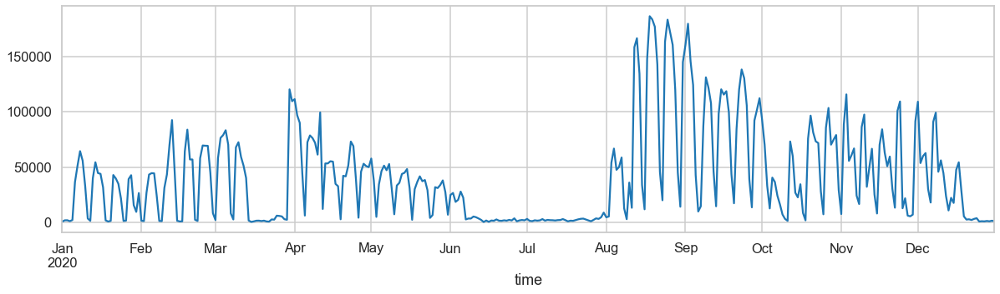

In [157]:
mpl.rcParams['figure.figsize'] = (20,5)
#df.groupby(['Year'])['Global_Sales'].sum().plot()
AZ_9007.groupby('time').engagement_index.sum().plot()
plt.show()

#### A plot of the daily sum of the engagement index for the district, across all apps.  
1. <b>Contours</b>: Each week and weekend is clearly visible.  The general shape also reveals aspects of the school year: 
 - <b>March</b>: the month in which schools closed down during the pandemic.  Also the month for Spring Break.  
 - <b>Summer Vacation</b>: Approximately June through mid-August.  
 

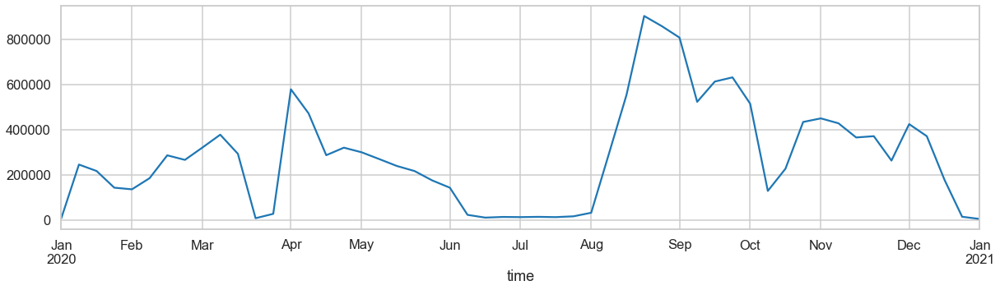

In [158]:
AZ_9007.groupby([pd.Grouper(freq='W')])['engagement_index'].sum().plot()
plt.show()

#### A plot of the sum of the engagement index across all apps, resampled by the week.  

It is easier to spot periods in which the school was likely closed in this plot, and it conveys more clearly the trajectory of student use of digital learning over the course of the year.  We see a dip in late March, followed by a spike that then decreases, and then after the summer, much higher engagement levels in the first half of the fall semester.  This fall semester increase happens at the same time that Loom and Jamboard begin to be used.  

[Back To Top](#top)
<a id="policydates"></a>

### Adding data from the State Covid Policy Database
If, to this graph, we could add vertical lines in the plot to show where important policy dates are, it may be possible to see whether policy changes likely impacted the engagement data.  

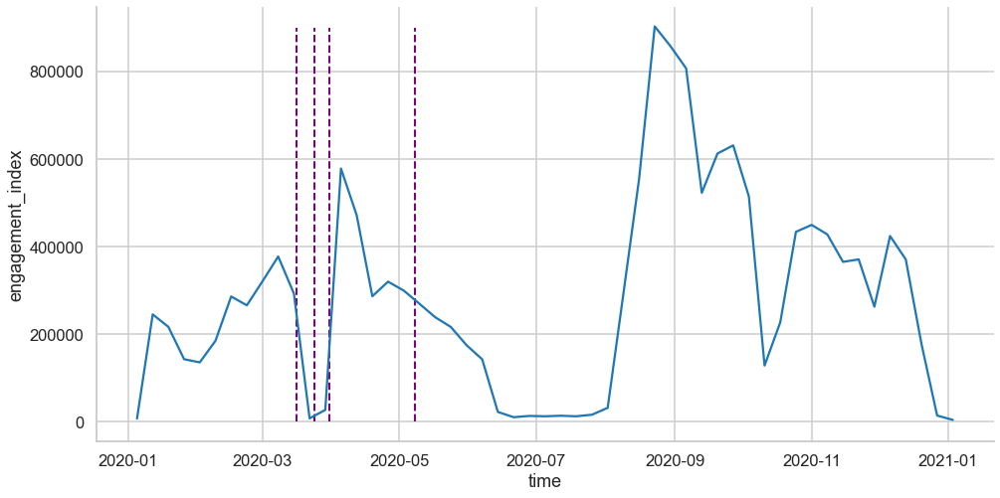

In [159]:
az_weekly = AZ_9007.groupby([pd.Grouper(freq='W')])['engagement_index'].sum()
az_weekly = az_weekly.reset_index()
y_min = 0
y_max = 900000
g = sns.relplot(x='time', y='engagement_index' , data=az_weekly, height=7, aspect=2, kind='line', ci=None)
plt.vlines(x=['2020-03-16', '2020-03-24', '2020-03-31', '2020-05-08'], ymin=y_min, ymax=y_max, colors='purple', ls='--', lw=2)
plt.show()

#### Engagement Index and Dates of Policy Changes

The purple lines in the plot above represent the following dates on which state COVID policies were enacted.  

March 16: Schools Closed (1st line)  
March 24: Eviction Moratorium & Eviction Proceedings Halted  
March 31: Shelter In Place, Businesses Close  
May 8: Businesses Re-open

These dates were gathered from `state_c19_dates`, as shown below

##### The goal is to automate the plotting process, and add the lines with a descriptive legend.  

Aside from Schools Closing, it will be impossible to make judgements about whether these policy changes have had any effect on the engagement data.  <b>The most we can say is that a particular policy is concurrent with a particular change.</b>

In [160]:
az_codes = state_c19_dates[state_c19_dates.AZ.notnull()]

In [161]:
#SOURCE FOR THE DATES PLOTTED ABOVE
az_codes

POSTCODE,date,AZ,CA,CT,DC,FL,IL,IN,MA,MI,...,NH,NJ,NY,OH,TN,TX,UT,VA,WA,WI
2,2020-03-16,CLSCHOOL,NaN,EMSTART,CLSCHOOL,NaN,NaN,NaN,NaN,CLSCHOOL,...,CLSCHOOL,EMSTART,EMSTART,NaN,NaN,NaN,CLSCHOOL,"CLSCHOOL, EMSTART",NaN,NaN
10,2020-03-24,"EMSTART, C19START",NaN,NaN,NaN,NaN,NaN,NaN,"STAYHOME, CLBSNS","STAYHOME, CLBSNS",...,NaN,NaN,NaN,"STAYHOME, CLBSNS",NaN,NaN,NaN,NaN,NaN,NaN
16,2020-03-31,"STAYHOME, CLBSNS",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26,2020-05-08,END_BSNS,END_BSNS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29,2020-05-16,END_STHM,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,"EMEND, C19END",NaN,NaN,NaN
53,2020-10-31,"EMEND, C19END",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


[Back To Top](#top)
<a id="chosenstates"></a>

### CONSOLIDATING THE ENGAGEMENT FILES

<b>Illinois, Washington, and Utah</b> are the states I have chosen to investigate.  

#### The Process
1. Create a list of districts from these three states, and add '.csv' to them to facilitate reading the files. 
2. Append each file to a new DataFrame, adding a column for the district_id and state in the process.  
3. Delete NaN rows from resulting df.  

The `pct_access` column contains percentages, and will not be useful for aggregations, and I had considered deleting it.  But it may be useful in learning how many students are using the apps that have the highest engagement index. 
    
#### REGARDING THE DECISION TO NARROW THE INQUIRY TO THREE STATES (53 Total Districts)

<b>My initial investigation</b> made use of all 176 districts, and the resulting consolidated engagement data file comprised well over<b> <i>17 million </i></b> rows, even after all NaN rows had been deleted. 

* the resulting engagement data file was large enough to slow down processing time, especially as the Jupyter notebook grew. 
* That file is too large to work with in Tableau.  
* Limiting the inquiry to states with full demographic data will provide a more informative context for correlations that may be discovered.  
* Limiting the number of states allows for the potential use of all the data, including `pct_access`, which I initially deleted from the full engagement file.  

In [162]:
chosen_distmeans.dtypes

district_id             int64
POSTCODE               object
state                  object
locale               category
pct_black_hisp       category
pct_freered_lunch    category
ann_perpupil_exp     category
dtype: object

In [163]:
chosen_distmeans.head()

,district_id,POSTCODE,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
0,1052,IL,Illinois,Suburb,20% - 40%,20% - 40%,16000 - 18000
1,6577,IL,Illinois,Suburb,0 - 20%,0 - 20%,10000 - 12000
2,1877,IL,Illinois,Rural,0 - 20%,0 - 20%,12000 - 14000
3,9899,IL,Illinois,Suburb,20% - 40%,0 - 20%,12000 - 14000
4,2779,IL,Illinois,Rural,0 - 20%,0 - 20%,10000 - 12000


In [164]:
chosen_distlist = pd.DataFrame(chosen_distmeans.district_id)

In [165]:
chosen_distlist.head() #may have been refreshed after running cell below. 

,district_id
0,1052
1,6577
2,1877
3,9899
4,2779


In [166]:
#CREATE A LIST OF FILENAMES TO READ = ['1000.csv','1052.csv','1044.csv','1039.csv']
chosen_distlist.district_id = chosen_distlist.district_id.astype(str)
chosen_distlist['csv_filenames'] = chosen_distlist.district_id+'.csv'

In [167]:
csv_list = chosen_distlist.csv_filenames.tolist()

#### THE CONSOLIDATION CODE

In [168]:
#Create an empty dataframe 
engage_data = pd.DataFrame()
#Loop through list to read in .csv files 
for file_name in csv_list:
    # x is a dataframe reading in 1 csv file at a time 
    x = pd.read_csv('engagement_data/' + file_name, low_memory=False)

    # Create a new column in each dataframe to store the district code
    x['district_id'] = file_name[0:4]

    # Concatenate by rows so that glued_data is one dataframe by itself
    engage_data = pd.concat([engage_data,x],axis=0)

[Back To Top](#top)
<a id="picard"></a>

### PREPARING THE CONSOLIDATED ENGAGEMENT DATA

In [169]:
#Preview of data
engage_data.head()

,time,lp_id,pct_access,engagement_index,district_id
0,2020-01-01,57513.0,0.49,141.28,1052
1,2020-01-01,42091.0,0.04,0.41,1052
2,2020-01-01,53399.0,0.04,8.19,1052
3,2020-01-01,32213.0,0.90,44.23,1052
4,2020-01-01,85836.0,0.04,0.41,1052


In [170]:
engage_data.shape

(5568133, 5)

In [171]:
engage_data.isnull().sum()

time                      0
lp_id                   105
pct_access             2453
engagement_index    1195611
district_id               0
dtype: int64

In [172]:
engage_data.time = pd.to_datetime(engage_data.time, infer_datetime_format=True)
engage_data.dtypes

time                datetime64[ns]
lp_id                      float64
pct_access                 float64
engagement_index           float64
district_id                 object
dtype: object

In [173]:
engage_data.dropna(axis=0, subset=['lp_id'], inplace=True)

In [174]:
engage_data.isnull().sum() #refreshed after running cells below

time                      0
lp_id                     0
pct_access             2453
engagement_index    1195593
district_id               0
dtype: int64

In [175]:
engage_data.dropna(subset=['pct_access'], inplace=True)

#### Of the million rows with NaN in the engagement index, how many of those have 0.0 values in the pct_access column?  

In [176]:
zero_val = engage_data[engage_data.engagement_index.isna()]
zero_val.pct_access.value_counts()

0.0    1193140
Name: pct_access, dtype: int64

#### ANSWER: All of them!

In [177]:
engage_data = engage_data.dropna(subset=['engagement_index'])

#### This df needs a state or postcode column

POSTCODE will be easier to use, so....

In [178]:
chosen_distmeans.head()

,district_id,POSTCODE,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
0,1052,IL,Illinois,Suburb,20% - 40%,20% - 40%,16000 - 18000
1,6577,IL,Illinois,Suburb,0 - 20%,0 - 20%,10000 - 12000
2,1877,IL,Illinois,Rural,0 - 20%,0 - 20%,12000 - 14000
3,9899,IL,Illinois,Suburb,20% - 40%,0 - 20%,12000 - 14000
4,2779,IL,Illinois,Rural,0 - 20%,0 - 20%,10000 - 12000


In [179]:
pc_dist = chosen_distmeans[['district_id', 'POSTCODE']]
pc_dist.head()

,district_id,POSTCODE
0,1052,IL
1,6577,IL
2,1877,IL
3,9899,IL
4,2779,IL


In [180]:
engage_data.dtypes

time                datetime64[ns]
lp_id                      float64
pct_access                 float64
engagement_index           float64
district_id                 object
dtype: object

In [181]:
pc_dist.dtypes

district_id     int64
POSTCODE       object
dtype: object

In [182]:
engage_data.district_id = engage_data.district_id.astype(str)

In [183]:
pc_dist.district_id = pc_dist.district_id.astype(str)

/Users/josephandjason/opt/anaconda3/lib/python3.8/site-packages/pandas/core/generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [184]:
engage_data = engage_data.merge(pc_dist, how='left', on='district_id')

In [185]:
engage_data.head(3)

,time,lp_id,pct_access,engagement_index,district_id,POSTCODE
0,2020-01-01,57513.0,0.49,141.28,1052,IL
1,2020-01-01,42091.0,0.04,0.41,1052,IL
2,2020-01-01,53399.0,0.04,8.19,1052,IL


In [186]:
engage_data.lp_id = engage_data.lp_id.astype(int)
engage_data.lp_id = engage_data.lp_id.astype(str)
engage_data.dtypes

time                datetime64[ns]
lp_id                       object
pct_access                 float64
engagement_index           float64
district_id                 object
POSTCODE                    object
dtype: object

### `engage_data` is ready to use!
* It is subsettable by state (`POSTCODE`)
* all values are the proper types

[Back To Top](#top)
<a id="part2"></a>
---
# <span style='color:green'>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</span>
---

## <span style='color:green'><u>PART 2: EXPLORING THE DATA</u></span>

### <u>1. Plotting `engagement_index`: All Districts + State-Level Aggregations</u>

Arizona's plot, which graphed the engagement data as the weekly average of the daily engagement totals, AND added vertical lines to indicate major state-level policy changes, provided the seed code to adapt to create graphs for all districts, as well as each state.  <b>Some improvements and added information</b> would make each plot more useful, as follows: 
- Giving each vertical line a unique color, and a legend identifying the date and the policy change
- Providing district level demographics for each district 

These pieces of information would make each plot more informative.  

- `chosen_distmeans` provides the demographic data
- `state_c19_dates` provides dates of policy changes, and codes identifying what those changes were
- `code_list` correlates the policy codes to their definitions

These three dfs and `engage_data` are the required data sources for this task.   


In [187]:
#LIMITING POLICY DATES TO THOSE OCCURRING IN 2020
state_c19_dates = state_c19_dates.reset_index()

In [188]:
state_c19_dates = state_c19_dates[state_c19_dates.date <= '2020-12-31']

In [189]:
state_c19_dates = state_c19_dates.set_index('date')

In [190]:
#checking data types
chosen_distmeans.dtypes

district_id             int64
POSTCODE               object
state                  object
locale               category
pct_black_hisp       category
pct_freered_lunch    category
ann_perpupil_exp     category
dtype: object

In [191]:
engage_data.dtypes

time                datetime64[ns]
lp_id                       object
pct_access                 float64
engagement_index           float64
district_id                 object
POSTCODE                    object
dtype: object

In [192]:
code_list.dtypes

code          object
definition    object
dtype: object

In [193]:
state_c19_dates.dtypes

POSTCODE
index     int64
AZ       object
CA       object
CT       object
DC       object
FL       object
IL       object
IN       object
MA       object
MI       object
MN       object
MO       object
NC       object
ND       object
NH       object
NJ       object
NY       object
OH       object
TN       object
TX       object
UT       object
VA       object
WA       object
WI       object
dtype: object

In [194]:
chosen_distmeans.district_id = chosen_distmeans.district_id.astype(str)

In [195]:
chosen_distmeans.dtypes

district_id            object
POSTCODE               object
state                  object
locale               category
pct_black_hisp       category
pct_freered_lunch    category
ann_perpupil_exp     category
dtype: object

[Back To Top](#top)
<a id="prep"></a>

### Preparing to run the plot code
Before running the plot code, I need to 
- check indexes, 
- create necessary lists, and 
- make sure the code works for the data types in each df. 

In [196]:
#create a list for iteration
pcodes = ['IL', 'UT', 'WA']

In [197]:
#check index of engage_data
engage_data.head(3)

,time,lp_id,pct_access,engagement_index,district_id,POSTCODE
0,2020-01-01,57513,0.49,141.28,1052,IL
1,2020-01-01,42091,0.04,0.41,1052,IL
2,2020-01-01,53399,0.04,8.19,1052,IL


[Back To Top](#top)
<a id="plotstates"></a>

### Plotting Illinois, Utah, and Washington

______________________________
STATE: IL


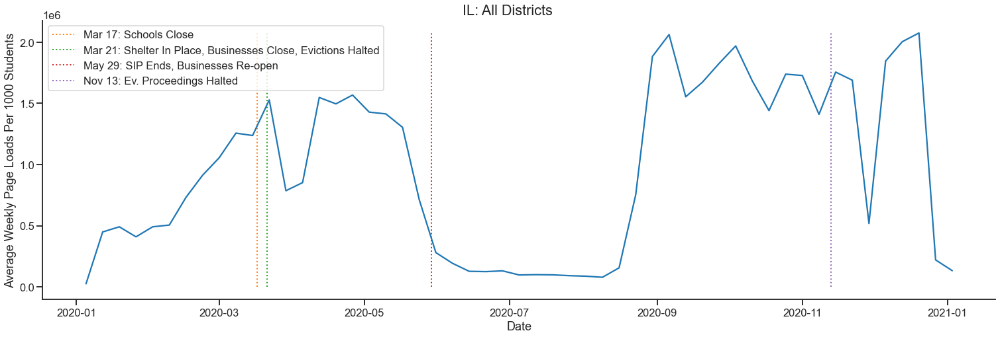

DISTRICT 1052 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Suburb
          


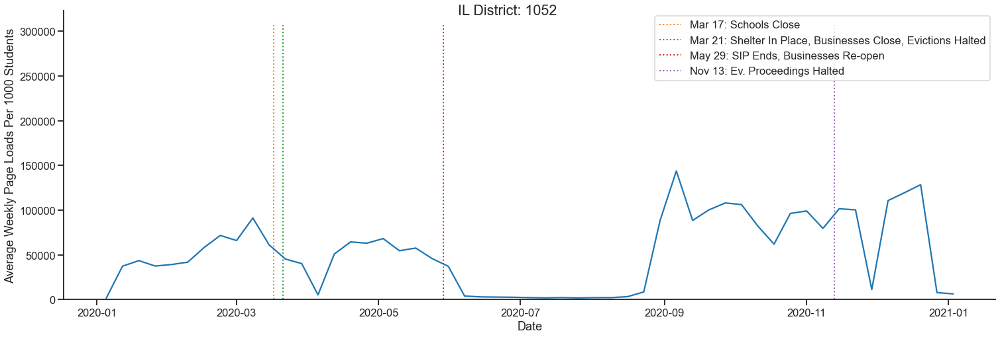

DISTRICT 6577 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Suburb
          


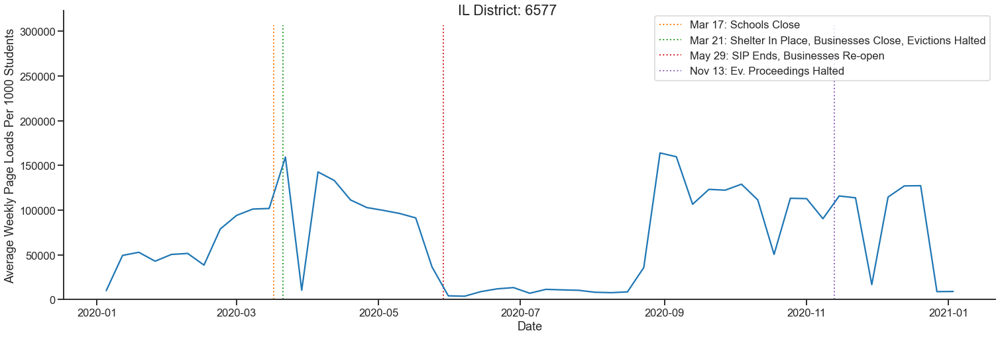

DISTRICT 1877 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Rural
          


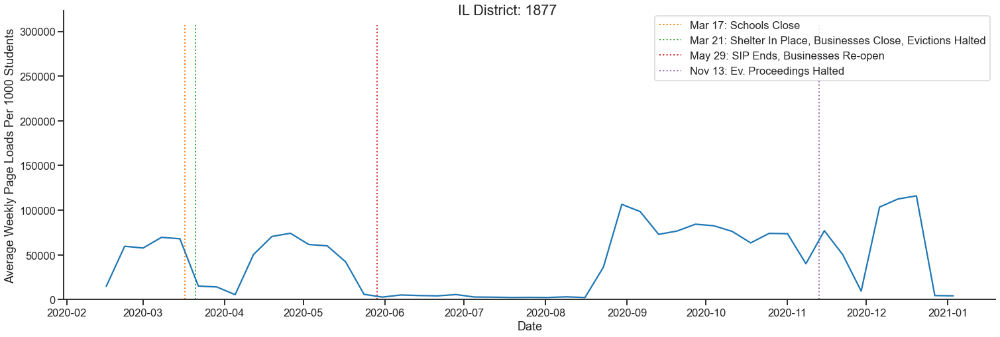

DISTRICT 9899 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


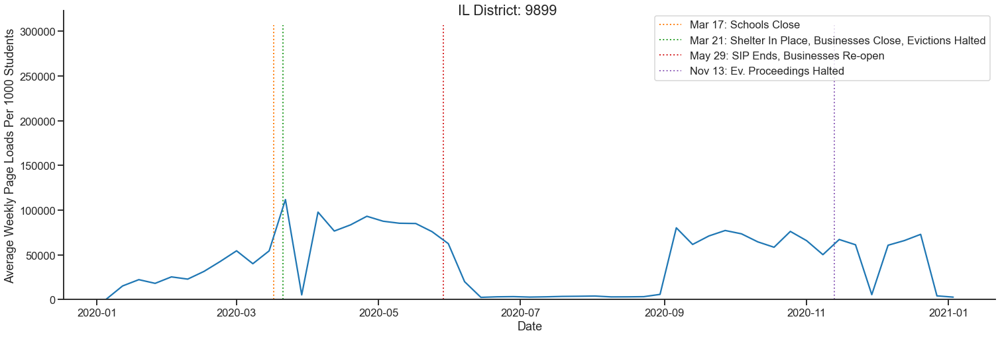

DISTRICT 2779 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Rural
          


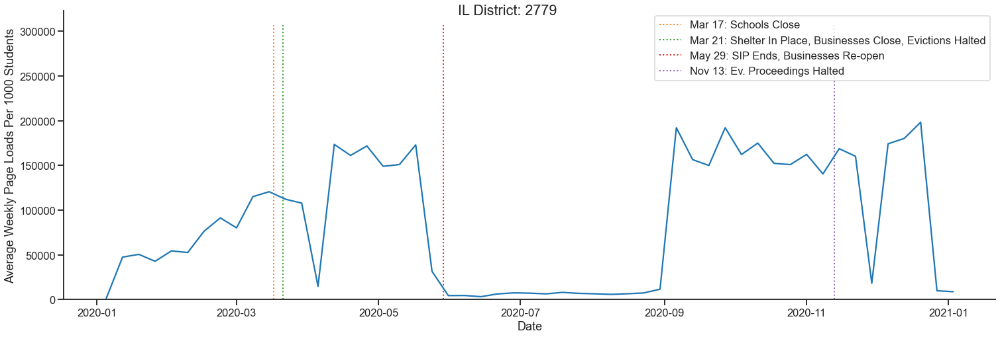

DISTRICT 9043 DEMOGRAPHICS
Black & Hispanic Students: 80% - 100%
Students With Free or Reduced Lunches: 80% - 100%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


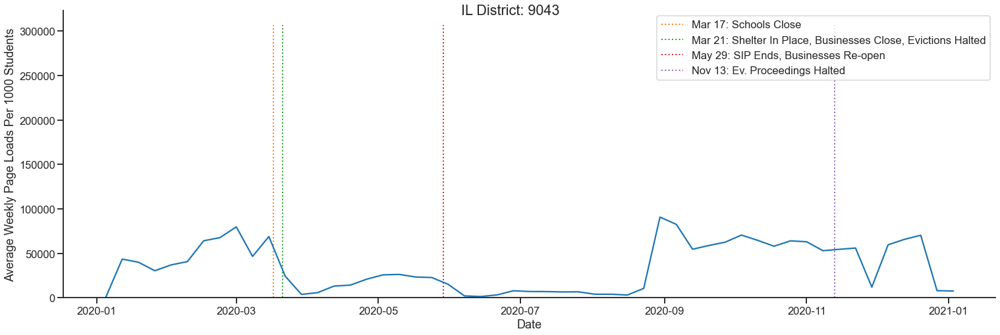

DISTRICT 2601 DEMOGRAPHICS
Black & Hispanic Students: 60% - 80%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


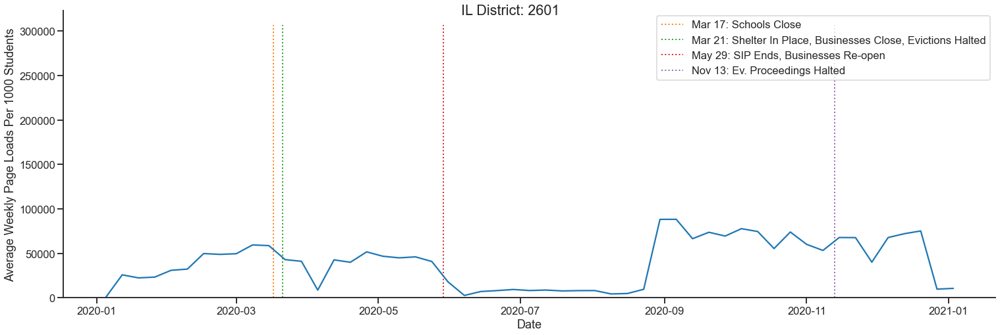

DISTRICT 8784 DEMOGRAPHICS
Black & Hispanic Students: 60% - 80%
Students With Free or Reduced Lunches: 60% - 80%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Suburb
          


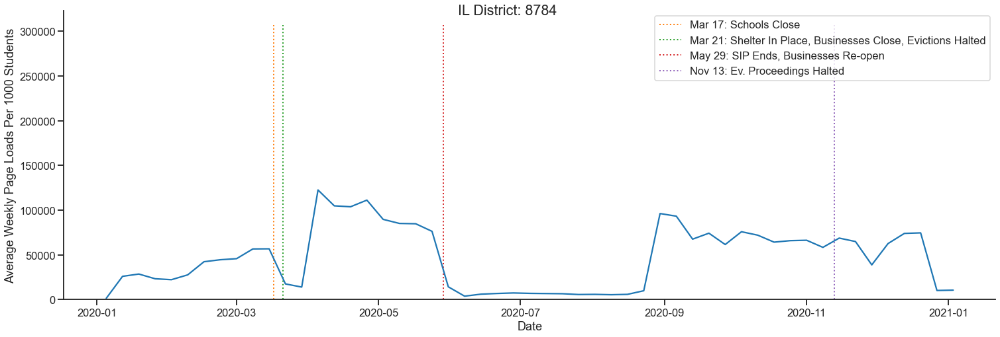

DISTRICT 8815 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          


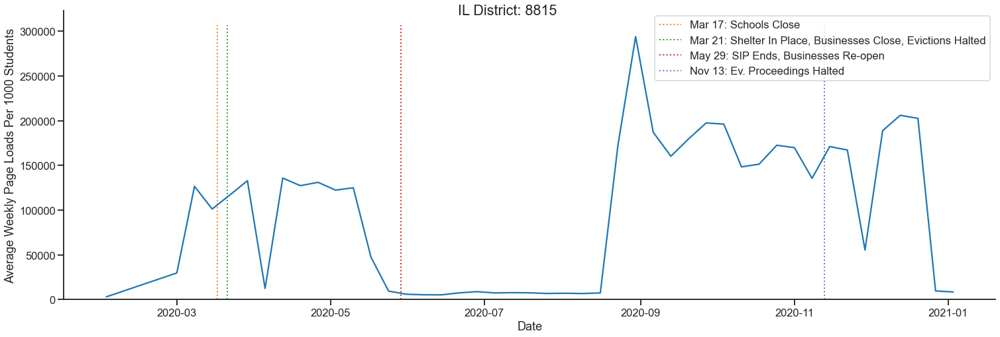

DISTRICT 4629 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Suburb
          


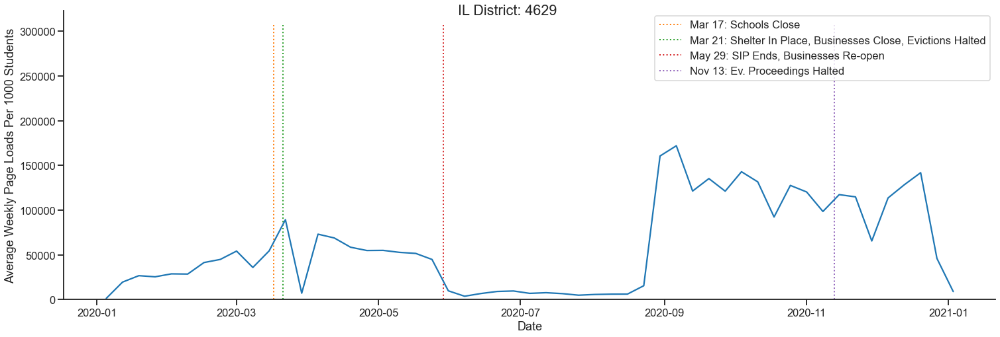

DISTRICT 5890 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $18000 - 20000
District Locale: Suburb
          


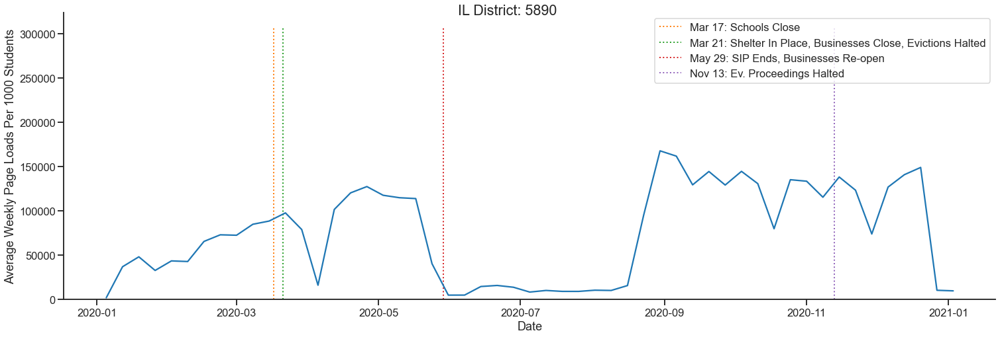

DISTRICT 1712 DEMOGRAPHICS
Black & Hispanic Students: 40% - 60%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


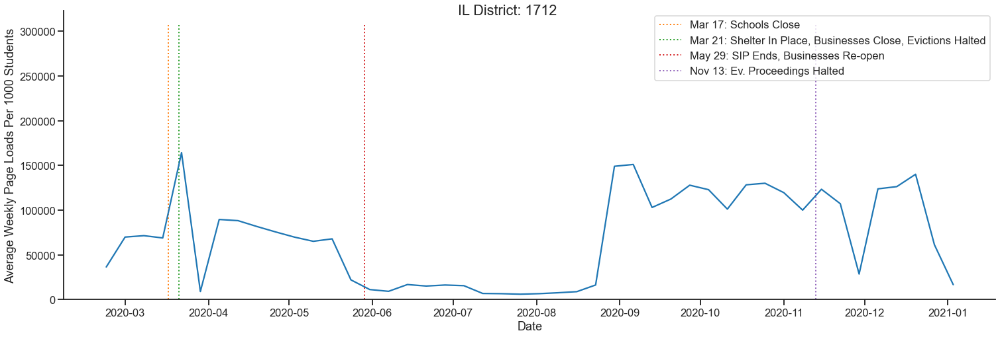

DISTRICT 8937 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Rural
          


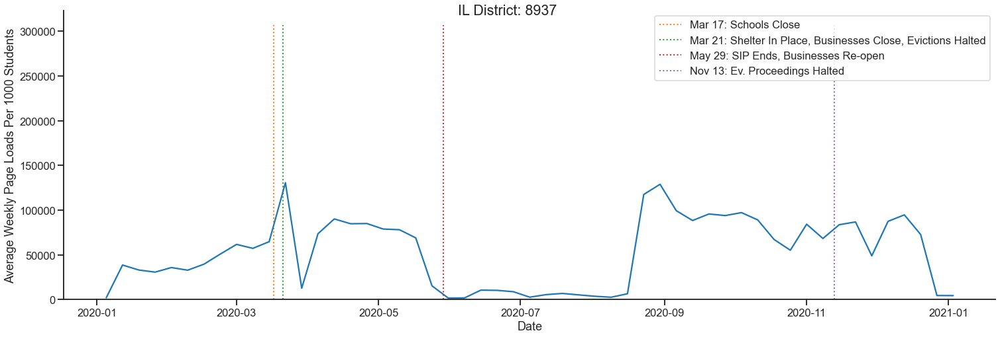

DISTRICT 3248 DEMOGRAPHICS
Black & Hispanic Students: 60% - 80%
Students With Free or Reduced Lunches: 60% - 80%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


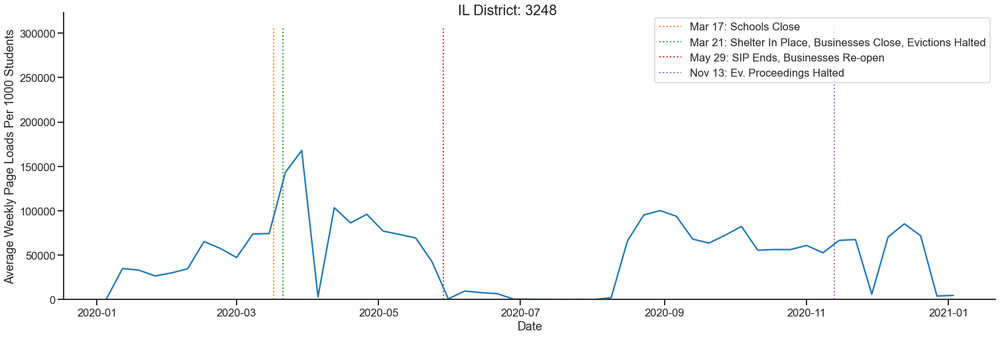

DISTRICT 5042 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 80% - 100%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          


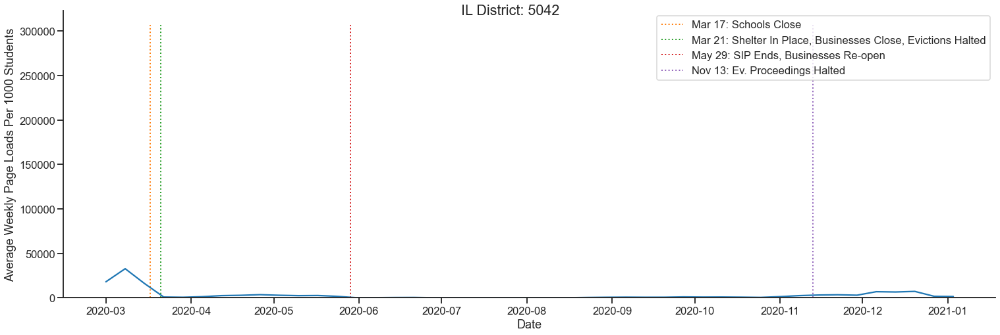

DISTRICT 9553 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          


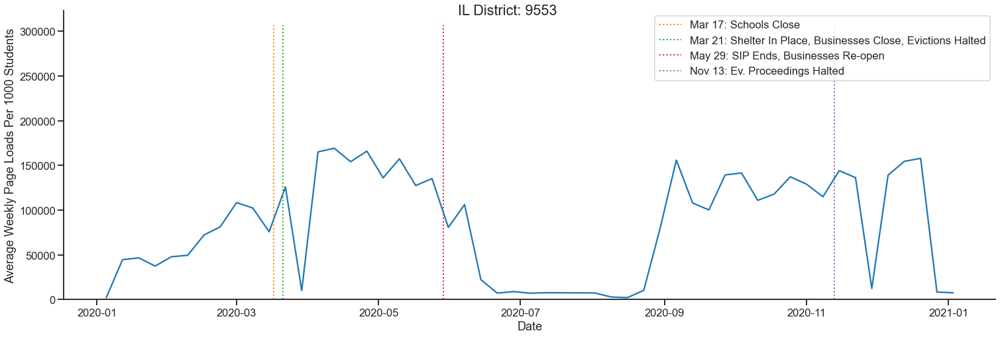

DISTRICT 2285 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


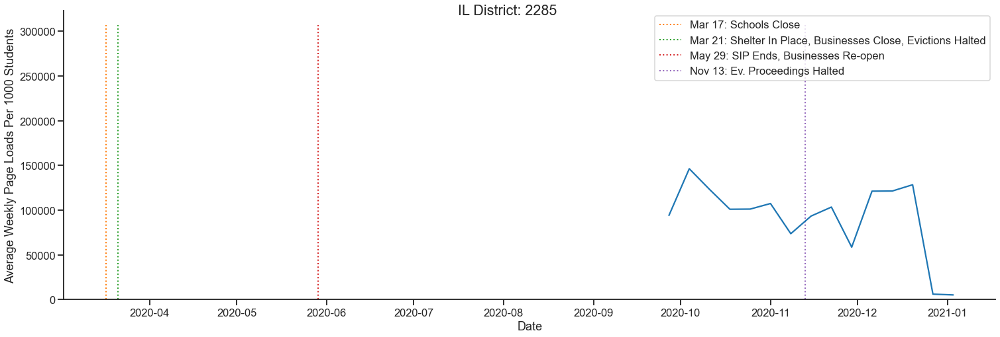

DISTRICT 2393 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


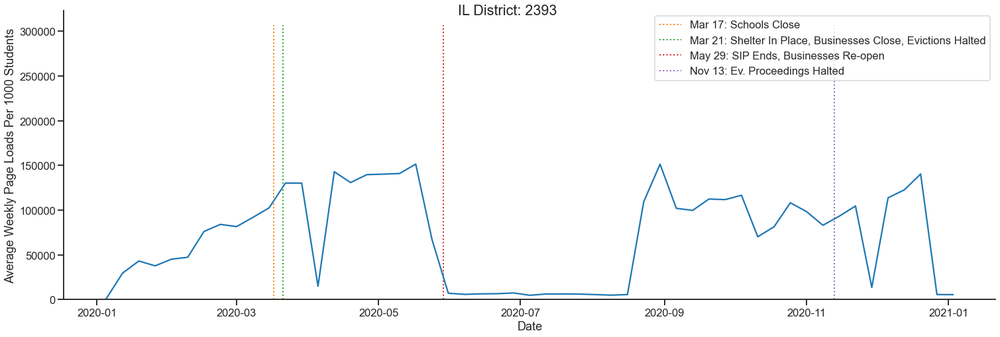

______________________________
STATE: UT


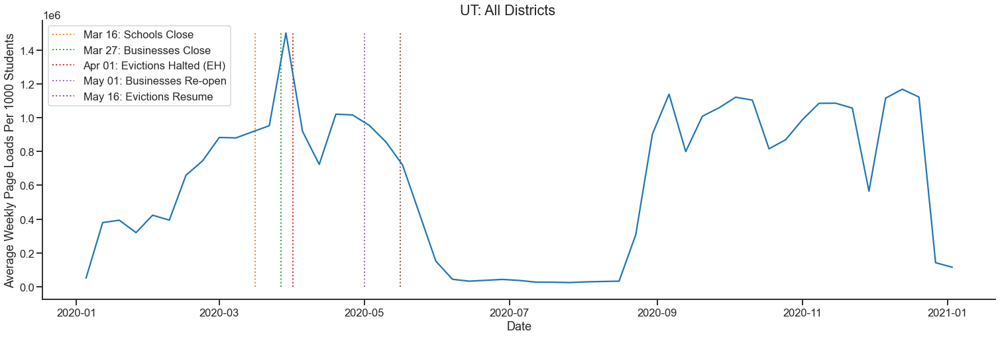

DISTRICT 4668 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


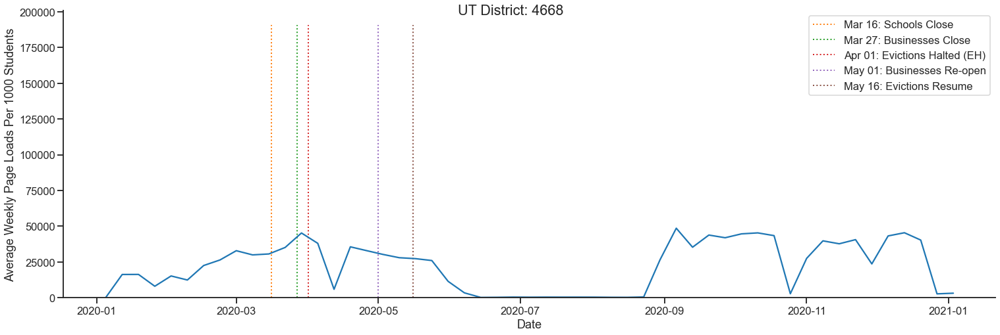

DISTRICT 8328 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          


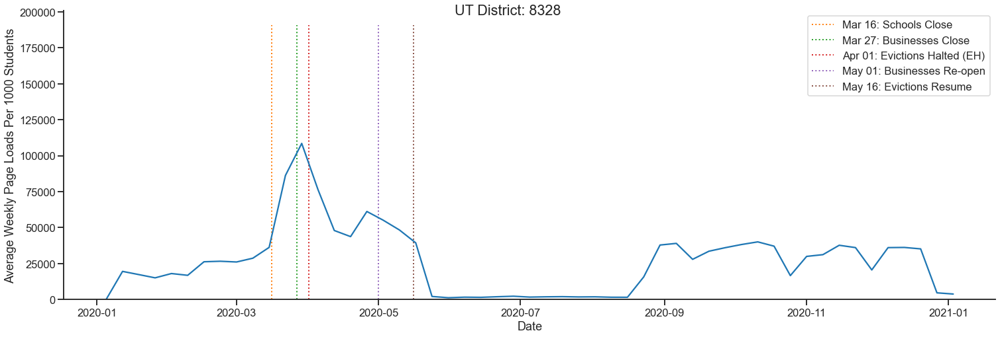

DISTRICT 6762 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $4000 - 6000
District Locale: Suburb
          


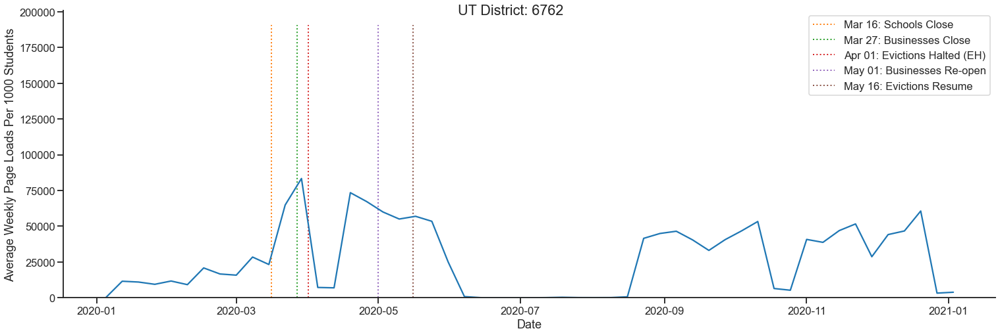

DISTRICT 4183 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Town
          


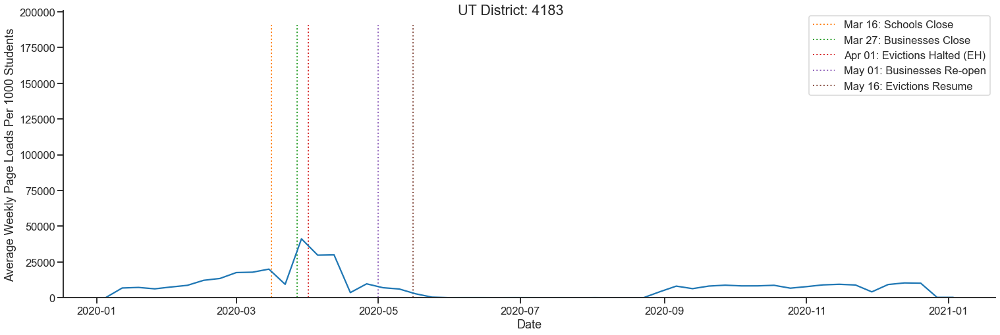

DISTRICT 9778 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Town
          


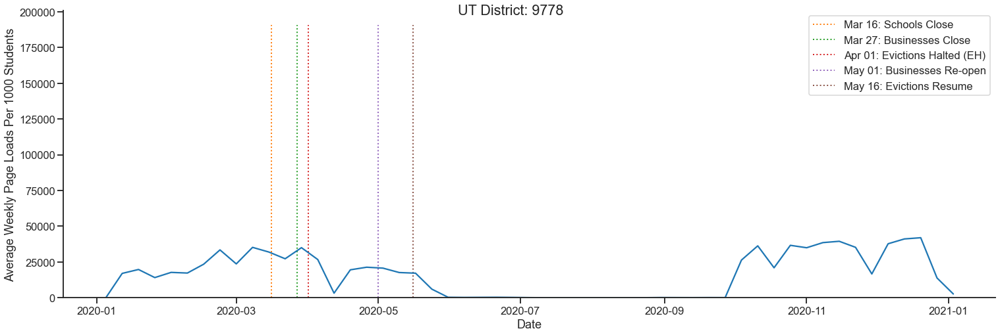

DISTRICT 7614 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: City
          


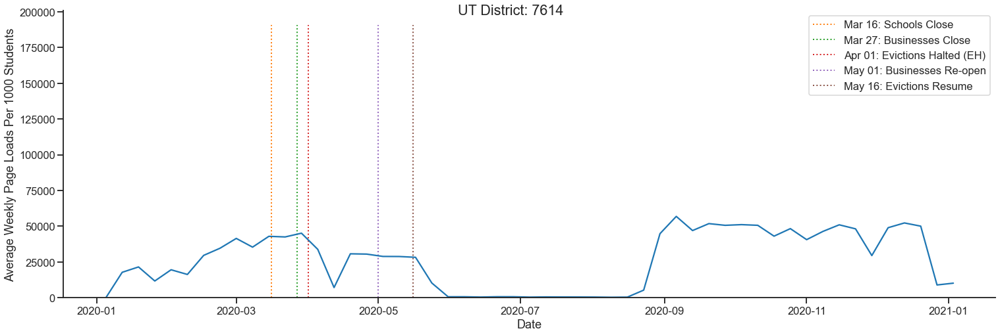

DISTRICT 2165 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


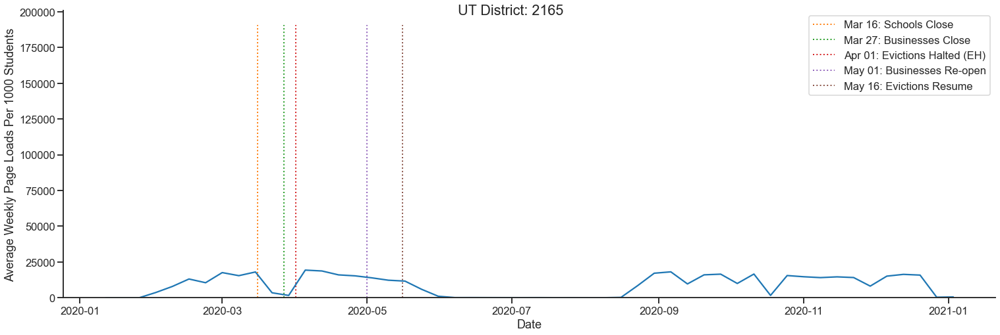

DISTRICT 7541 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


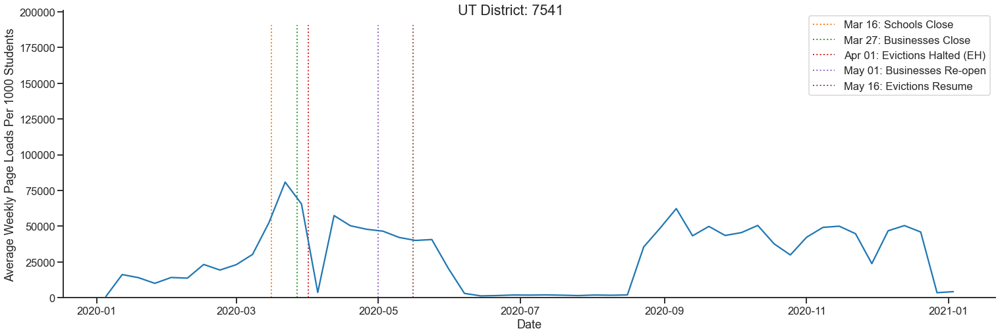

DISTRICT 3160 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


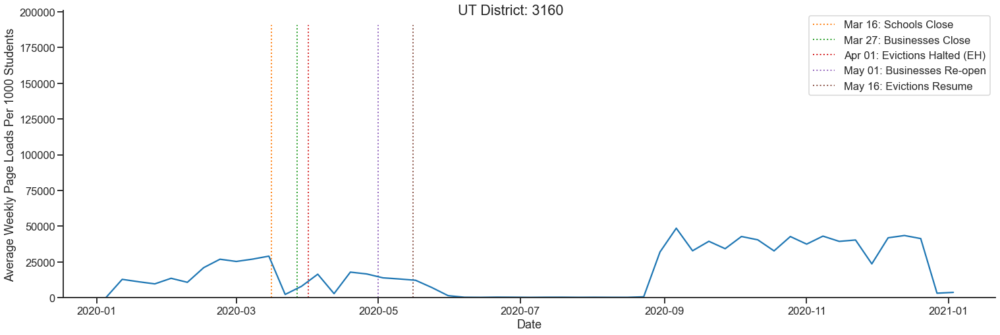

DISTRICT 9230 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Rural
          


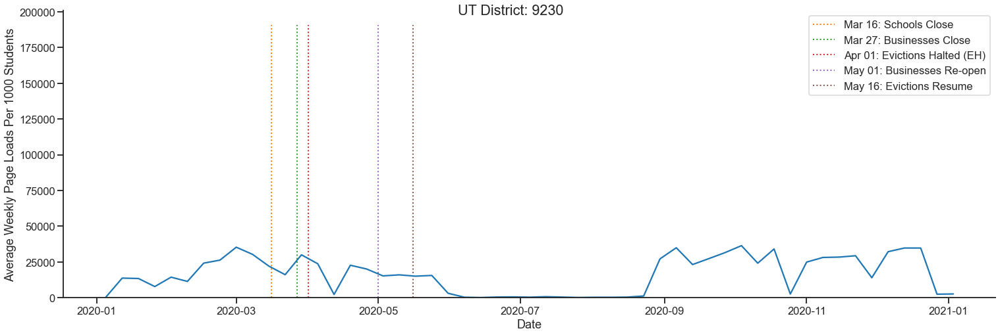

DISTRICT 4936 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


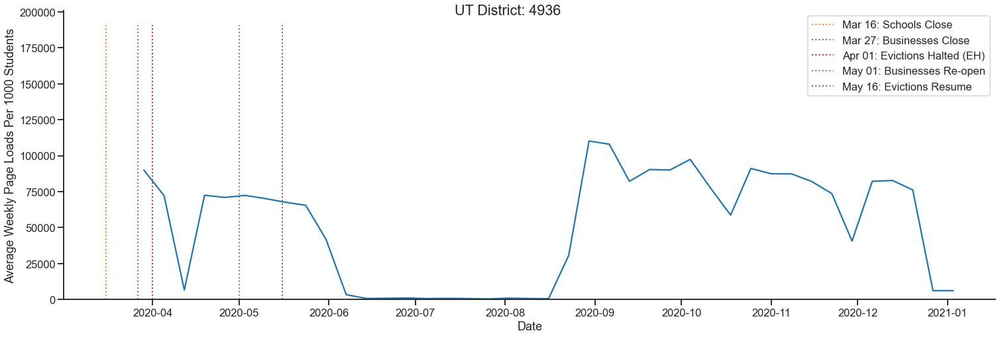

DISTRICT 3772 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


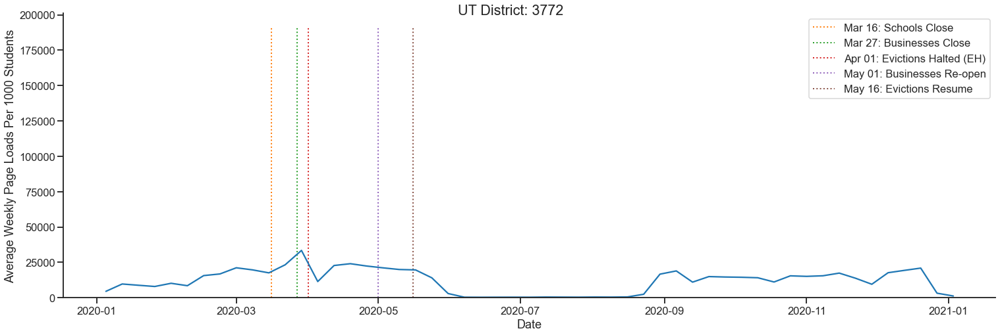

DISTRICT 1270 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Rural
          


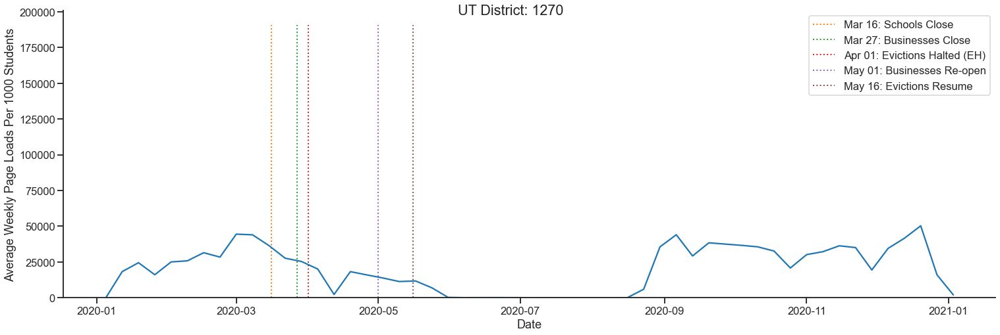

DISTRICT 5231 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          


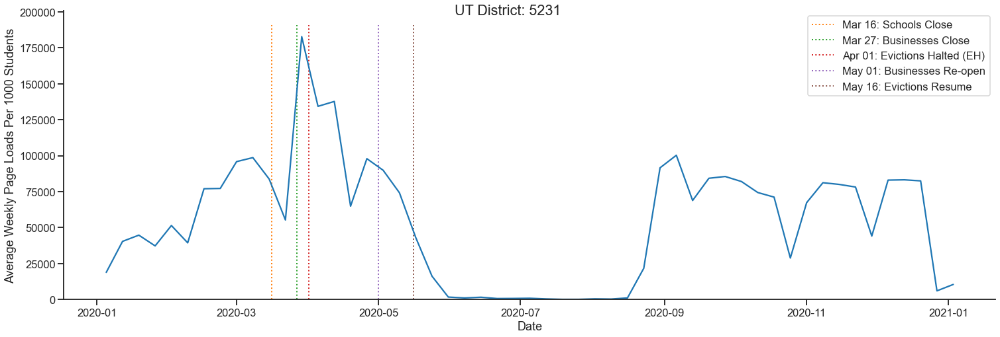

DISTRICT 4921 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


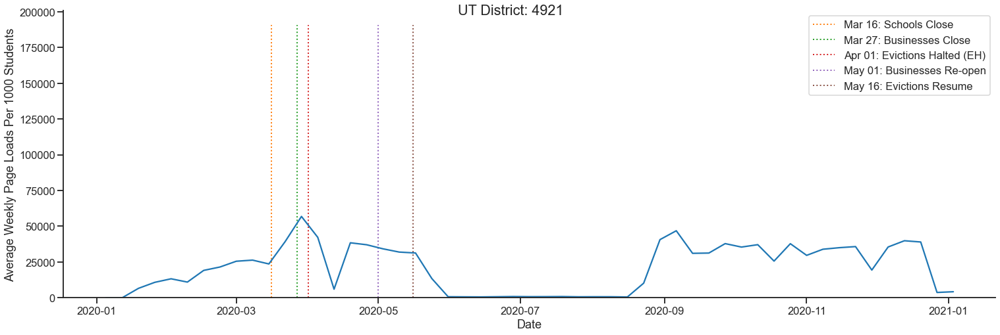

DISTRICT 1772 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: City
          


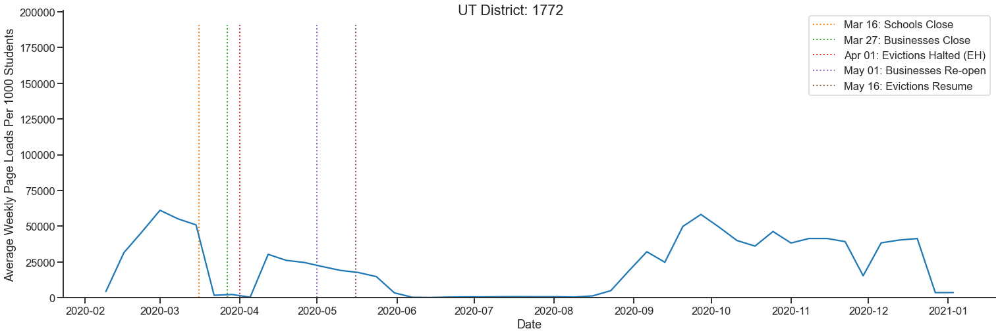

DISTRICT 9812 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


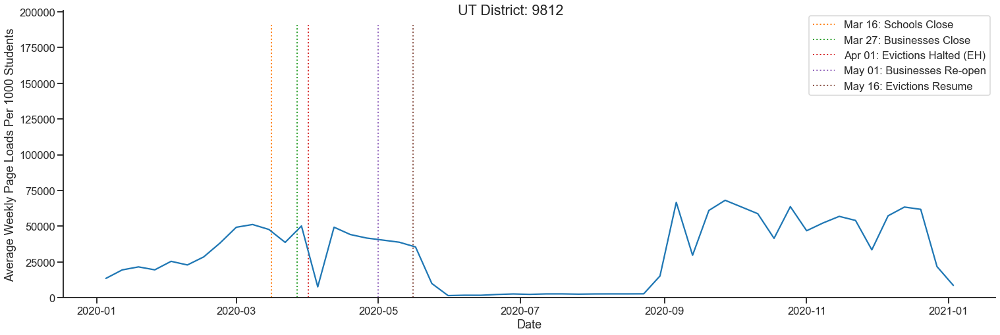

DISTRICT 4373 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: City
          


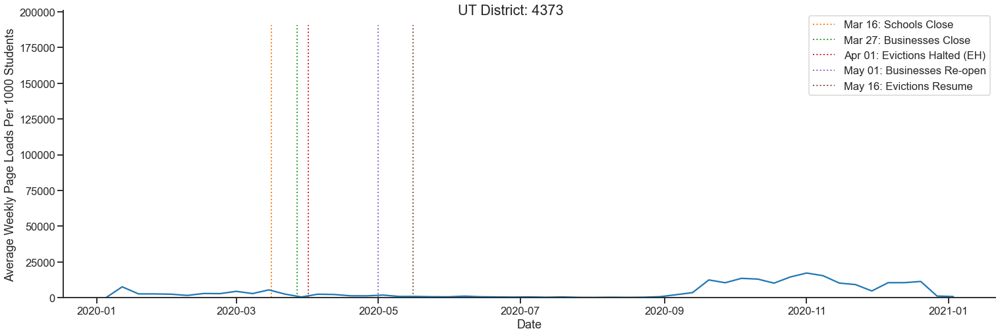

DISTRICT 3710 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


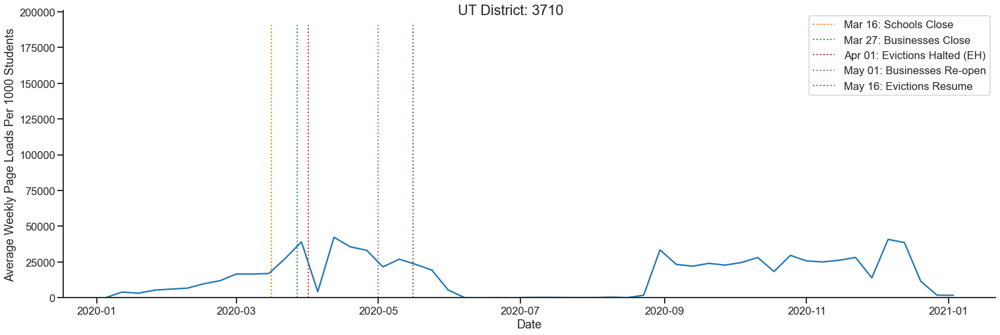

DISTRICT 5600 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


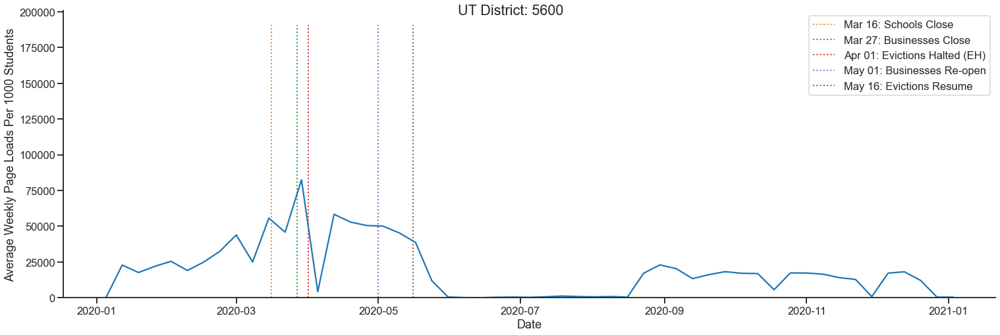

DISTRICT 4744 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


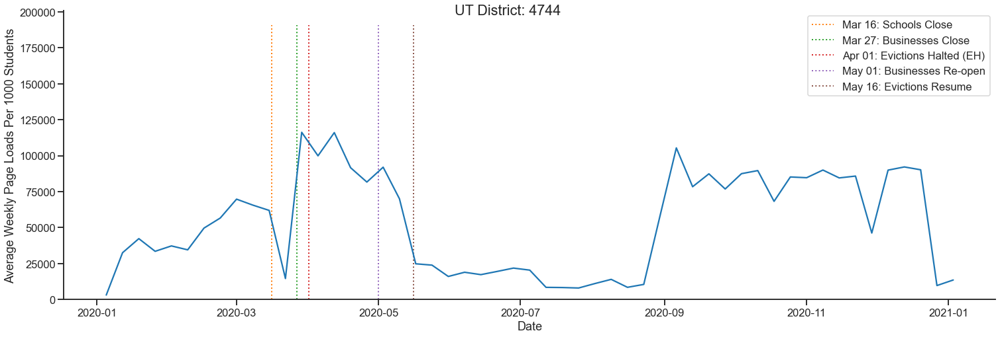

DISTRICT 3864 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


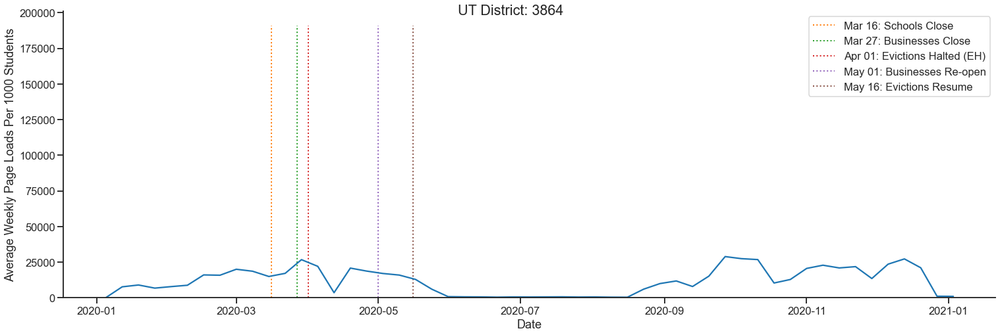

DISTRICT 7387 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: City
          


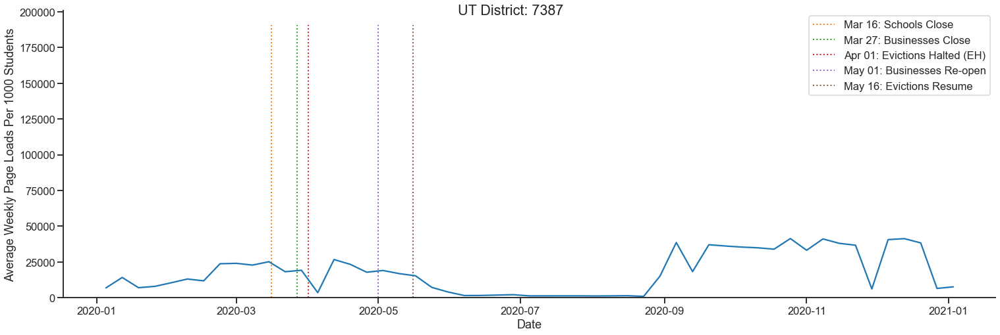

DISTRICT 7308 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $4000 - 6000
District Locale: Suburb
          


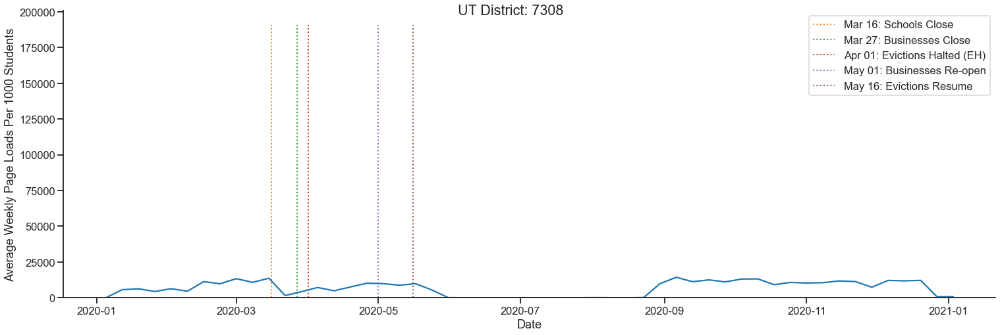

DISTRICT 3266 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          


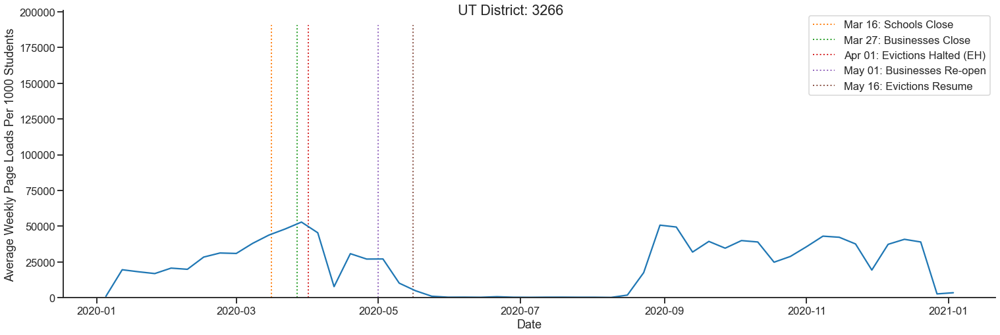

DISTRICT 3692 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


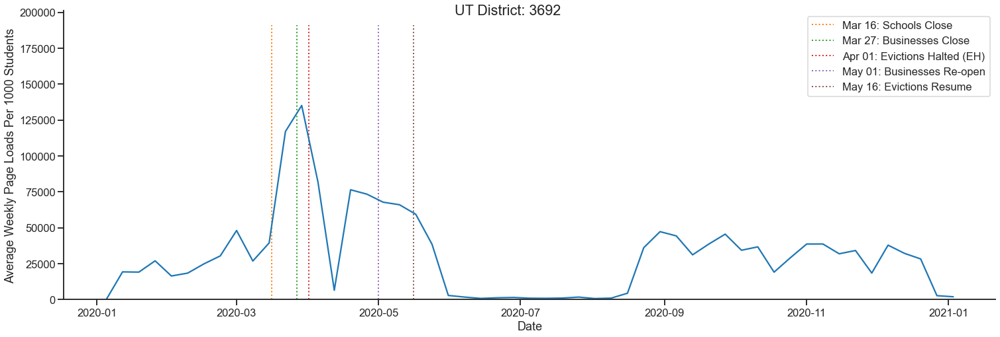

DISTRICT 2441 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Town
          


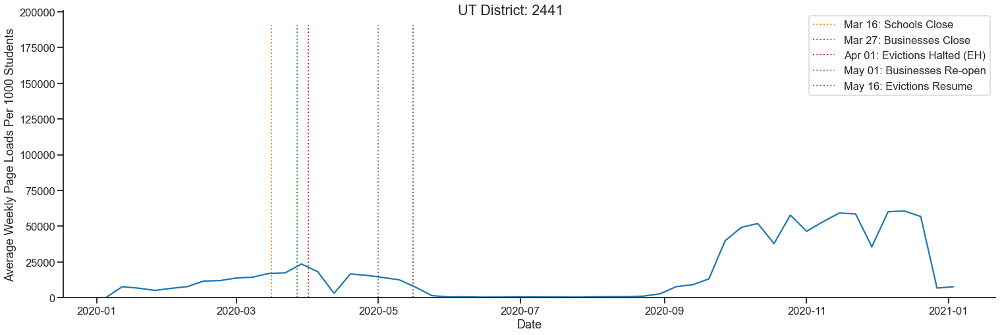

DISTRICT 7660 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


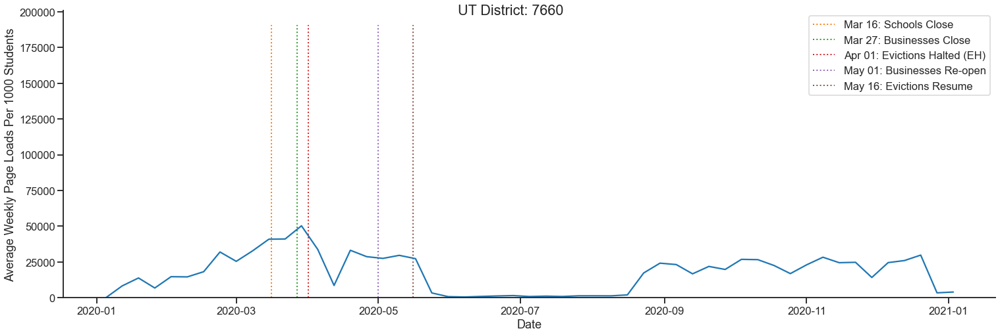

DISTRICT 1204 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


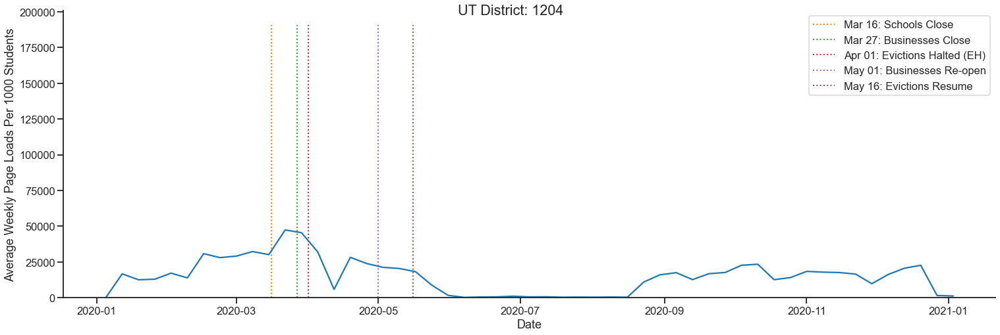

______________________________
STATE: WA


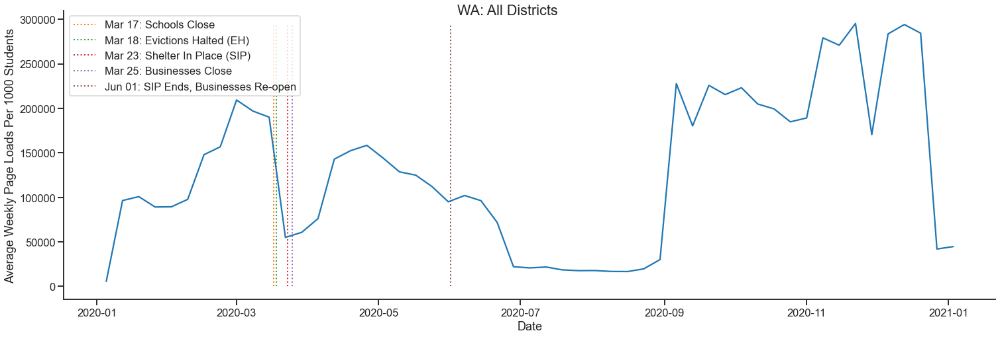

DISTRICT 5510 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: City
          


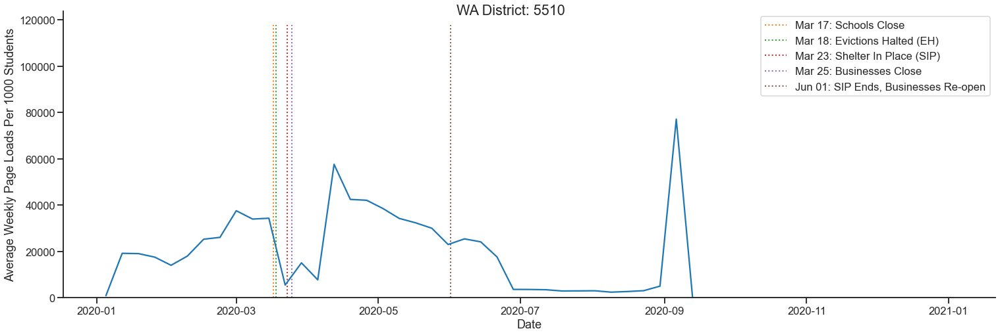

DISTRICT 2567 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


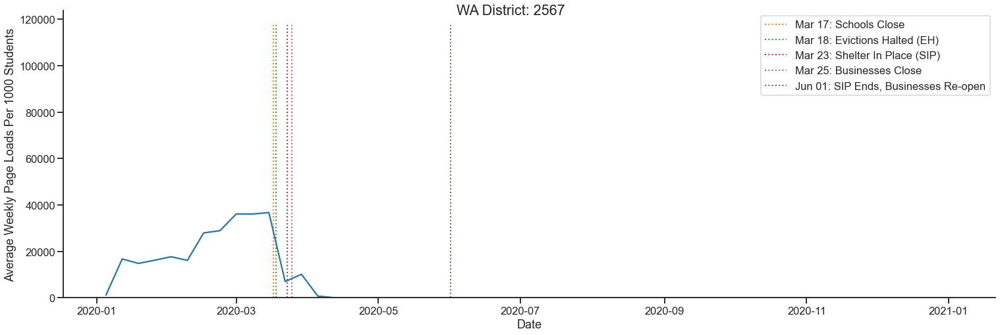

DISTRICT 2167 DEMOGRAPHICS
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          


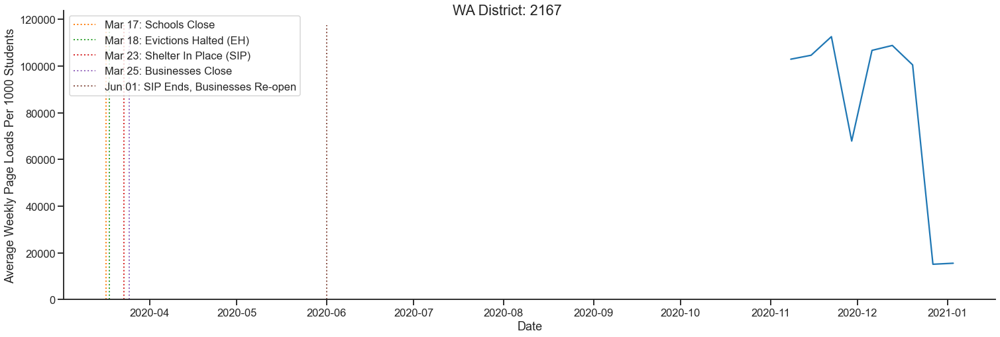

DISTRICT 7457 DEMOGRAPHICS
Black & Hispanic Students: 40% - 60%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: City
          


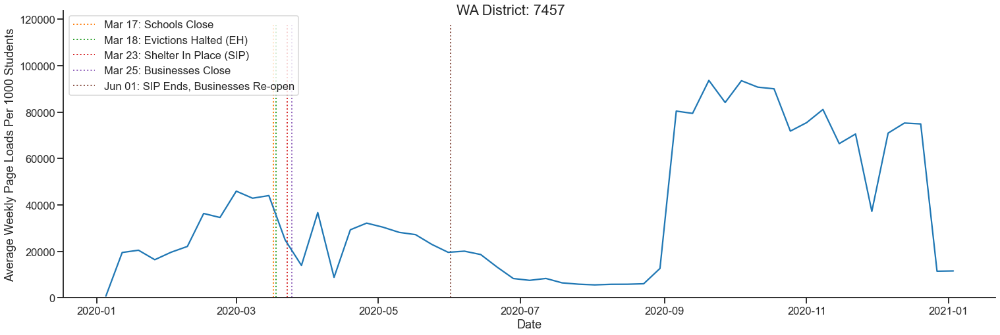

DISTRICT 1705 DEMOGRAPHICS
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: City
          


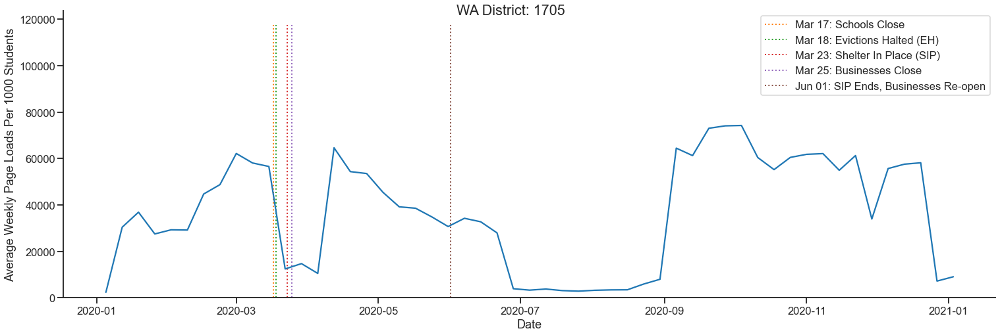

DISTRICT 2130 DEMOGRAPHICS
Black & Hispanic Students: 40% - 60%
Students With Free or Reduced Lunches: 60% - 80%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          


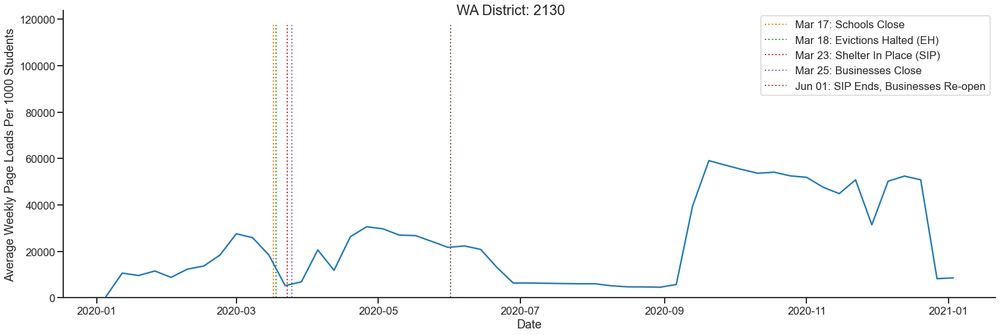

In [198]:
sns.set_style('ticks')
for state in pcodes:
    state_engage = engage_data[engage_data.POSTCODE == state]
    state_districts = state_engage.district_id.drop_duplicates()   #get district list
    state_districts.reset_index(drop=True, inplace=True)   #reset index
    #aggregates engagement_index as the sum of all daily values
    state_daysum = pd.DataFrame(state_engage.groupby('time').engagement_index.sum()) 
    
    #variables to store lists for vertical lines
    state_defs = []
    #creates list of dates from index values where value for the date is not null
    date_list = state_c19_dates.index[state_c19_dates[state].notnull()] 
    nannies = state_c19_dates[state].tolist()            #list with nans
    state_codes = [x for x in nannies if str(x) !='nan'] #this removes nans, leaving just codes

    #loop creates list of definitions coresponding to codes
    for codey in state_codes:
        x=code_list.loc[code_list.code==codey, 'definition'].iloc[0]
        state_defs.append(x)
        
    colours = ['C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9'] #creates list of colors to map to each vertical line 
    
    #this code gets max value for y axis for each state, so district plots have the same y-axis
    dists = state_engage.groupby(['time', 'district_id']).sum()
    dists = dists.reset_index('district_id')   #this removes multi-index
    dists_resample = dists.groupby([pd.Grouper(freq='W'), 'district_id'])['engagement_index'].mean()
    zee = dists_resample.max()
    max_val = zee*1.1

    #plot state level engagement data
    print('______________________________') #prints a line between states and the state name
    print("STATE: "+ state)
        
    '''
    These next two lines find the maximum daily average engagement value
    and save it to a variable to use as the upper limit for the vertical lines in the plot
    '''
    
    state_means = state_daysum.resample('W').mean()
    state_max = state_means.engagement_index.max()
    y_max1 = state_max
    
    g = sns.relplot(x='time', y='engagement_index', data=state_daysum.resample('W').mean(), height=7, aspect=3, kind='line', ci=None)
    g.set(xlabel='Date', 
         ylabel='Average Weekly Page Loads Per 1000 Students')

    #this loop generates the vertical lines and labels for each line
    for i in range(0, len(date_list)):
        plt.vlines(x=date_list[i], ymin=0, ymax=y_max1, colors=colours[i],  linestyle = 'dotted', lw=2, label = date_list[i].strftime('%b %d') + ': ' +state_defs[i])
    g.fig.suptitle(state + ': '+ 'All Districts')
    plt.legend(loc='upper left')
    plt.show()

    #plot DISTRICT level engagement data
    for dist in state_districts:
        district_df = state_engage[state_engage.district_id==dist]  #subsets state_engage by district 
        dist_daysum = pd.DataFrame(district_df.groupby('time').engagement_index.sum())
        dist_num = dist
    
        #these next three lines gather demographic values for the district from chosen_distmeans dataframe
        race_pct = chosen_distmeans.loc[chosen_distmeans.district_id==dist_num, 'pct_black_hisp'].iloc[0]
        free_lunch_pct = chosen_distmeans.loc[chosen_distmeans.district_id==dist_num, 'pct_freered_lunch'].iloc[0]
        per_pupil = chosen_distmeans.loc[chosen_distmeans.district_id==dist_num, 'ann_perpupil_exp'].iloc[0]
        locale = chosen_distmeans.loc[chosen_distmeans.district_id==dist_num, 'locale'].iloc[0]
    
        #Demographic info loop: prints title and any existing demographics for district
        print('\033[4mDISTRICT '+ dist + ' DEMOGRAPHICS\033[0m')
        print('Black & Hispanic Students: '+ race_pct)
        print('Students With Free or Reduced Lunches: '+ free_lunch_pct)
        print('Per Pupil Yearly Expenditure: $'+ per_pupil)
        print('District Locale: ' + locale)
        print('          ')
        
        #establishes maximum value for y axis
        district_max = max_val*0.95
        y_max2 = district_max
        g = sns.relplot(x='time', y='engagement_index', data=dist_daysum.resample('W').mean(), height=7, aspect=3, kind='line', ci=None)
        g.set(ylim=(0, max_val))
        g.set(xlabel='Date', 
             ylabel='Average Weekly Page Loads Per 1000 Students')

        
        #this loop generates vertical lines and labels for each line
        for i in range(0, len(date_list)):
            plt.vlines(x=date_list[i], ymin=0, ymax=y_max2, colors=colours[i], lw=2,linestyle = 'dotted', label = date_list[i].strftime('%b %d') + ': ' + state_defs[i])
        g.fig.suptitle(state + ' District: '+ dist)
        plt.legend(loc='best')
        plt.show()

[Back To Top](#top)
<a id="washprobs"></a>

#### <u>Washington: Some Problems</u>

The plots reveal that half of Washington's reporting districts do not have data for a large portion of the year. The lack of data may be because: 
- some days of engagement data were deleted when the engagement file was purged of all entries for apps not in the products list (although, in exploring the data prior to this point, a comparison of the full data and trimmed data for for a sample set of districts whose plots revealed incomplete data for the year showed that, for those particular districts, the full data lacked entries for those dates as well--so trimming the data did not delete any dates from the engagement files).  
- LearnPlatform did not have access to that district's data for the entire year.  
- The district either had no digital infrastructure for part of the year, or abandoned its use entirely.  <b>Without further information about the district, it is unwise to speculate on this point</u>

The Solution: Choose another state with more complete engagement data AND full demographic data.  

<b>New York</b> is a possiblity. It is on the shortlist of states with complete demographic data.   

- Geography: It's closer to Illinois than Washington, but still far enough away to represent a different part of the country.  
- Demographics: The demographics of New York's districts are sufficiently varied. 
- Engagement data: my initial plots of all 176 districts show that most of New York's eight reporting districts have data for most of 2020.  <b>I should have confirmed this was true for Washington before proceeding, but because the dfs have been thoroughly prepared, substituting New York for Washington should not be difficult.  

#### Why this matters
- Correlations with the Kids Count Data
 - this data is in the form of weekly percentages, limiting the data points to at most 52 per year.  
 - Engagement data limited to even just 6 months of the year reduces aggregated weekly engagement values to just 26--and the resulting correlation with the Kids Count data is based on just a portion of the year, and a small number of values.  This is not ideal, and not as meaningful as a correlation based on the full range of Kids Count data.  
  

---
# <b>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</b>
---    
[Back To Top](#top)
<a id="nysub"></a>

### <u>2. Adding New York in place of Washington</u>

In [199]:
districts.head()

,district_id,POSTCODE,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
0,9007,AZ,Arizona,City,80% - 100%,NaN,NaN
1,3412,CA,California,City,60% - 80%,40% - 60%,NaN
2,2321,CA,California,Rural,0 - 20%,0 - 20%,NaN
3,2106,CA,California,Suburb,20% - 40%,0 - 20%,NaN
4,2074,CA,California,Suburb,40% - 60%,20% - 40%,NaN


In [200]:
chosen_districts = districts[districts.POSTCODE.isin(['IL', 'NY', 'UT'])]

In [201]:
chosen_districts

,district_id,POSTCODE,state,locale,pct_black_hisp,pct_freered_lunch,ann_perpupil_exp
47,1052,IL,Illinois,Suburb,20% - 40%,20% - 40%,16000 - 18000
48,2285,IL,Illinois,Suburb,0 - 20%,40% - 60%,12000 - 14000
49,9553,IL,Illinois,Suburb,0 - 20%,0 - 20%,14000 - 16000
50,5042,IL,Illinois,Town,20% - 40%,80% - 100%,10000 - 12000
51,3248,IL,Illinois,Suburb,60% - 80%,60% - 80%,12000 - 14000
52,8937,IL,Illinois,Rural,0 - 20%,0 - 20%,12000 - 14000
53,1712,IL,Illinois,Suburb,40% - 60%,40% - 60%,12000 - 14000
54,5890,IL,Illinois,Suburb,20% - 40%,20% - 40%,18000 - 20000
55,2393,IL,Illinois,Suburb,0 - 20%,0 - 20%,12000 - 14000
56,8815,IL,Illinois,Suburb,0 - 20%,0 - 20%,14000 - 16000


[Back To Top](#top)
<a id="nycompare"></a>

### Demographic Comparison: Illinois, New York, Utah

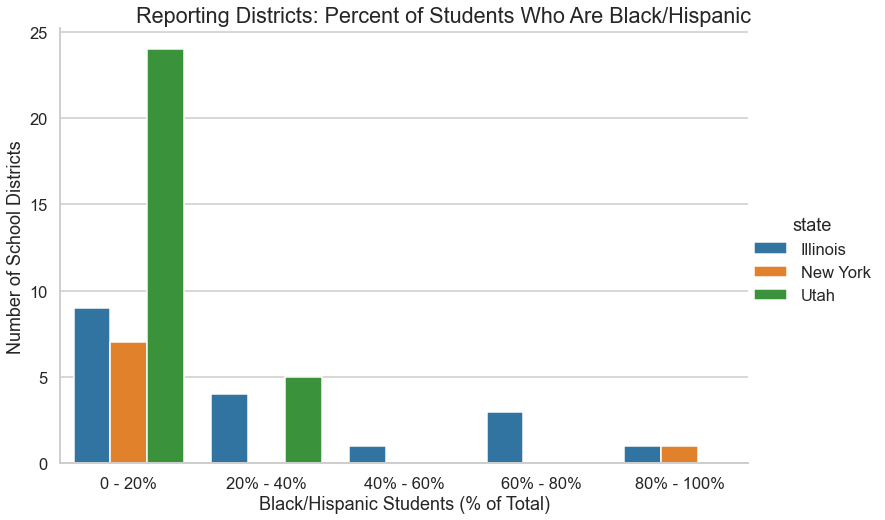

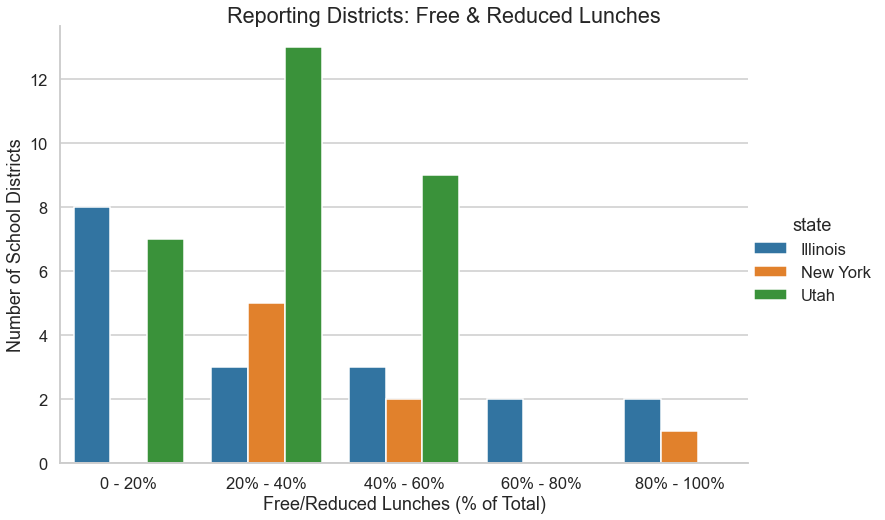

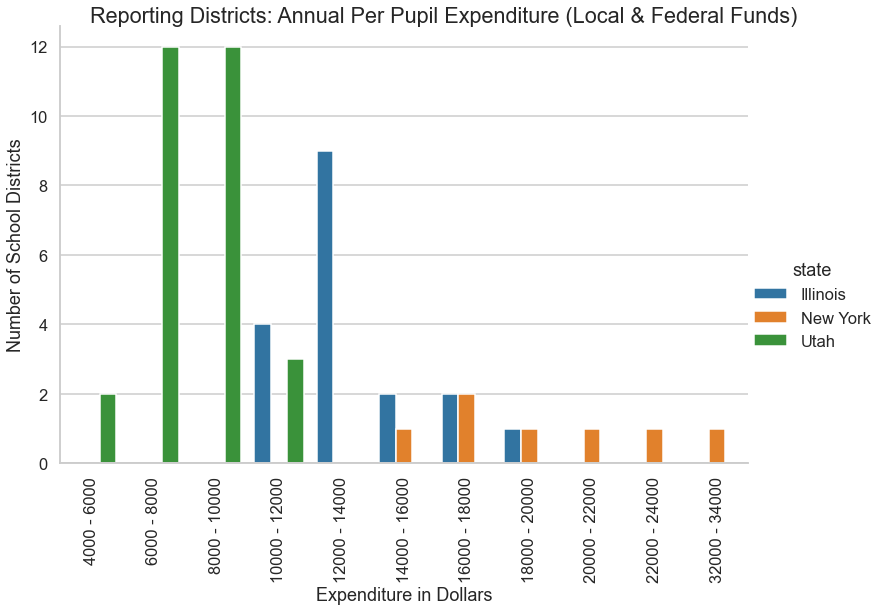

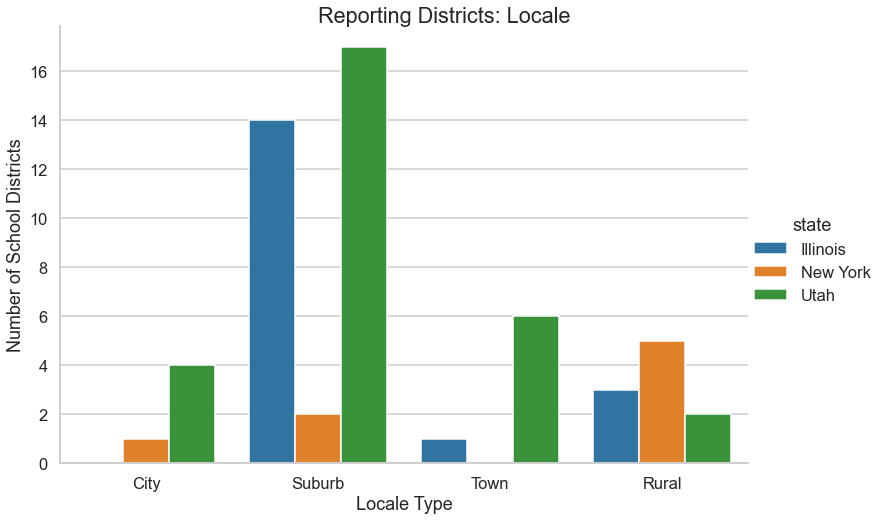

In [202]:
sns.set_style('whitegrid')
g = sns.catplot(x='pct_black_hisp', data = chosen_districts, kind='count', hue='state', height = 7, aspect = 1.5)
g.fig.suptitle ('Reporting Districts: Percent of Students Who Are Black/Hispanic', y=1)
g.set(xlabel = 'Black/Hispanic Students (% of Total)',
     ylabel = 'Number of School Districts')
print('       ')
g = sns.catplot(x='pct_freered_lunch', data = chosen_districts, kind='count', hue='state', height = 7, aspect = 1.5)
g.fig.suptitle ('Reporting Districts: Free & Reduced Lunches', y=1)
g.set(xlabel = 'Free/Reduced Lunches (% of Total)',
     ylabel = 'Number of School Districts')

g = sns.catplot(x='ann_perpupil_exp', data = chosen_districts, kind='count', hue='state', height = 7, aspect = 1.5)
g.fig.suptitle ('Reporting Districts: Annual Per Pupil Expenditure (Local & Federal Funds)', y=1)
g.set(xlabel = 'Expenditure in Dollars',
     ylabel = 'Number of School Districts')
g.set_xticklabels(rotation=90)

g = sns.catplot(x='locale', data = chosen_districts, kind='count', hue='state', height = 7, aspect = 1.5)
g.fig.suptitle ('Reporting Districts: Locale', y=1)
g.set(xlabel = 'Locale Type',
     ylabel = 'Number of School Districts')

plt.show()

#### Observations
- <b>Per Pupil Spending: </b>  New York spends the most per pupil annually of the three states.  
- <b>Rural Districts: </b> More than half of New York's eight reporting districts are classified as 'rural'.
- <b>Ethnic Diversity: </b>New York districts fall into the extremes: either 20% or less or more than 80% Black/Hispanic students.  
- <b>Economically Disadvantaged Students: </b>The free/reduced lunch statistic for New York reveals an economic diversity similar to Utah, though at least two New York districts have 80% or more students receiving free or reduced lunches.  

[Back To Top](#top)
<a id="newplots"></a>

---
# <b>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</b>
---
    

### Plotting Illinois, New York, Utah

#### Step 1: incorporating and preparing New York's engagement data

Before New York can be plotted, the state's `.csv` files must be incorporated into the engagement data.  

In [203]:
chosen_districts.dtypes

district_id             int64
POSTCODE               object
state                  object
locale               category
pct_black_hisp       category
pct_freered_lunch    category
ann_perpupil_exp     category
dtype: object

In [204]:
chosen_districts.district_id = chosen_districts.district_id.astype(str)

/Users/josephandjason/opt/anaconda3/lib/python3.8/site-packages/pandas/core/generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [205]:
#CREATE A LIST OF FILENAMES TO READ = ['1000.csv','1052.csv','1044.csv','1039.csv']

chosen_districts['csv_filenames'] = chosen_districts.district_id+'.csv'
csv_list = chosen_districts.csv_filenames.tolist()

<ipython-input-205-02b69fe9972a>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chosen_districts['csv_filenames'] = chosen_districts.district_id+'.csv'


In [206]:
#Create an empty dataframe 
engage_data = pd.DataFrame()
#Loop through list to read in .csv files 
for file_name in csv_list:
    # x is a dataframe reading in 1 csv file at a time 
    x = pd.read_csv('engagement_data/' + file_name, low_memory=False)

    # Create a new column in each dataframe to store the district code
    x['district_id'] = file_name[0:4]

    # Concatenate by rows so that glued_data is one dataframe by itself
    engage_data = pd.concat([engage_data,x],axis=0)

In [207]:
engage_data.time = pd.to_datetime(engage_data.time, infer_datetime_format=True)
engage_data.dropna(axis=0, subset=['lp_id'], inplace=True)
engage_data.dropna(subset=['pct_access'], inplace=True)
engage_data = engage_data.dropna(subset=['engagement_index'])

In [208]:
engage_data.head()

,time,lp_id,pct_access,engagement_index,district_id
0,2020-01-01,57513.0,0.49,141.28,1052
1,2020-01-01,42091.0,0.04,0.41,1052
2,2020-01-01,53399.0,0.04,8.19,1052
3,2020-01-01,32213.0,0.90,44.23,1052
4,2020-01-01,85836.0,0.04,0.41,1052


In [209]:
pc_dist = chosen_districts[['district_id', 'POSTCODE']]
pc_dist.head()

,district_id,POSTCODE
47,1052,IL
48,2285,IL
49,9553,IL
50,5042,IL
51,3248,IL


In [210]:
pc_dist.POSTCODE.unique()

array(['IL', 'NY', 'UT'], dtype=object)

In [211]:
pc_dist.dtypes

district_id    object
POSTCODE       object
dtype: object

In [212]:
engage_data = engage_data.merge(pc_dist, how='left', on='district_id')
engage_data.head(3)

,time,lp_id,pct_access,engagement_index,district_id,POSTCODE
0,2020-01-01,57513.0,0.49,141.28,1052,IL
1,2020-01-01,42091.0,0.04,0.41,1052,IL
2,2020-01-01,53399.0,0.04,8.19,1052,IL


[Back To Top](#top)
<a id="replot"></a>

### Step 2: The Plots

<a id="note"></a>
<b>NOTE:</b> After plotting this second series with New York, it became clear that the districts needed plotting in order by a particular metric, to facilitate some comparisons. I chose the <b>daily average engagement level for the entire year</b> as a method to organize the printing of the plots, and created a function to sort the districts by this metric, and to store the engagement level for each district.  


______________________________
______________________________
STATE: IL


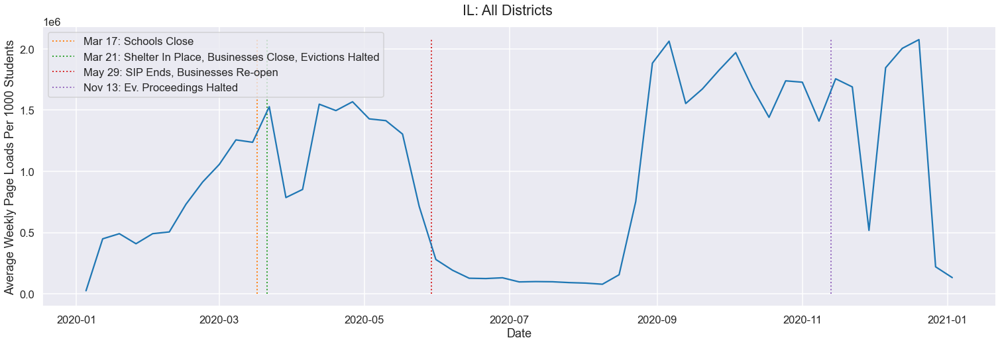

DISTRICT 2779 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 88344
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Rural
          


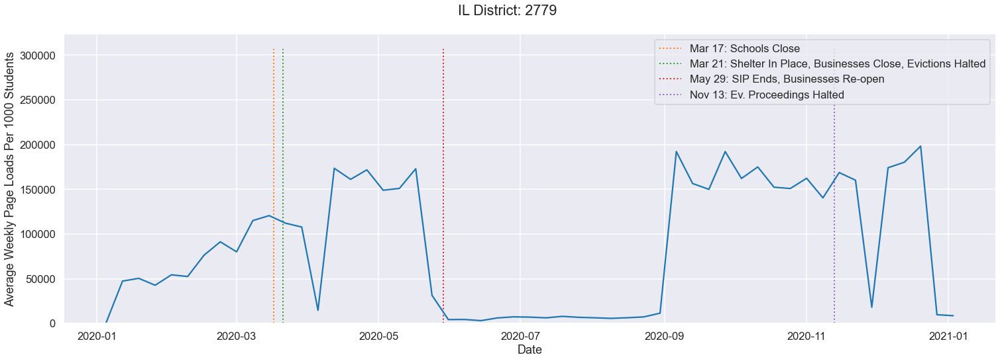

DISTRICT 8815 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 85481
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          


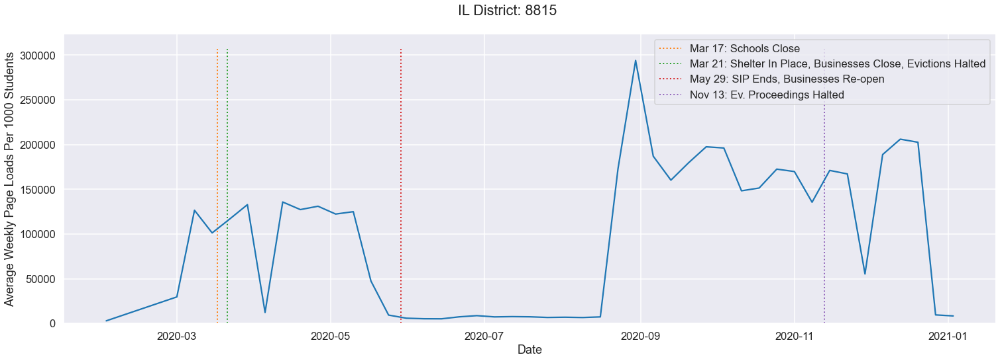

DISTRICT 9553 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 83851
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          


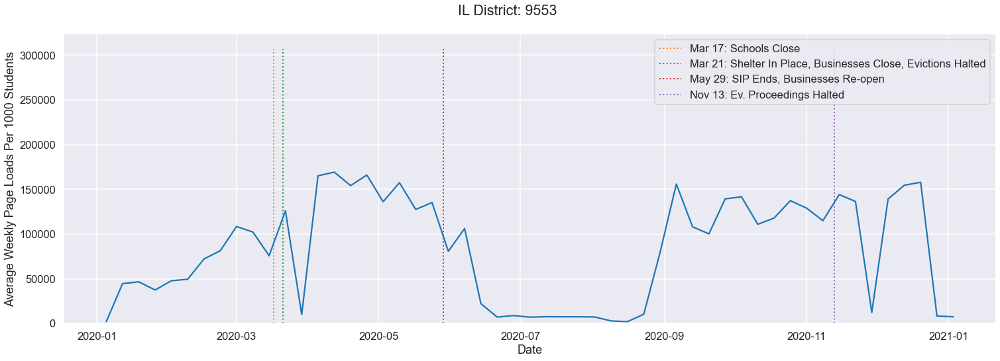

DISTRICT 5890 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 76169
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $18000 - 20000
District Locale: Suburb
          


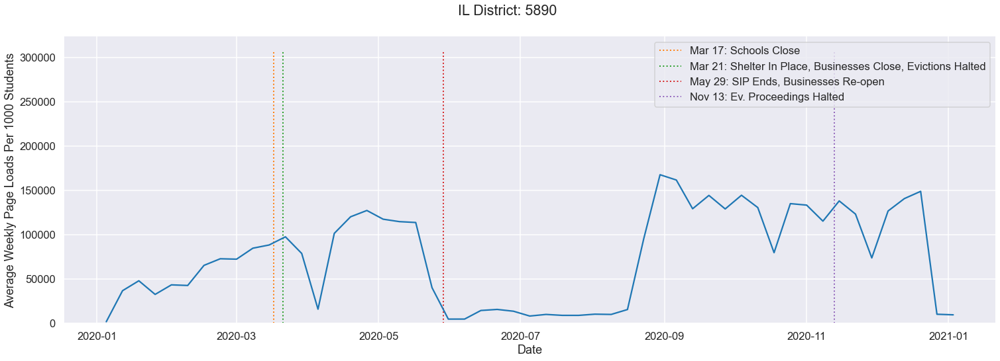

DISTRICT 2393 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 71574
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


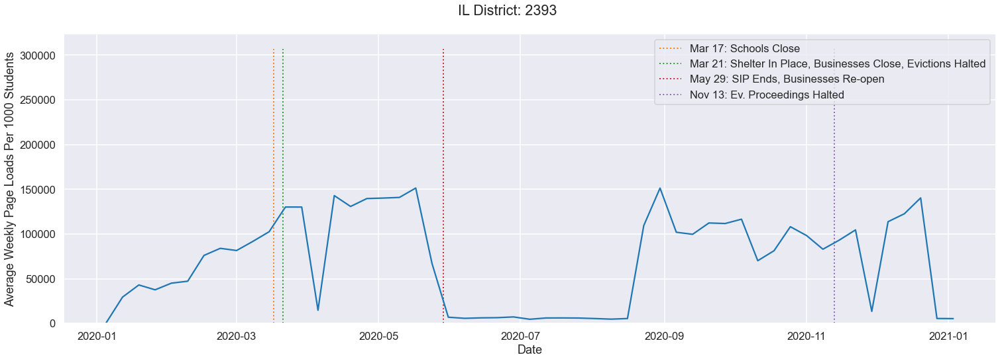

DISTRICT 6577 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 70904
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Suburb
          


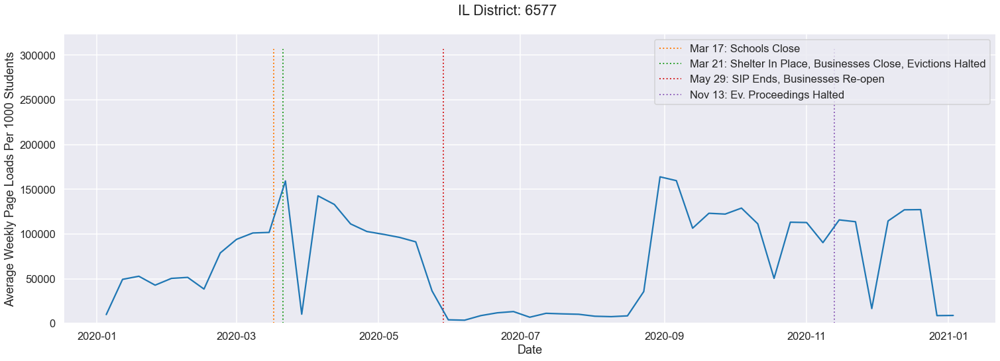

DISTRICT 4629 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 60651
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Suburb
          


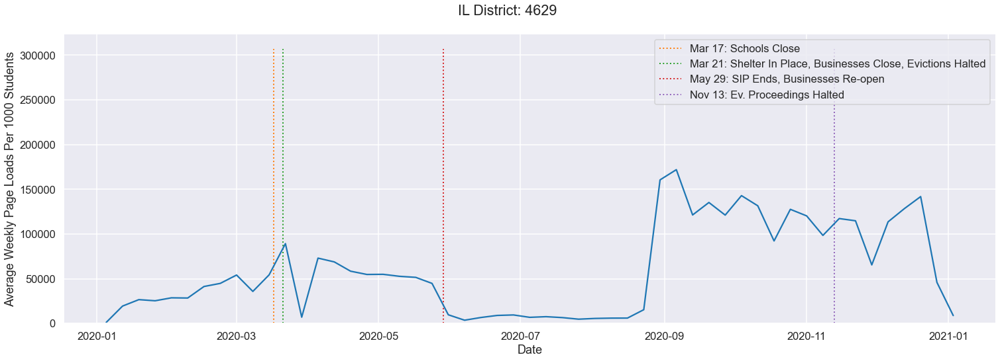

DISTRICT 1712 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 60575
Black & Hispanic Students: 40% - 60%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


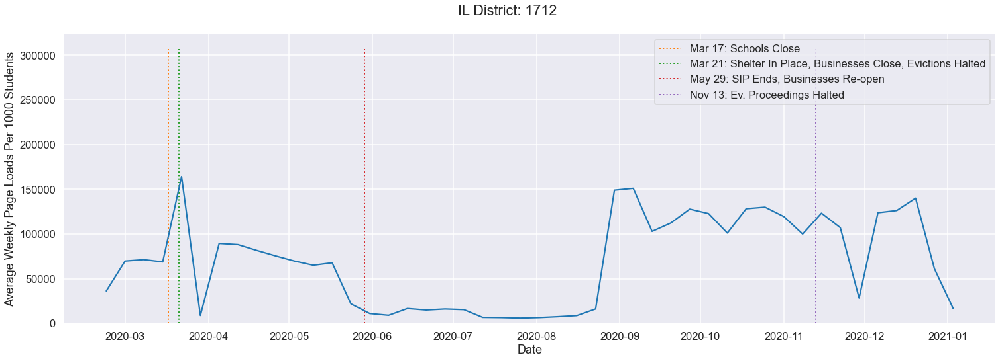

DISTRICT 8937 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 53489
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Rural
          


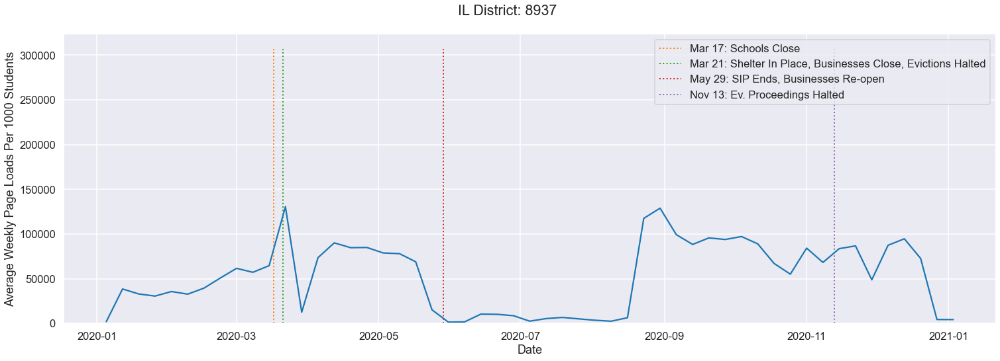

DISTRICT 1052 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 52684
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Suburb
          


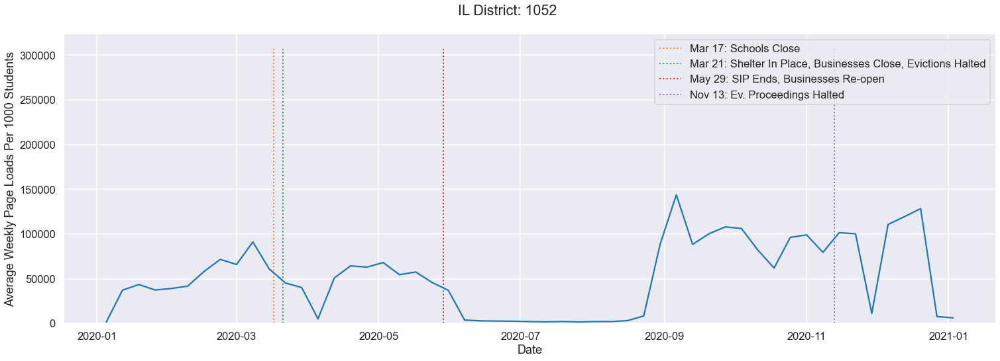

DISTRICT 3248 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 50998
Black & Hispanic Students: 60% - 80%
Students With Free or Reduced Lunches: 60% - 80%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


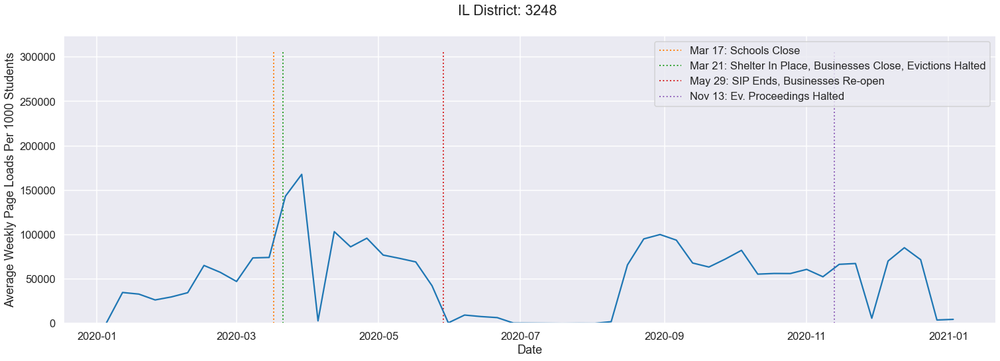

DISTRICT 8784 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 47232
Black & Hispanic Students: 60% - 80%
Students With Free or Reduced Lunches: 60% - 80%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Suburb
          


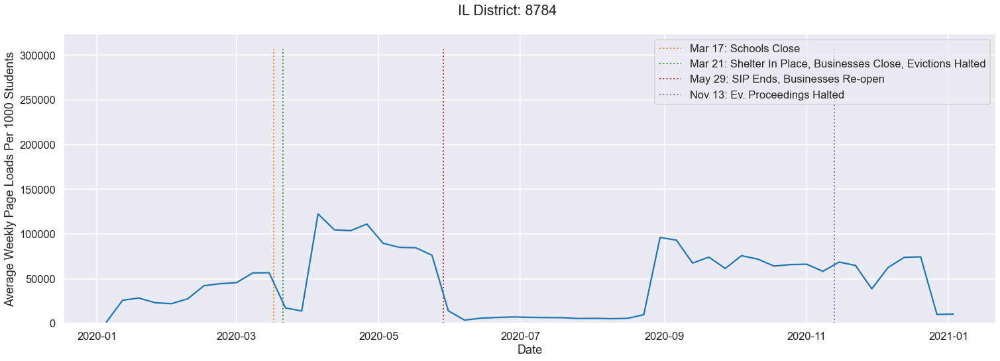

DISTRICT 9899 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 43419
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


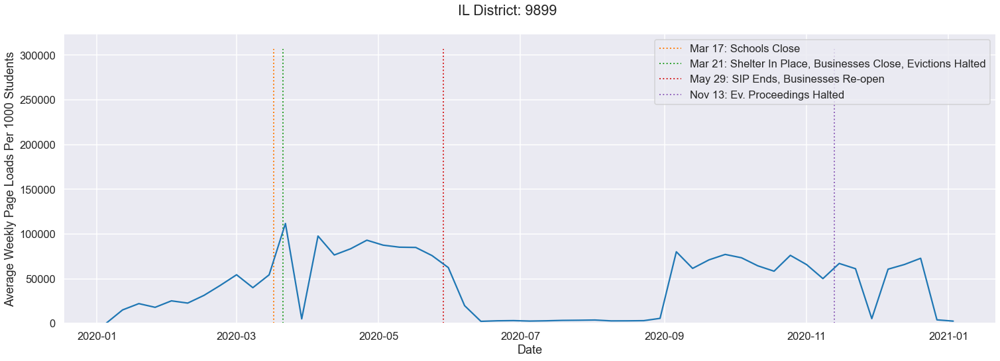

DISTRICT 2601 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 40120
Black & Hispanic Students: 60% - 80%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


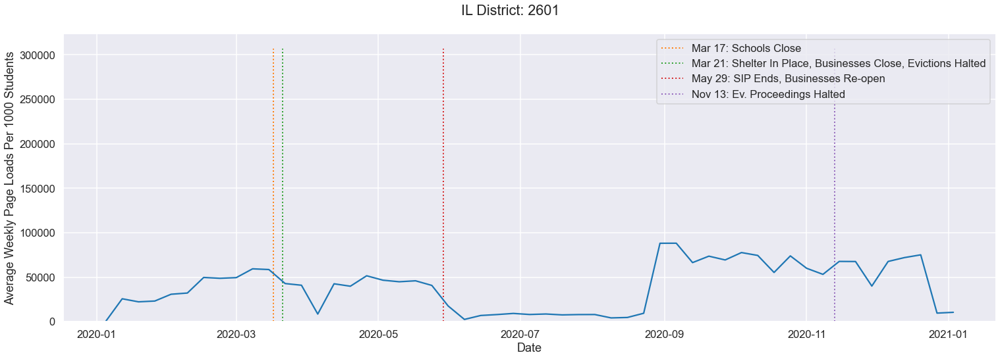

DISTRICT 1877 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 39494
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Rural
          


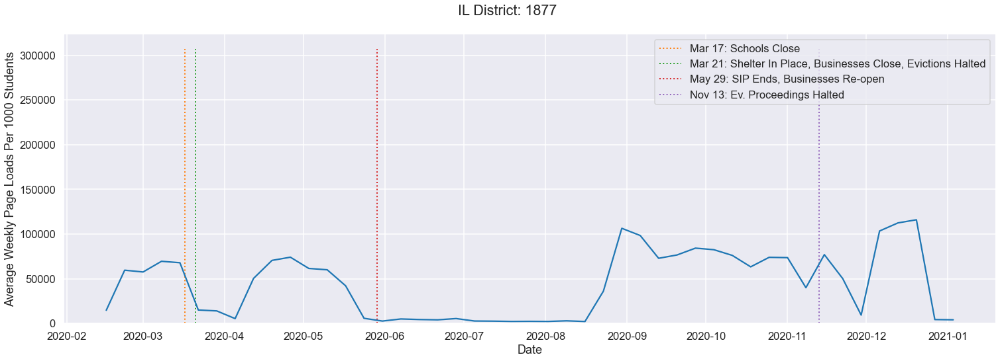

DISTRICT 9043 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 35010
Black & Hispanic Students: 80% - 100%
Students With Free or Reduced Lunches: 80% - 100%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


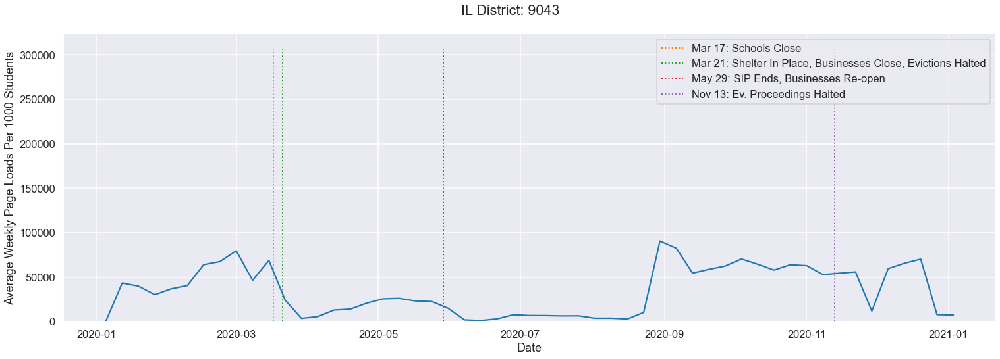

DISTRICT 2285 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 25664
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          


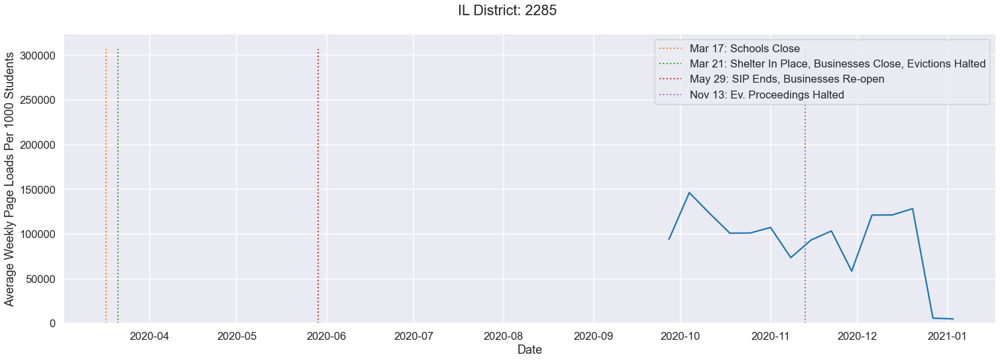

DISTRICT 5042 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 2290
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 80% - 100%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          


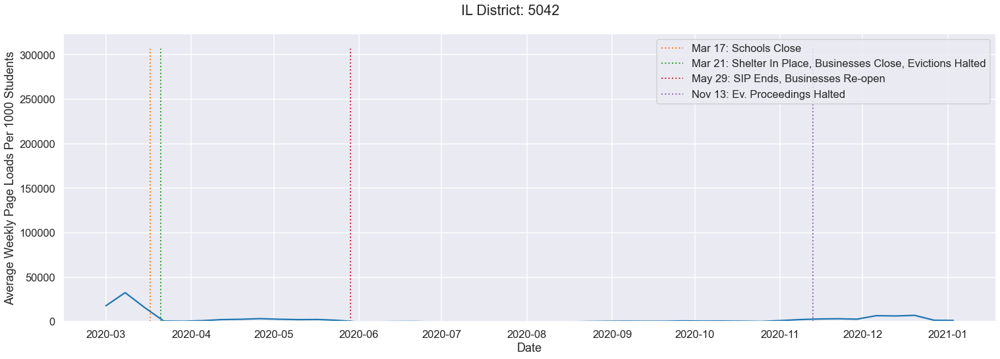

______________________________
______________________________
STATE: NY


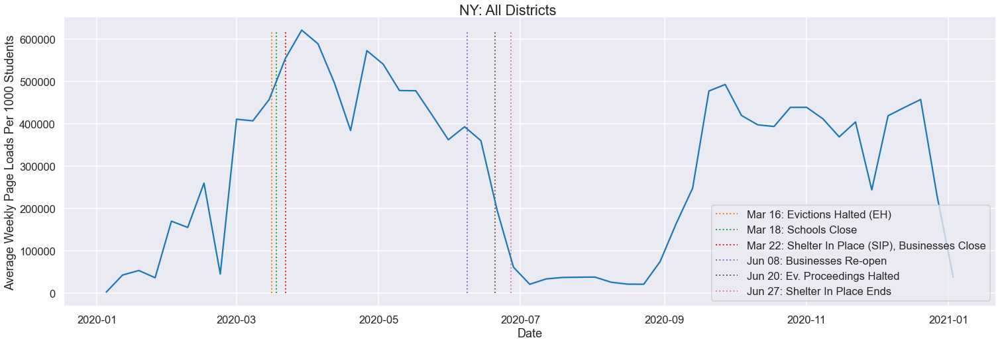

DISTRICT 9536 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 85827
Black & Hispanic Students: 80% - 100%
Students With Free or Reduced Lunches: 80% - 100%
Per Pupil Yearly Expenditure: Not Reported
District Locale: City
          


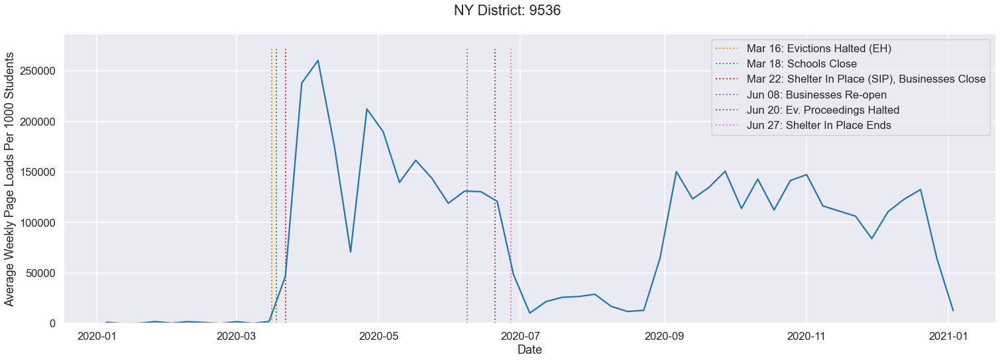

DISTRICT 7798 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 50443
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $22000 - 24000
District Locale: Rural
          


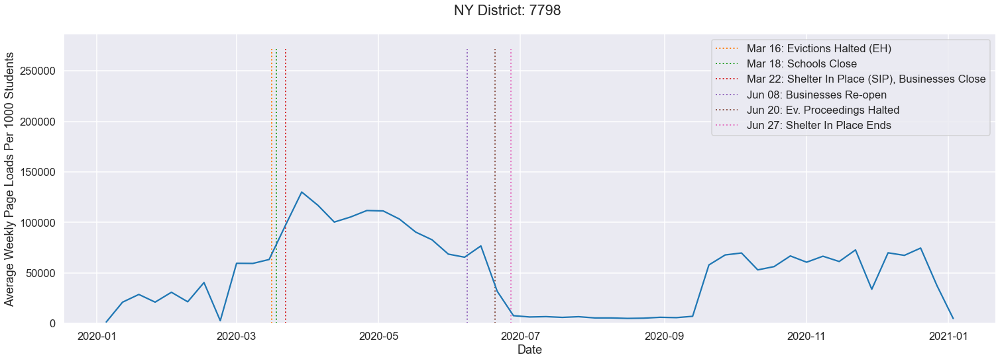

DISTRICT 2257 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 46807
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $20000 - 22000
District Locale: Rural
          


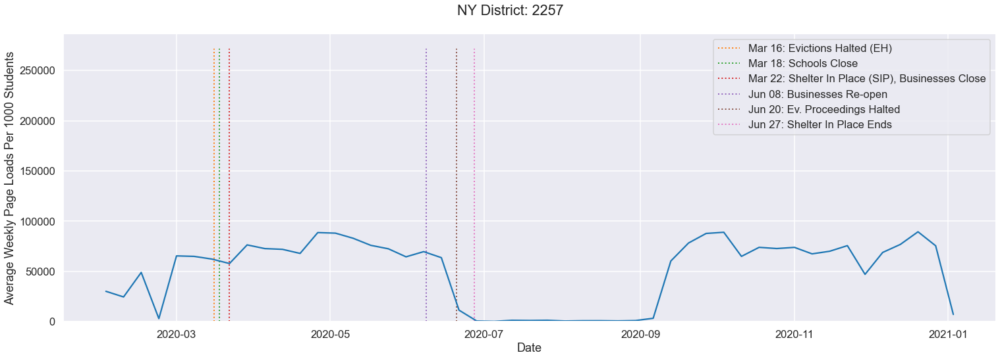

DISTRICT 1470 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 35137
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $32000 - 34000
District Locale: Rural
          


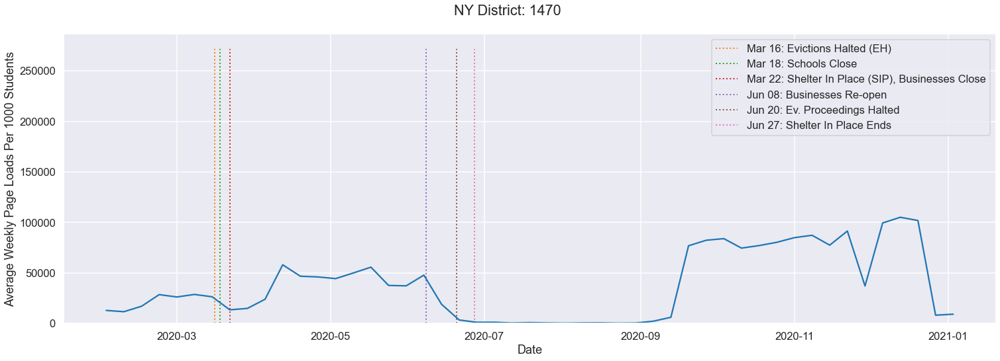

DISTRICT 8520 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 33452
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Rural
          


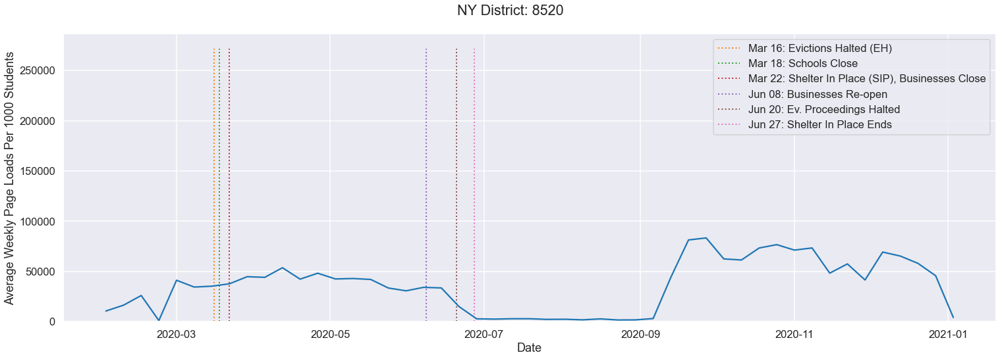

DISTRICT 4775 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 18116
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Suburb
          


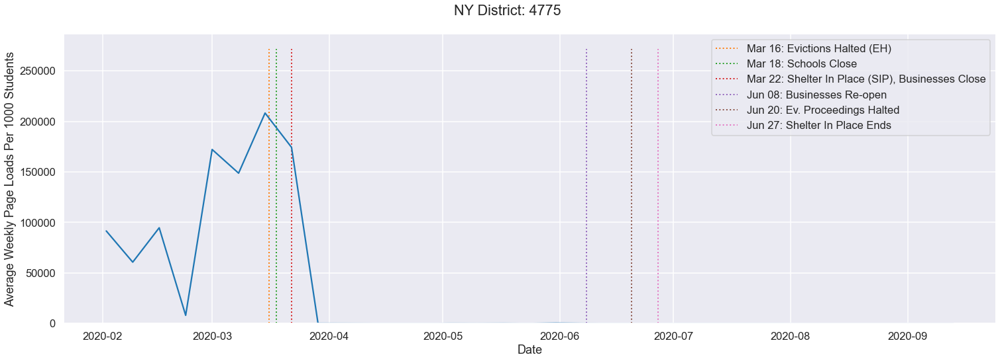

DISTRICT 9515 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 16810
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $18000 - 20000
District Locale: Rural
          


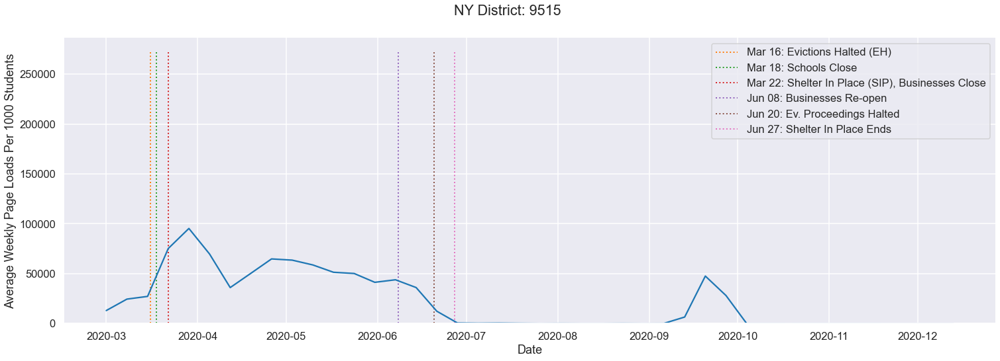

DISTRICT 2940 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 6354
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          


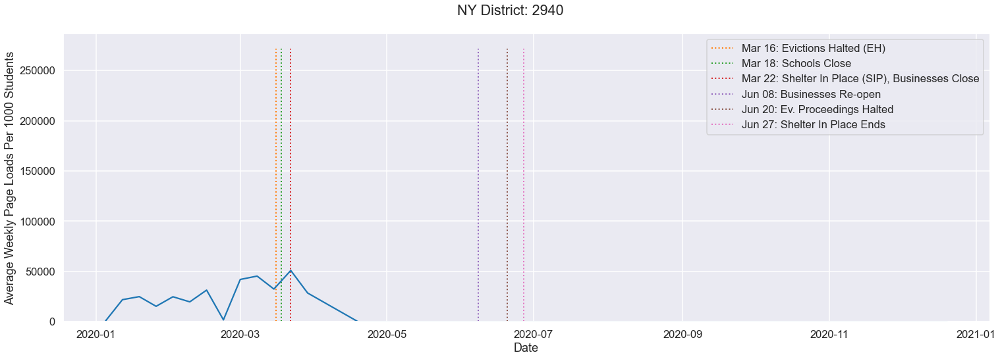

______________________________
______________________________
STATE: UT


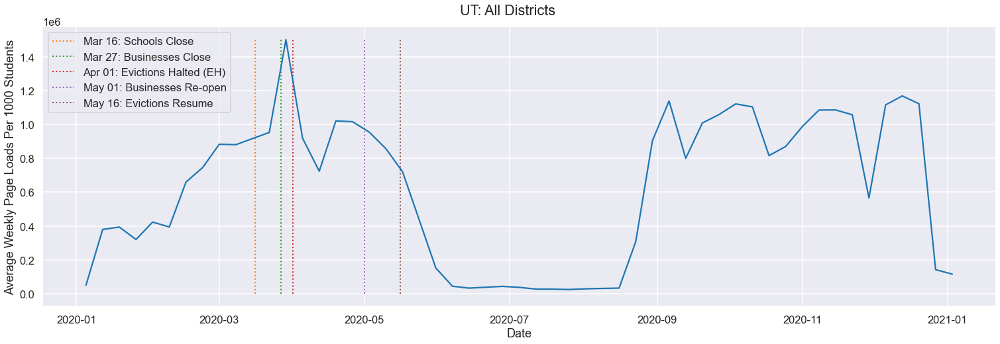

DISTRICT 5231 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 55183
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          


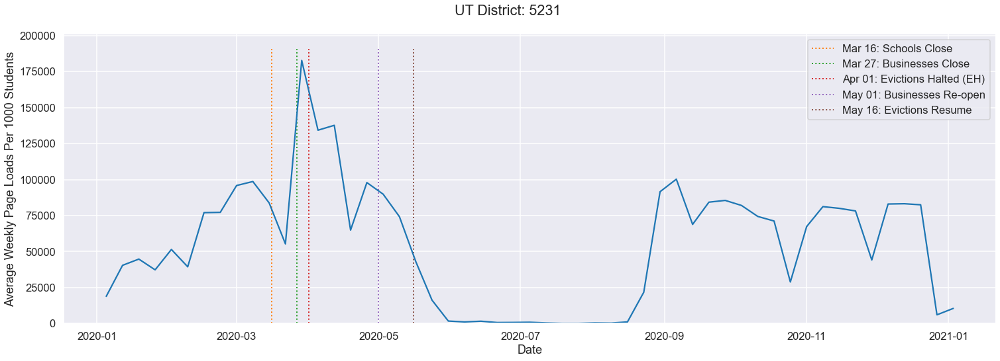

DISTRICT 4744 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 53896
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


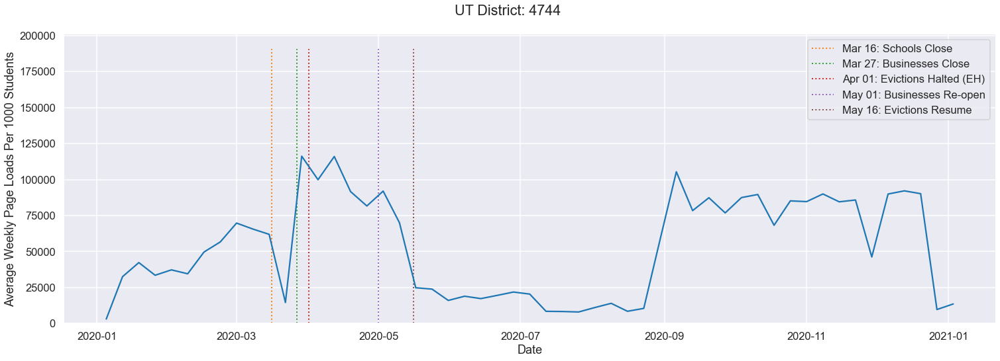

DISTRICT 4936 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 40153
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


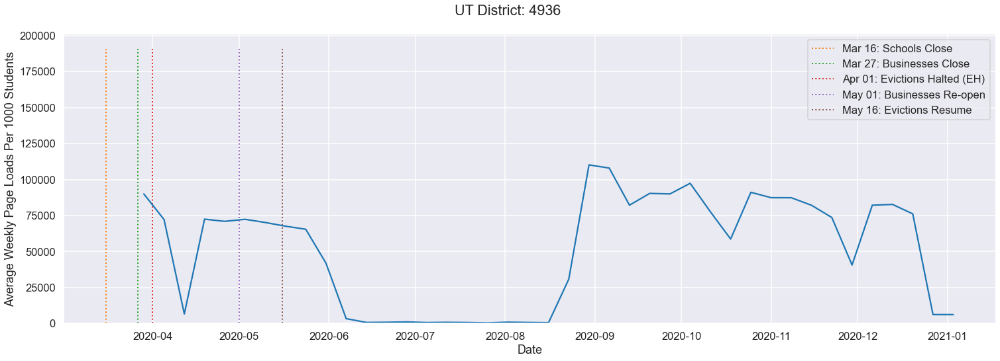

DISTRICT 9812 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 31415
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


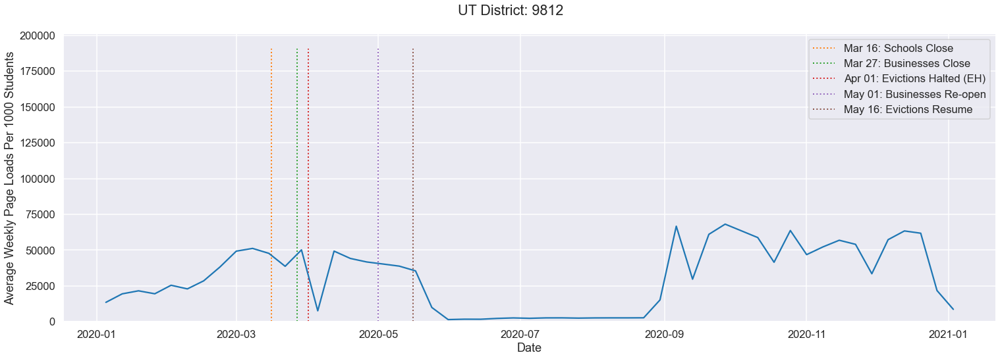

DISTRICT 3692 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 30692
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


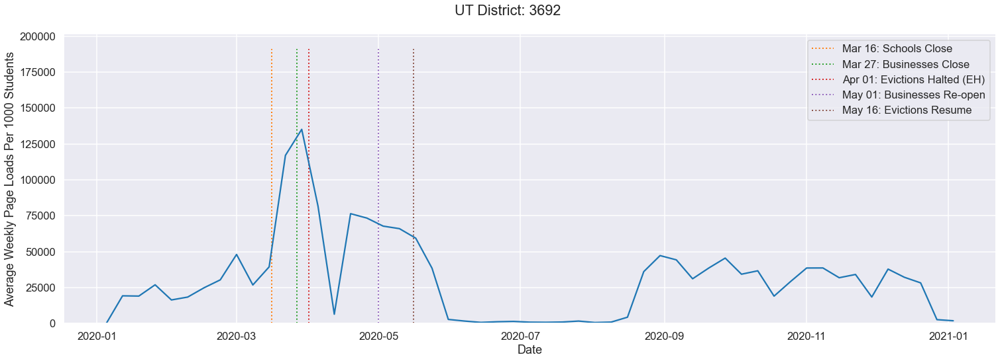

DISTRICT 7541 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 29469
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


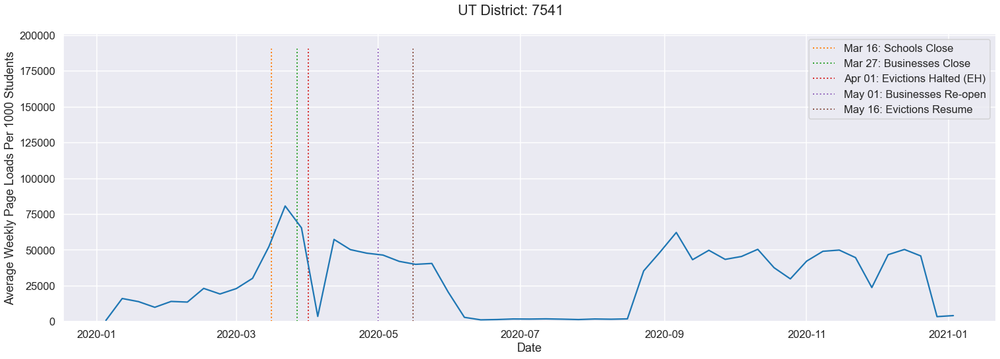

DISTRICT 6762 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 27481
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $4000 - 6000
District Locale: Suburb
          


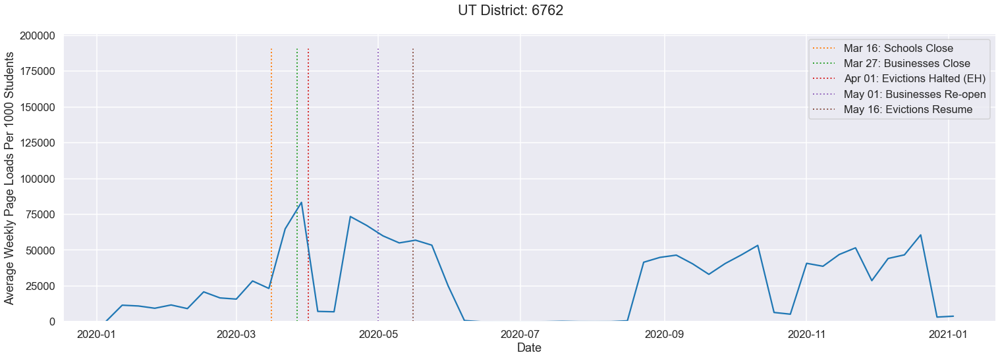

DISTRICT 8328 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 27034
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          


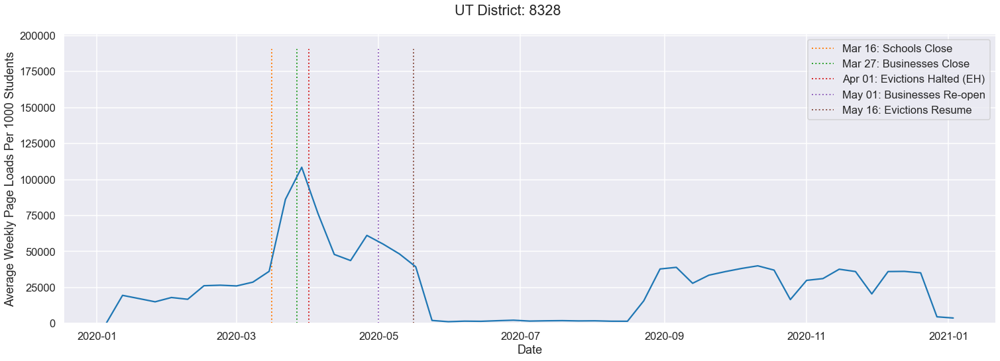

DISTRICT 7614 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 26693
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: City
          


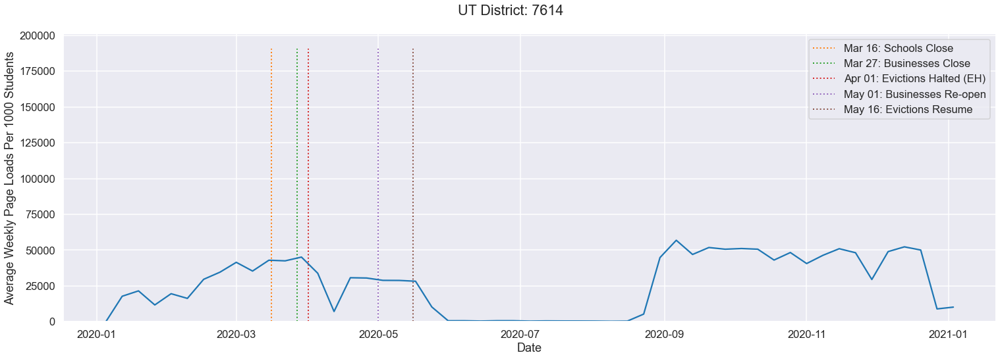

DISTRICT 3266 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 22699
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          


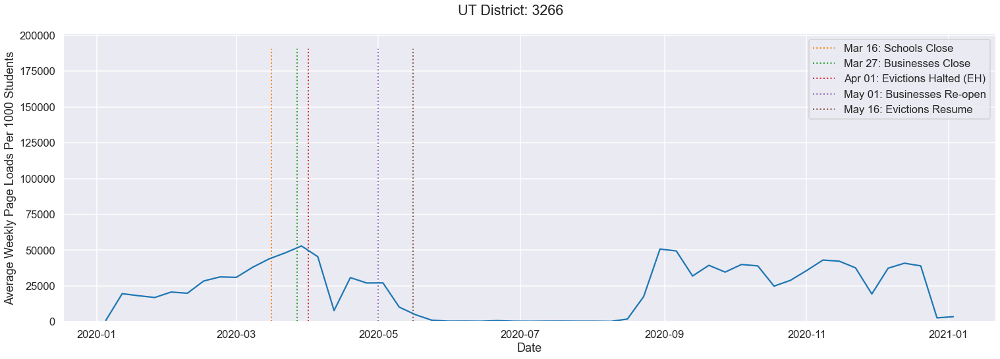

DISTRICT 4668 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 22385
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


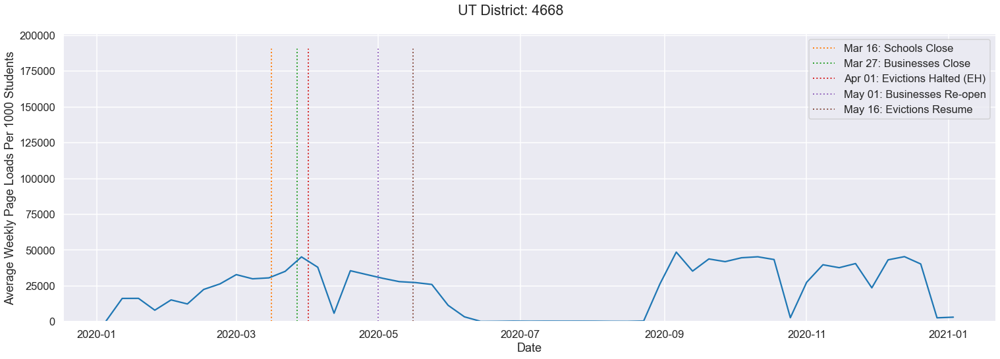

DISTRICT 4921 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 21136
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


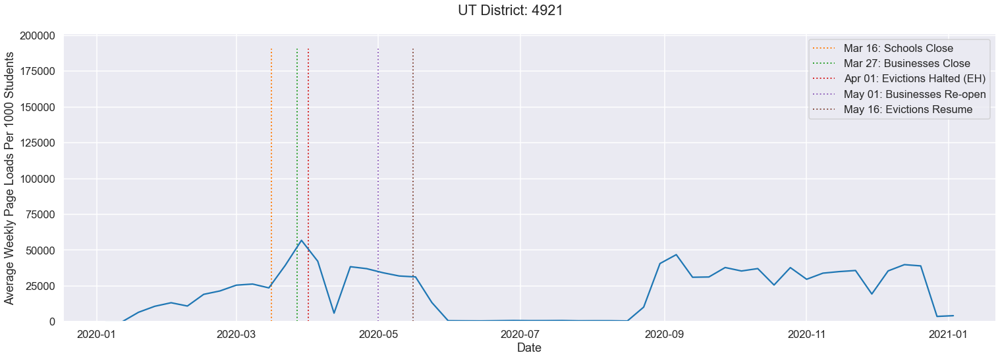

DISTRICT 1772 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 20629
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: City
          


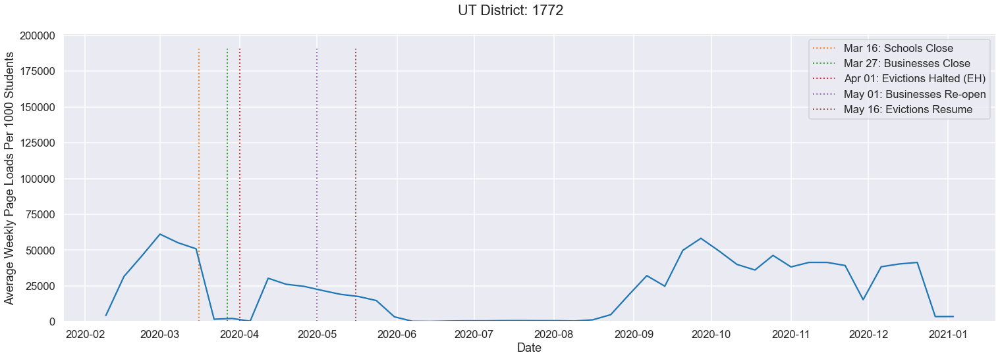

DISTRICT 1270 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 20328
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Rural
          


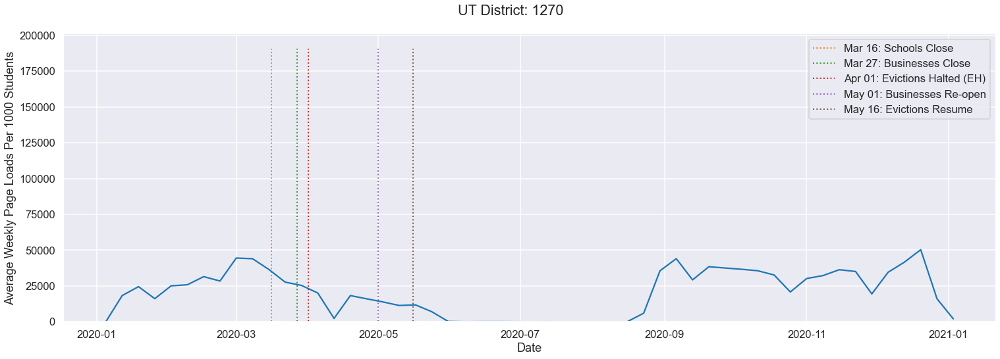

DISTRICT 5600 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 18742
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


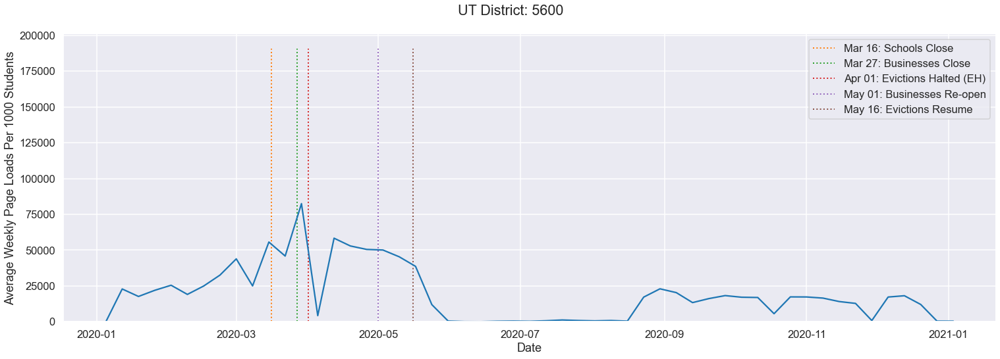

DISTRICT 3160 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 18491
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


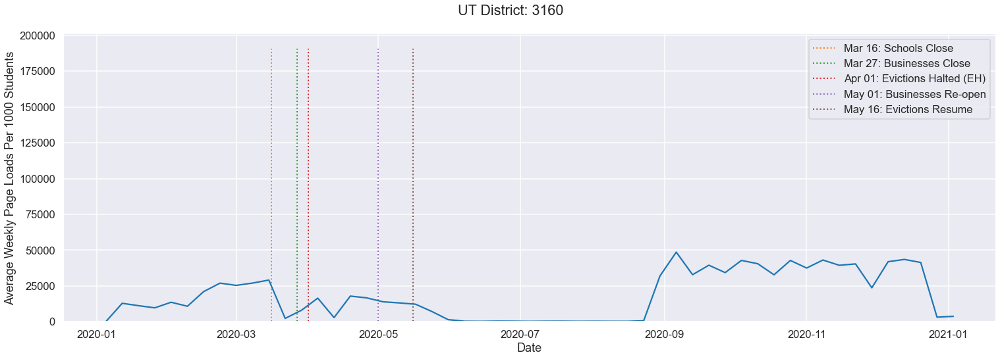

DISTRICT 2441 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 18223
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Town
          


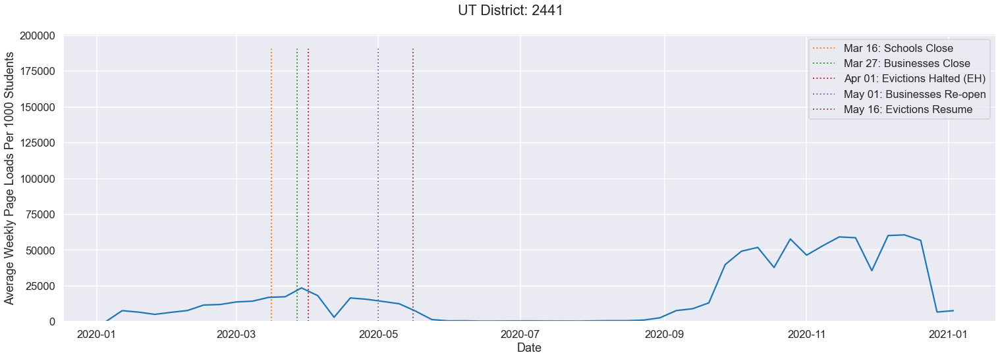

DISTRICT 7387 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 17825
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: City
          


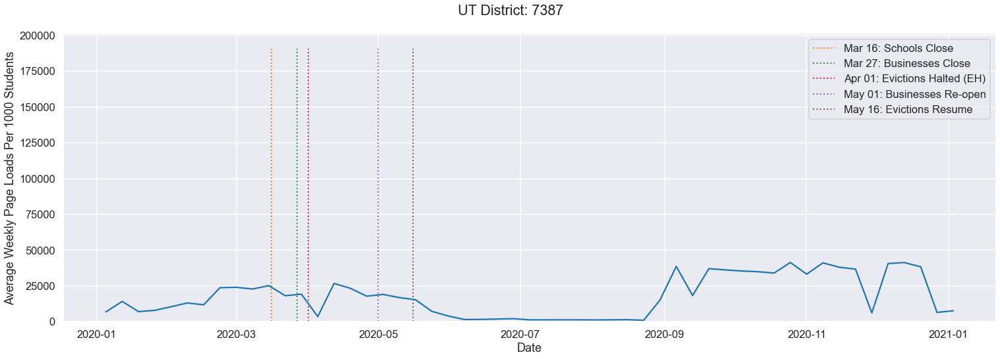

DISTRICT 7660 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 17606
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


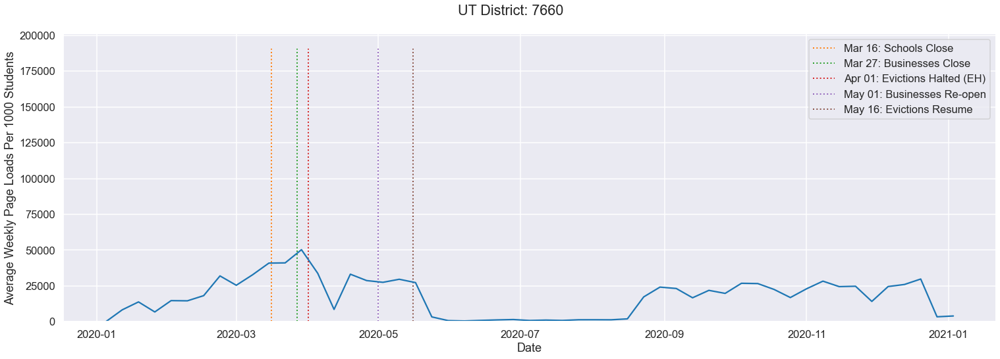

DISTRICT 9230 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 16410
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Rural
          


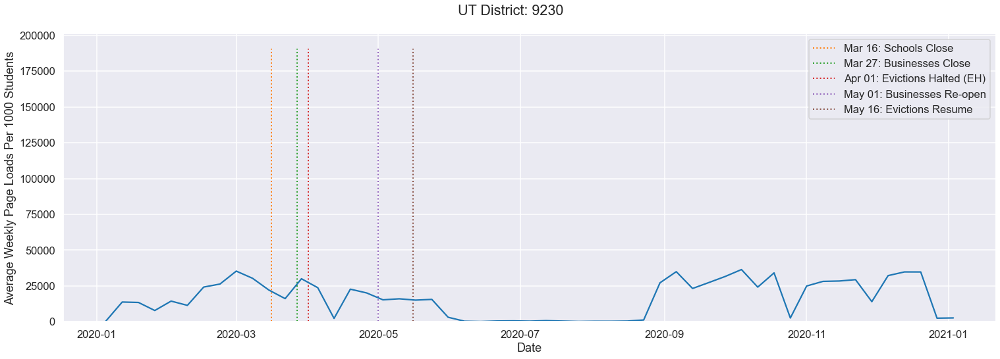

DISTRICT 9778 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 16300
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Town
          


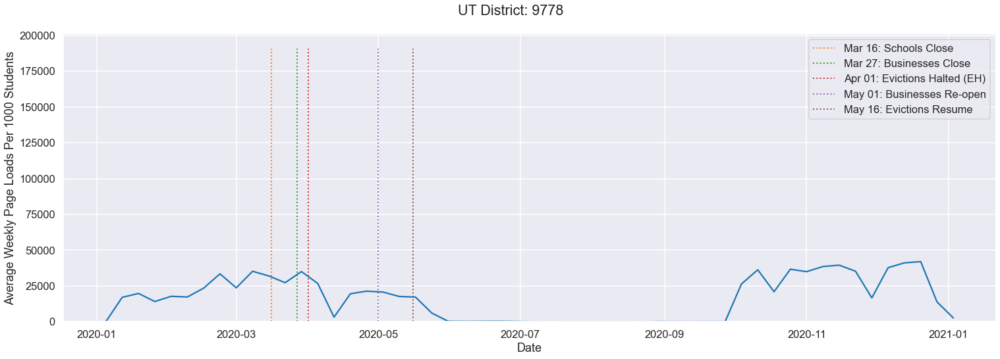

DISTRICT 3710 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 15667
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


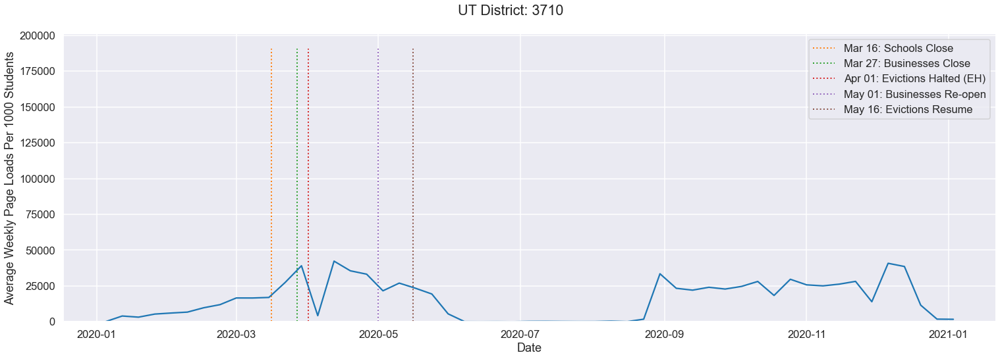

DISTRICT 1204 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 15115
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


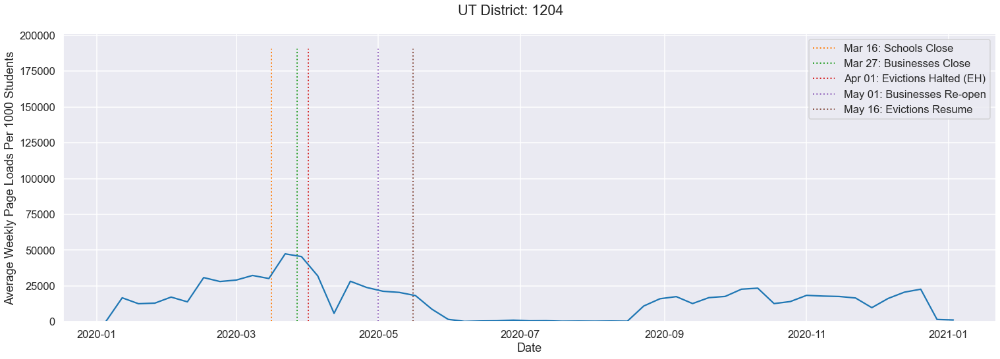

DISTRICT 3772 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 11997
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          


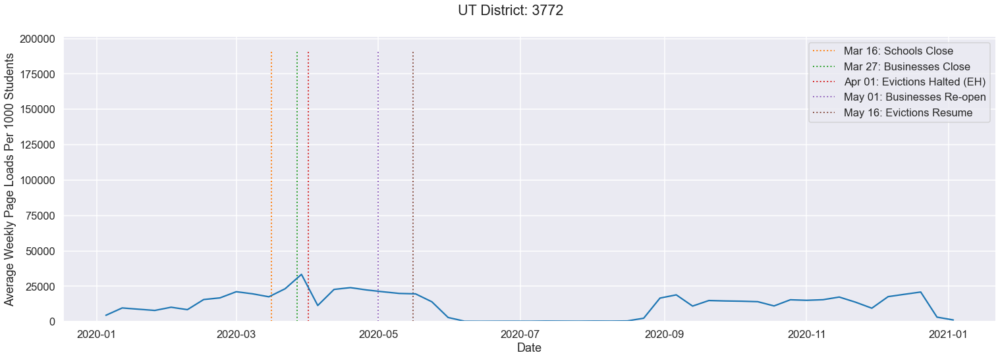

DISTRICT 3864 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 11919
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


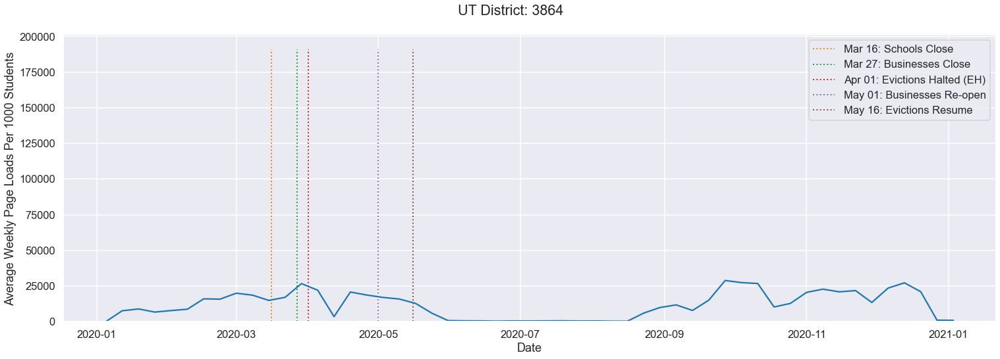

DISTRICT 2165 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 8580
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          


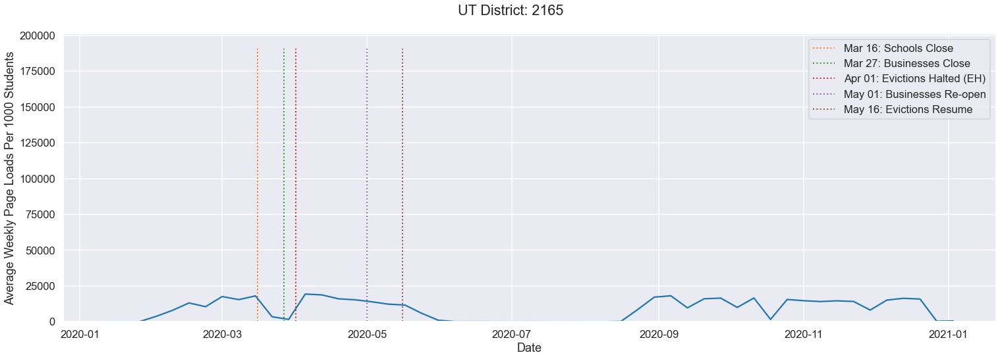

DISTRICT 4183 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 7581
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Town
          


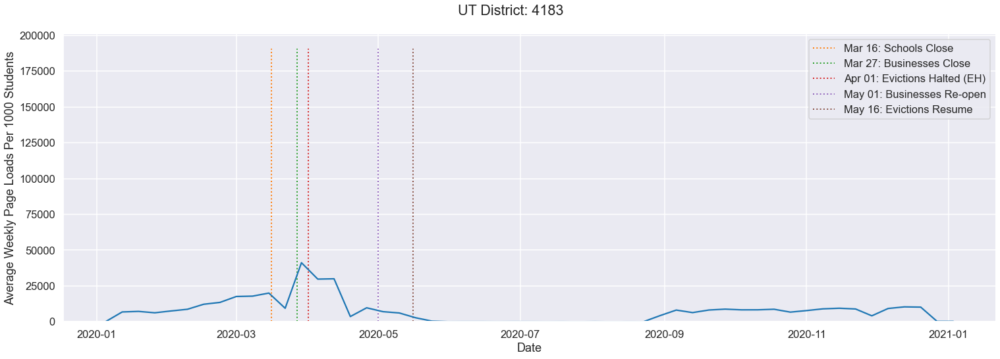

DISTRICT 7308 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 6663
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $4000 - 6000
District Locale: Suburb
          


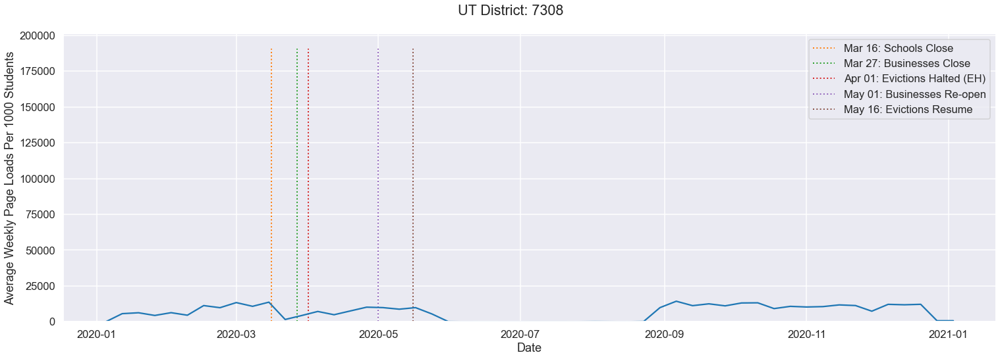

DISTRICT 4373 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 4327
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: City
          


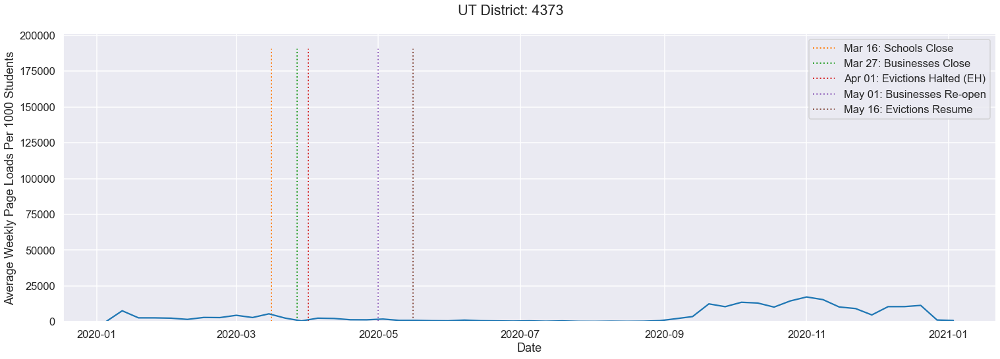

In [213]:
#function to sort districts into a list in descending order by yearly avg. of daily engagement totals
def dist_sort(dframe):
    daysum = pd.DataFrame(dframe.groupby(['district_id', 'time']).engagement_index.sum())
    daysum = daysum.reset_index('district_id')
    distavg = pd.DataFrame(daysum.groupby([pd.Grouper (freq='Y'), 'district_id']).engagement_index.sum()/366)
    distavg = distavg.reset_index()
    distavg = distavg.drop('time', axis='columns')
    distavg = distavg.sort_values('engagement_index', ascending=False, ignore_index=True)
    x = distavg.district_id.tolist()
    y = distavg.engagement_index.tolist()
    return(x, y)
    
pcodes = ['IL', 'NY', 'UT']
    
    
sns.set_style('darkgrid')
for state in pcodes:
    state_engage = engage_data[engage_data.POSTCODE == state]
    state_districts, dist_avg = dist_sort(state_engage) #call sorting function above!
    
    #aggregates engagement_index as the sum of all daily values
    state_daysum = pd.DataFrame(state_engage.groupby('time').engagement_index.sum()) 
    
    #variables to store lists for vertical lines
    state_defs = []
    #creates list of dates from index values where value for the date is not null
    date_list = state_c19_dates.index[state_c19_dates[state].notnull()] 
    nannies = state_c19_dates[state].tolist()            #list with nans
    state_codes = [x for x in nannies if str(x) !='nan'] #this removes nans, leaving just codes

    #loop creates list of definitions coresponding to codes
    for codey in state_codes:
        x=code_list.loc[code_list.code==codey, 'definition'].iloc[0]
        state_defs.append(x)
        
    colours = ['C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9'] #creates list of colors to map to each vertical line 
    
    #this code gets max value for y axis for each state, so district plots have the same y-axis
    dists = state_engage.groupby(['time', 'district_id']).sum()
    dists = dists.reset_index('district_id')   #this removes multi-index
    dists_resample = dists.groupby([pd.Grouper(freq='W'), 'district_id'])['engagement_index'].mean()
    zee = dists_resample.max()
    max_val = zee*1.1

    #plot state level engagement data
    print('______________________________') #prints a line between states and the state name
    print('______________________________')
    print("STATE: "+ state)
        
    '''
    These next two lines find the maximum daily average engagement value
    and save it to a variable to use as the upper limit for the vertical lines in the plot
    '''
    
    state_means = state_daysum.resample('W').mean()
    state_max = state_means.engagement_index.max()
    y_max1 = state_max
    
    g = sns.relplot(x='time', y='engagement_index', data=state_daysum.resample('W').mean(), height=7, aspect=3, kind='line', ci=None)
    g.set(xlabel='Date', 
         ylabel='Average Weekly Page Loads Per 1000 Students')

    #this loop generates the vertical lines and labels for each line
    for i in range(0, len(date_list)):
        plt.vlines(x=date_list[i], ymin=0, ymax=y_max1, colors=colours[i],  linestyle = 'dotted', lw=2, label = date_list[i].strftime('%b %d') + ': ' +state_defs[i])
    g.fig.suptitle(state + ': '+ 'All Districts', y=1)
    plt.legend(loc='best')
    plt.show()

    inc = 0
    #plot DISTRICT level engagement data
    for dist in state_districts:
        district_df = state_engage[state_engage.district_id==dist]  #subsets state_engage by district 
        dist_daysum = pd.DataFrame(district_df.groupby('time').engagement_index.sum())
        dist_num = dist
    
        #these next five lines gather demographic values for the district from chosen_districts dataframe
        race_pct = chosen_districts.loc[chosen_districts.district_id==dist_num, 'pct_black_hisp'].iloc[0]
        free_lunch_pct = chosen_districts.loc[chosen_districts.district_id==dist_num, 'pct_freered_lunch'].iloc[0]
        per_pupil = chosen_districts.loc[chosen_districts.district_id==dist_num, 'ann_perpupil_exp'].iloc[0]
        locale = chosen_districts.loc[chosen_districts.district_id==dist_num, 'locale'].iloc[0]
        d_avg = int(dist_avg[inc])
    
        #Demographic info loop: prints title and any existing demographics for district
        print('\033[4mDISTRICT '+ dist + ' DEMOGRAPHICS\033[0m')
        print('Average Daily Page Loads Per 1000 Students: '+ str(d_avg))
        inc = inc+1
        print('Black & Hispanic Students: '+ race_pct)
        print('Students With Free or Reduced Lunches: '+ free_lunch_pct)
       
        if pd.notnull(per_pupil)==True:
            print('Per Pupil Yearly Expenditure: $'+ per_pupil)
        else:
            print('Per Pupil Yearly Expenditure: Not Reported')

        print('District Locale: ' + locale)
        print('          ')
        
        #establishes maximum value for y axis
        district_max = max_val*0.95
        y_max2 = district_max
        g = sns.relplot(x='time', y='engagement_index', data=dist_daysum.resample('W').mean(), height=7, aspect=3, kind='line', ci=None)
        g.set(ylim=(0, max_val))
        g.set(xlabel='Date', 
             ylabel='Average Weekly Page Loads Per 1000 Students')

        
        #this loop generates vertical lines and labels for each line
        for i in range(0, len(date_list)):
            plt.vlines(x=date_list[i], ymin=0, ymax=y_max2, colors=colours[i], lw=2,linestyle = 'dotted', label = date_list[i].strftime('%b %d') + ': ' + state_defs[i])
        g.fig.suptitle(state + ' District: '+ dist, y=1.05)
        plt.legend(loc='best')
        plt.show()
       

[Back To Top](#top)
<a id="plotobs"></a>

### Observations 

#### Quick Code Tweaks to Improve Existing Plots
- By ordering the list of districts for each state in order of yearly engagement average (either ascending or descending), this might highlight differences in demographics relative to engagement levels.  If above graphs are so ordered, this change has been implemented. [see note above](#note)

#### Revelations of the sorted view

<b>General observations</b>

- Higher Per Pupil Spending is roughly correlated to higher engagement levels EXCEPT in districts with a higher percentage of economically disadvantaged students (as exemplified by a higher percentage of free/reduced lunches). 
- Districts with a lower percentage of economically disadvantaged students and lower per pupil spending often have higher engagement levels than districts with higher levels in both these metrics.  
- As percentages of Black/Hispanic students rise, engagement levels decline (although there are a few outlier districts that do not conform to this pattern). 
  
<b>Illinois's 18 districts:</b>. 
- Daily Average Engagement Range: 2290 (partial year) to 88,344 page loads per 1000 students 
- As the percentage of Black/Hispanic students increases, engagement levels generally decrease.  
- Districts with higher levels of both Black/Hispanic students AND economically disadvantaged students generally have lower engagement levels, regardless of per pupil spending.  
- As Per Pupil spending decreases, engagement levels generally decrease, but see caveats under 'General Observations' above.  
- One rural district with 20% or less Black/Hispanic students and 20% or less free/reduced lunches has engagement levels on par with more racially and economically diverse suburban districts. 
  
  
<b>New York's 8 districts: </b>  
- Daily Average Engagement Range: 6354 (partial year) to 85,827 page loads per 1000 students 
- Outliers: 
  - New York's best performing district has an average daily engagment level of 85,827.  The next highest district's level is 50,443. This top-performing district is therefore an outlier among reporting districts in the state. 
  - New York's best performing district has more than 80% Black/Hispanic students and more than 80% of students receive free and reduced lunches.  <b>Per Pupil Spending was not reported for this district.</b> 
  - One New York district has the highest reporting per pupil annual expenditure of all the districts reporting, at 32000 to 34000 per pupil.  It is a rural district with 40% - 60% free/reduced lunches, and its engagement levels are less than half of New York's best performing district.  
- Aside from these two "spoiler" districts, the general observations and observations for Illinois above are generally true for New York as well. 
 
<b>Utah's 29 districts: </b>
- Daily Average Engagement Range: 6663 to 55,183 page loads per 1000 students (all districts reporting full year)
- Utah has less racial diversity among its districts; the percentage of Black/Hispanic students has a weaker relationship to the engagement index than other metrics. 
- Per Pupil spending seems positively correlated with engagement levels, except in districts with higher levels of economically disadvantaged students, as mentioned previously.  
  


#### Ordering the printed plots by daily average engagement for the year
Test code prior to creating a function to automate this process

    il_engage = engage_data[engage_data.POSTCODE=='IL']
    il_engage.head()

    #dists_resample = dists.groupby([pd.Grouper(freq='W'), 'district_id'])['engagement_index'].mean()

    #state_daysum = pd.DataFrame(state_engage.groupby('time').engagement_index.sum()) 
    il_daysum = pd.DataFrame(il_engage.groupby(['district_id', 'time']).engagement_index.sum())

    il_daysum.head(3)

    il_daysum = il_daysum.reset_index('district_id')

    il_engage_distavg = pd.DataFrame(il_daysum.groupby([pd.Grouper(freq='Y'), 'district_id']).engagement_index.mean())


    il_engage_distavg = il_engage_distavg.reset_index()
    il_engage_distavg = il_engage_distavg.drop('time', axis='columns')

    il_engage_distavg = il_engage_distavg.sort_values('engagement_index', ascending=False, ignore_index=True)
    il_engage_distavg

    dist_list = il_engage_distavg.district_id.tolist()

    dist_list`

[Back To Top](#top)
<a id="distsort"></a>

### <span style='color:red'>FUNCTION: Sorting districts by yearly average</span>
This function has been incorporated into the plotting code above

In [214]:
def dist_sort(dframe):
    daysum = pd.DataFrame(dframe.groupby(['district_id', 'time']).engagement_index.sum())
    daysum = daysum.reset_index('district_id')
    distavg = pd.DataFrame(daysum.groupby([pd.Grouper (freq='Y'), 'district_id']).engagement_index.sum()/366)
    distavg = distavg.reset_index()
    distavg = distavg.drop('time', axis='columns')
    distavg = distavg.sort_values('engagement_index', ascending=False, ignore_index=True)
    x = distavg.district_id.tolist()
    y = distavg.engagement_index.tolist()
    return(x, y)
    

In [215]:
#testing the function-- it works, returning a list of districts and another list of yearly average engagement levels
il_engage = engage_data[engage_data.POSTCODE=='IL']
dist_list, dist_avg = dist_sort(il_engage)

[Back To Top](#top)
<a id="correlations"></a>

---
# <b>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</b>
---

### <u>3. Correlating the Engagement Data with the Kids Count Statistics</u>

The Kids Count data I have chosen comprises three datasets, that measure on a weekly basis the percentages of households in the state that:
- Have access to both a device and a high speed connection to use specifically for educational purposes
- Have suffered a loss of income due to the pandemic
- Have experienced a change in education venue or method due to the pandemic, as follows: 
  - Classes were cancelled
  - Classes switched to online distance learning
  - Classes switched to paper distance learning
  - Classes were held at school
  - Classes changed in some other way

The 'change in education' statistic will be treated as five separate statistics, because it and the other two metrics above are measured independently for several populations in the state:
 - the Black/Hispanic population
 - the white population
 - the total population  

These statistics began to be measured each week beginning on 4/23/2020. Each metric occupies its own dataframe, created [earlier](#kcdfs) in the project.   

#### Correlating each statistic with the engagement data for states and districts  

1. Each statistic dataframe is joined to the state and district engagement dataframes.  
   - Because the Kids Count data is collected weekly, the join creates empty cells that are filled using a 'forward fill,' since each measurement is good for a week.  

2. The merged dataframe is then trimmed to dates between April 23 and December 31, 2020, since there are no Kids Count data prior to that range.  

3. The dataframe is then resampled by the week, taking the weekly average engagement value and weekly Kids Count statistic averages, so that the resolution of both datasets match.  

4.  Finally, the `.corr` function can be used to create correlations and generate heatmaps for each statistic. 

In the code block below, I have repurposed some of the code from my previous plotting code to create state aggregations of the engagement data, and to sort each state's districts in descending order by average daily engagement level for the year.  


______________________________
IL
                              
Statistic: Household Access to Device & High Speed Connection


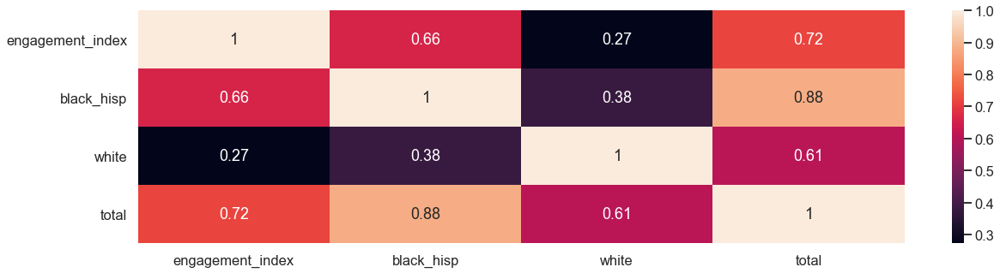

Statistic: Households With Lost Income Due To Pandemic


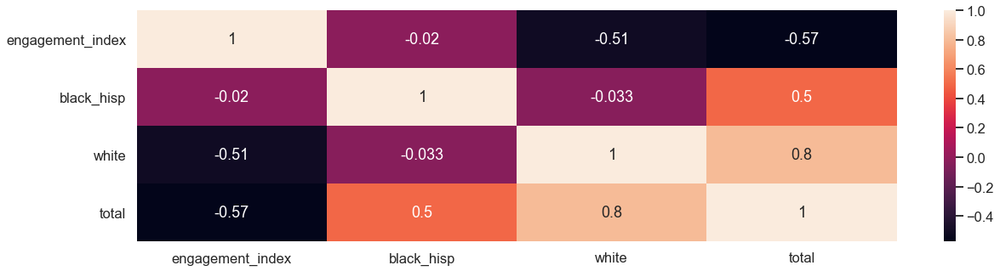

Statistic: Change in Education: Classes Cancelled


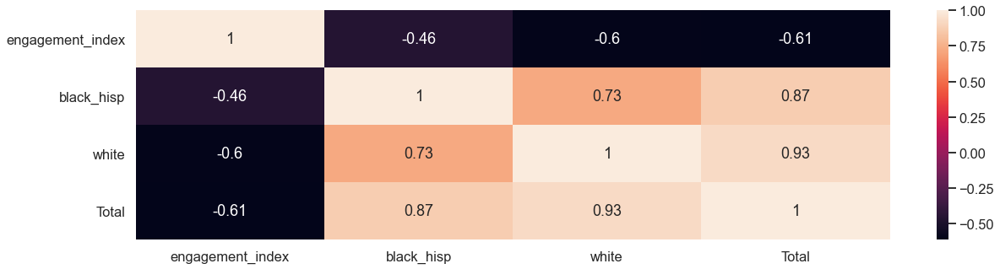

Statistic: Change in Education: Schools Open


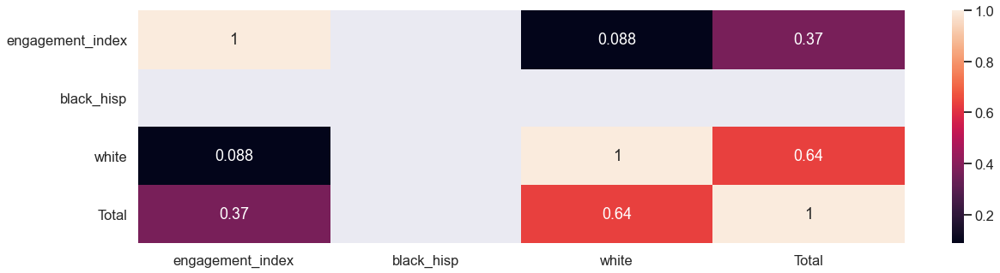

Statistic: Change in Education: Online Distance Learning


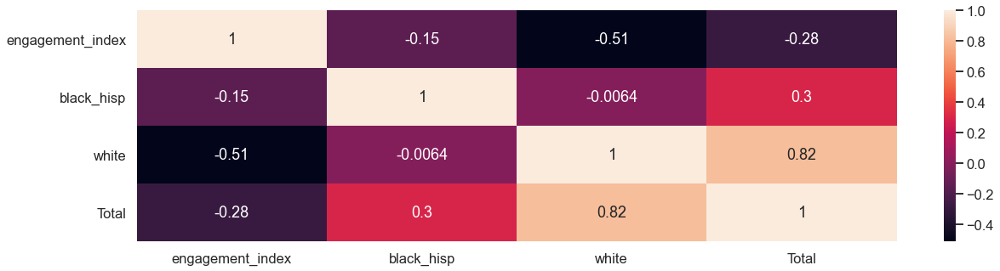

Statistic: Change in Education: Paper Distance Learning


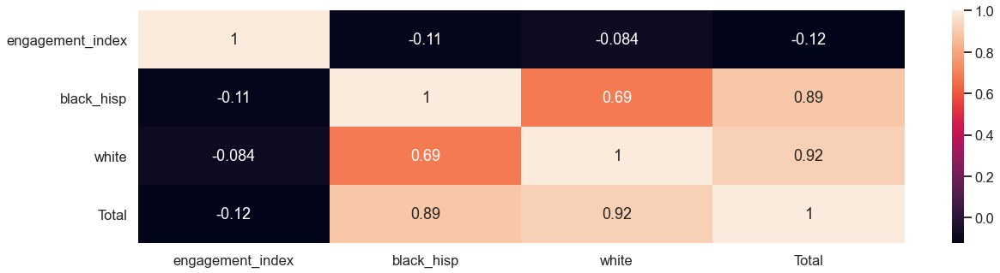

Statistic: Classes Change In Some Other Way


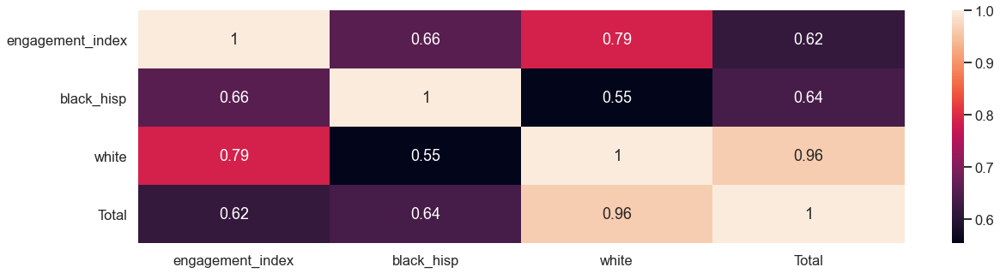

STATE: IL | DISTRICT 2779 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 88344
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


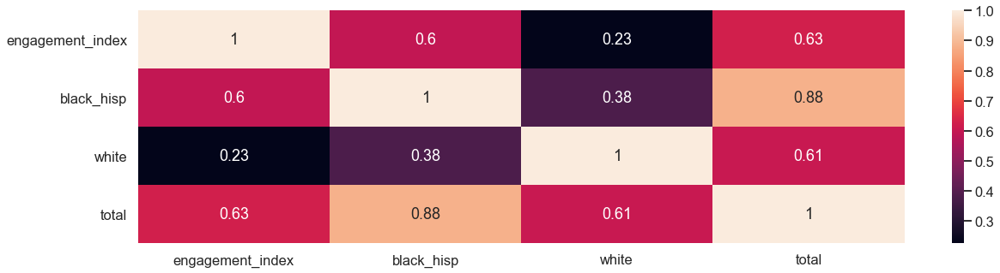

Statistic: Households With Lost Income Due To Pandemic


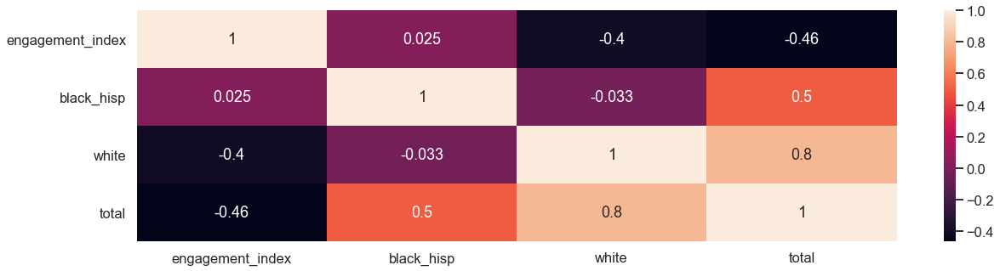

Statistic: Change in Education: Classes Cancelled


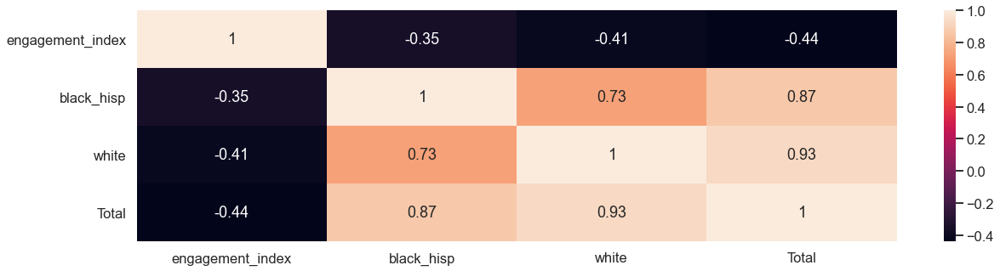

Statistic: Change in Education: Schools Open


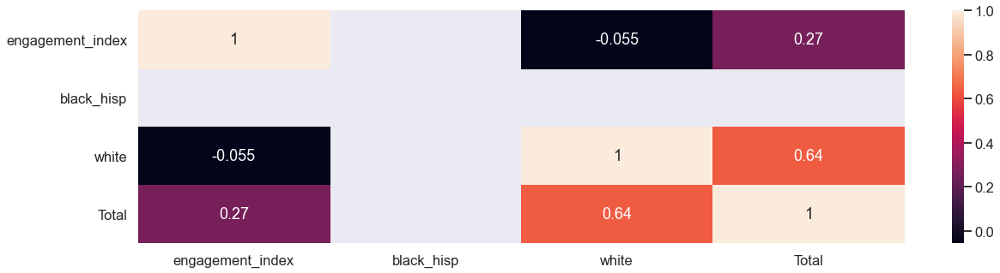

Statistic: Change in Education: Online Distance Learning


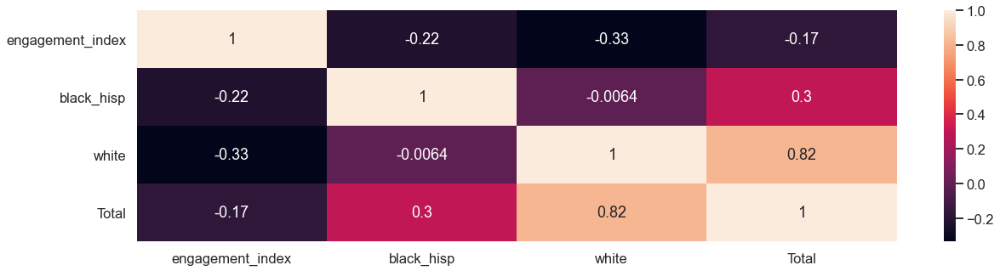

Statistic: Change in Education: Paper Distance Learning


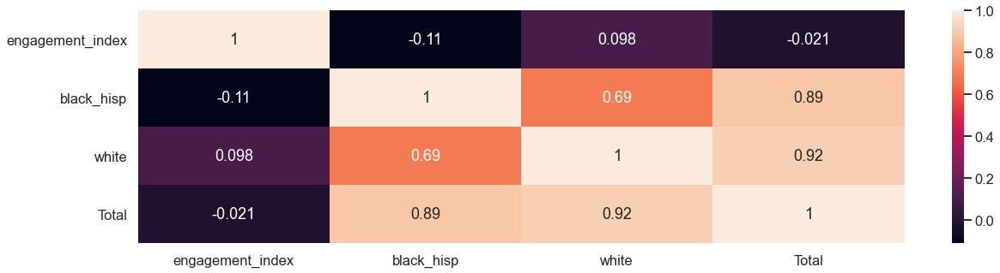

Statistic: Classes Change In Some Other Way


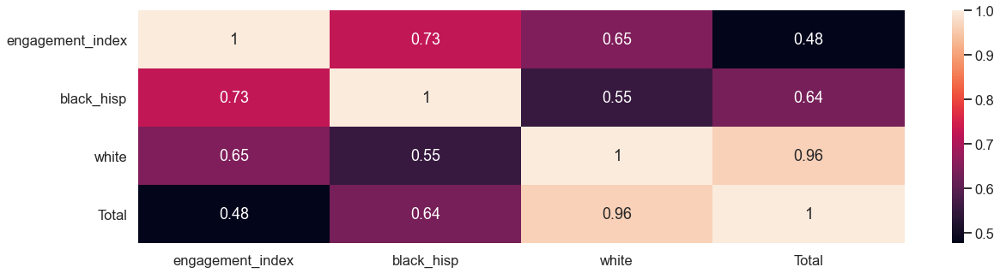

STATE: IL | DISTRICT 8815 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 85481
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


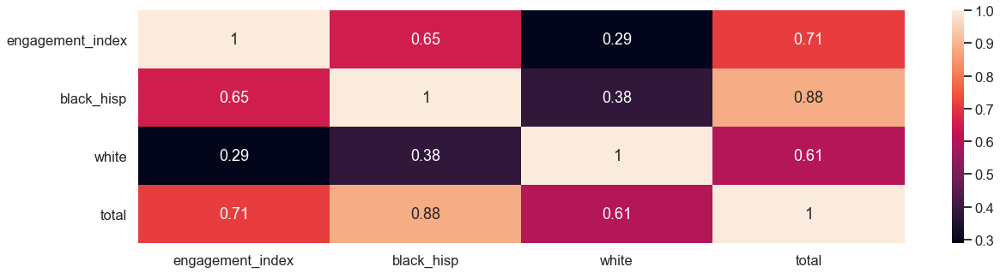

Statistic: Households With Lost Income Due To Pandemic


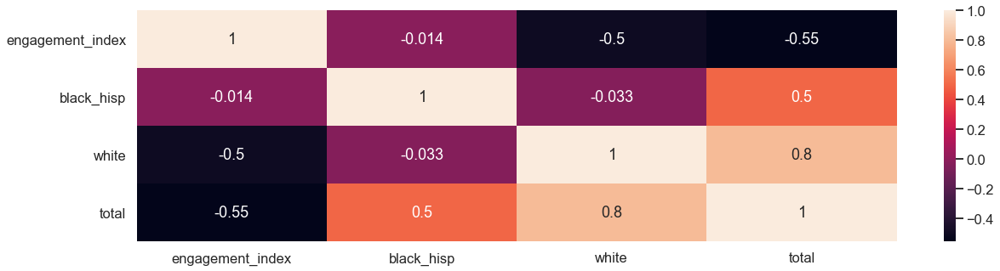

Statistic: Change in Education: Classes Cancelled


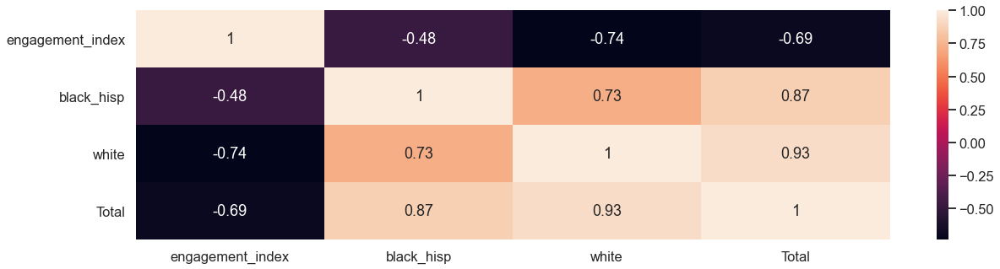

Statistic: Change in Education: Schools Open


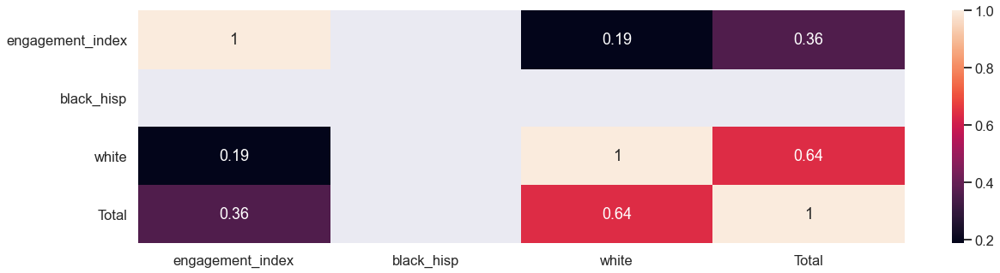

Statistic: Change in Education: Online Distance Learning


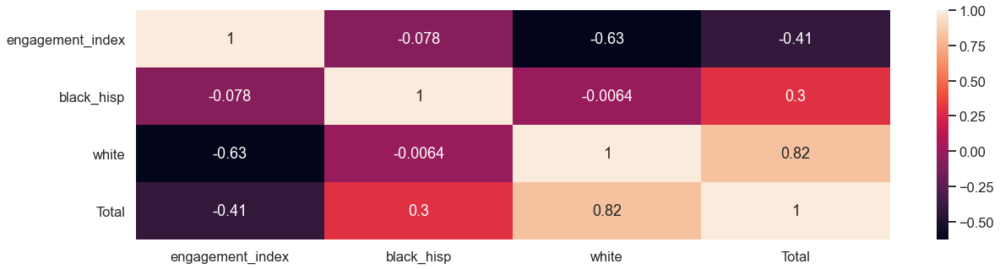

Statistic: Change in Education: Paper Distance Learning


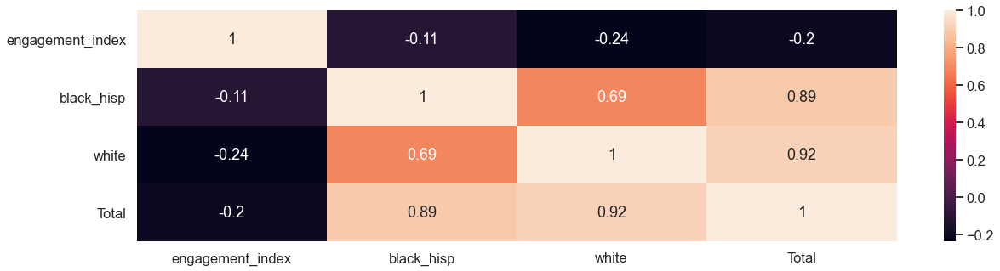

Statistic: Classes Change In Some Other Way


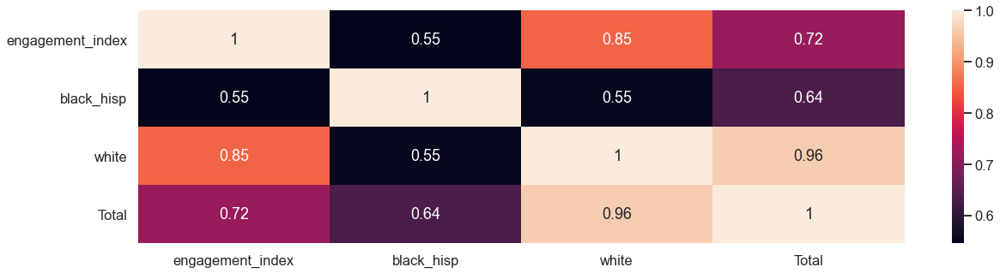

STATE: IL | DISTRICT 9553 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 83851
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


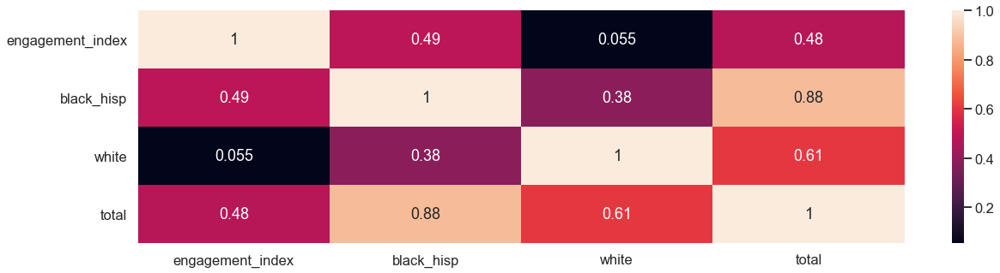

Statistic: Households With Lost Income Due To Pandemic


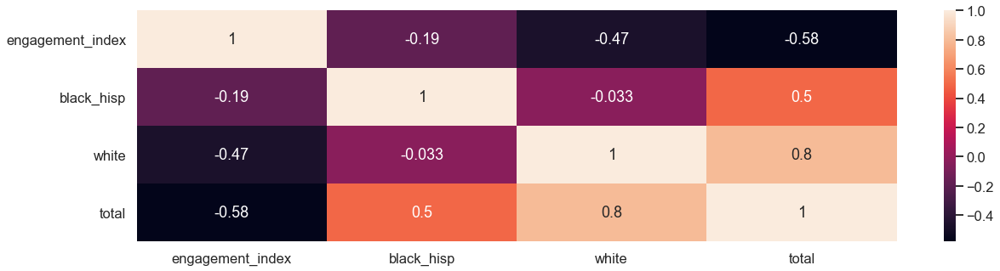

Statistic: Change in Education: Classes Cancelled


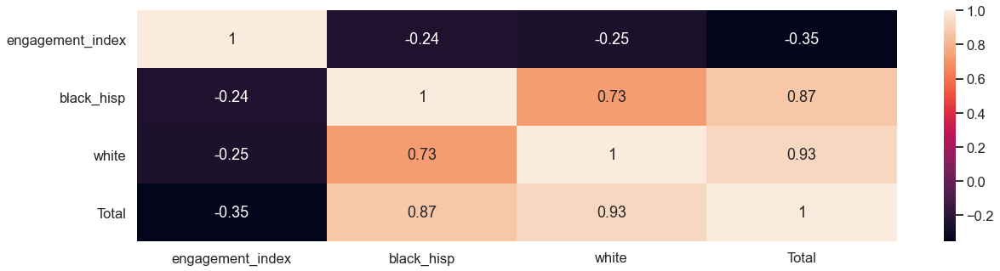

Statistic: Change in Education: Schools Open


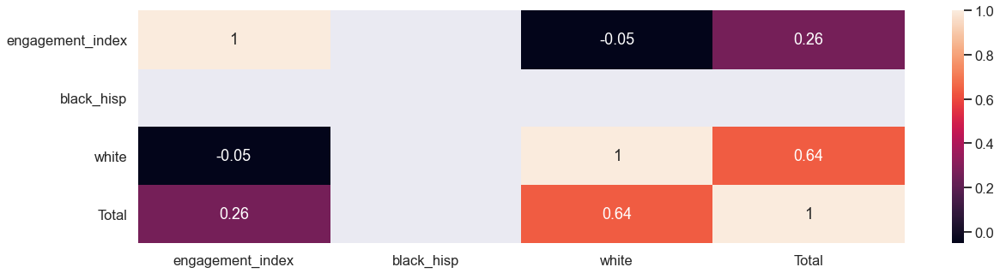

Statistic: Change in Education: Online Distance Learning


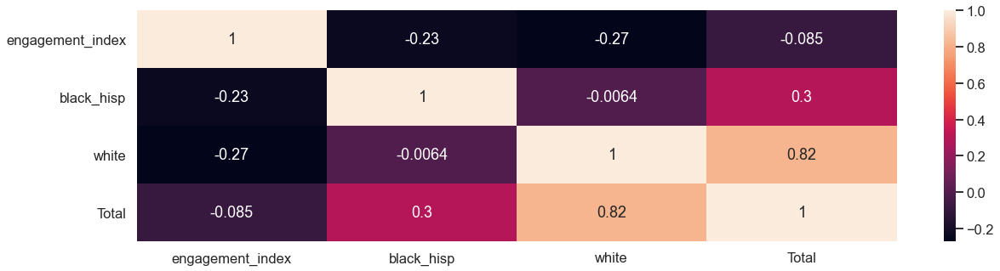

Statistic: Change in Education: Paper Distance Learning


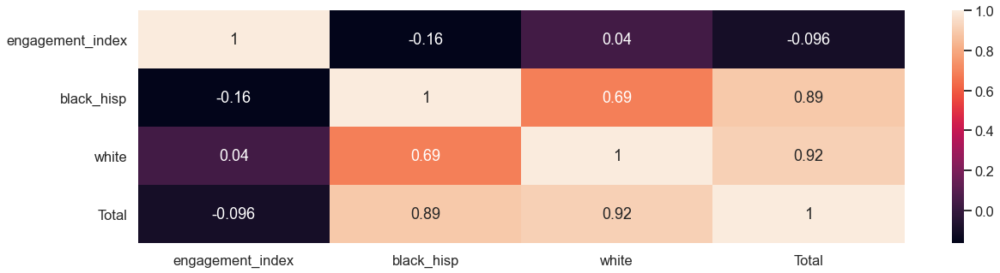

Statistic: Classes Change In Some Other Way


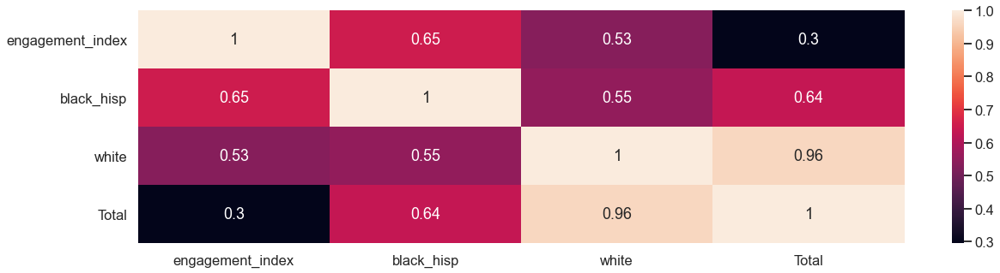

STATE: IL | DISTRICT 5890 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 76169
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $18000 - 20000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


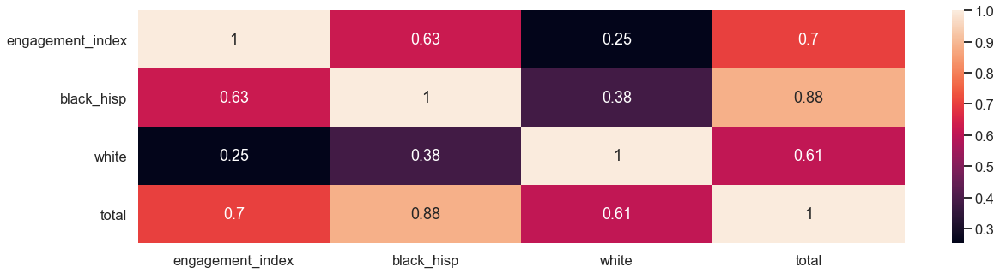

Statistic: Households With Lost Income Due To Pandemic


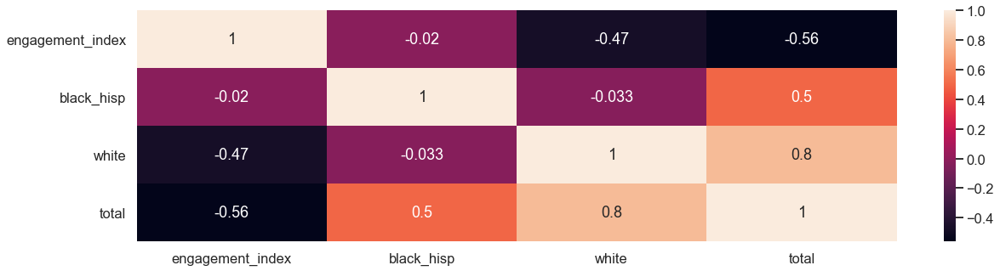

Statistic: Change in Education: Classes Cancelled


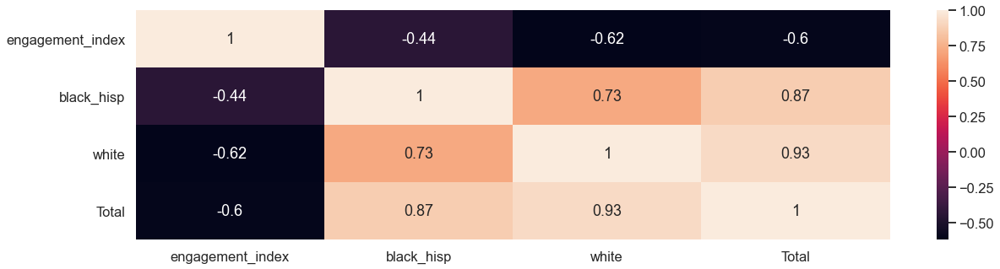

Statistic: Change in Education: Schools Open


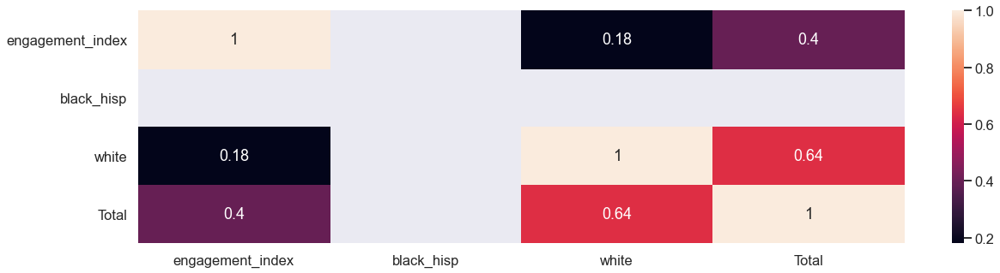

Statistic: Change in Education: Online Distance Learning


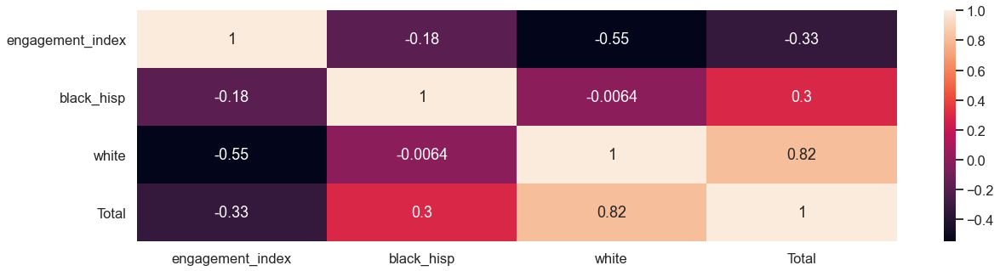

Statistic: Change in Education: Paper Distance Learning


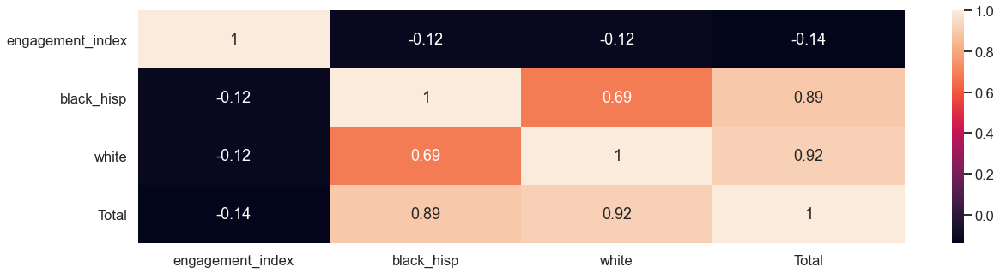

Statistic: Classes Change In Some Other Way


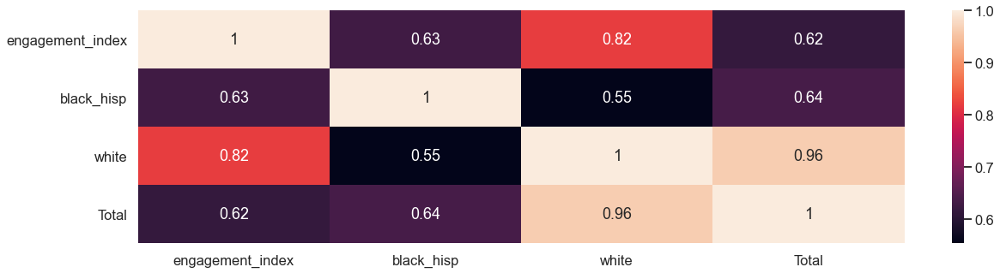

STATE: IL | DISTRICT 2393 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 71574
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


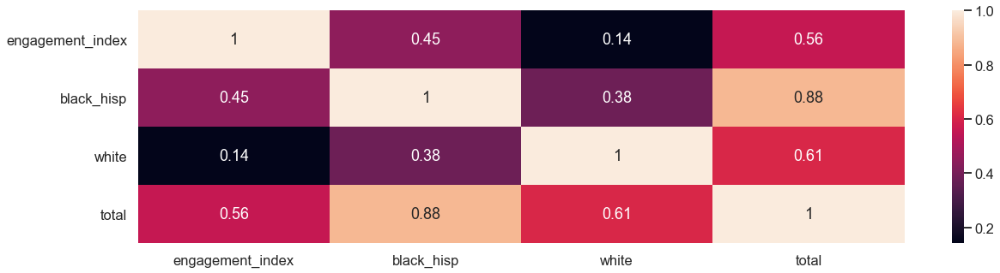

Statistic: Households With Lost Income Due To Pandemic


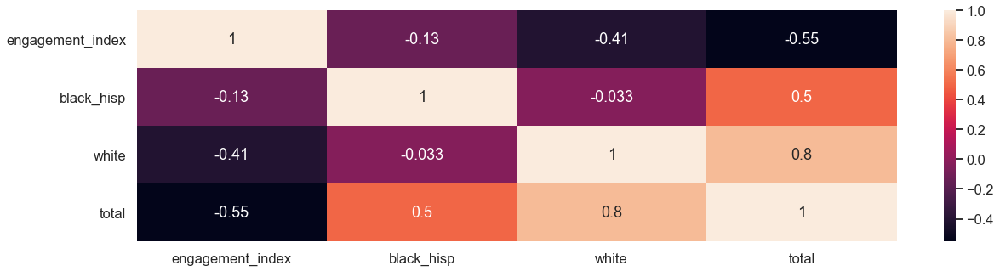

Statistic: Change in Education: Classes Cancelled


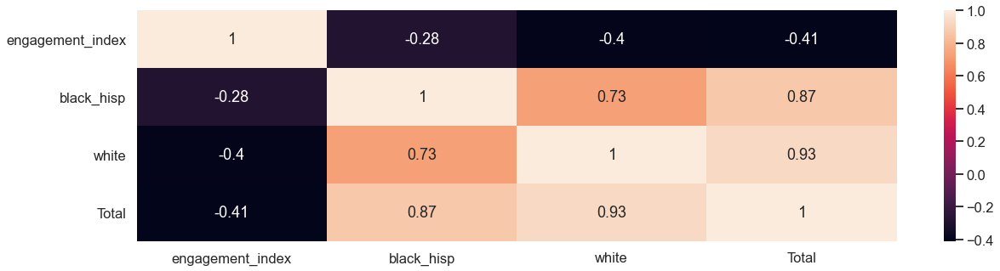

Statistic: Change in Education: Schools Open


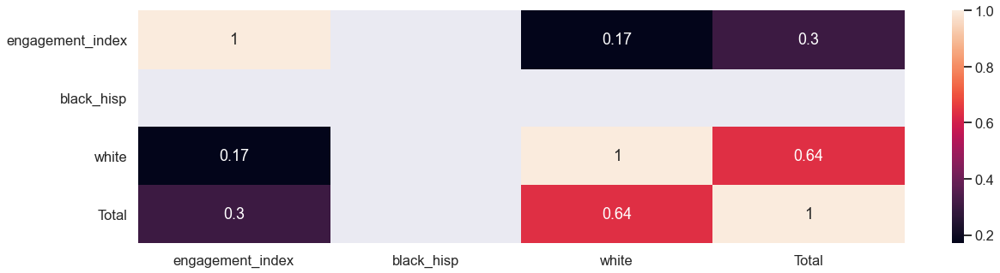

Statistic: Change in Education: Online Distance Learning


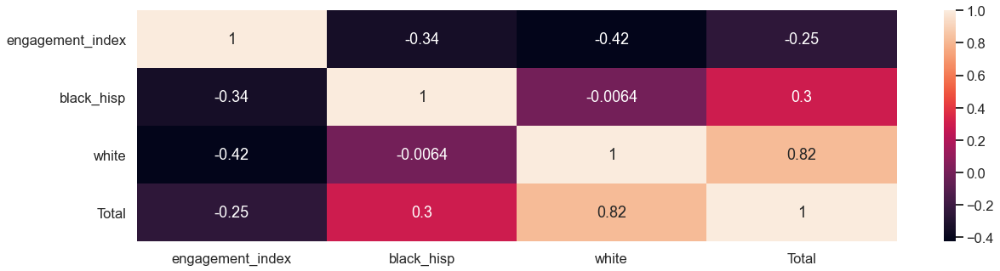

Statistic: Change in Education: Paper Distance Learning


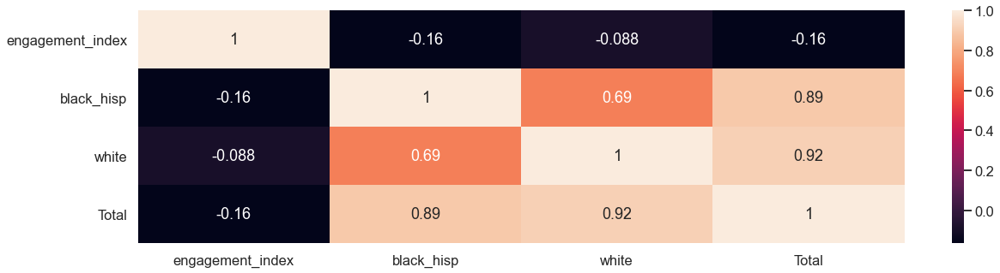

Statistic: Classes Change In Some Other Way


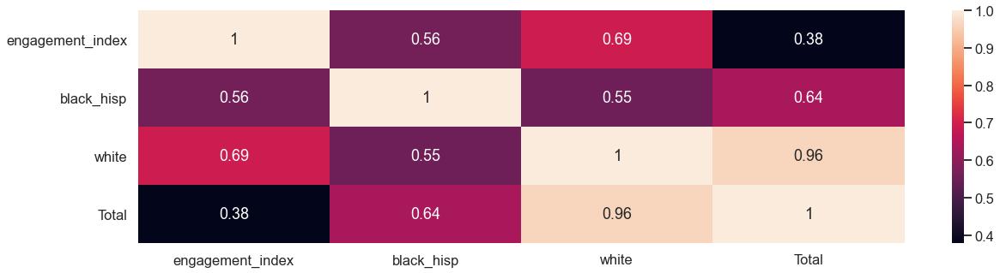

STATE: IL | DISTRICT 6577 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 70904
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


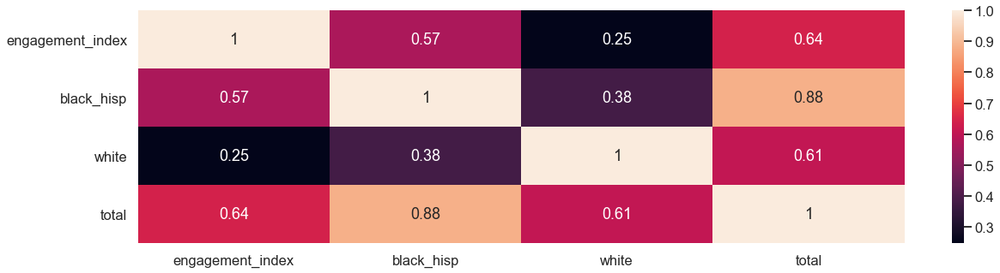

Statistic: Households With Lost Income Due To Pandemic


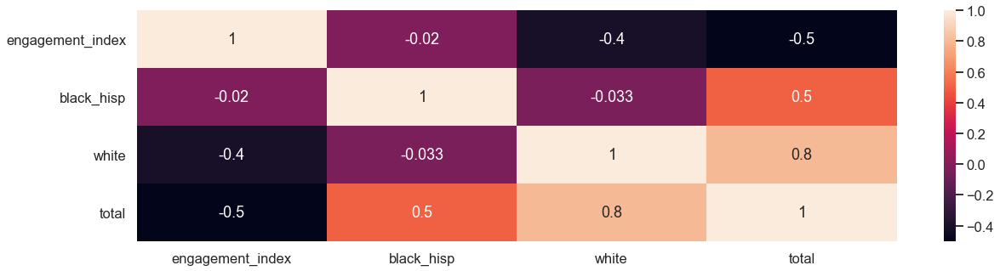

Statistic: Change in Education: Classes Cancelled


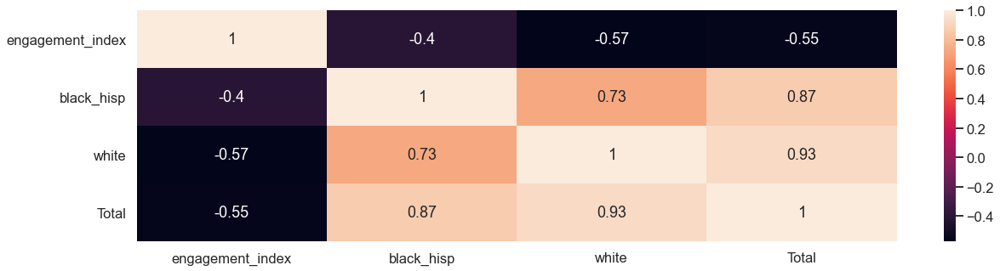

Statistic: Change in Education: Schools Open


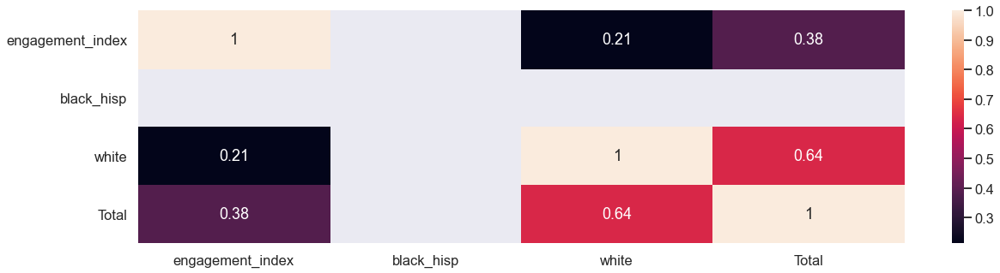

Statistic: Change in Education: Online Distance Learning


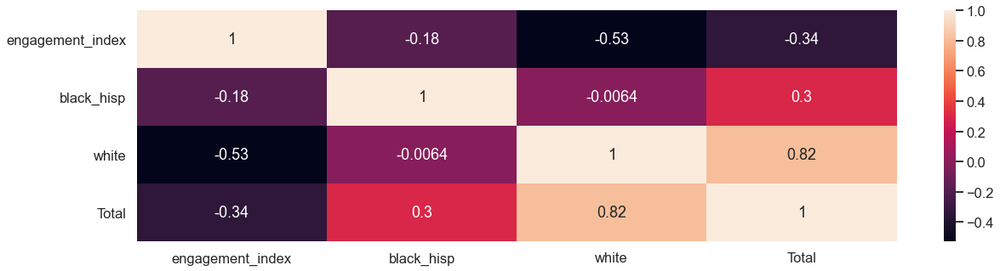

Statistic: Change in Education: Paper Distance Learning


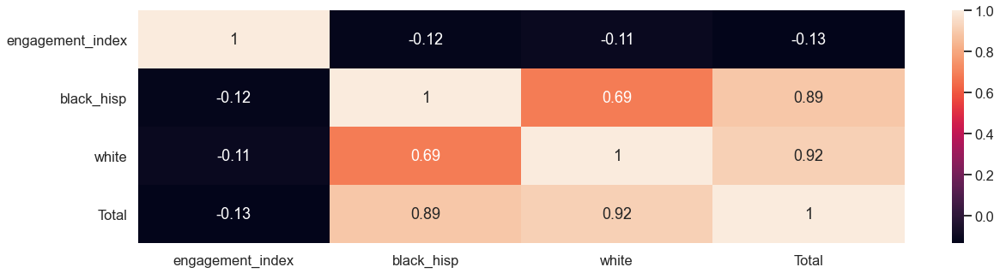

Statistic: Classes Change In Some Other Way


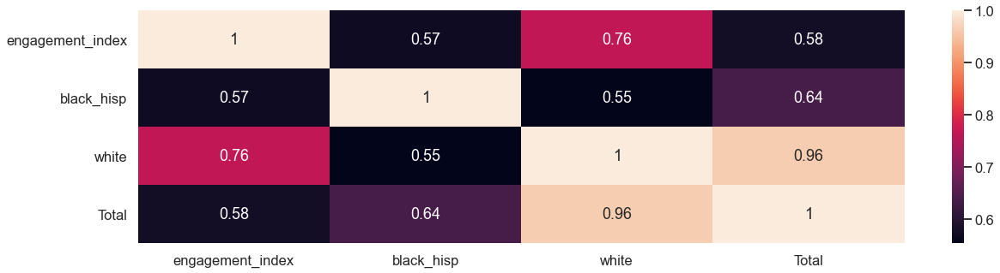

STATE: IL | DISTRICT 4629 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 60651
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


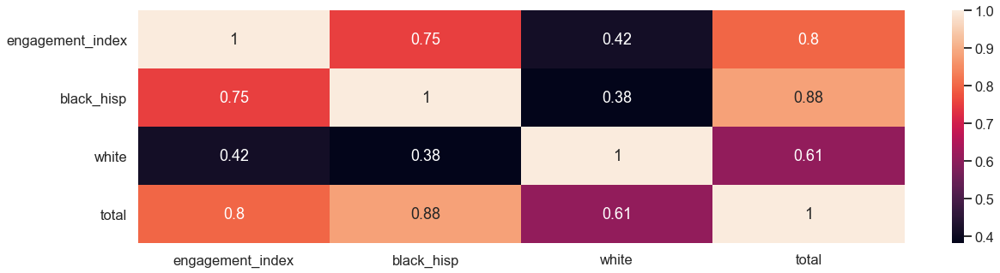

Statistic: Households With Lost Income Due To Pandemic


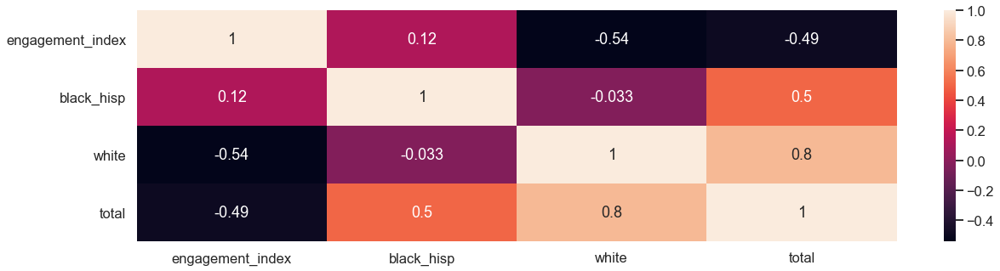

Statistic: Change in Education: Classes Cancelled


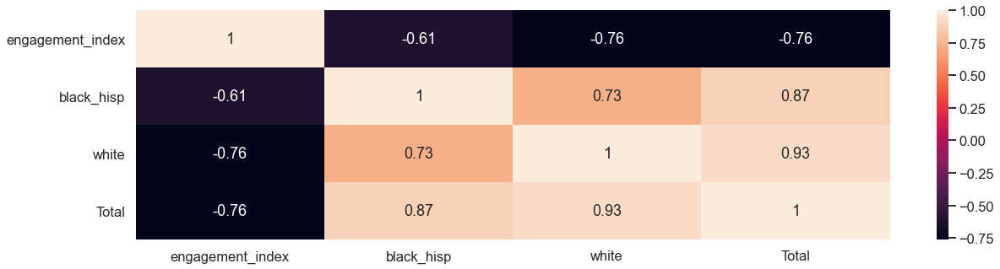

Statistic: Change in Education: Schools Open


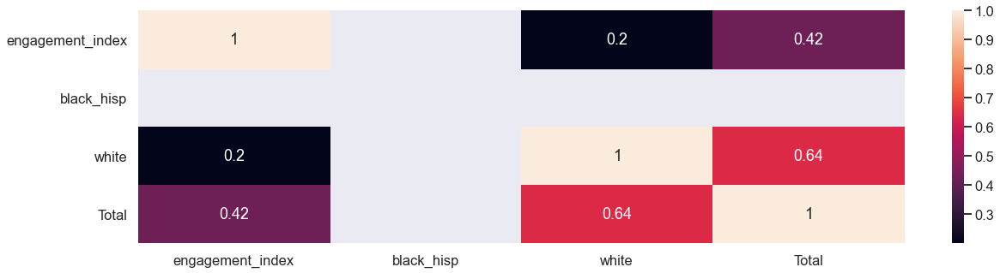

Statistic: Change in Education: Online Distance Learning


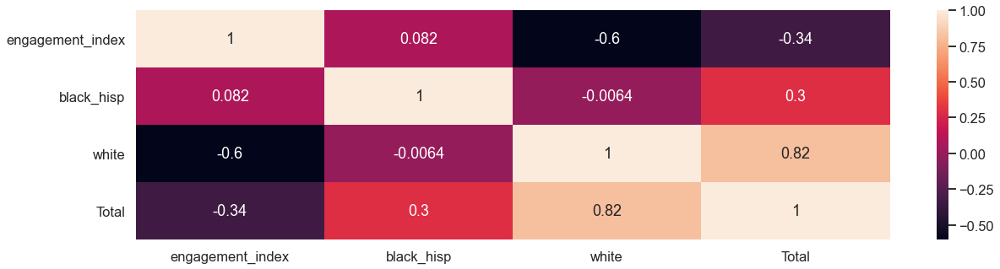

Statistic: Change in Education: Paper Distance Learning


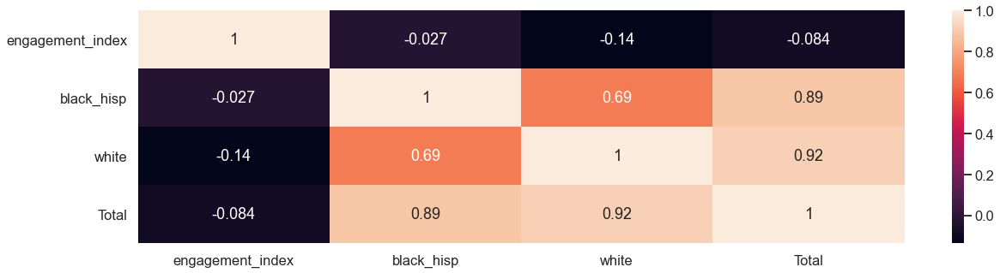

Statistic: Classes Change In Some Other Way


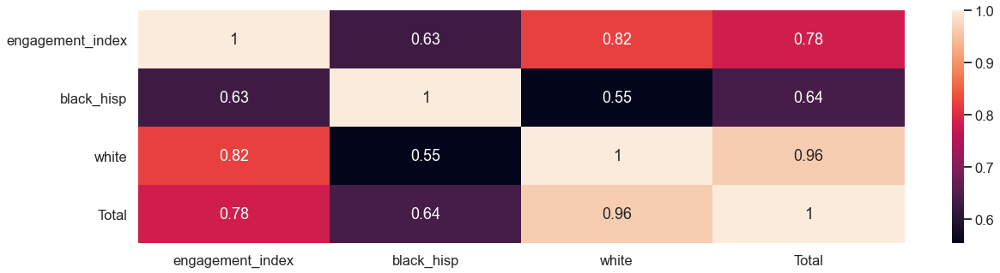

STATE: IL | DISTRICT 1712 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 60575
Black & Hispanic Students: 40% - 60%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


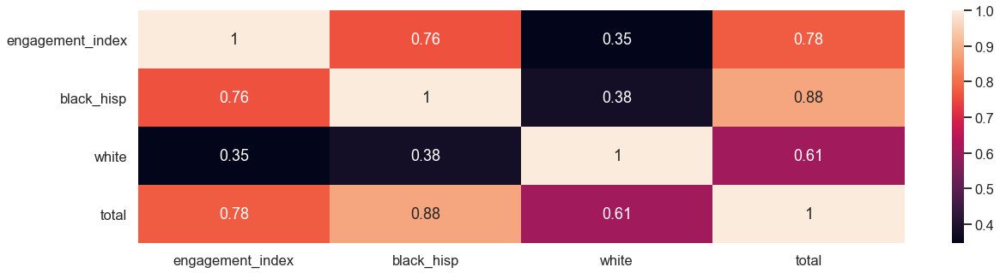

Statistic: Households With Lost Income Due To Pandemic


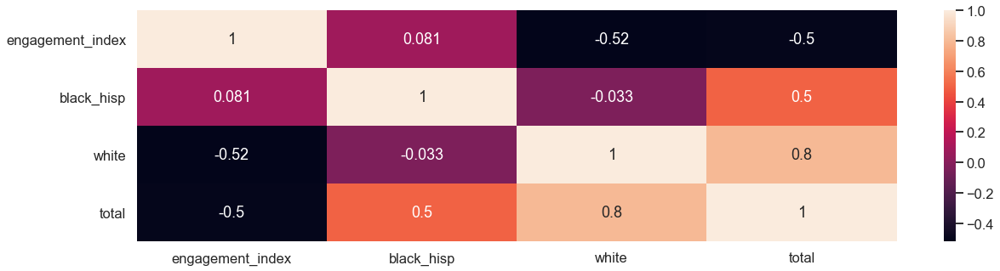

Statistic: Change in Education: Classes Cancelled


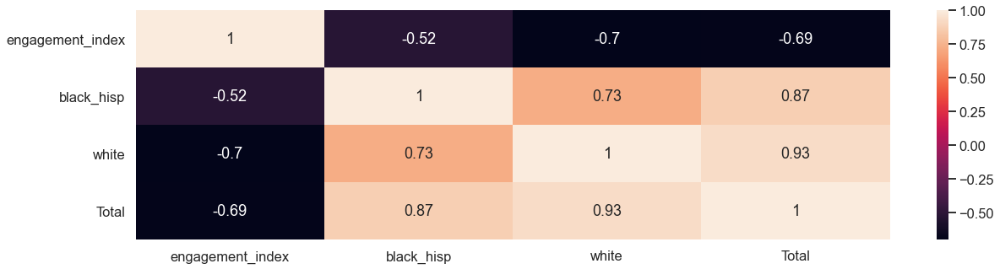

Statistic: Change in Education: Schools Open


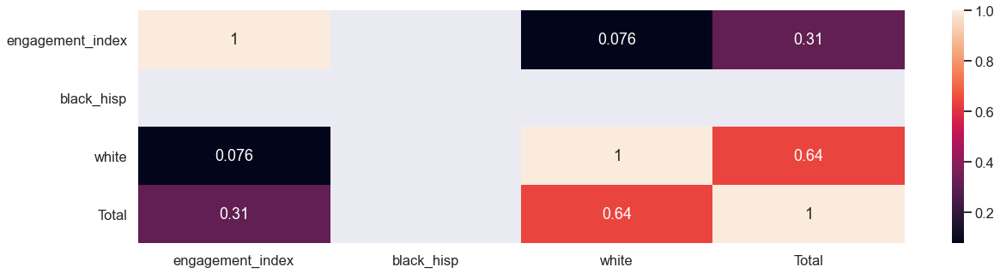

Statistic: Change in Education: Online Distance Learning


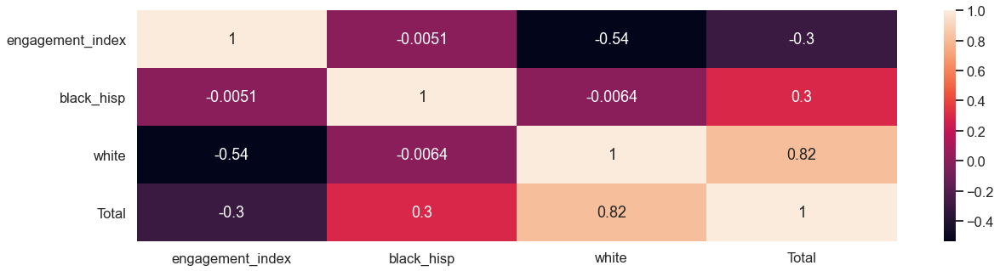

Statistic: Change in Education: Paper Distance Learning


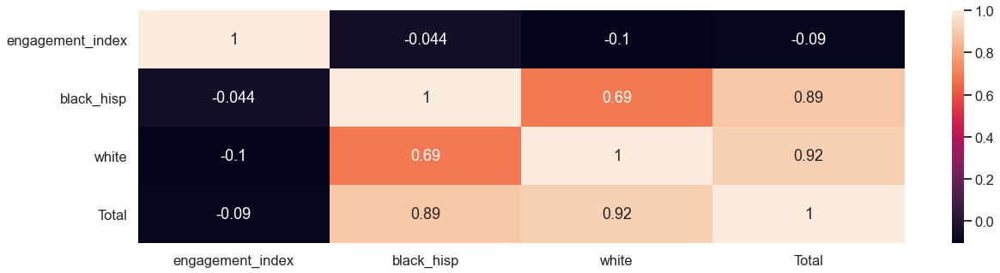

Statistic: Classes Change In Some Other Way


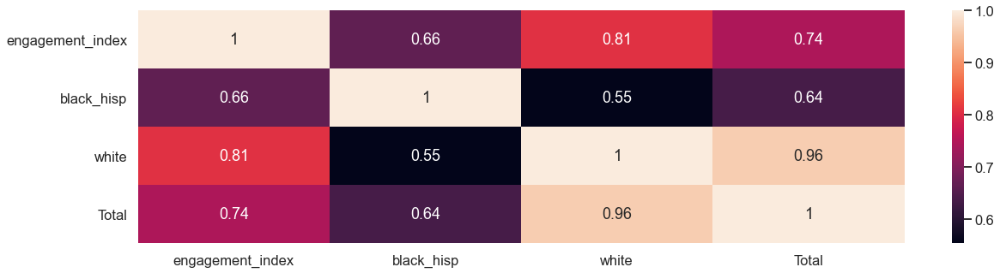

STATE: IL | DISTRICT 8937 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 53489
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


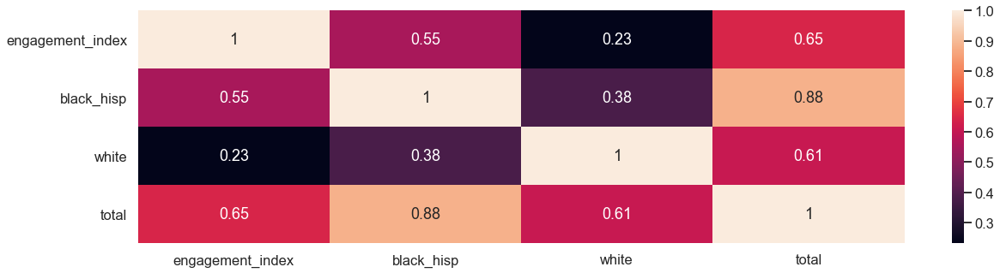

Statistic: Households With Lost Income Due To Pandemic


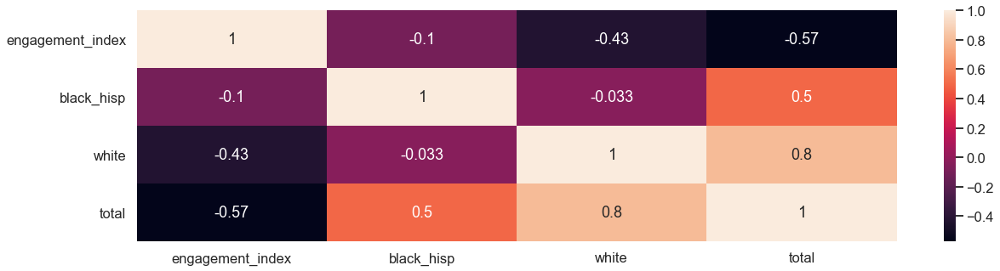

Statistic: Change in Education: Classes Cancelled


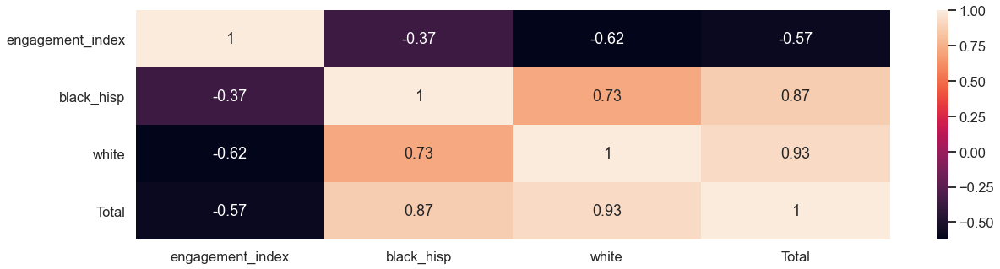

Statistic: Change in Education: Schools Open


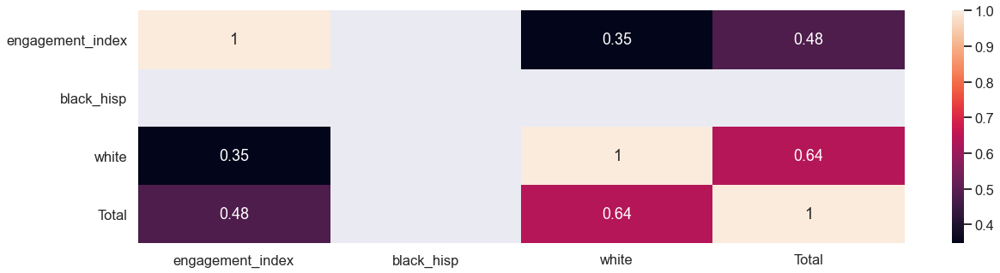

Statistic: Change in Education: Online Distance Learning


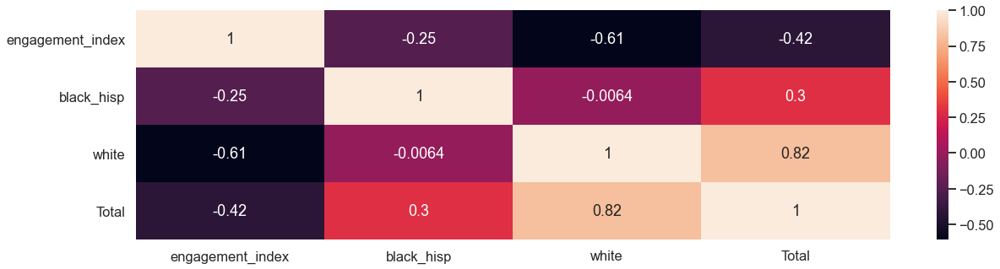

Statistic: Change in Education: Paper Distance Learning


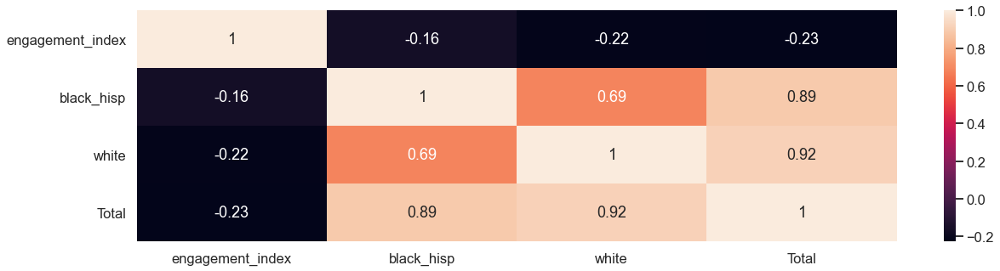

Statistic: Classes Change In Some Other Way


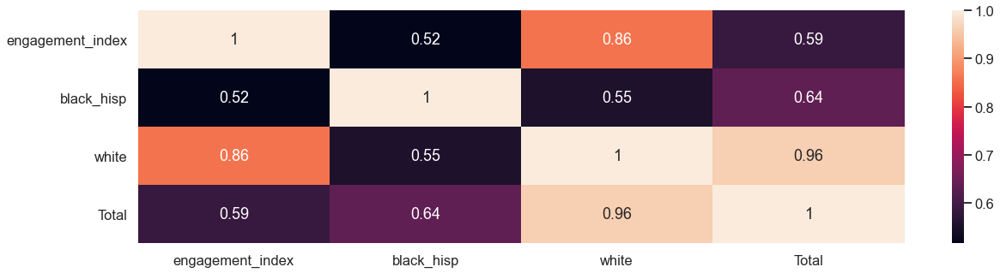

STATE: IL | DISTRICT 1052 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 52684
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


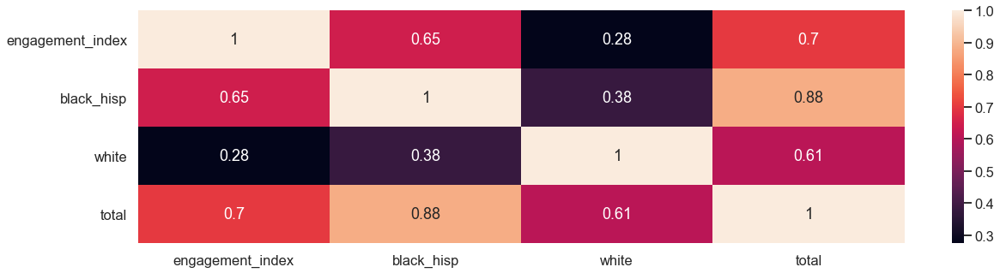

Statistic: Households With Lost Income Due To Pandemic


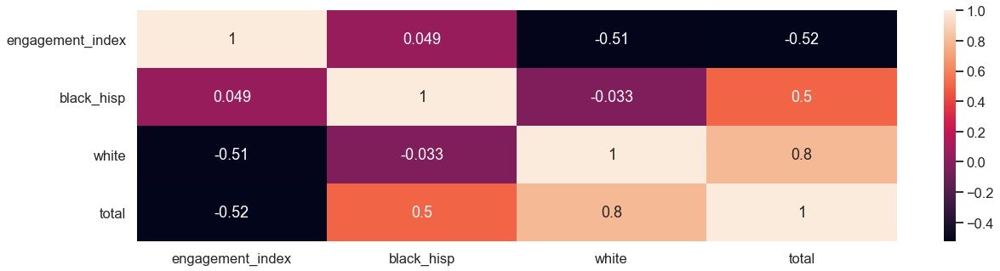

Statistic: Change in Education: Classes Cancelled


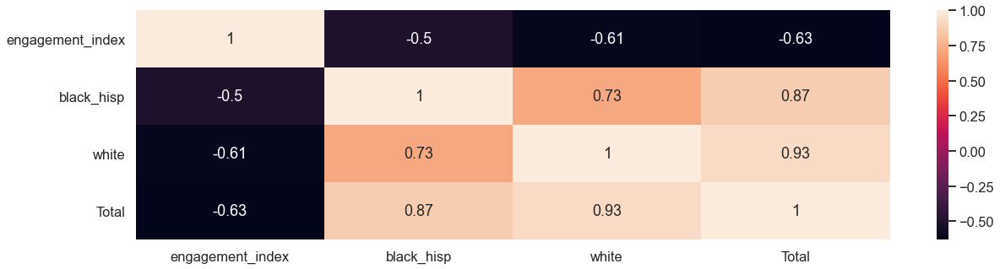

Statistic: Change in Education: Schools Open


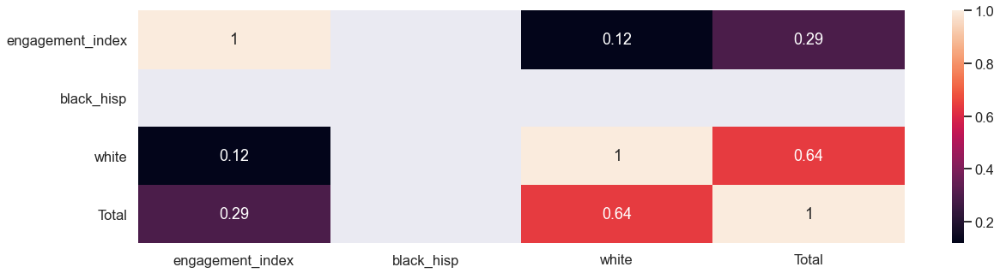

Statistic: Change in Education: Online Distance Learning


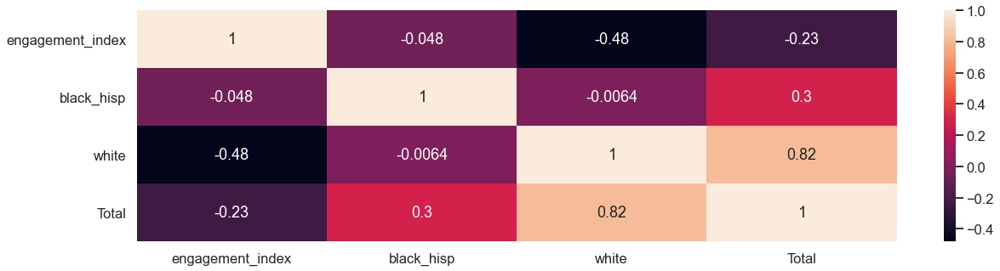

Statistic: Change in Education: Paper Distance Learning


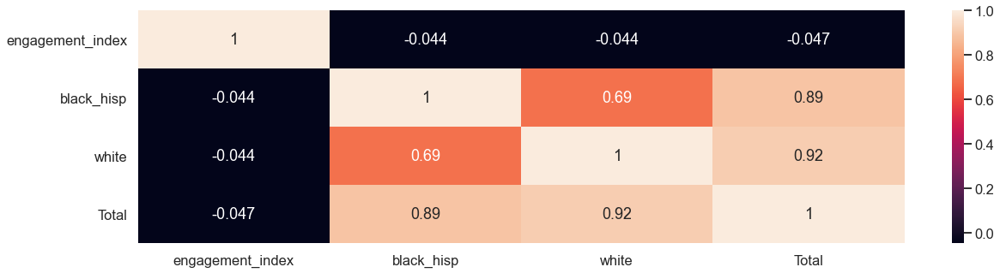

Statistic: Classes Change In Some Other Way


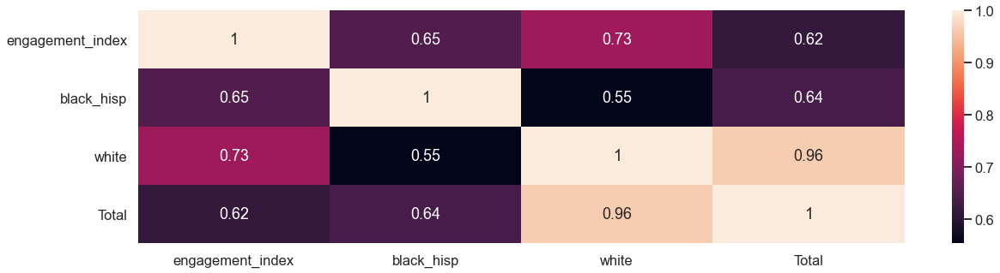

STATE: IL | DISTRICT 3248 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 50998
Black & Hispanic Students: 60% - 80%
Students With Free or Reduced Lunches: 60% - 80%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


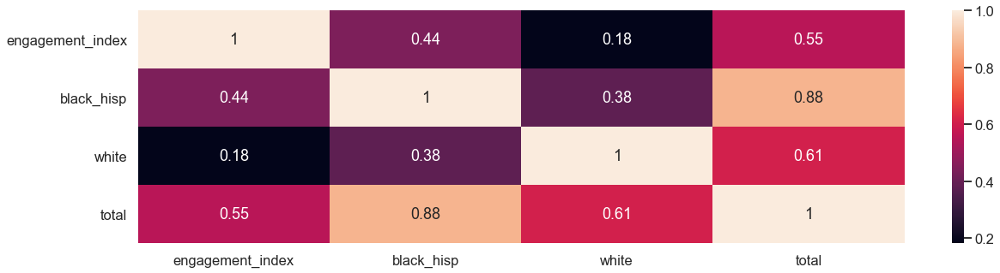

Statistic: Households With Lost Income Due To Pandemic


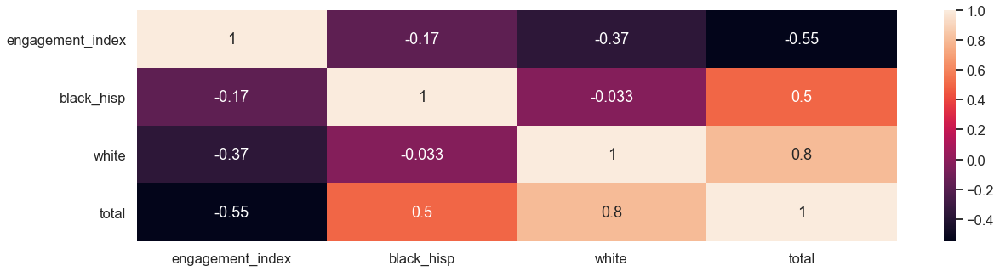

Statistic: Change in Education: Classes Cancelled


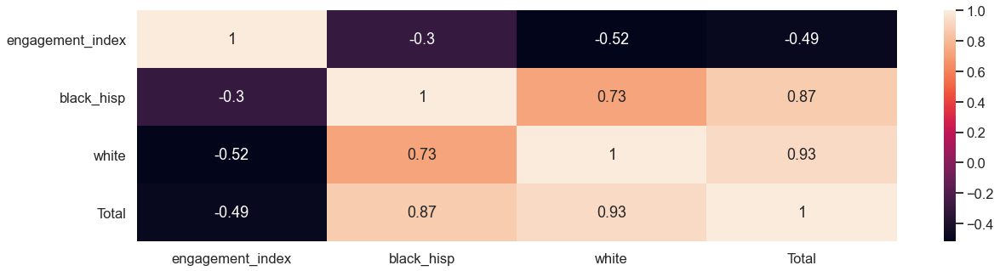

Statistic: Change in Education: Schools Open


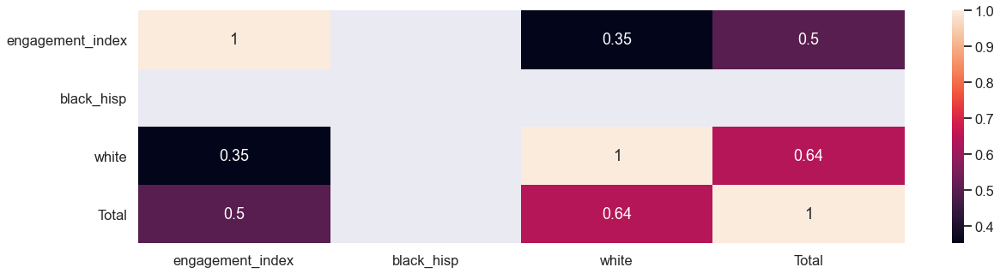

Statistic: Change in Education: Online Distance Learning


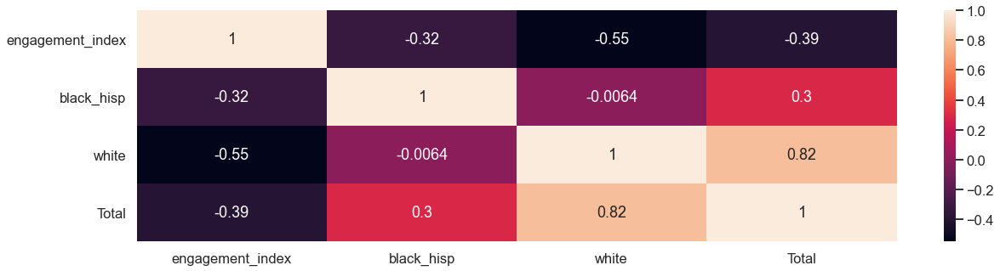

Statistic: Change in Education: Paper Distance Learning


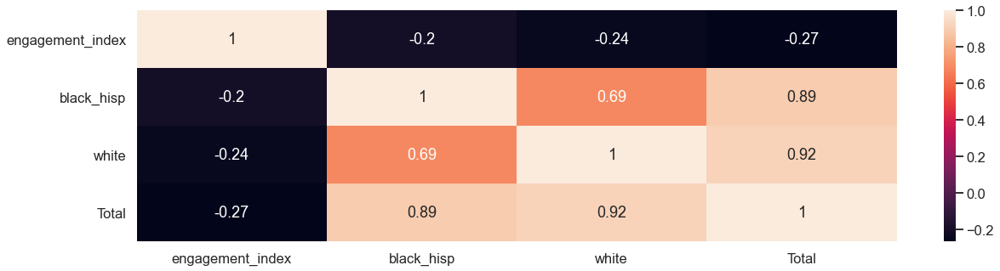

Statistic: Classes Change In Some Other Way


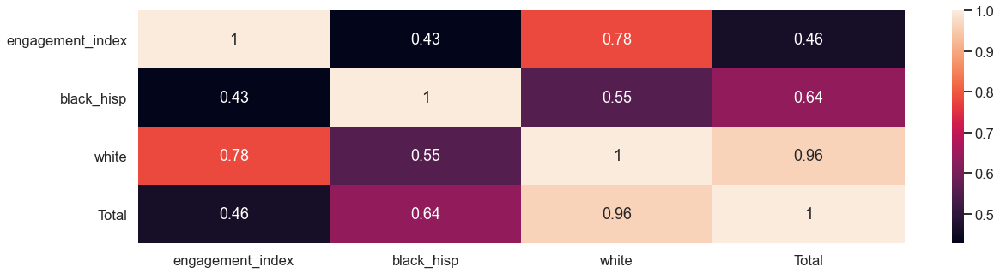

STATE: IL | DISTRICT 8784 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 47232
Black & Hispanic Students: 60% - 80%
Students With Free or Reduced Lunches: 60% - 80%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


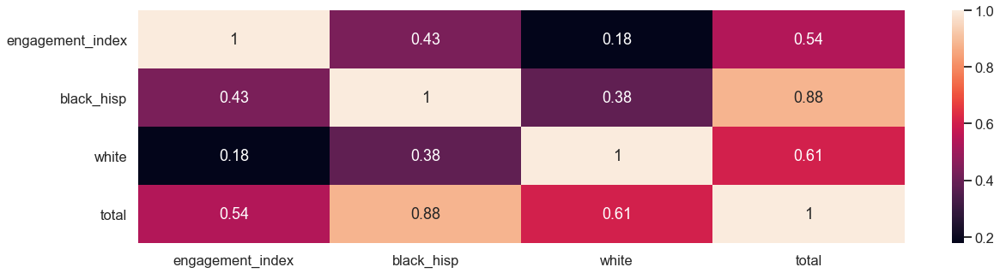

Statistic: Households With Lost Income Due To Pandemic


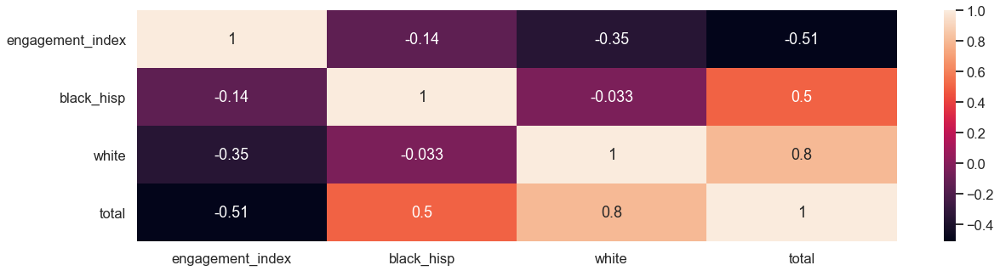

Statistic: Change in Education: Classes Cancelled


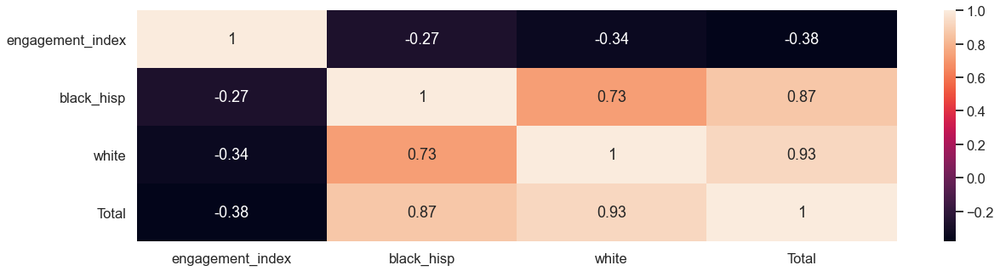

Statistic: Change in Education: Schools Open


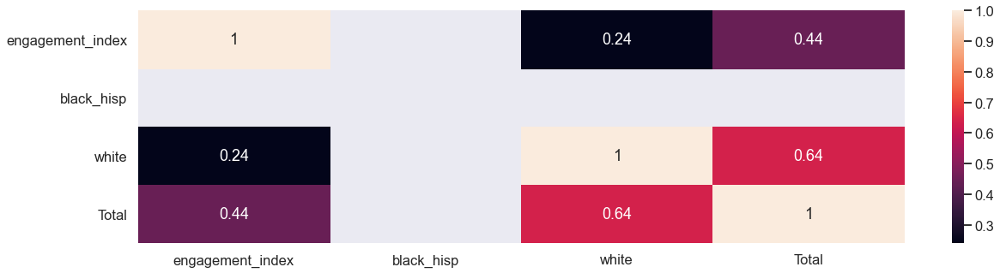

Statistic: Change in Education: Online Distance Learning


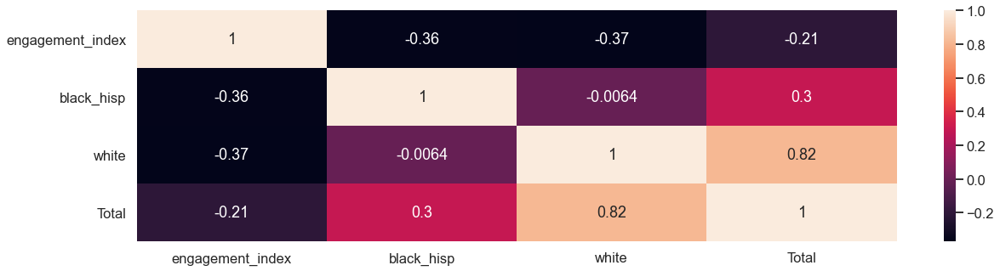

Statistic: Change in Education: Paper Distance Learning


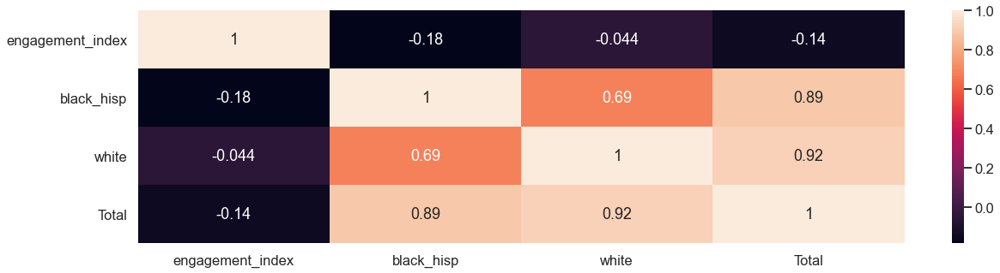

Statistic: Classes Change In Some Other Way


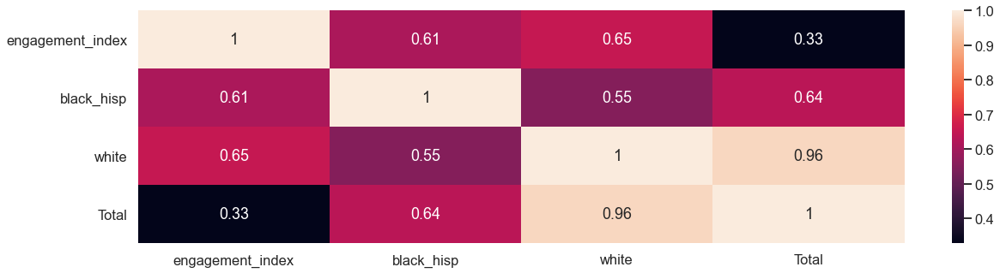

STATE: IL | DISTRICT 9899 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 43419
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


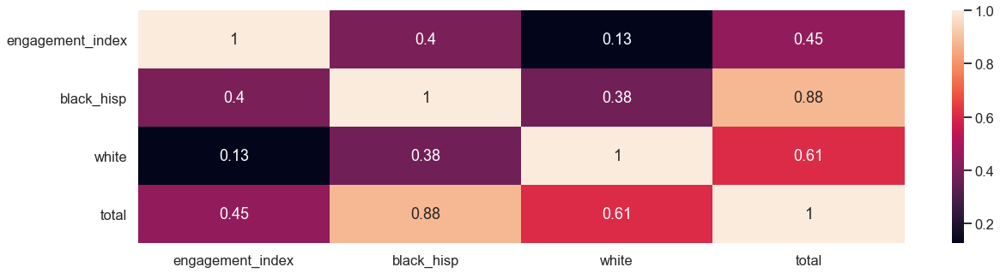

Statistic: Households With Lost Income Due To Pandemic


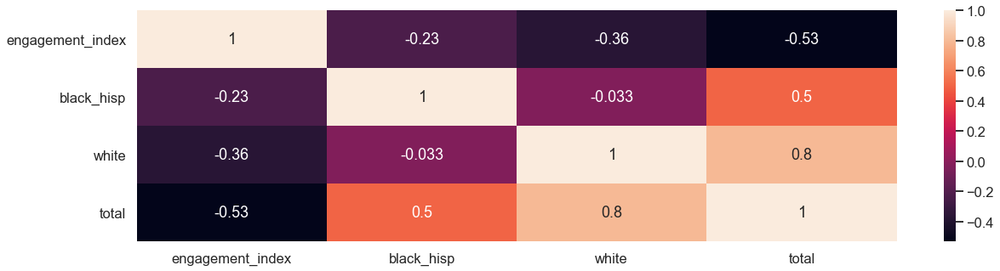

Statistic: Change in Education: Classes Cancelled


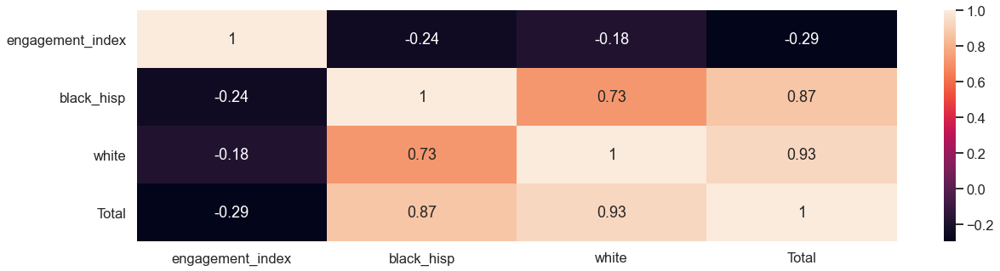

Statistic: Change in Education: Schools Open


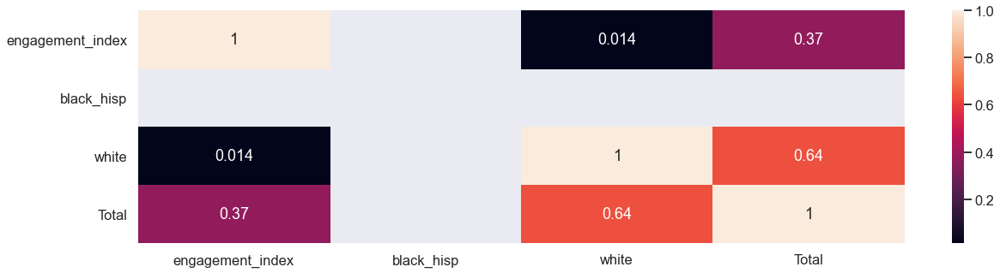

Statistic: Change in Education: Online Distance Learning


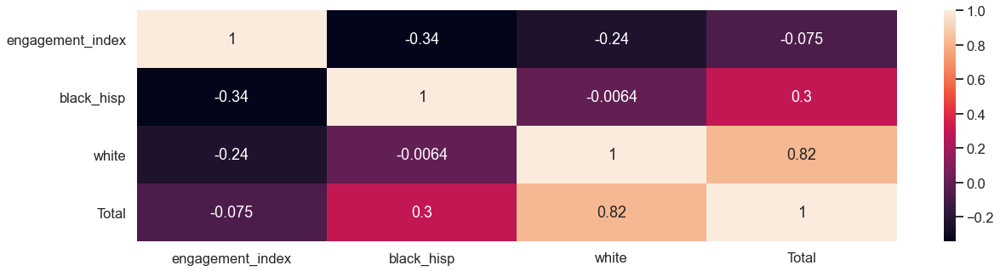

Statistic: Change in Education: Paper Distance Learning


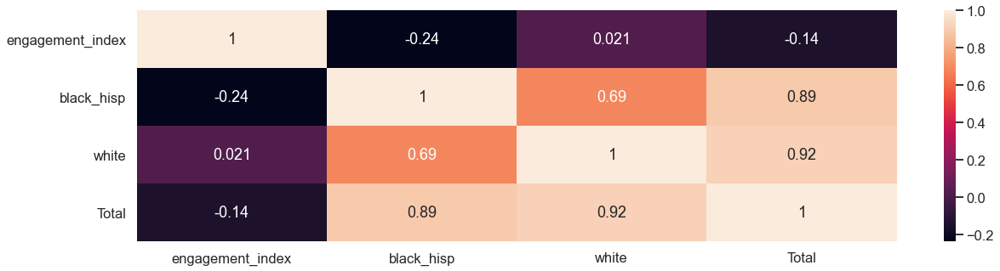

Statistic: Classes Change In Some Other Way


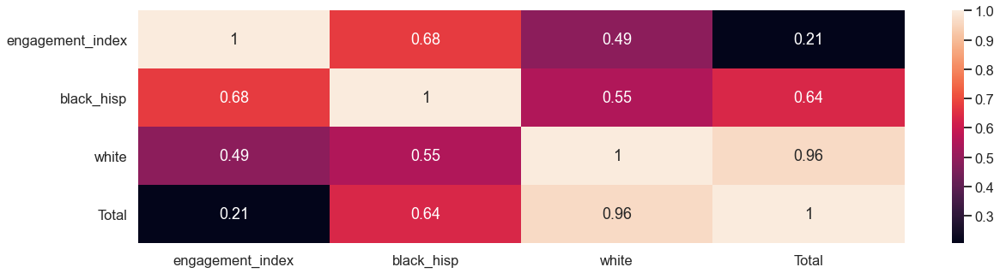

STATE: IL | DISTRICT 2601 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 40120
Black & Hispanic Students: 60% - 80%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


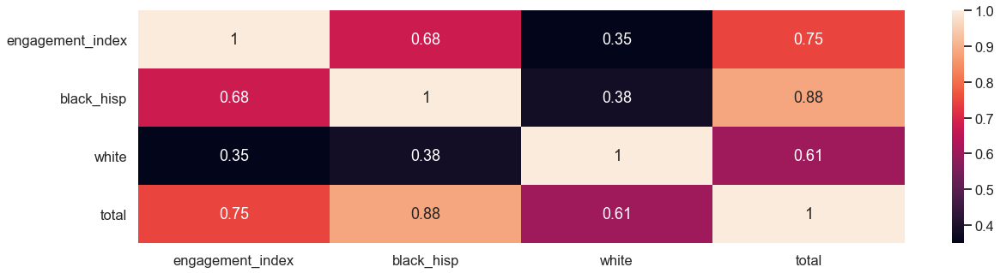

Statistic: Households With Lost Income Due To Pandemic


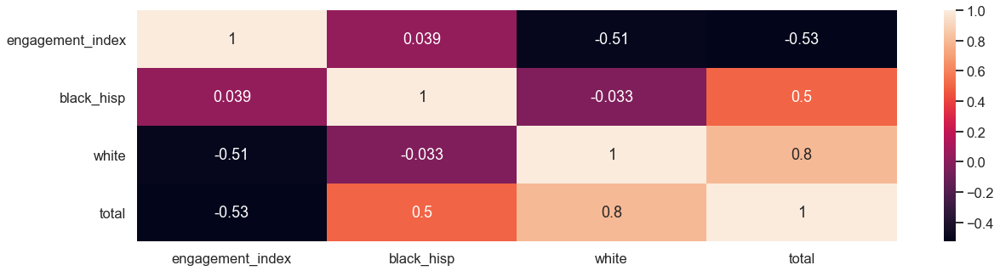

Statistic: Change in Education: Classes Cancelled


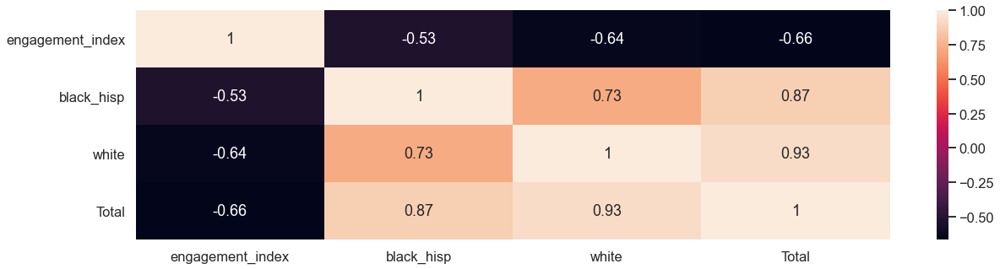

Statistic: Change in Education: Schools Open


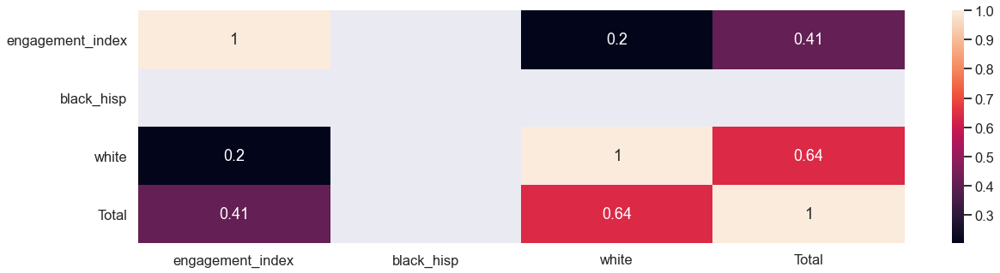

Statistic: Change in Education: Online Distance Learning


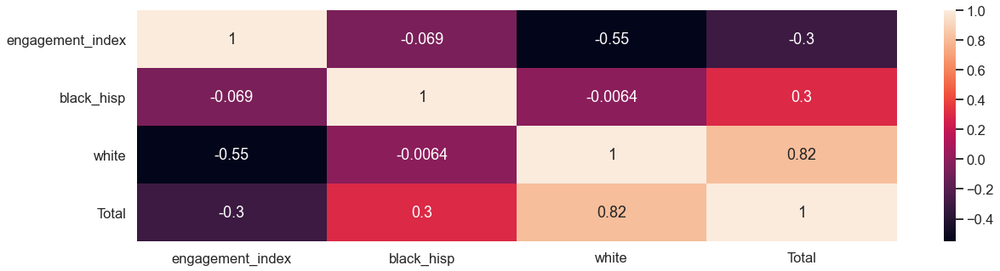

Statistic: Change in Education: Paper Distance Learning


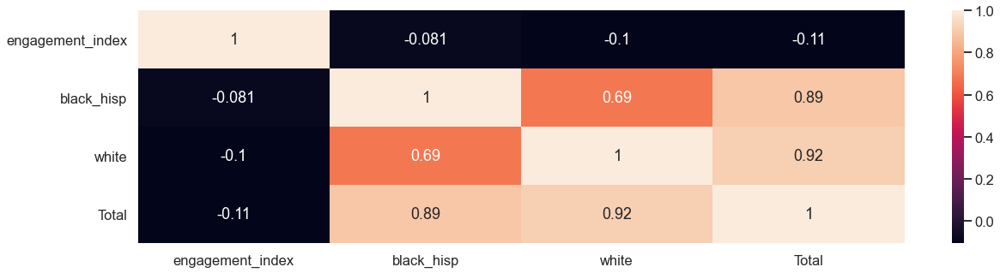

Statistic: Classes Change In Some Other Way


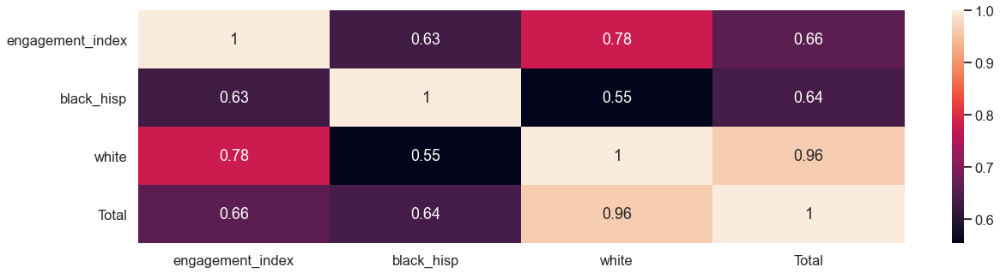

STATE: IL | DISTRICT 1877 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 39494
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


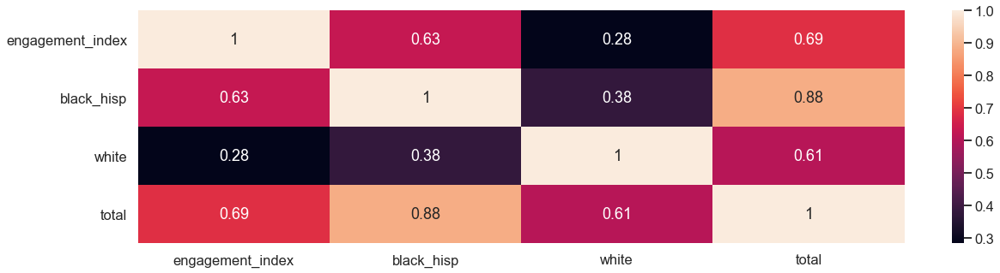

Statistic: Households With Lost Income Due To Pandemic


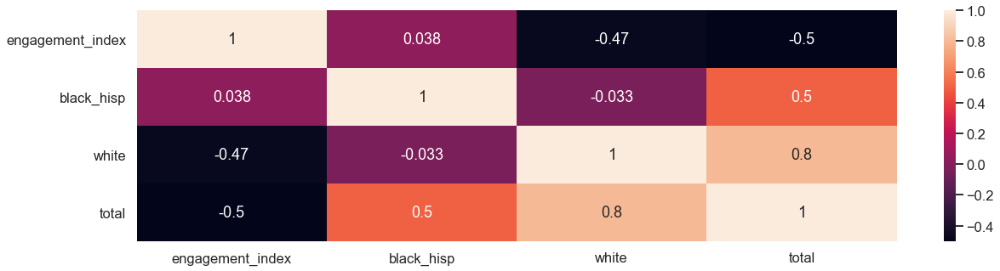

Statistic: Change in Education: Classes Cancelled


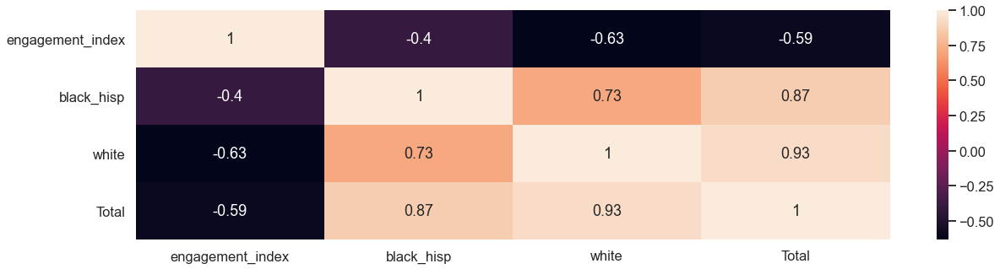

Statistic: Change in Education: Schools Open


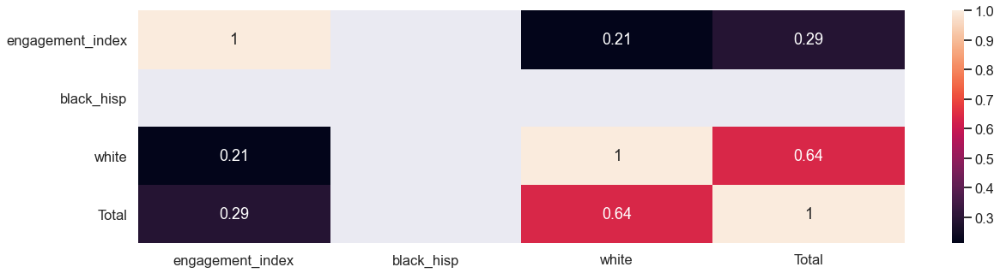

Statistic: Change in Education: Online Distance Learning


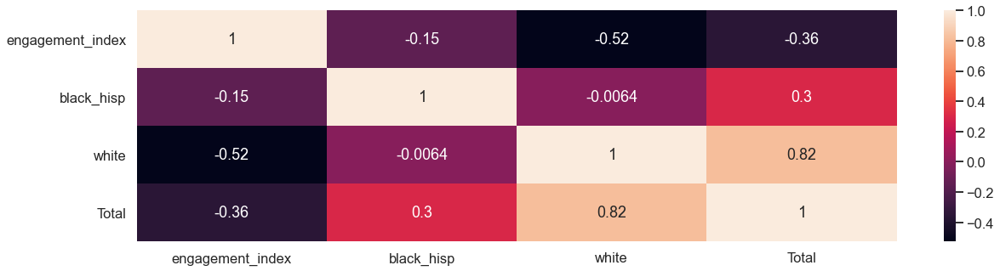

Statistic: Change in Education: Paper Distance Learning


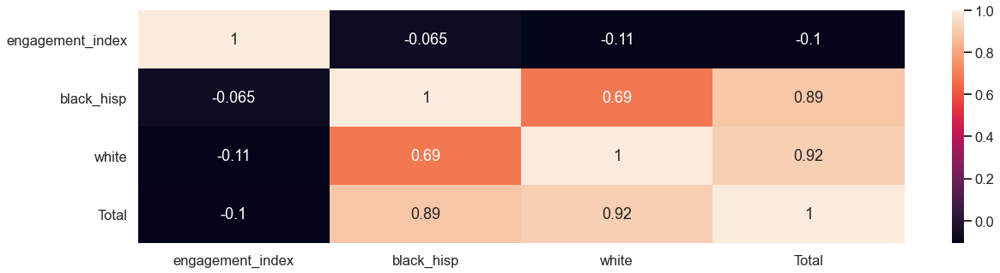

Statistic: Classes Change In Some Other Way


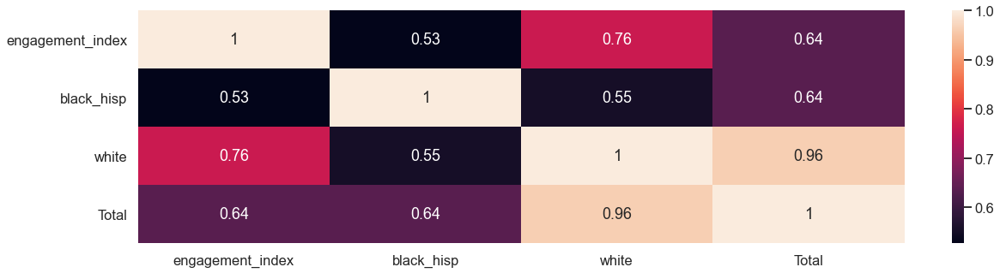

STATE: IL | DISTRICT 9043 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 35010
Black & Hispanic Students: 80% - 100%
Students With Free or Reduced Lunches: 80% - 100%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


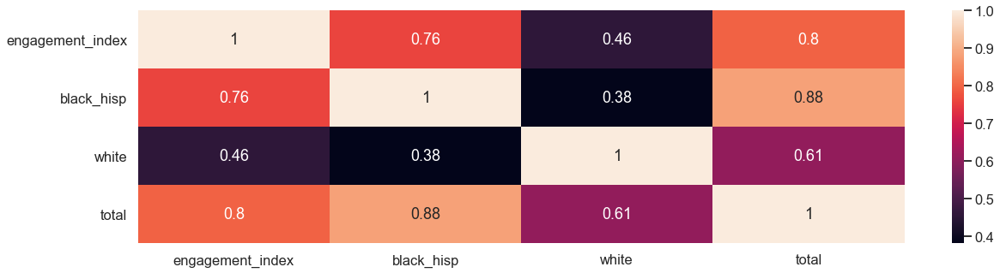

Statistic: Households With Lost Income Due To Pandemic


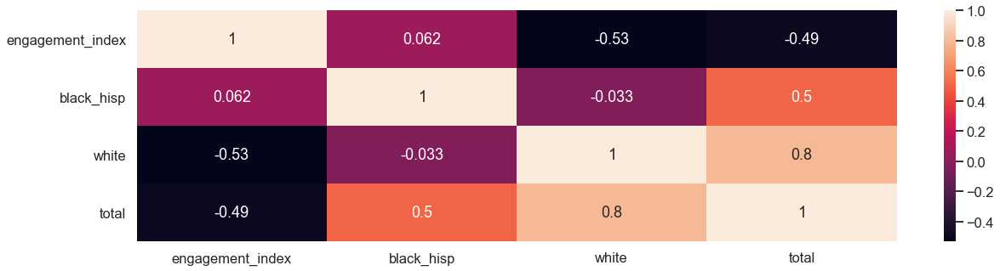

Statistic: Change in Education: Classes Cancelled


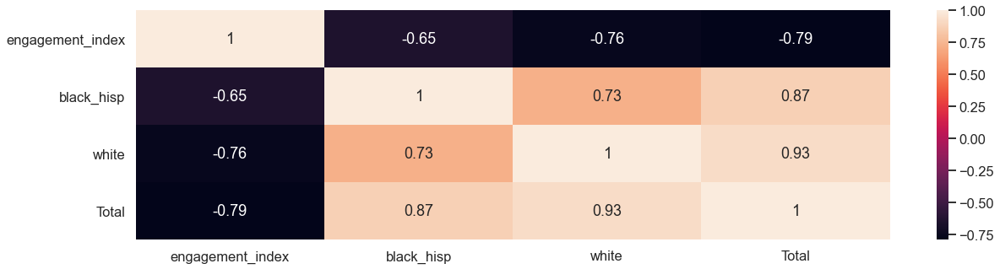

Statistic: Change in Education: Schools Open


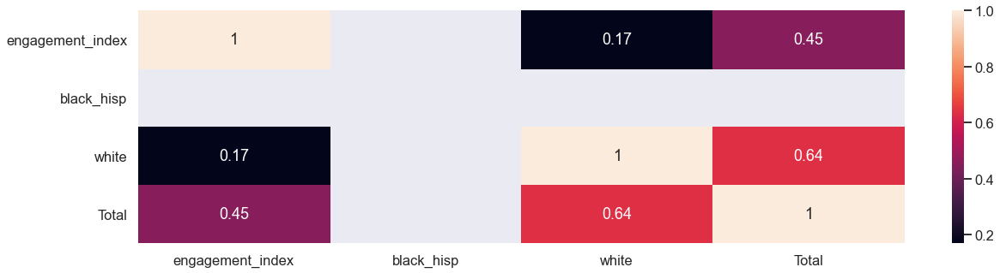

Statistic: Change in Education: Online Distance Learning


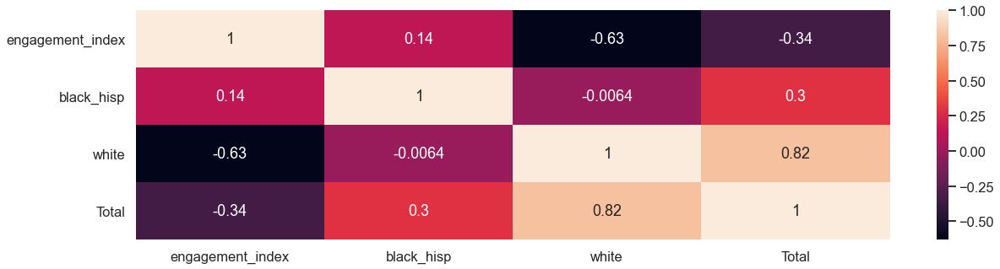

Statistic: Change in Education: Paper Distance Learning


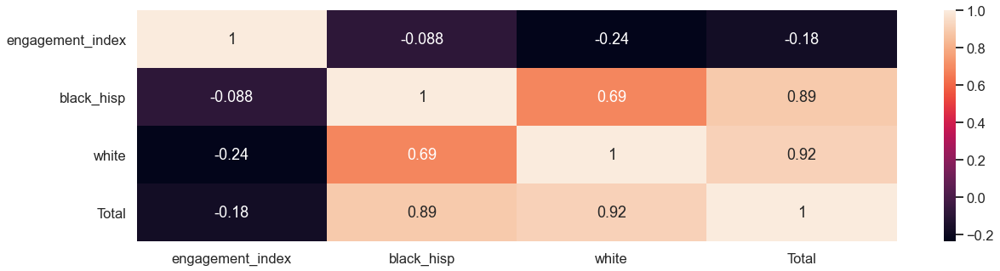

Statistic: Classes Change In Some Other Way


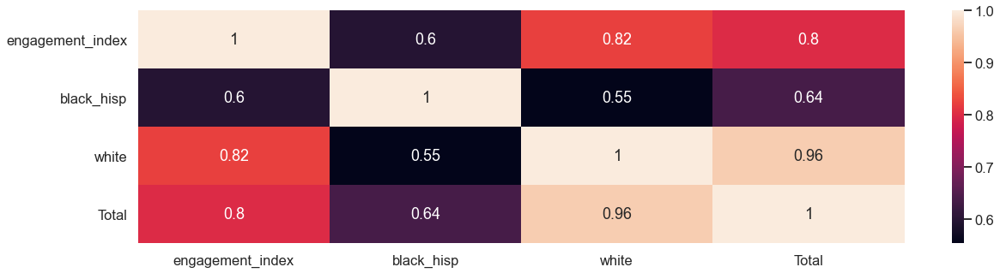

STATE: IL | DISTRICT 2285 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 25664
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $12000 - 14000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


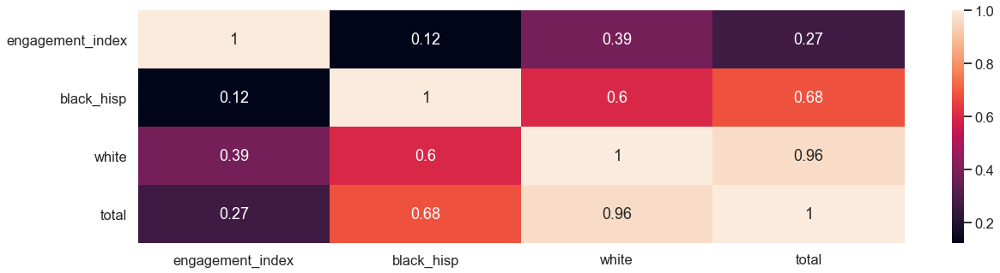

Statistic: Households With Lost Income Due To Pandemic


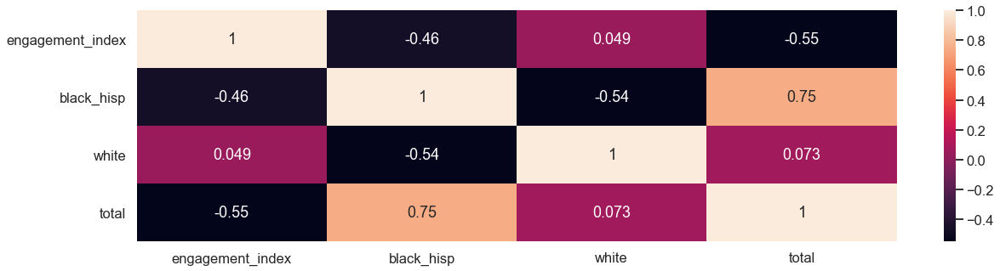

Statistic: Change in Education: Classes Cancelled


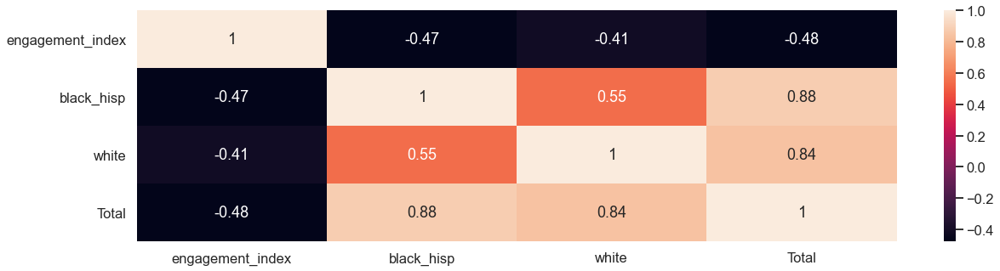

Statistic: Change in Education: Schools Open


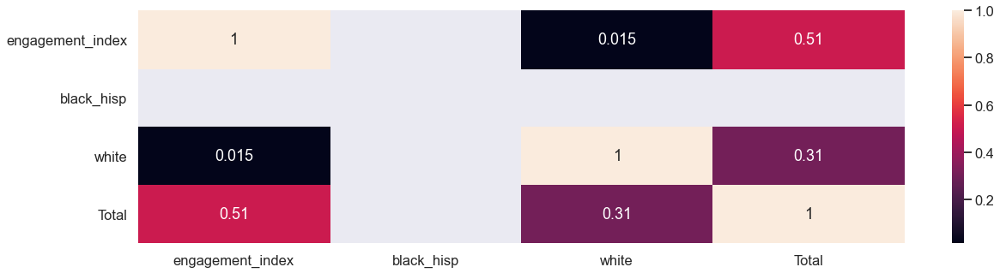

Statistic: Change in Education: Online Distance Learning


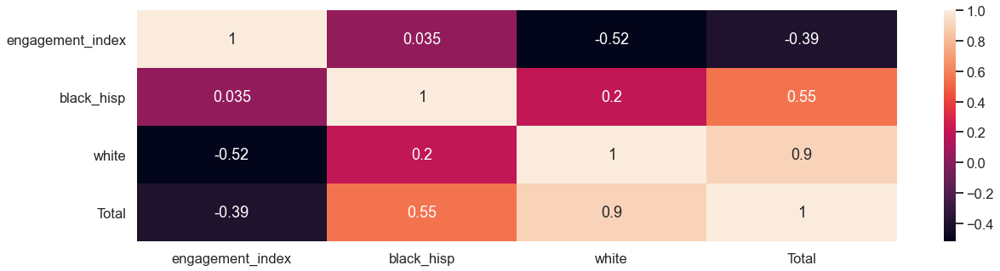

Statistic: Change in Education: Paper Distance Learning


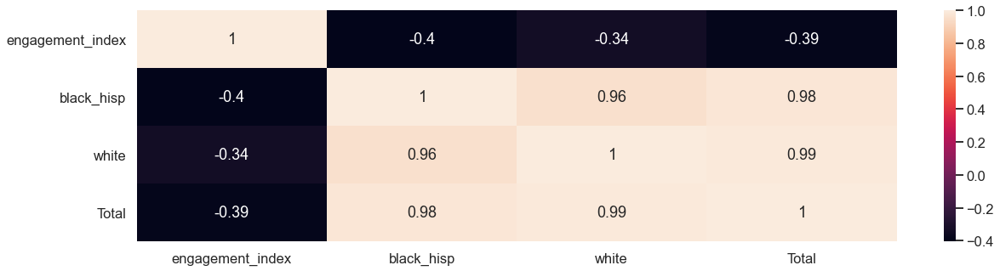

Statistic: Classes Change In Some Other Way


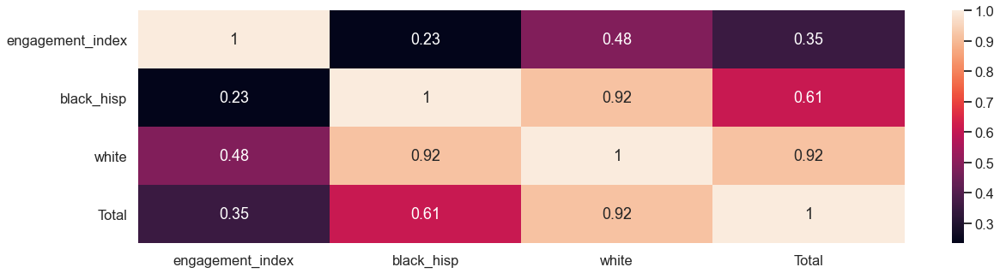

STATE: IL | DISTRICT 5042 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 2290
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 80% - 100%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          
Statistic: Household Access to Device & High Speed Connection


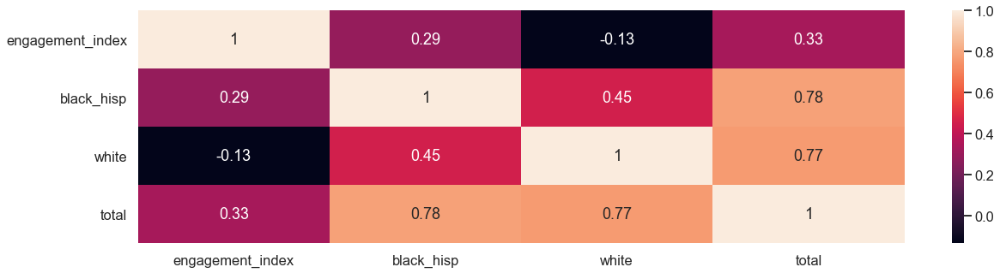

Statistic: Households With Lost Income Due To Pandemic


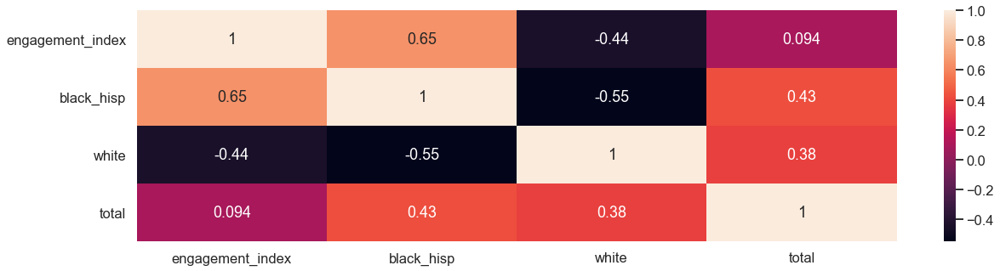

Statistic: Change in Education: Classes Cancelled


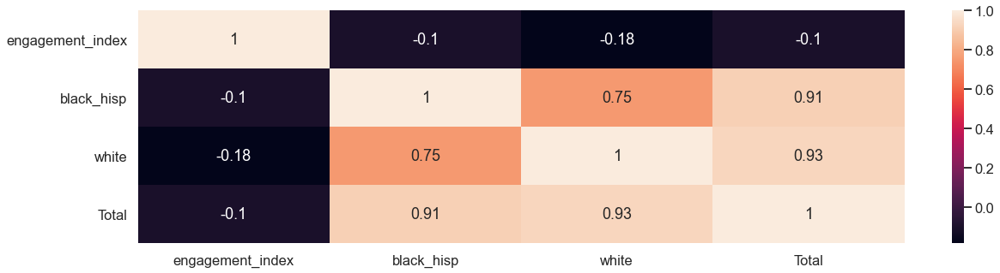

Statistic: Change in Education: Schools Open


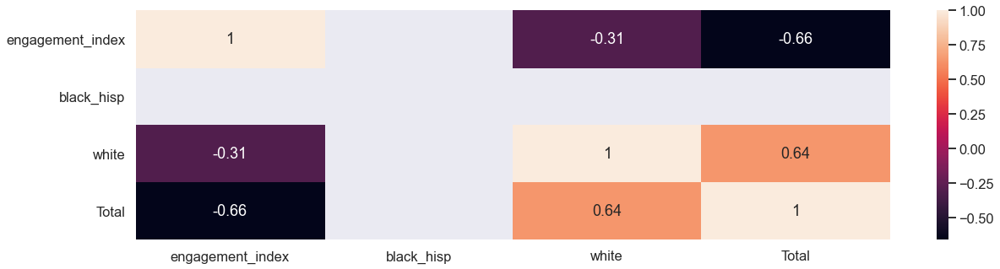

Statistic: Change in Education: Online Distance Learning


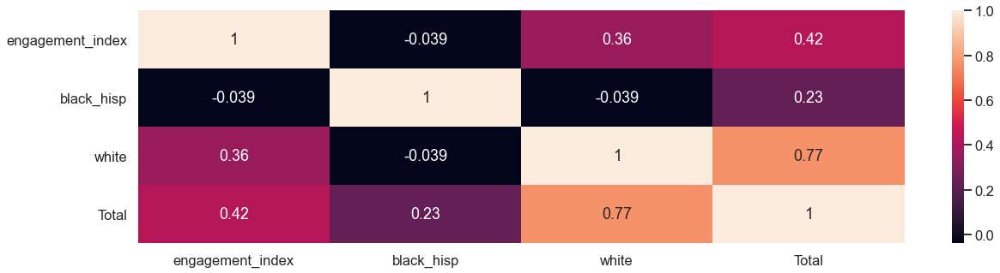

Statistic: Change in Education: Paper Distance Learning


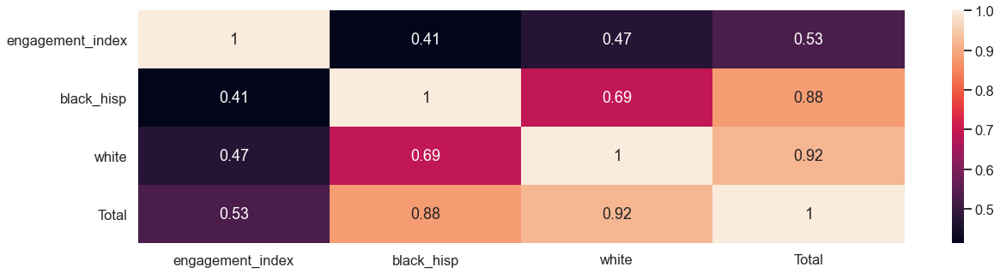

Statistic: Classes Change In Some Other Way


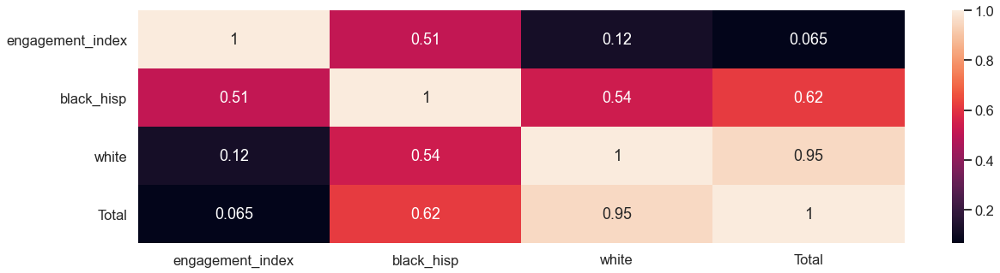

END IL CORRELATIONS
______________________________
______________________________
NY
                              
Statistic: Household Access to Device & High Speed Connection


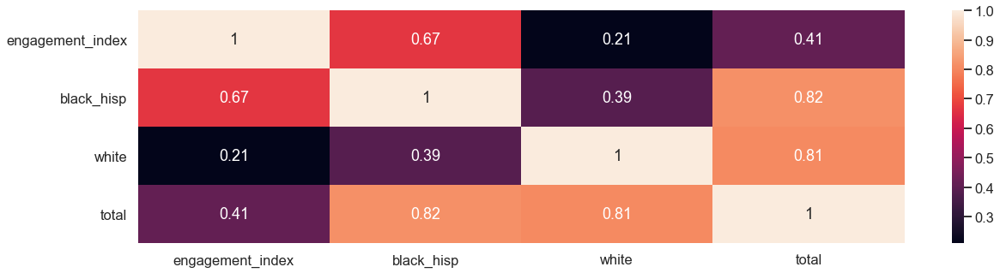

Statistic: Households With Lost Income Due To Pandemic


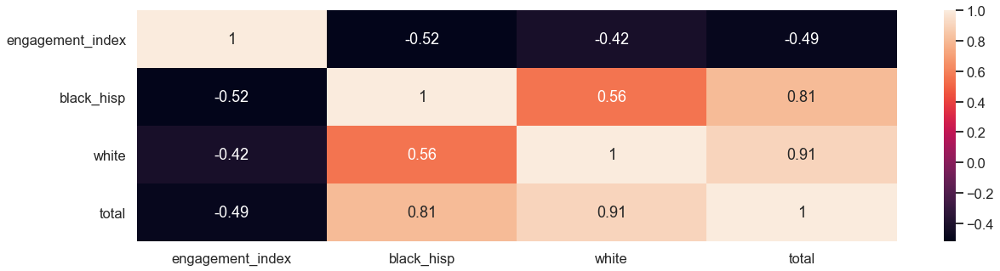

Statistic: Change in Education: Classes Cancelled


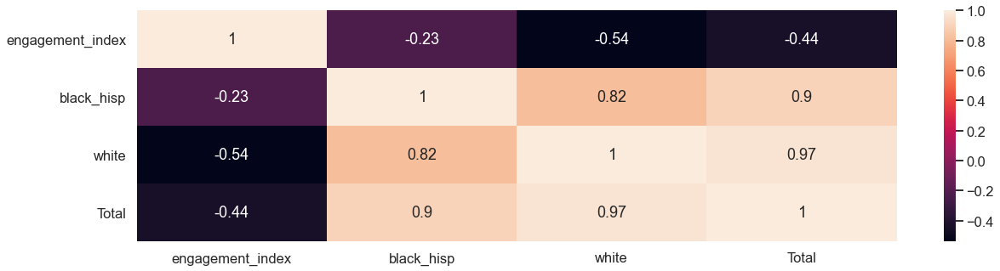

Statistic: Change in Education: Schools Open


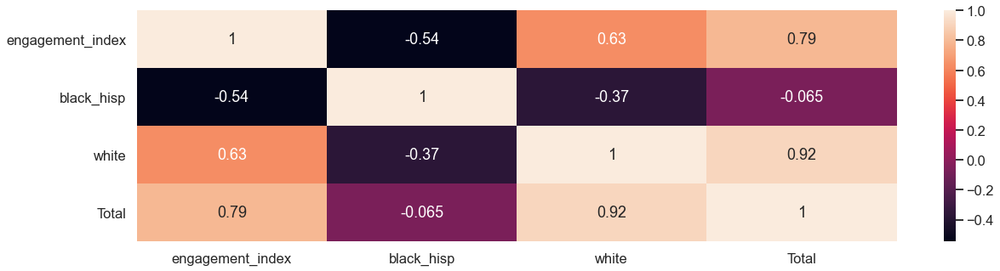

Statistic: Change in Education: Online Distance Learning


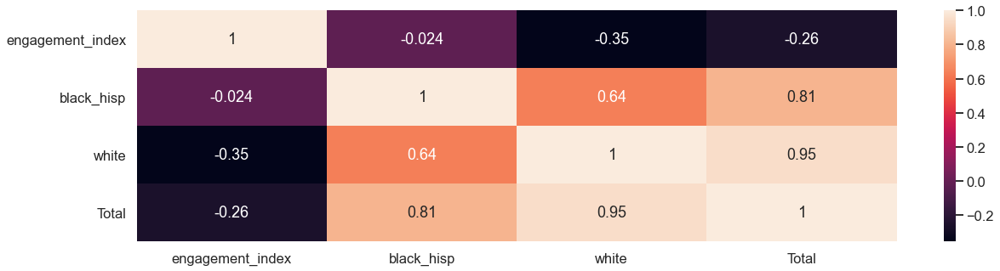

Statistic: Change in Education: Paper Distance Learning


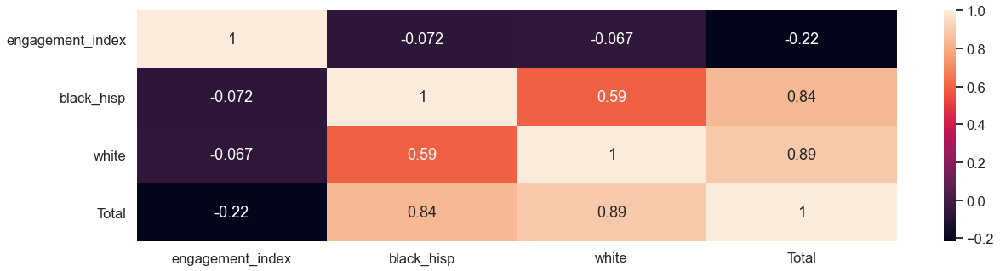

Statistic: Classes Change In Some Other Way


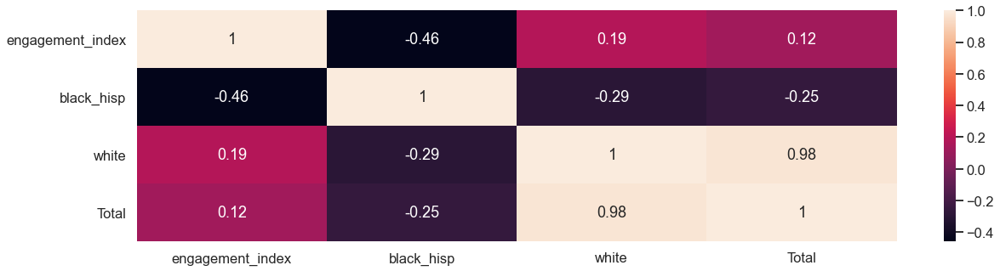

STATE: NY | DISTRICT 9536 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 85827
Black & Hispanic Students: 80% - 100%
Students With Free or Reduced Lunches: 80% - 100%
Per Pupil Yearly Expenditure: Not Reported
District Locale: City
          
Statistic: Household Access to Device & High Speed Connection


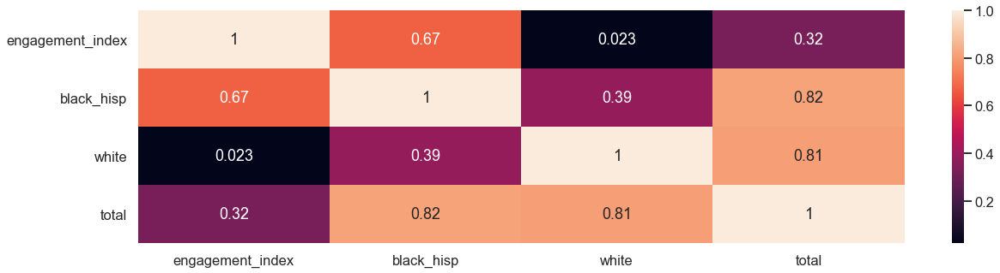

Statistic: Households With Lost Income Due To Pandemic


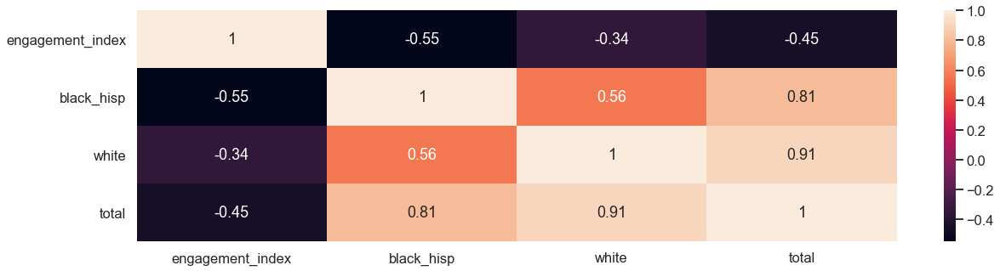

Statistic: Change in Education: Classes Cancelled


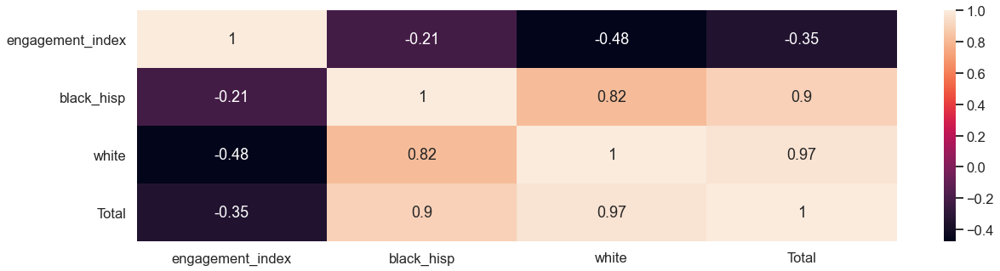

Statistic: Change in Education: Schools Open


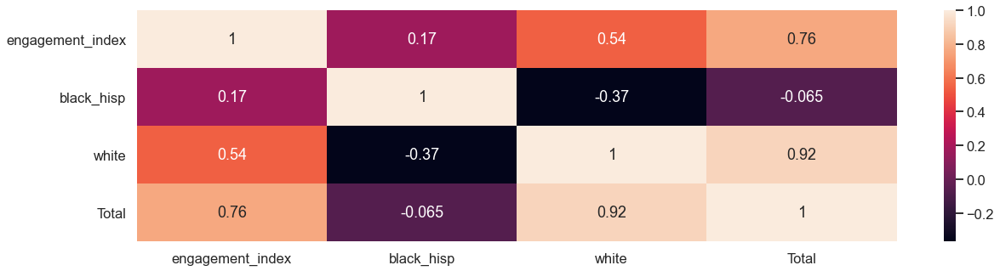

Statistic: Change in Education: Online Distance Learning


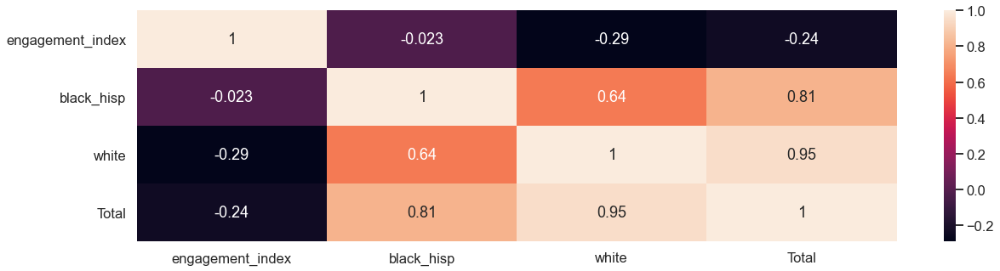

Statistic: Change in Education: Paper Distance Learning


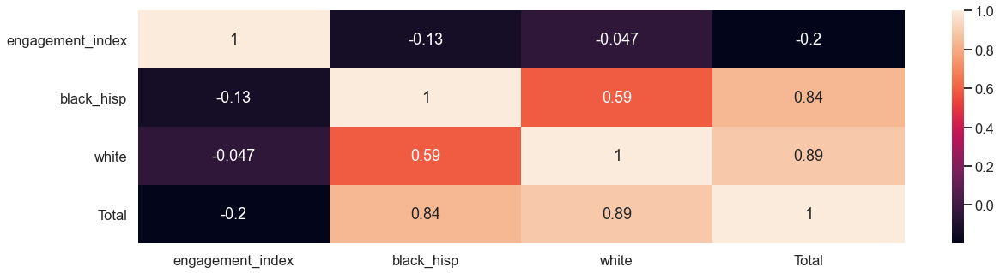

Statistic: Classes Change In Some Other Way


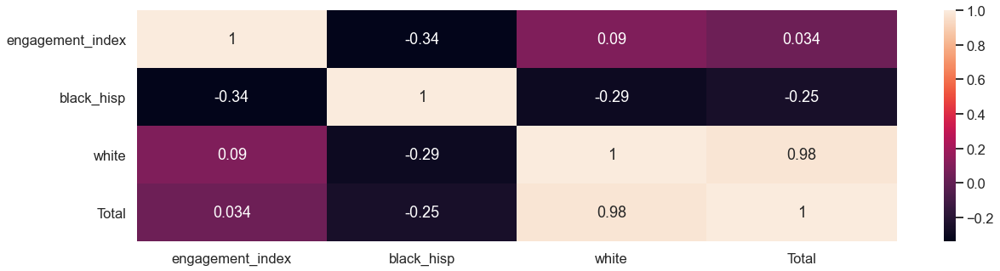

STATE: NY | DISTRICT 7798 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 50443
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $22000 - 24000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


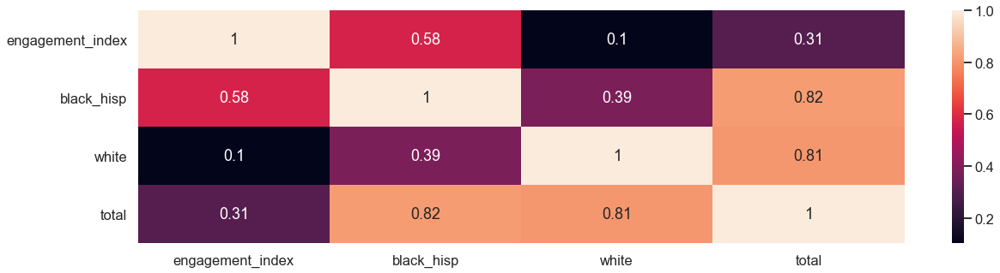

Statistic: Households With Lost Income Due To Pandemic


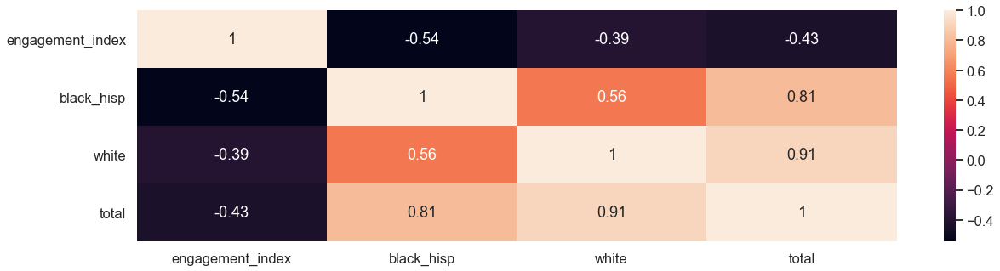

Statistic: Change in Education: Classes Cancelled


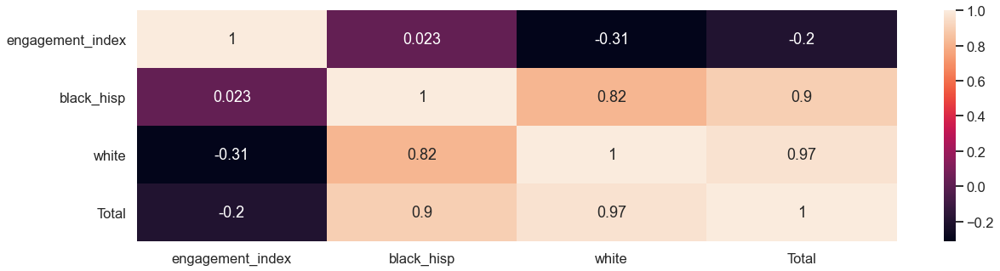

Statistic: Change in Education: Schools Open


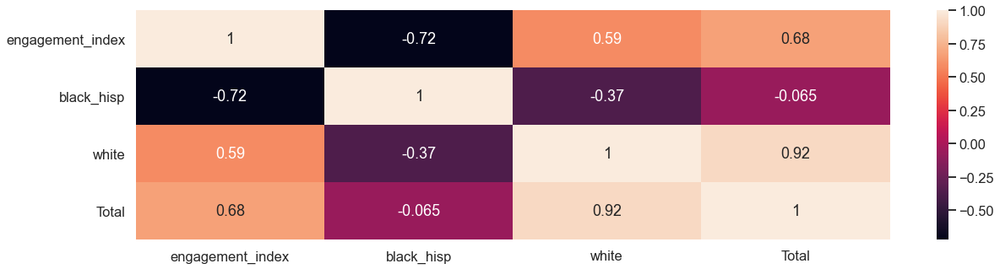

Statistic: Change in Education: Online Distance Learning


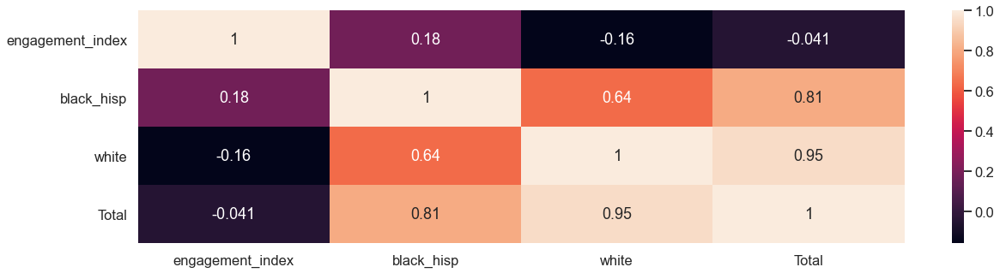

Statistic: Change in Education: Paper Distance Learning


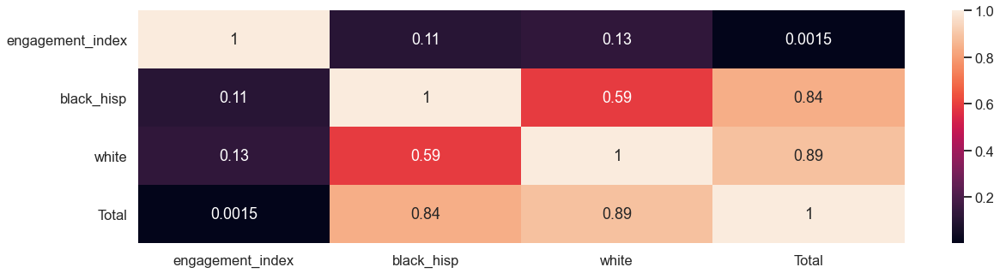

Statistic: Classes Change In Some Other Way


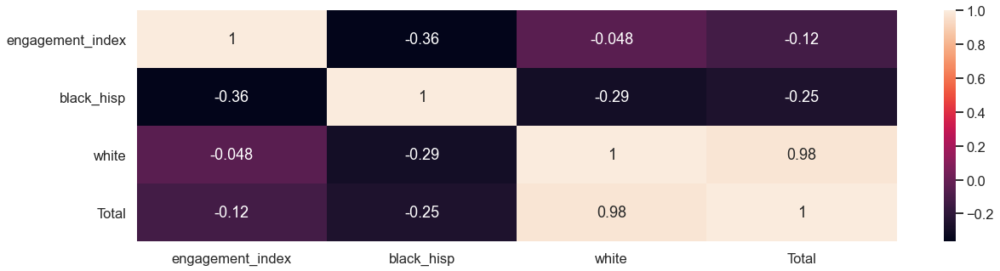

STATE: NY | DISTRICT 2257 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 46807
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $20000 - 22000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


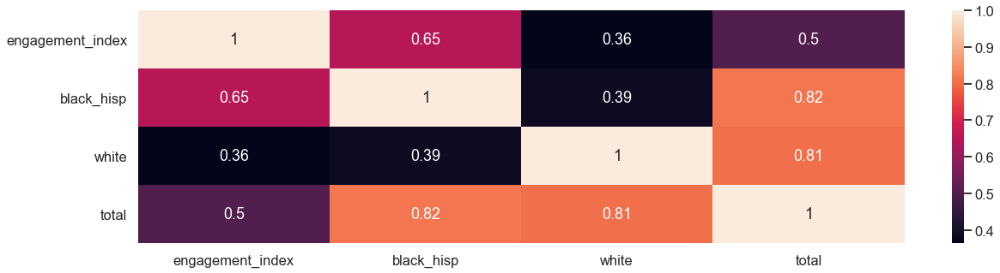

Statistic: Households With Lost Income Due To Pandemic


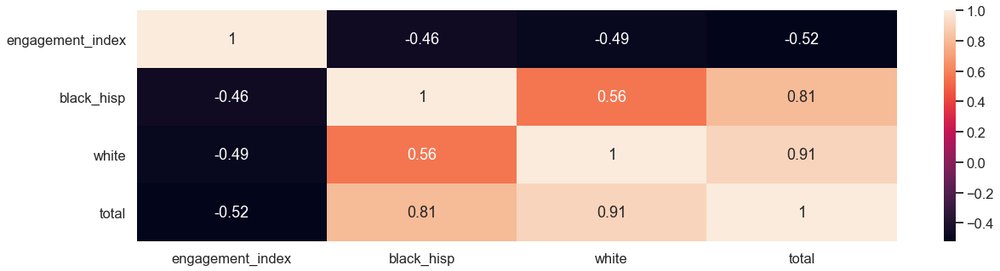

Statistic: Change in Education: Classes Cancelled


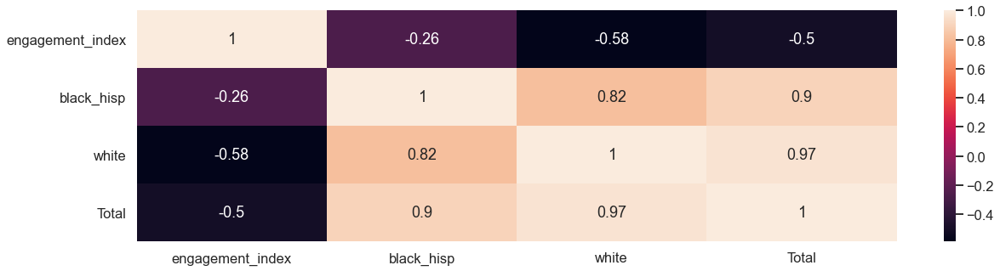

Statistic: Change in Education: Schools Open


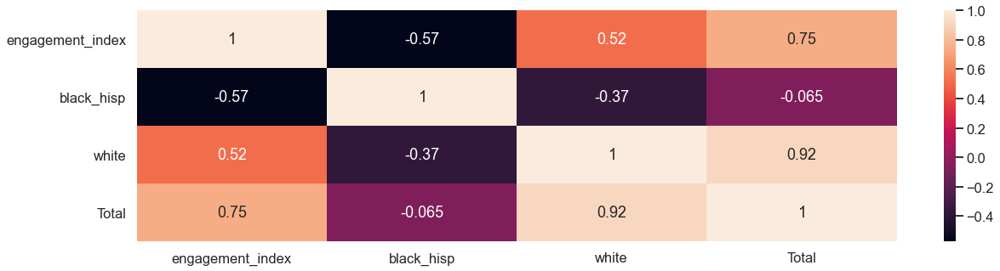

Statistic: Change in Education: Online Distance Learning


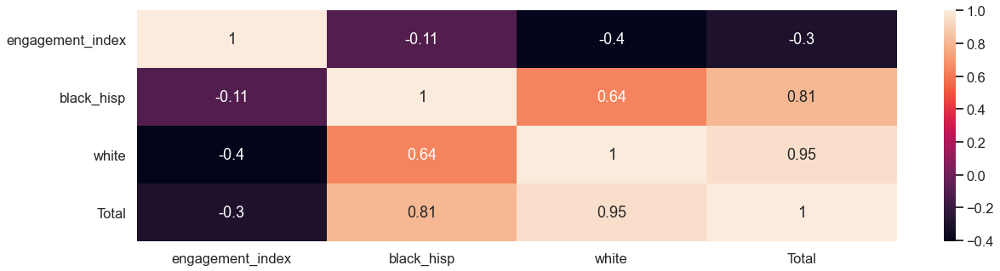

Statistic: Change in Education: Paper Distance Learning


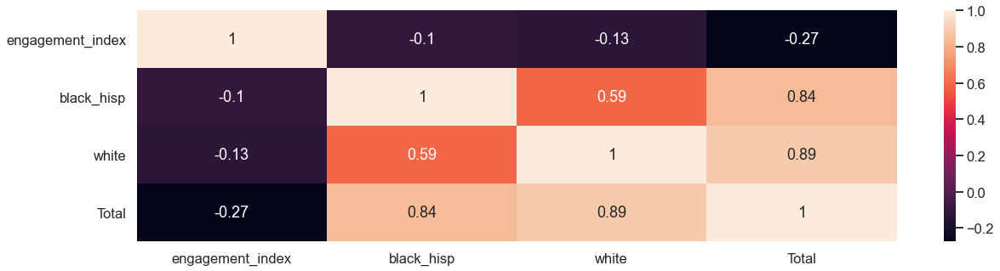

Statistic: Classes Change In Some Other Way


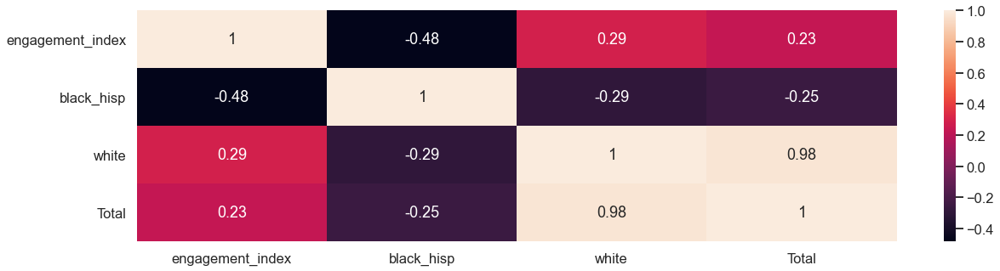

STATE: NY | DISTRICT 1470 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 35137
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $32000 - 34000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


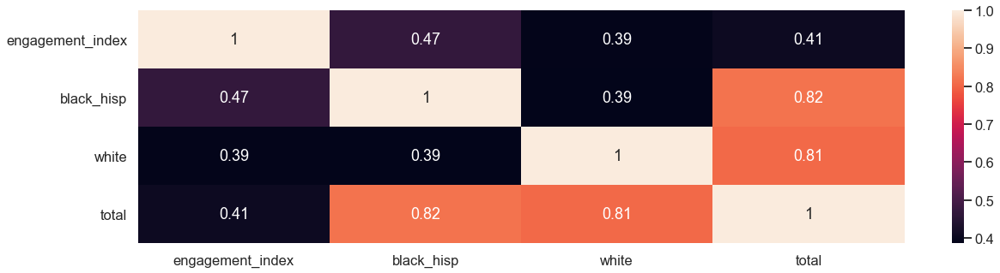

Statistic: Households With Lost Income Due To Pandemic


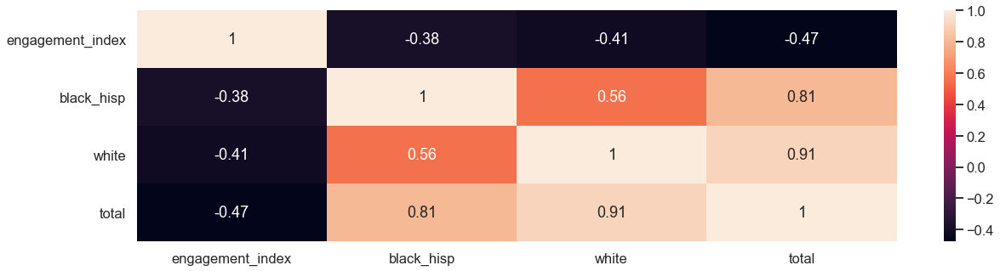

Statistic: Change in Education: Classes Cancelled


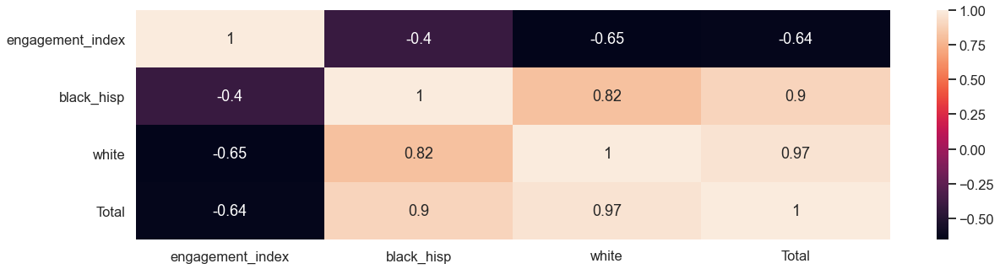

Statistic: Change in Education: Schools Open


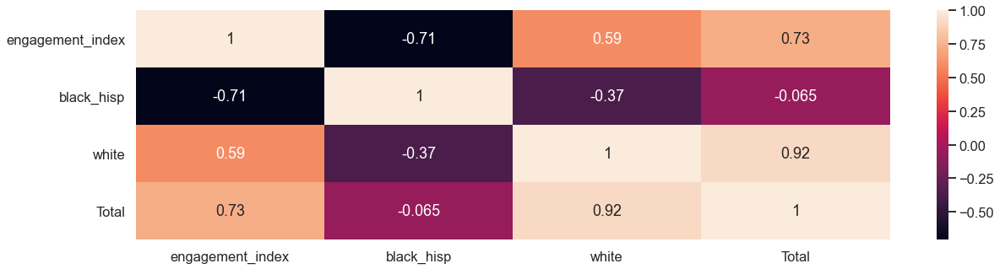

Statistic: Change in Education: Online Distance Learning


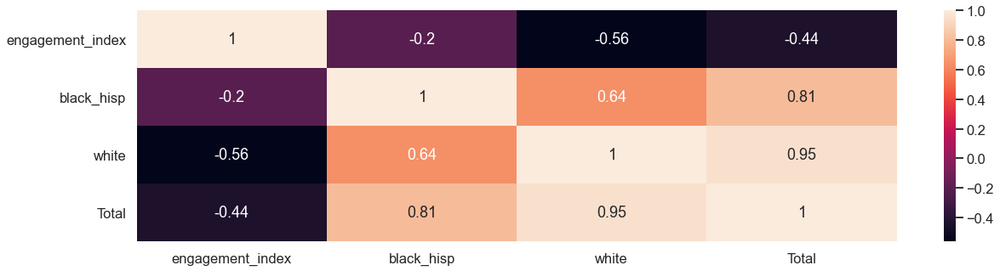

Statistic: Change in Education: Paper Distance Learning


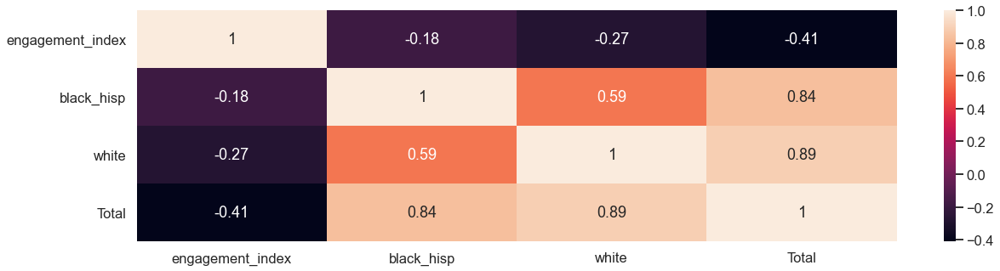

Statistic: Classes Change In Some Other Way


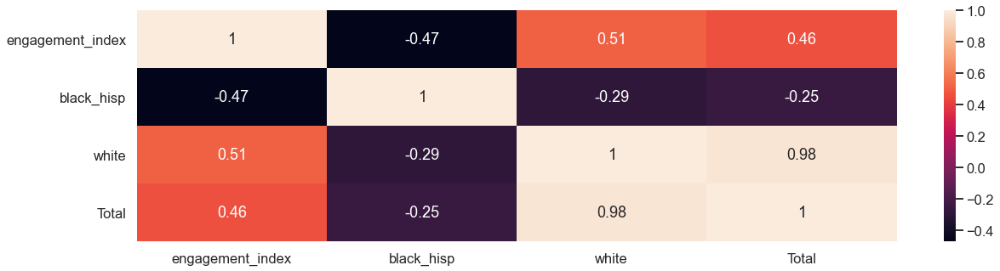

STATE: NY | DISTRICT 8520 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 33452
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


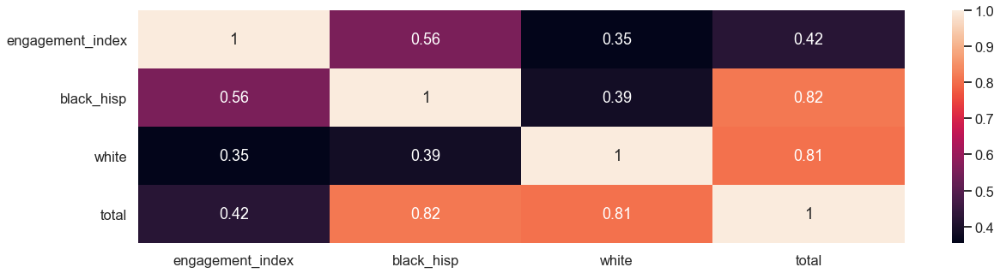

Statistic: Households With Lost Income Due To Pandemic


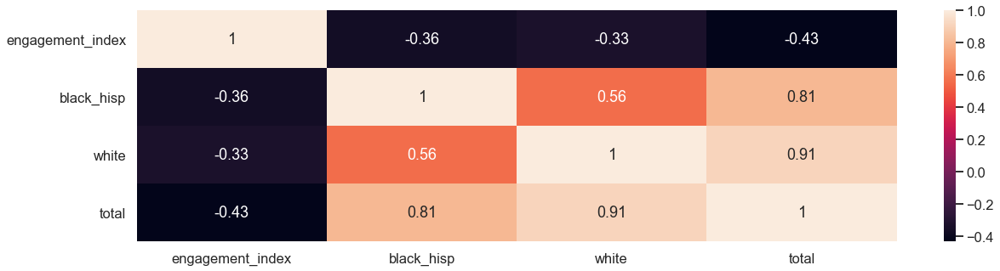

Statistic: Change in Education: Classes Cancelled


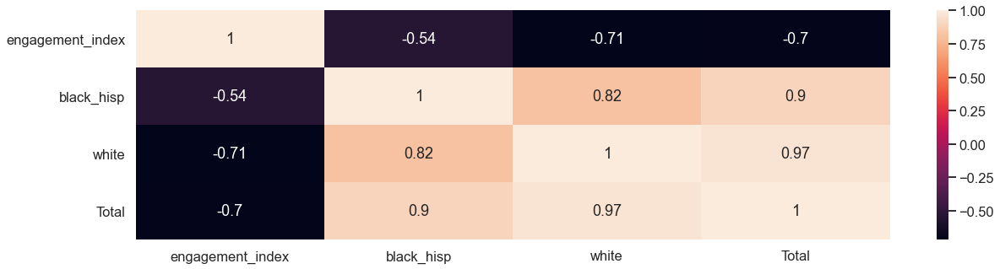

Statistic: Change in Education: Schools Open


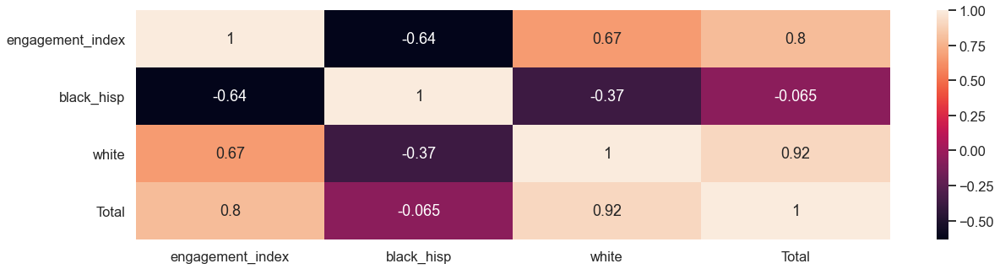

Statistic: Change in Education: Online Distance Learning


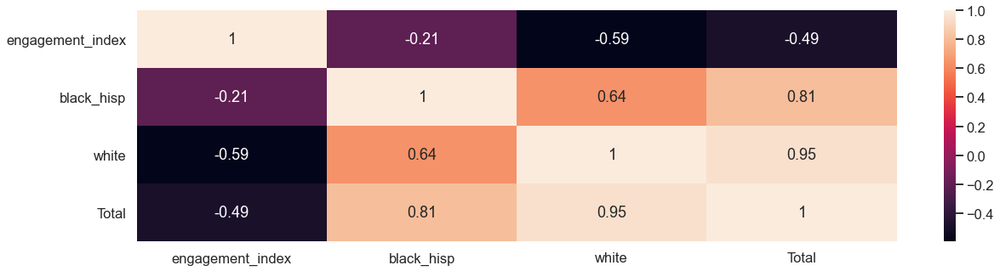

Statistic: Change in Education: Paper Distance Learning


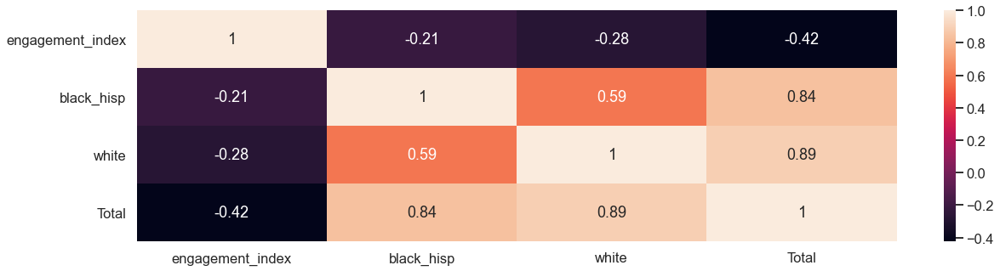

Statistic: Classes Change In Some Other Way


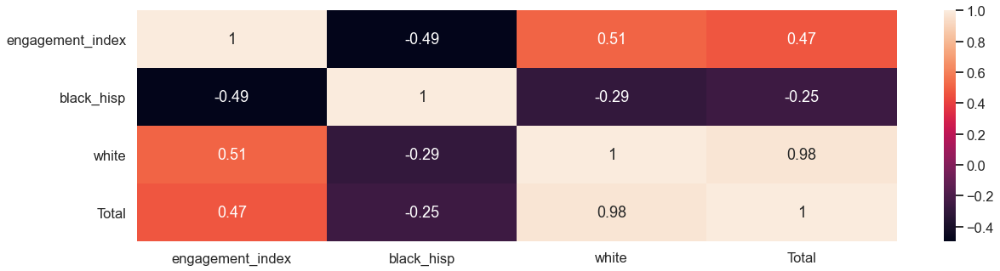

STATE: NY | DISTRICT 4775 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 18116
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $16000 - 18000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


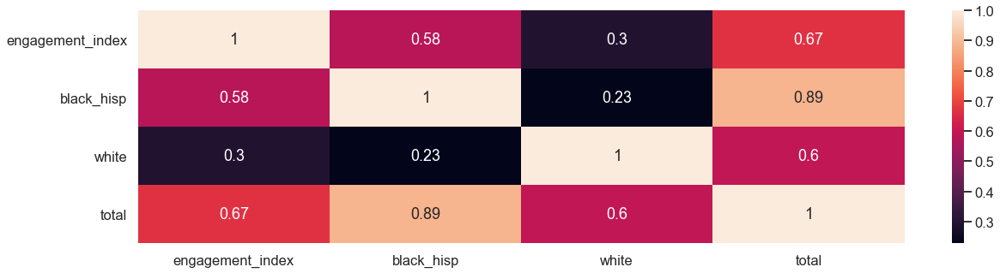

Statistic: Households With Lost Income Due To Pandemic


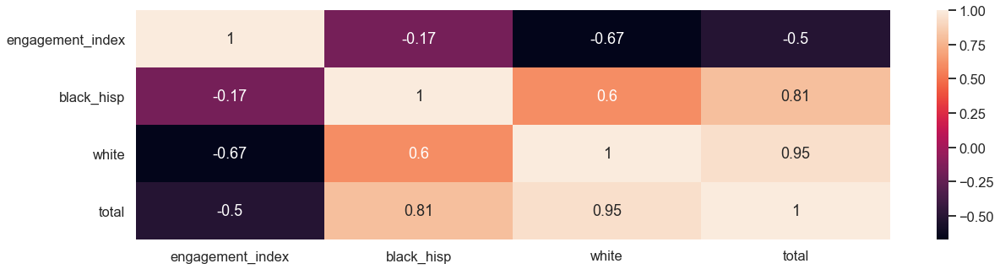

Statistic: Change in Education: Classes Cancelled


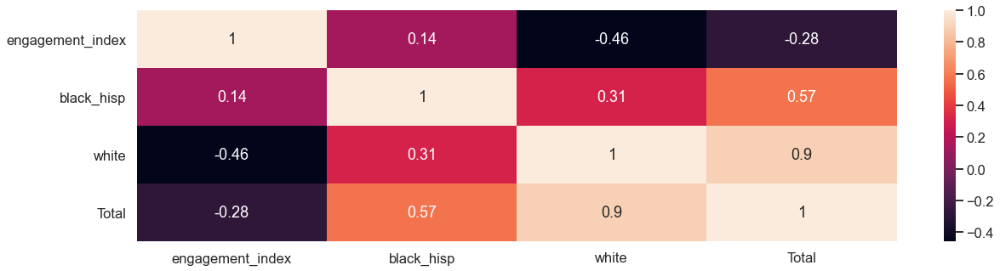

Statistic: Change in Education: Schools Open


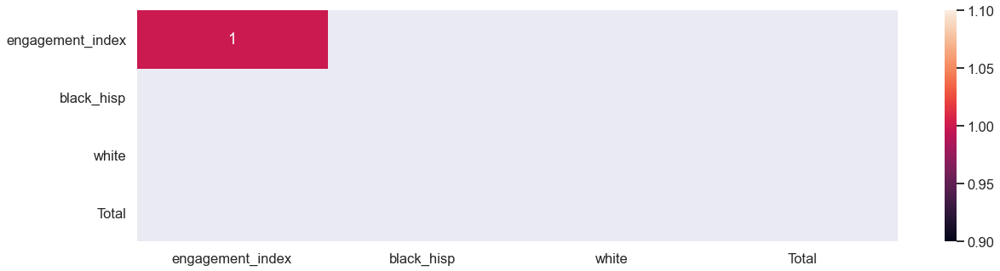

Statistic: Change in Education: Online Distance Learning


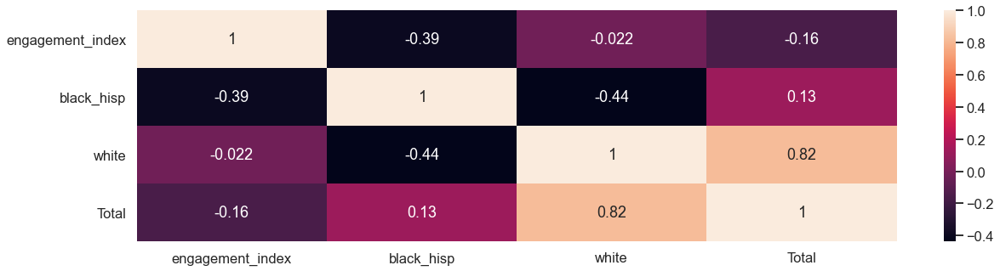

Statistic: Change in Education: Paper Distance Learning


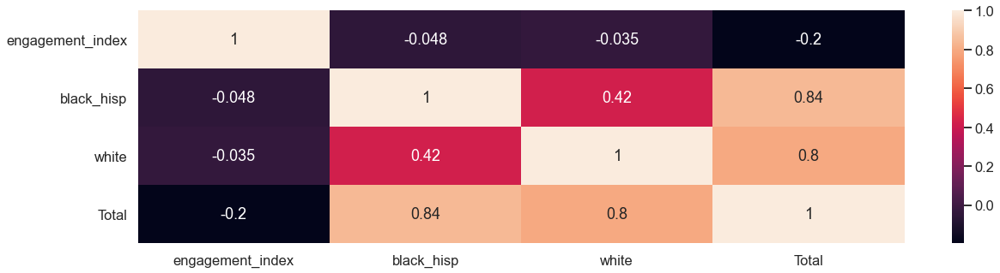

Statistic: Classes Change In Some Other Way


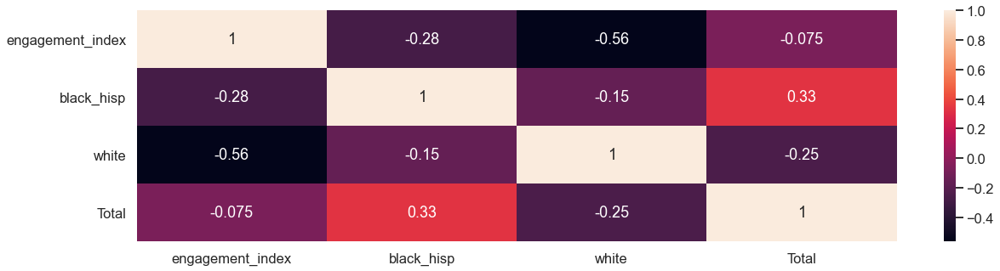

STATE: NY | DISTRICT 9515 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 16810
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $18000 - 20000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


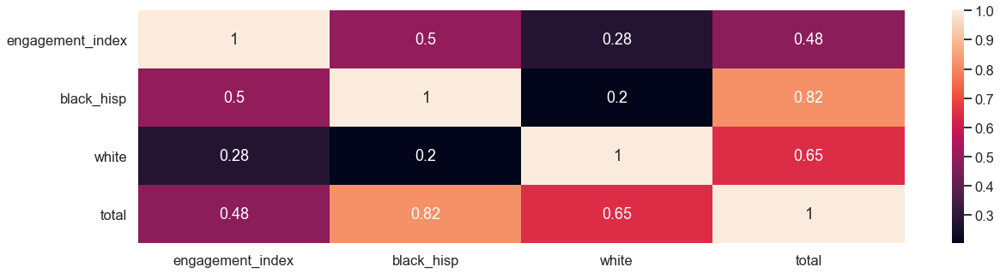

Statistic: Households With Lost Income Due To Pandemic


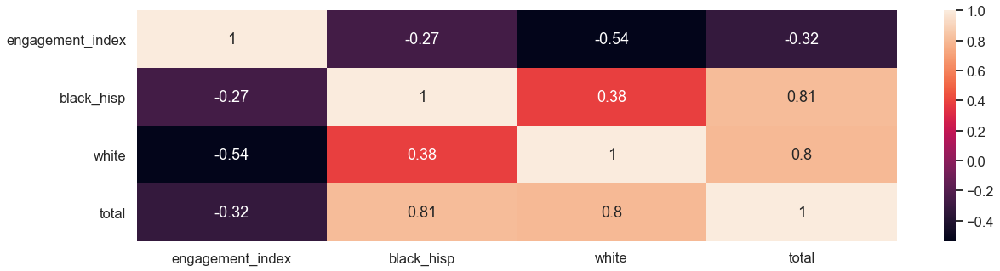

Statistic: Change in Education: Classes Cancelled


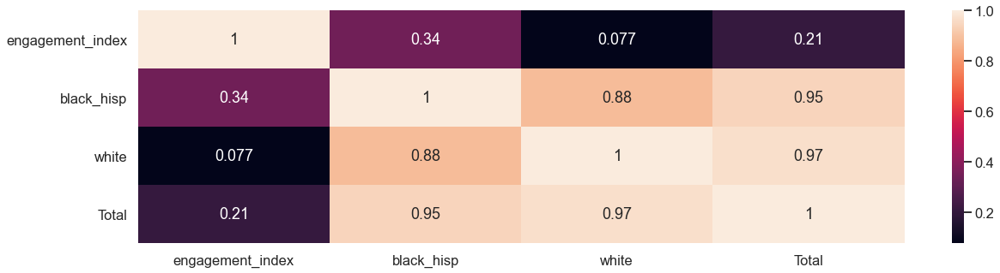

Statistic: Change in Education: Schools Open


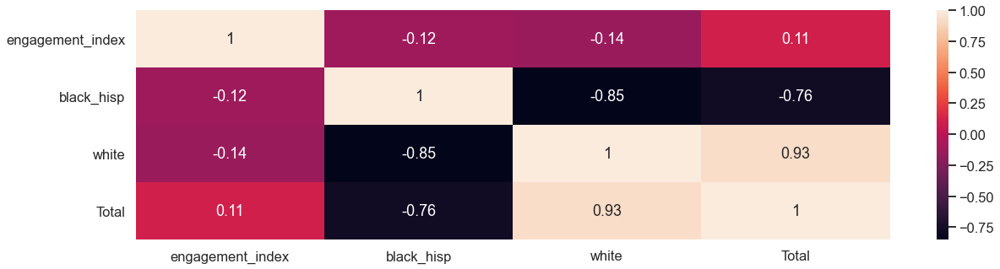

Statistic: Change in Education: Online Distance Learning


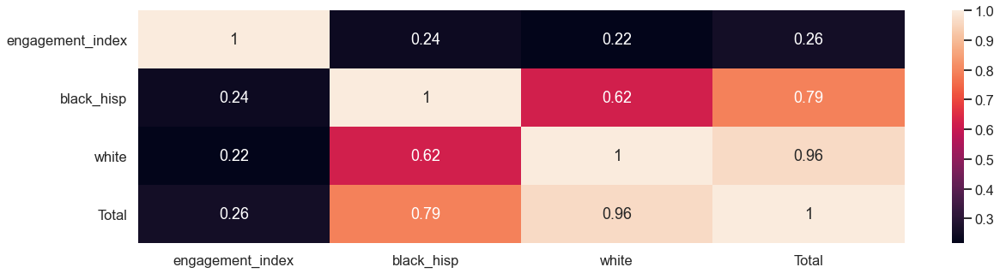

Statistic: Change in Education: Paper Distance Learning


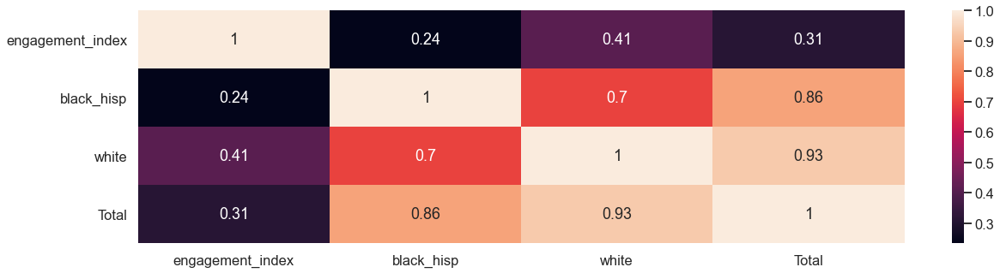

Statistic: Classes Change In Some Other Way


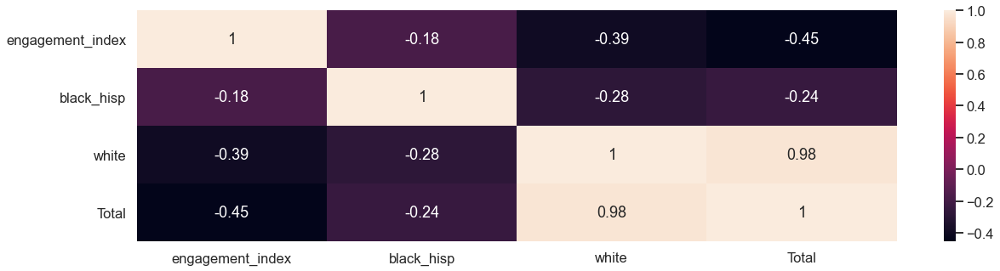

STATE: NY | DISTRICT 2940 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 6354
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $14000 - 16000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


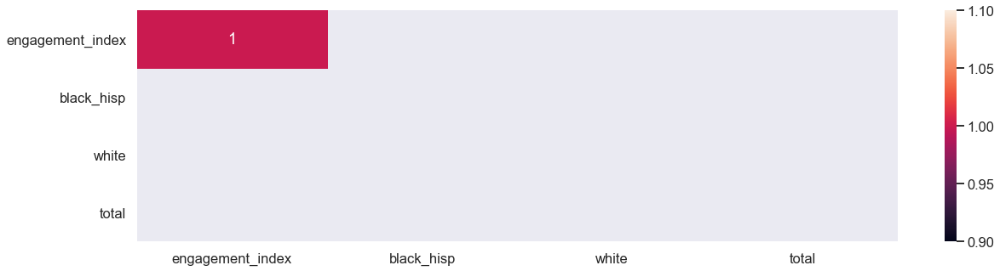

Statistic: Households With Lost Income Due To Pandemic


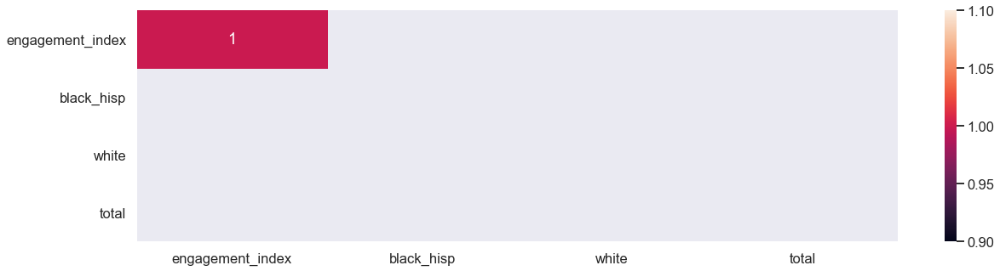

Statistic: Change in Education: Classes Cancelled


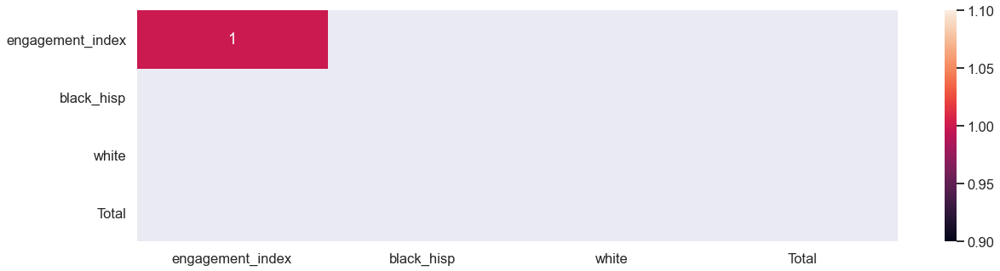

Statistic: Change in Education: Schools Open


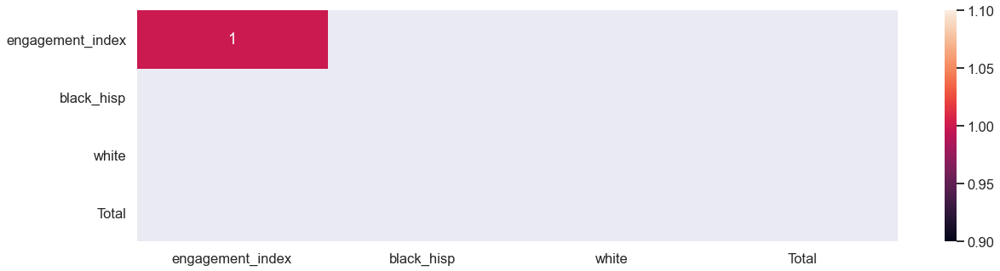

Statistic: Change in Education: Online Distance Learning


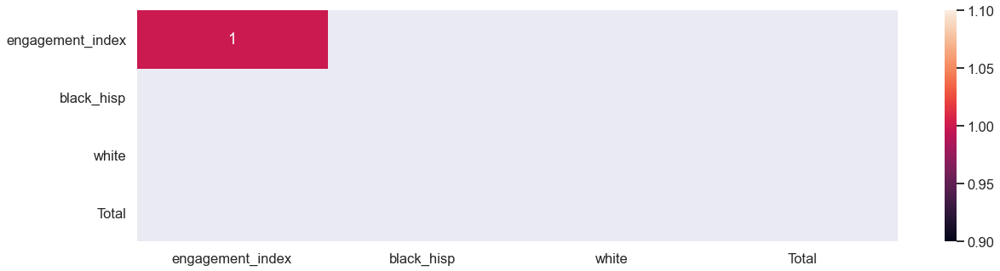

Statistic: Change in Education: Paper Distance Learning


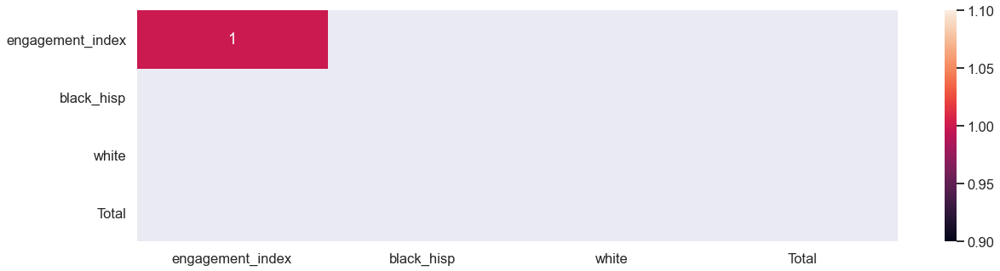

Statistic: Classes Change In Some Other Way


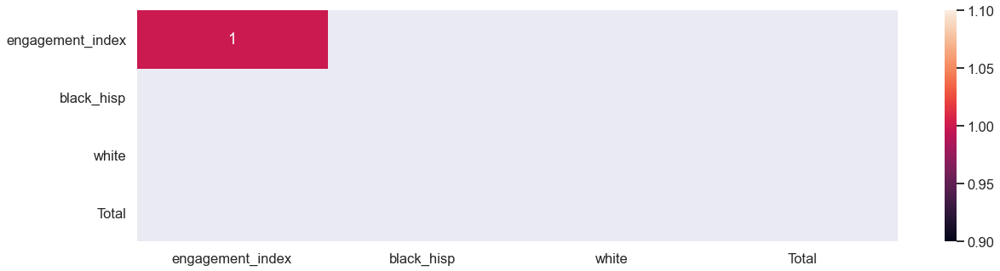

END NY CORRELATIONS
______________________________
______________________________
UT
                              
Statistic: Household Access to Device & High Speed Connection


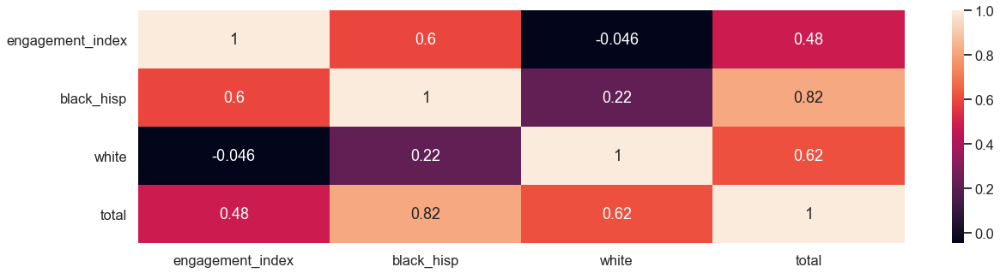

Statistic: Households With Lost Income Due To Pandemic


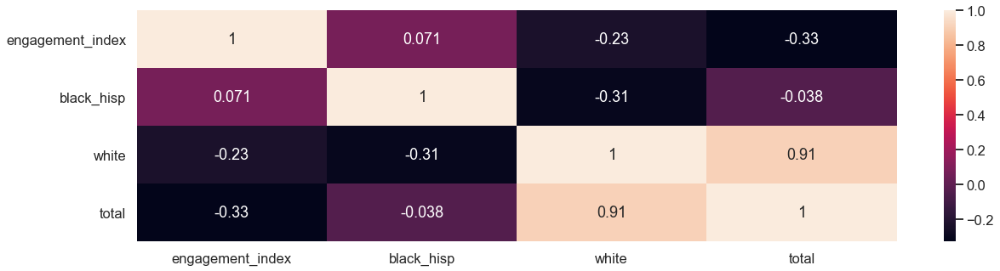

Statistic: Change in Education: Classes Cancelled


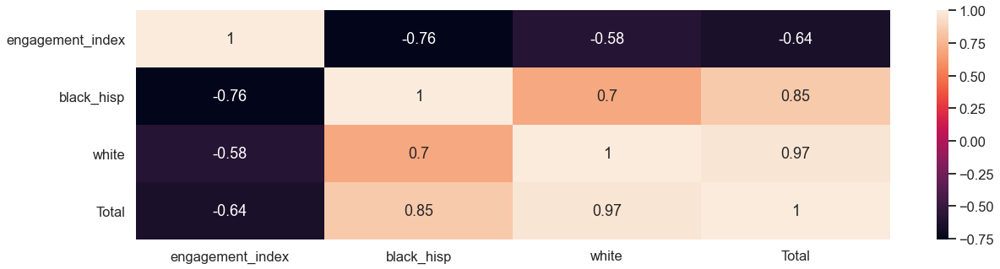

Statistic: Change in Education: Schools Open


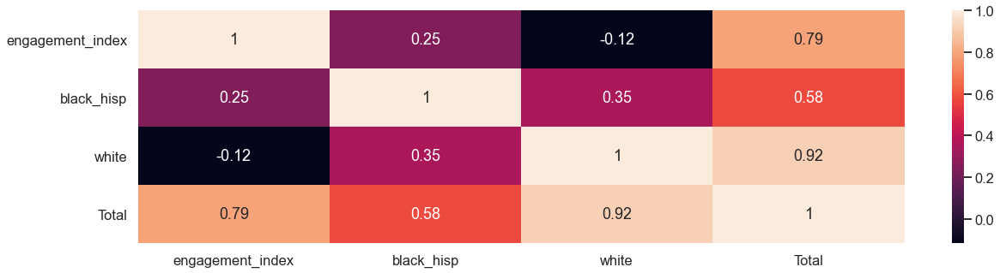

Statistic: Change in Education: Online Distance Learning


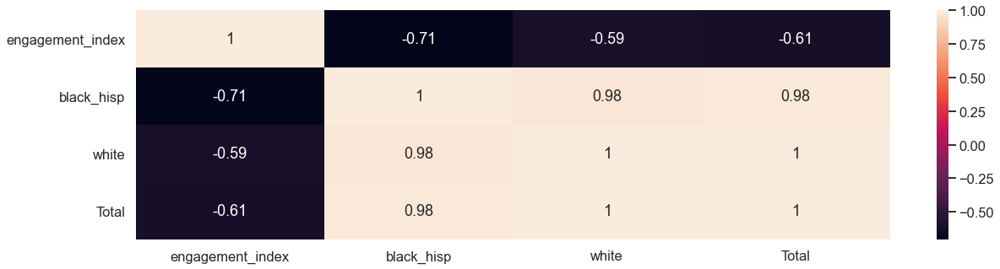

Statistic: Change in Education: Paper Distance Learning


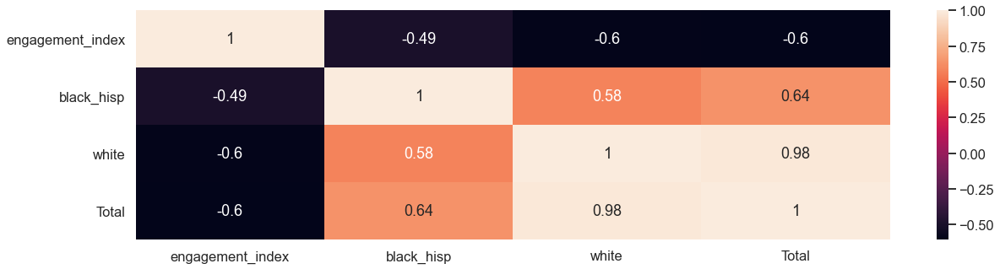

Statistic: Classes Change In Some Other Way


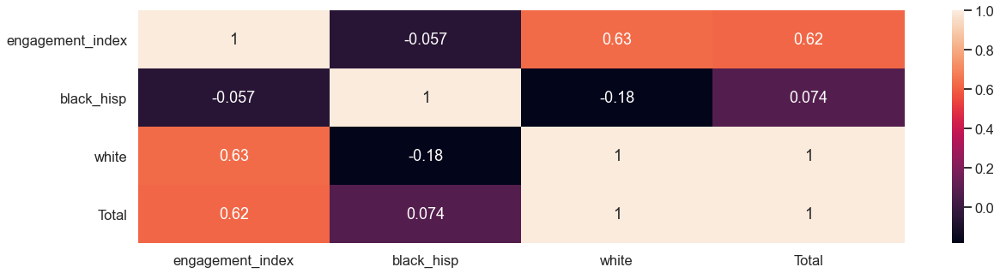

STATE: UT | DISTRICT 5231 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 55183
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          
Statistic: Household Access to Device & High Speed Connection


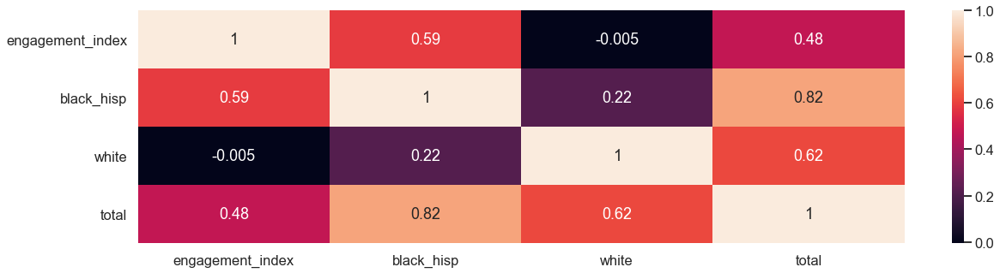

Statistic: Households With Lost Income Due To Pandemic


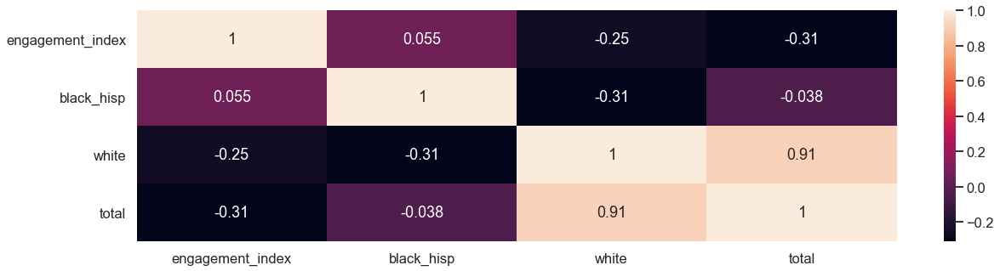

Statistic: Change in Education: Classes Cancelled


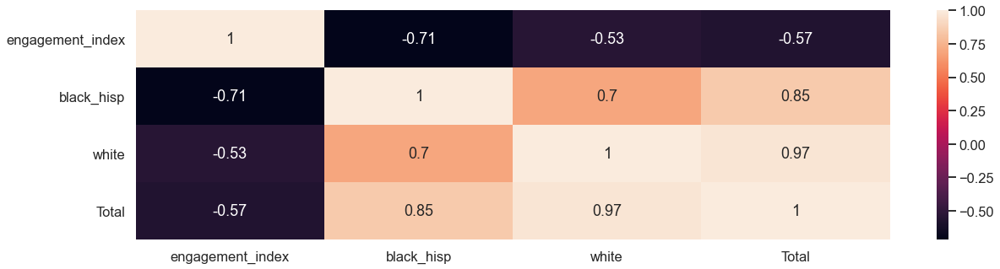

Statistic: Change in Education: Schools Open


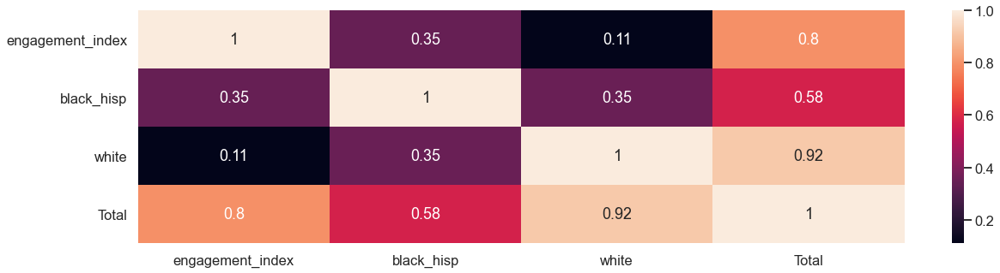

Statistic: Change in Education: Online Distance Learning


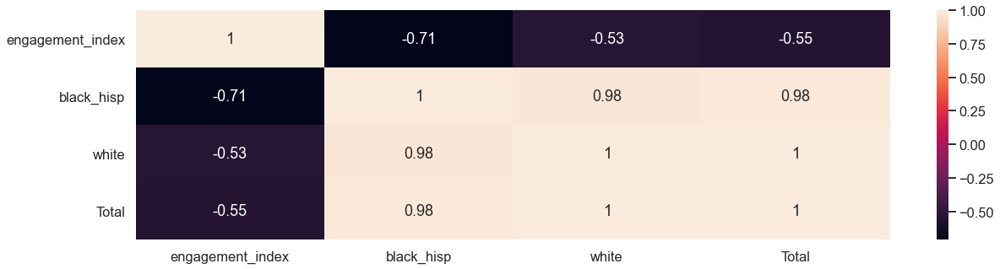

Statistic: Change in Education: Paper Distance Learning


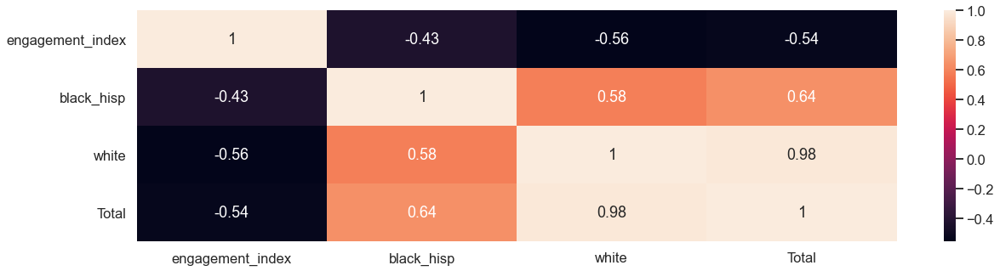

Statistic: Classes Change In Some Other Way


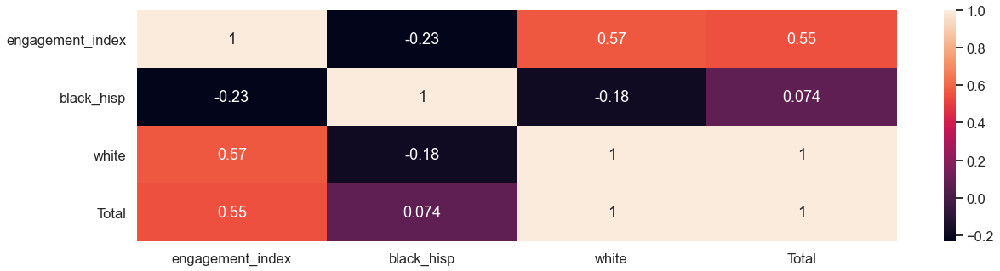

STATE: UT | DISTRICT 4744 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 53896
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


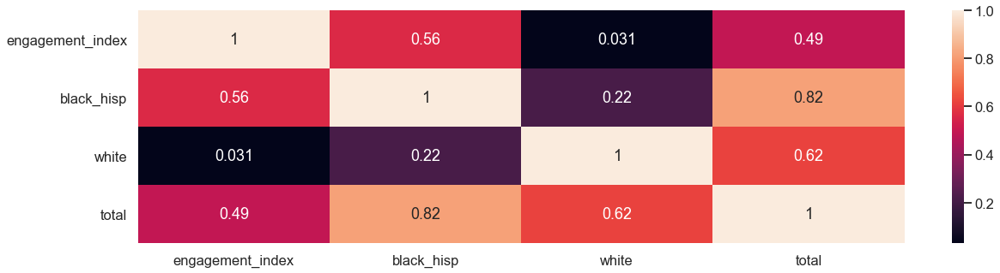

Statistic: Households With Lost Income Due To Pandemic


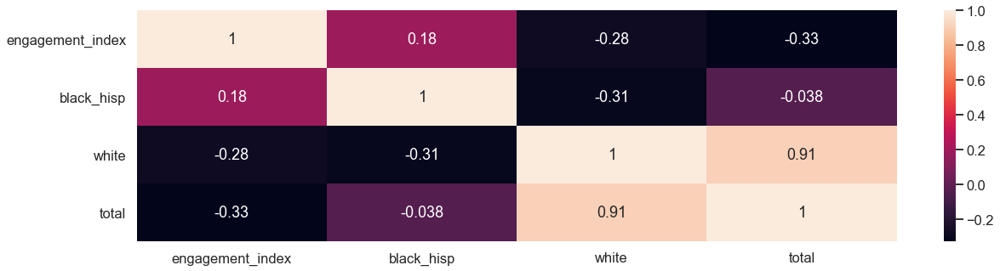

Statistic: Change in Education: Classes Cancelled


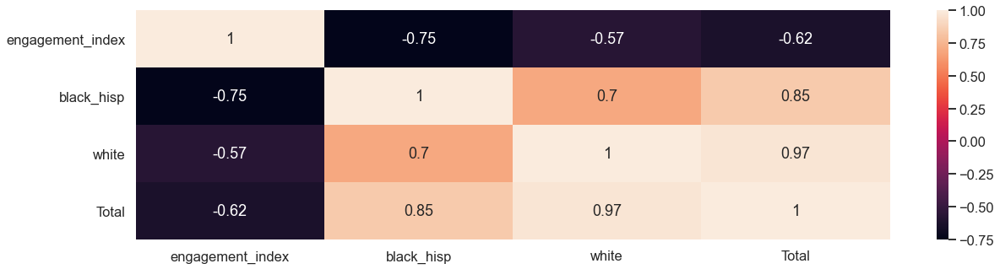

Statistic: Change in Education: Schools Open


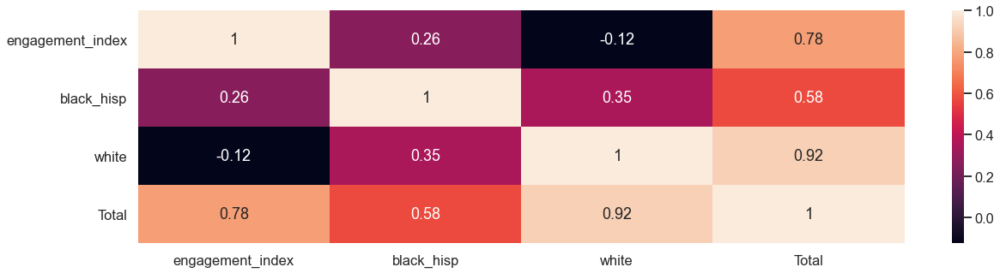

Statistic: Change in Education: Online Distance Learning


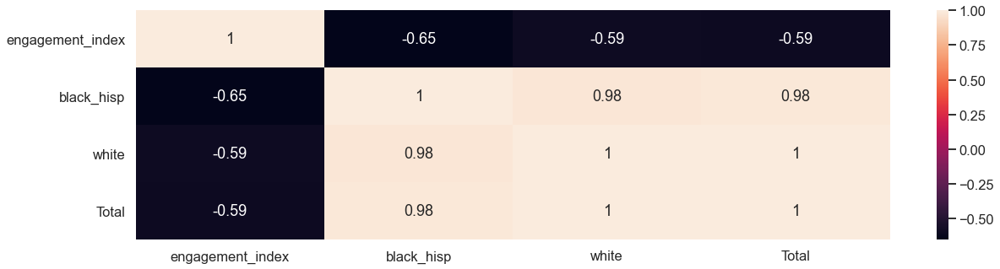

Statistic: Change in Education: Paper Distance Learning


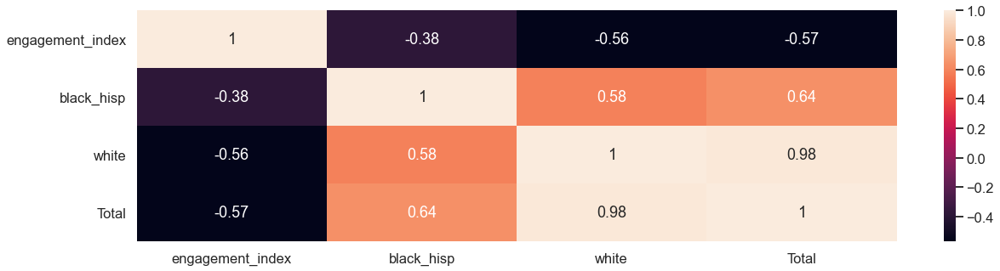

Statistic: Classes Change In Some Other Way


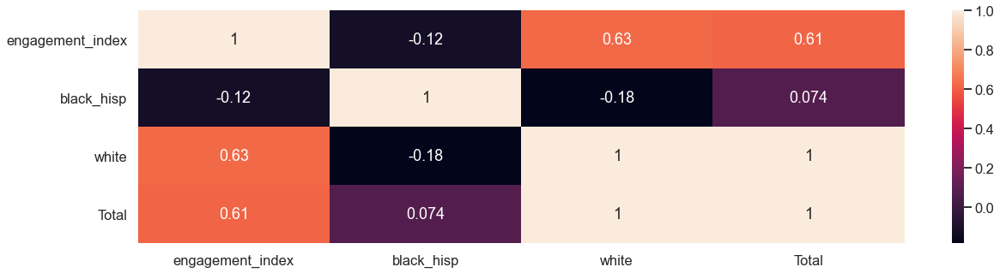

STATE: UT | DISTRICT 4936 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 40153
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


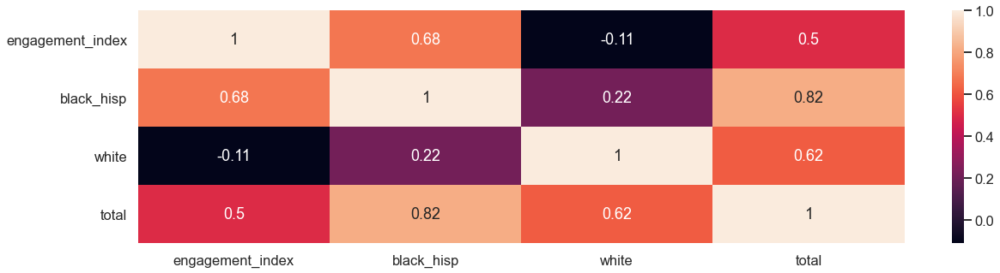

Statistic: Households With Lost Income Due To Pandemic


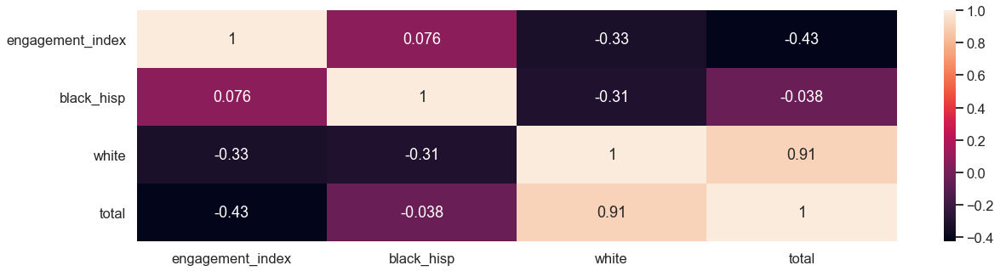

Statistic: Change in Education: Classes Cancelled


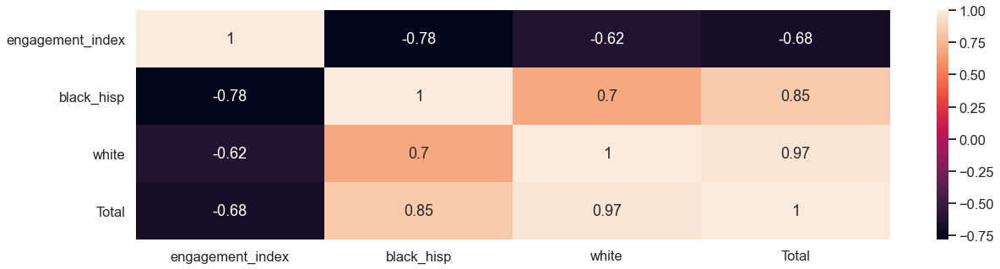

Statistic: Change in Education: Schools Open


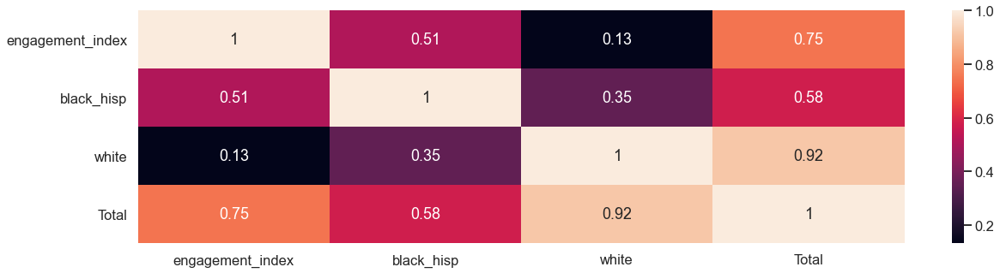

Statistic: Change in Education: Online Distance Learning


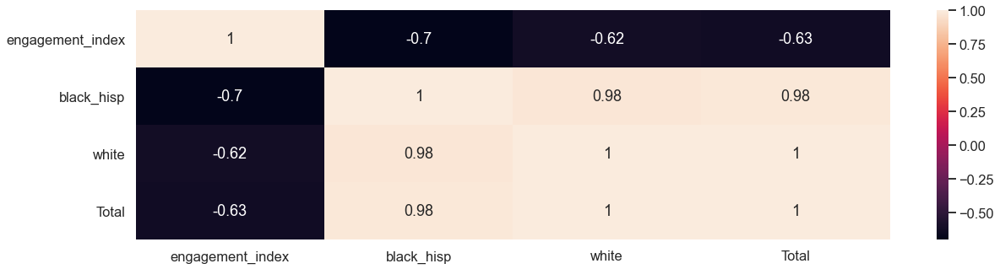

Statistic: Change in Education: Paper Distance Learning


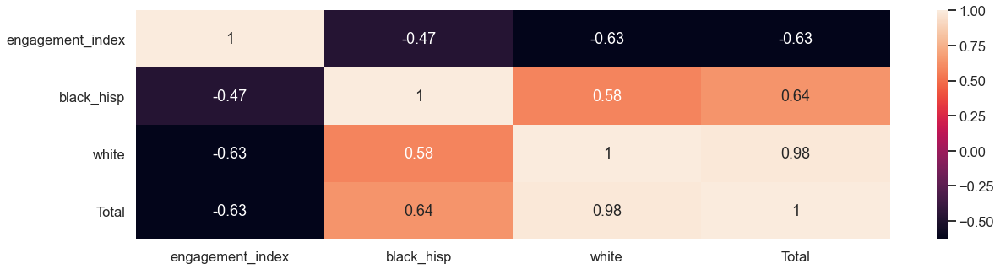

Statistic: Classes Change In Some Other Way


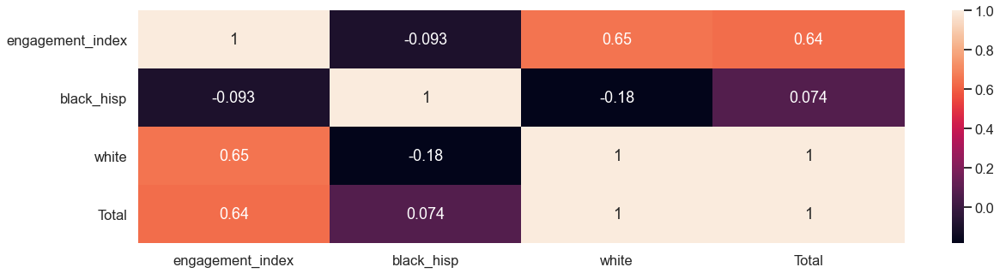

STATE: UT | DISTRICT 9812 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 31415
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


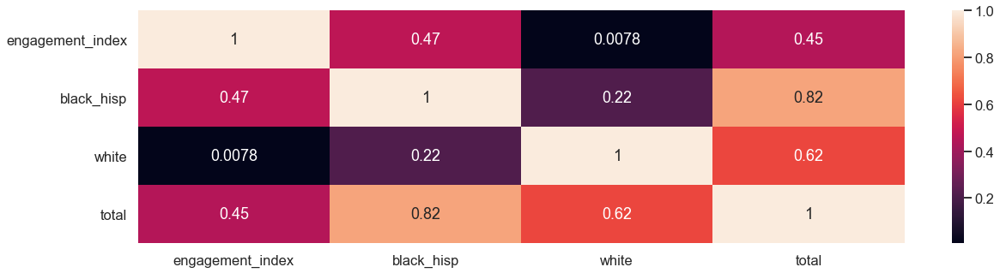

Statistic: Households With Lost Income Due To Pandemic


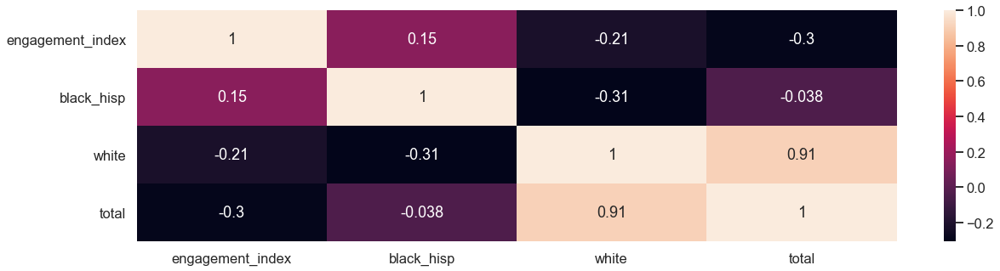

Statistic: Change in Education: Classes Cancelled


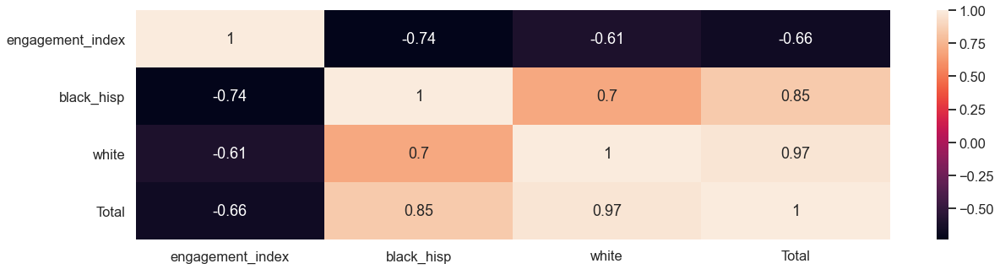

Statistic: Change in Education: Schools Open


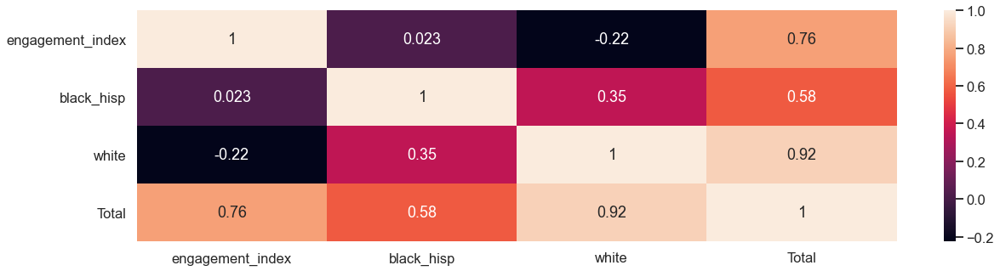

Statistic: Change in Education: Online Distance Learning


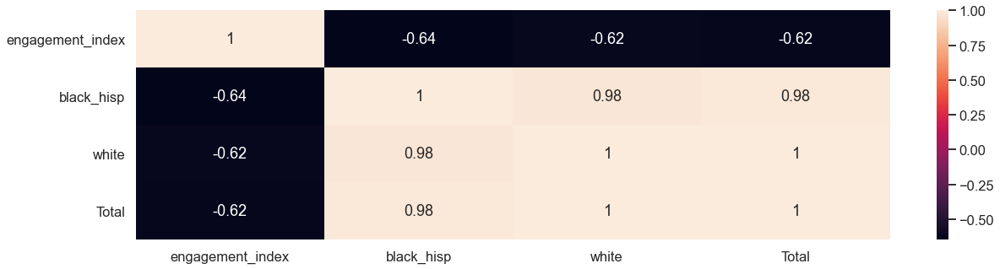

Statistic: Change in Education: Paper Distance Learning


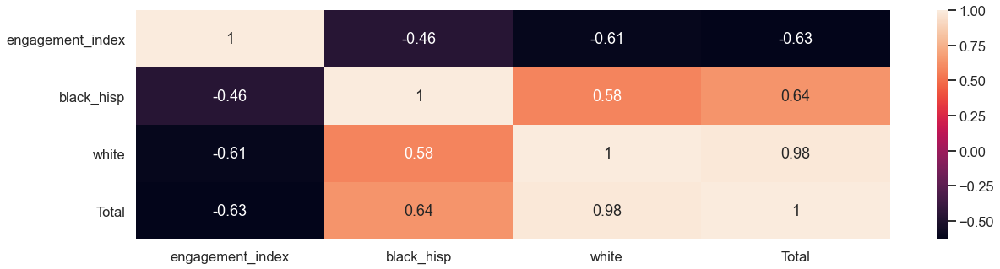

Statistic: Classes Change In Some Other Way


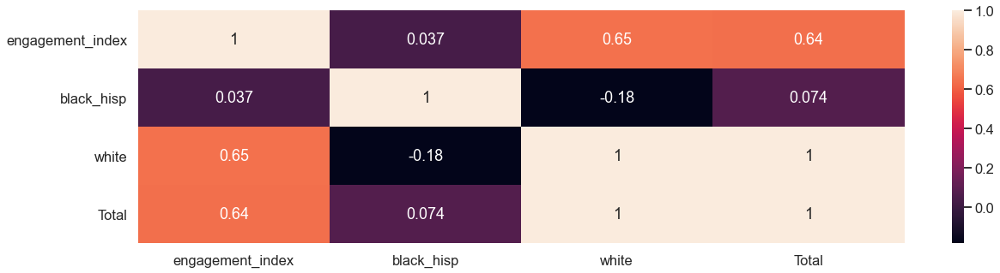

STATE: UT | DISTRICT 3692 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 30692
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


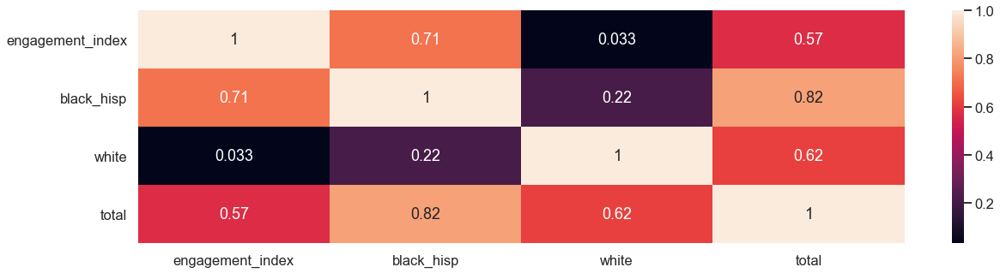

Statistic: Households With Lost Income Due To Pandemic


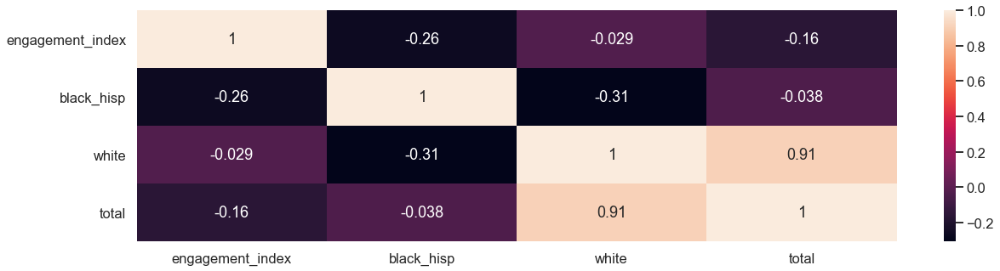

Statistic: Change in Education: Classes Cancelled


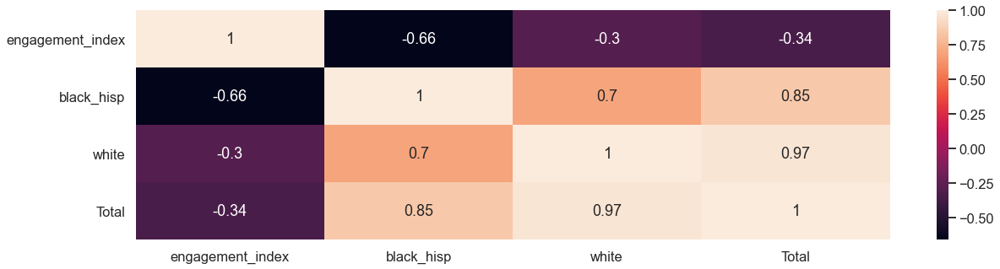

Statistic: Change in Education: Schools Open


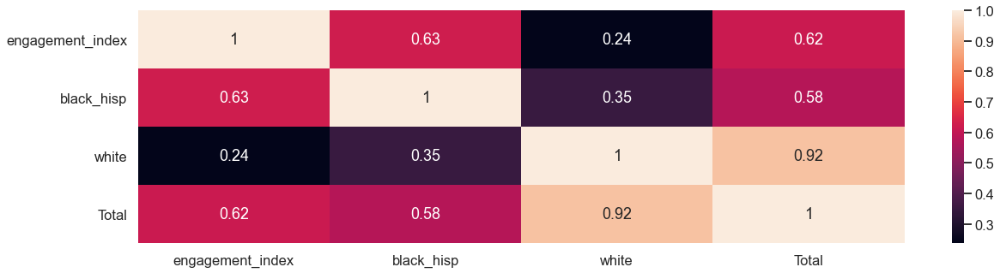

Statistic: Change in Education: Online Distance Learning


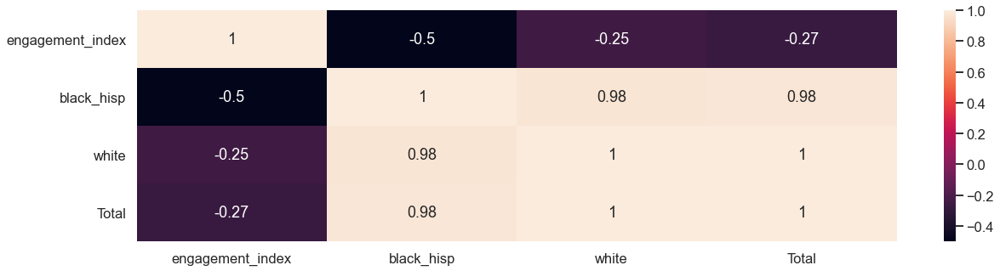

Statistic: Change in Education: Paper Distance Learning


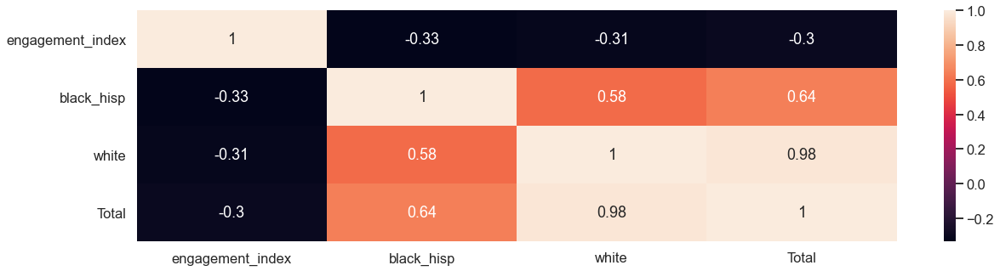

Statistic: Classes Change In Some Other Way


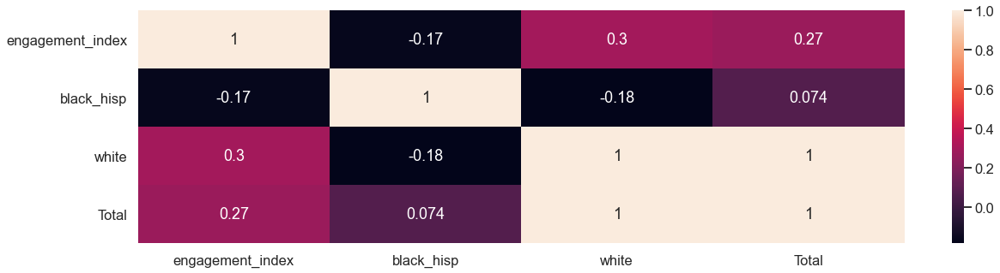

STATE: UT | DISTRICT 7541 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 29469
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


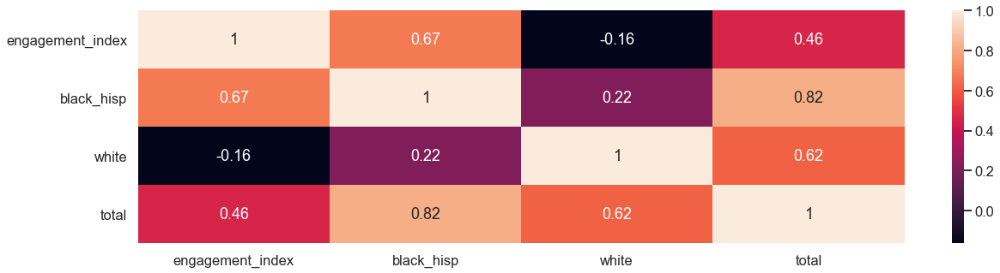

Statistic: Households With Lost Income Due To Pandemic


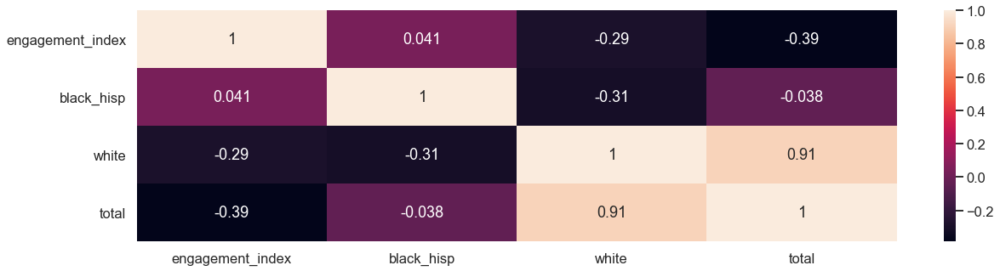

Statistic: Change in Education: Classes Cancelled


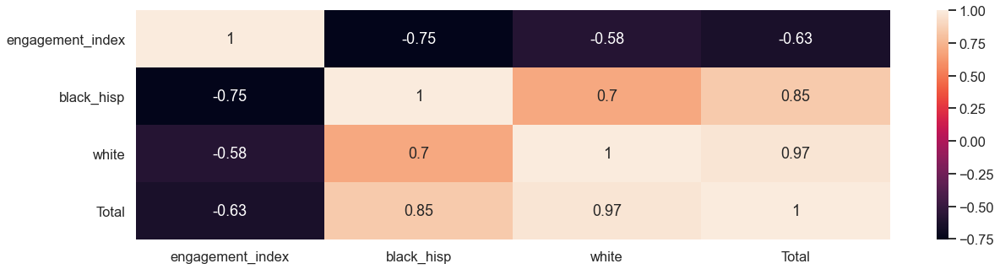

Statistic: Change in Education: Schools Open


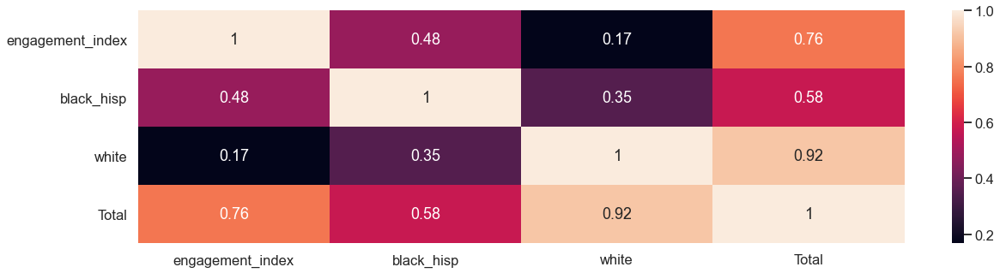

Statistic: Change in Education: Online Distance Learning


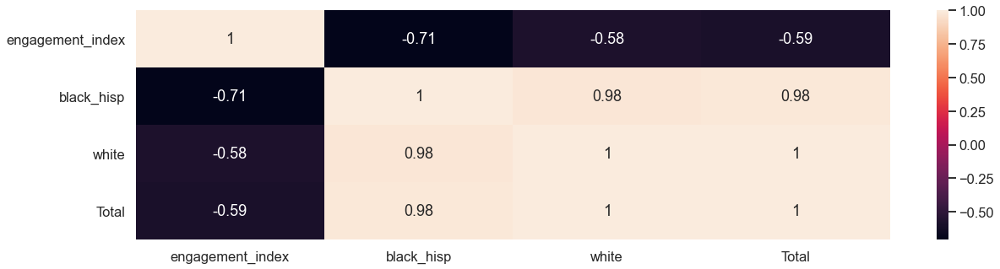

Statistic: Change in Education: Paper Distance Learning


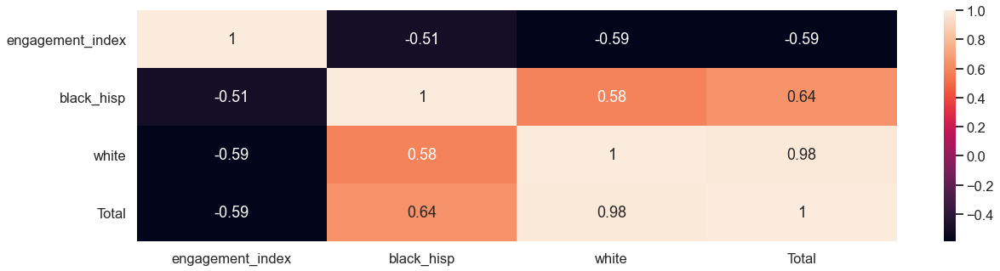

Statistic: Classes Change In Some Other Way


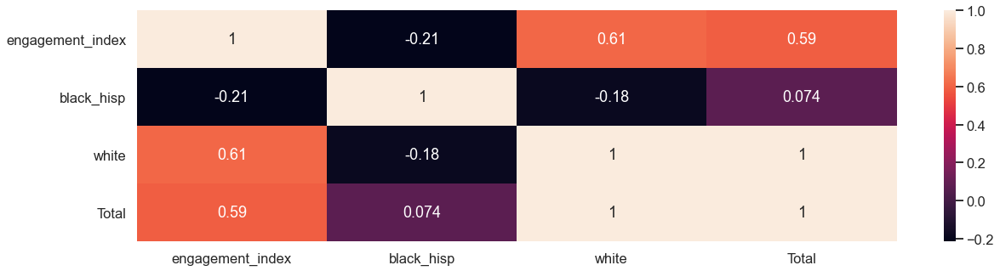

STATE: UT | DISTRICT 6762 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 27481
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $4000 - 6000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


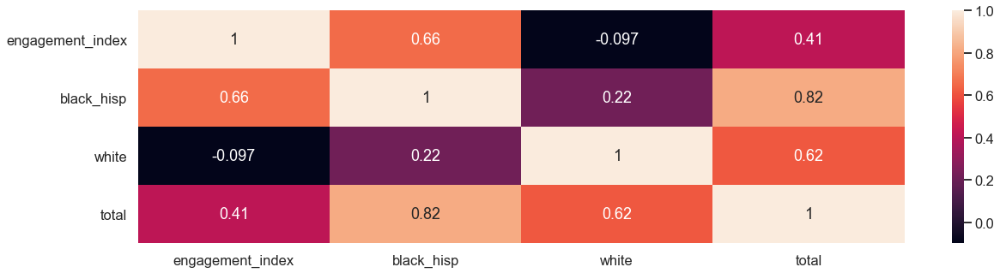

Statistic: Households With Lost Income Due To Pandemic


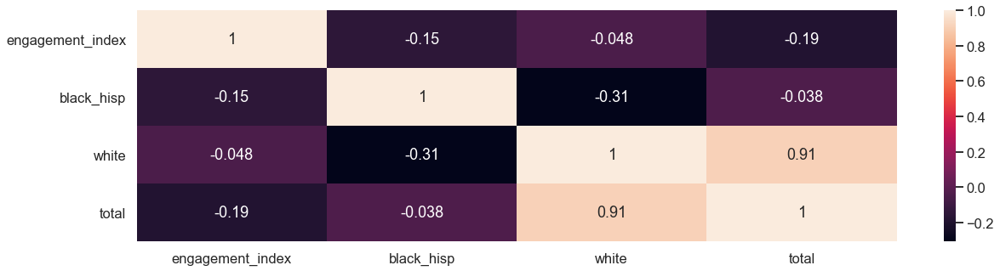

Statistic: Change in Education: Classes Cancelled


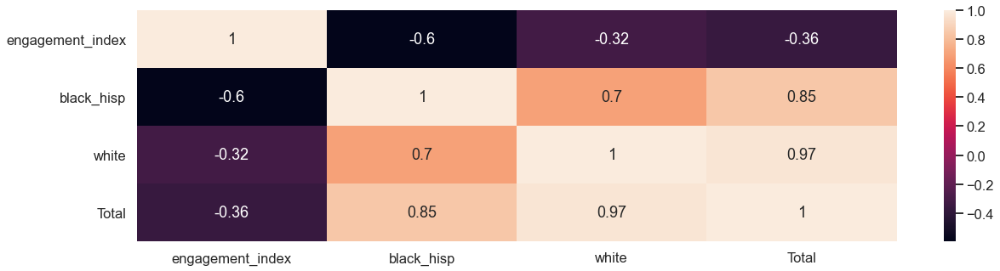

Statistic: Change in Education: Schools Open


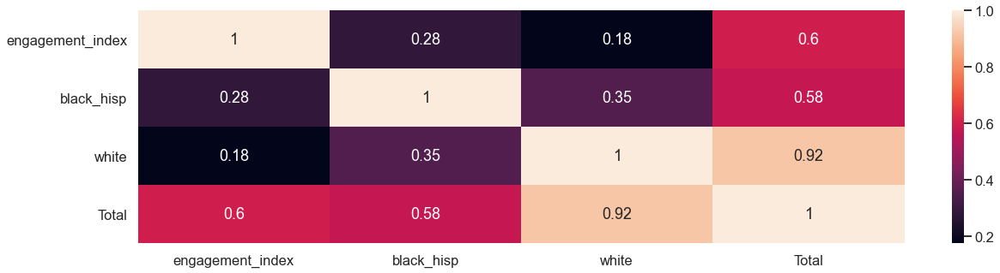

Statistic: Change in Education: Online Distance Learning


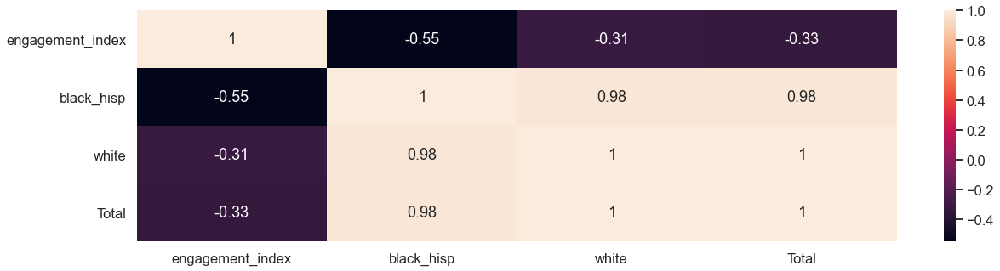

Statistic: Change in Education: Paper Distance Learning


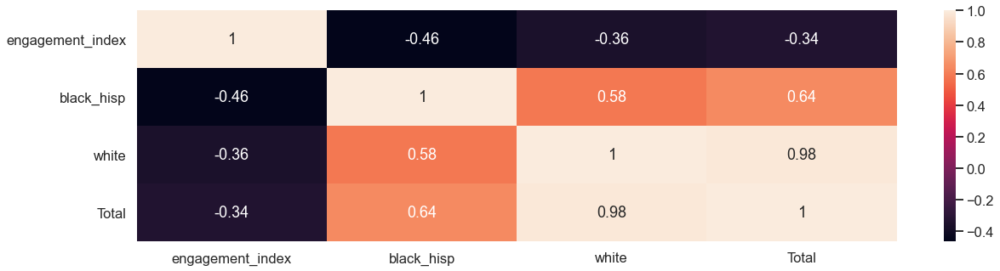

Statistic: Classes Change In Some Other Way


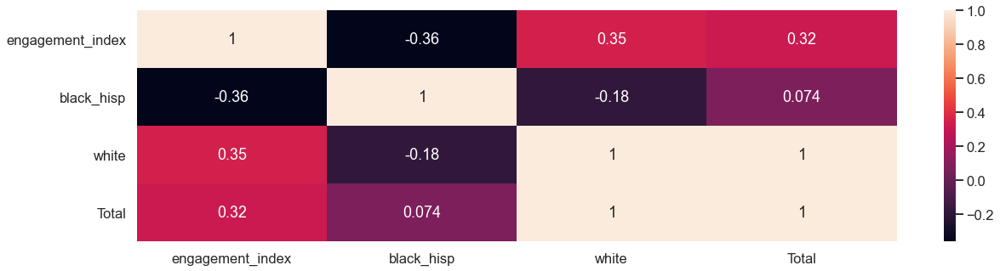

STATE: UT | DISTRICT 8328 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 27034
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          
Statistic: Household Access to Device & High Speed Connection


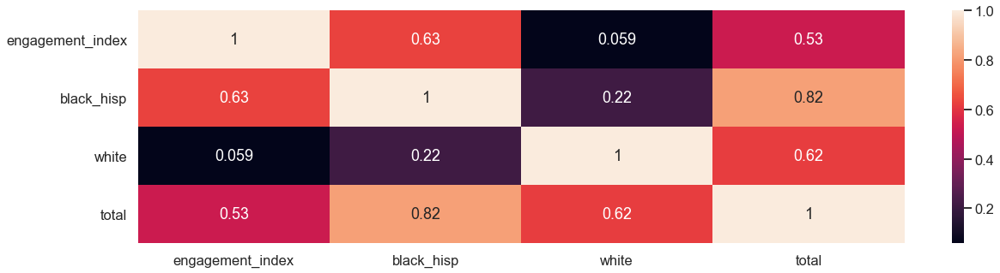

Statistic: Households With Lost Income Due To Pandemic


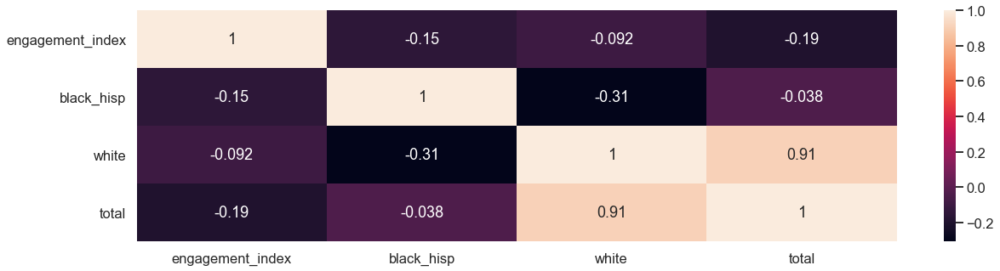

Statistic: Change in Education: Classes Cancelled


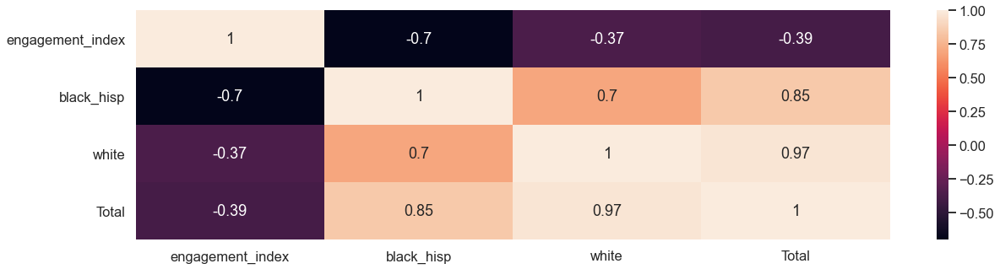

Statistic: Change in Education: Schools Open


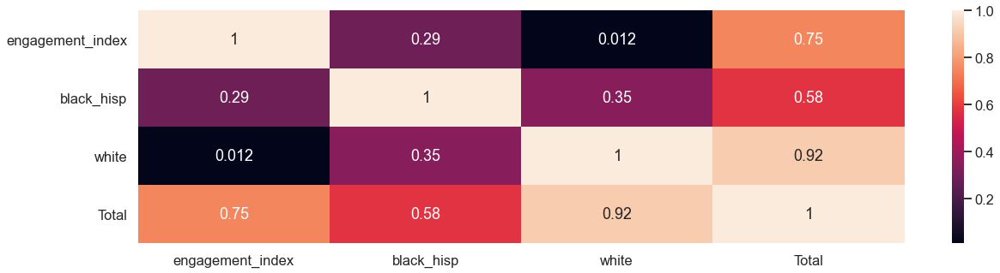

Statistic: Change in Education: Online Distance Learning


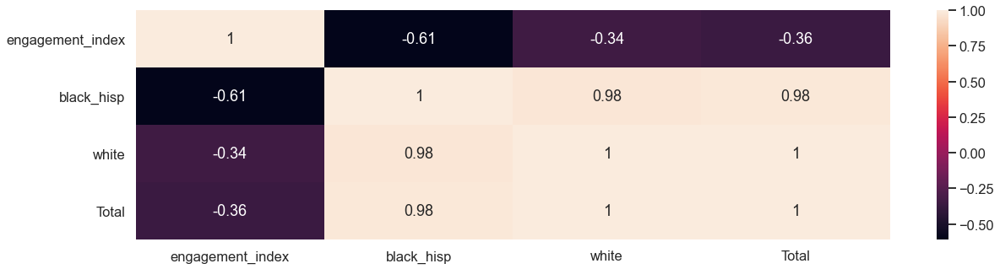

Statistic: Change in Education: Paper Distance Learning


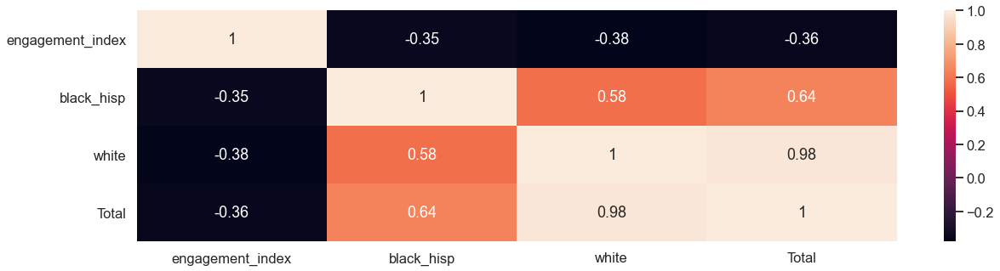

Statistic: Classes Change In Some Other Way


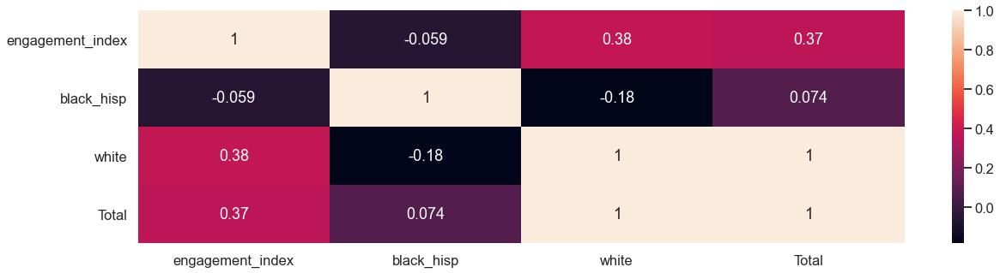

STATE: UT | DISTRICT 7614 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 26693
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: City
          
Statistic: Household Access to Device & High Speed Connection


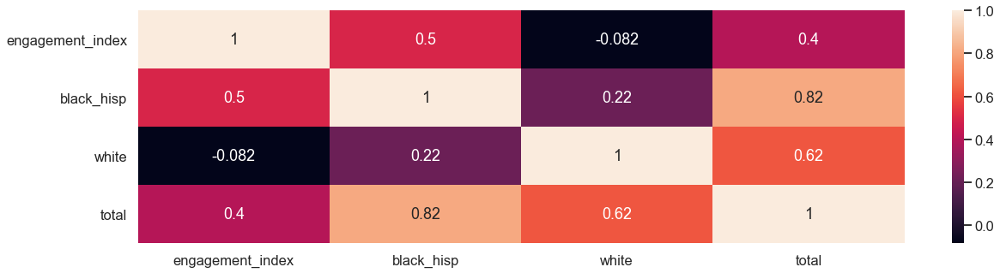

Statistic: Households With Lost Income Due To Pandemic


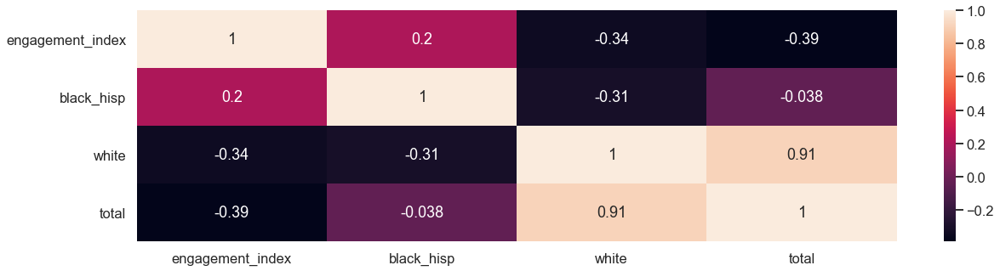

Statistic: Change in Education: Classes Cancelled


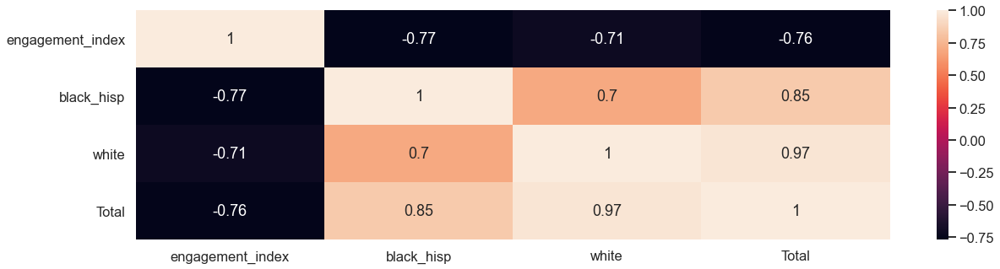

Statistic: Change in Education: Schools Open


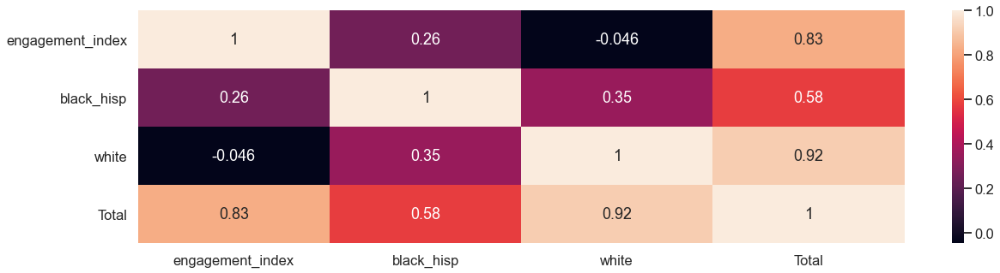

Statistic: Change in Education: Online Distance Learning


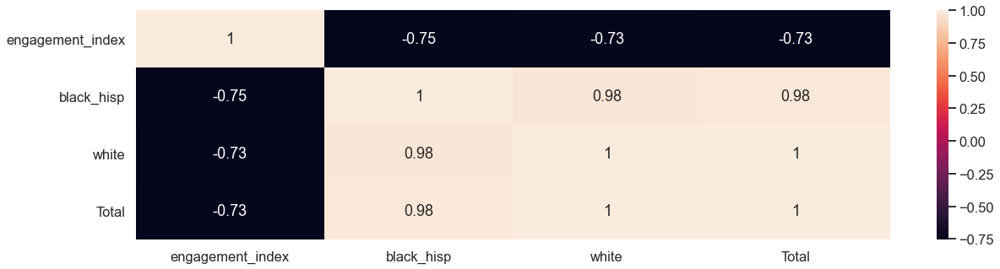

Statistic: Change in Education: Paper Distance Learning


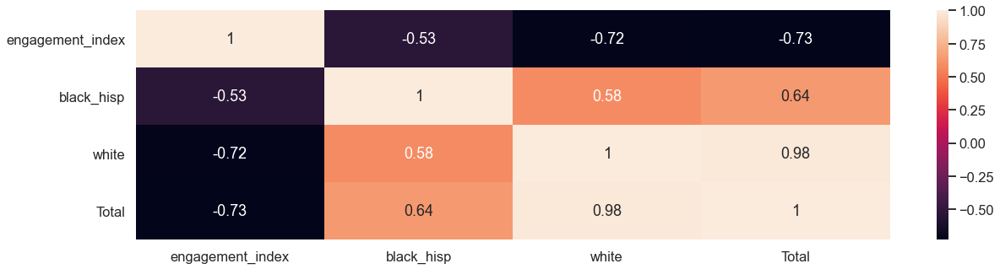

Statistic: Classes Change In Some Other Way


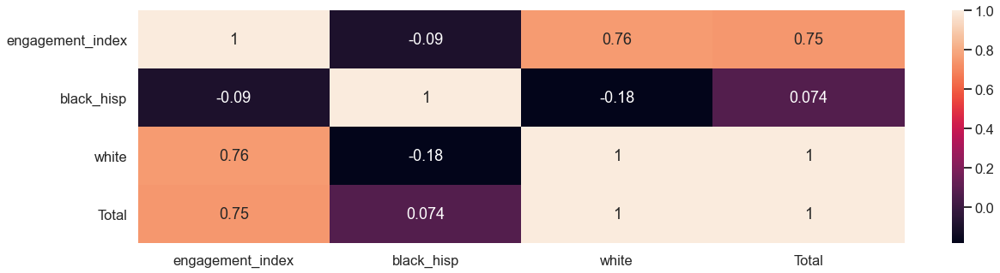

STATE: UT | DISTRICT 3266 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 22699
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $10000 - 12000
District Locale: Town
          
Statistic: Household Access to Device & High Speed Connection


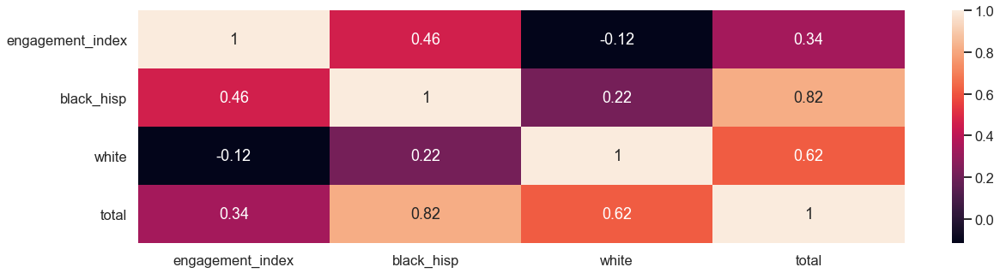

Statistic: Households With Lost Income Due To Pandemic


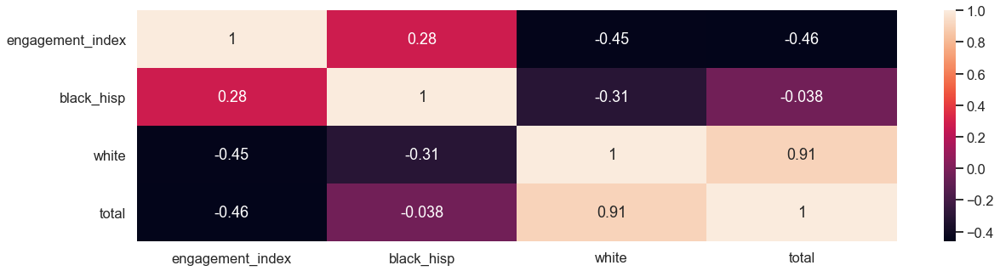

Statistic: Change in Education: Classes Cancelled


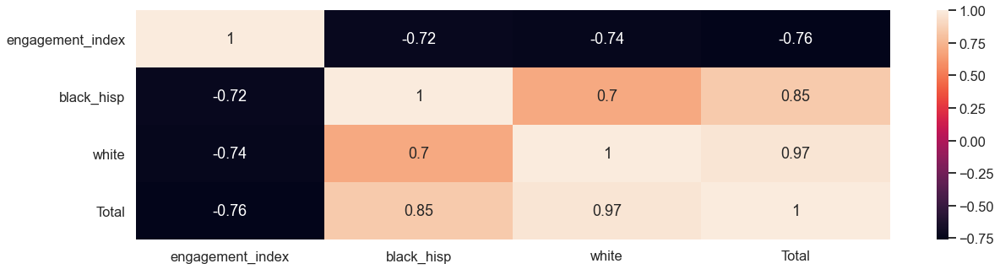

Statistic: Change in Education: Schools Open


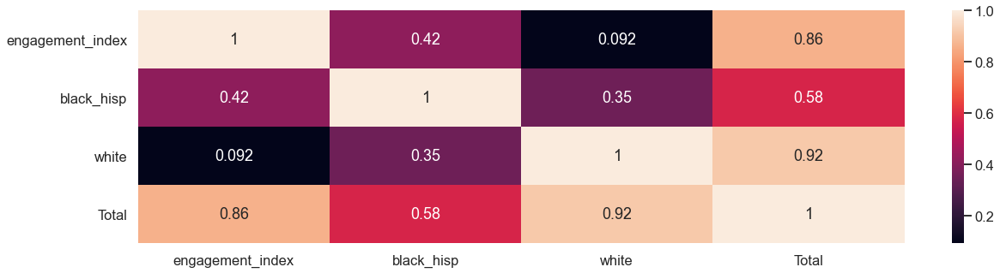

Statistic: Change in Education: Online Distance Learning


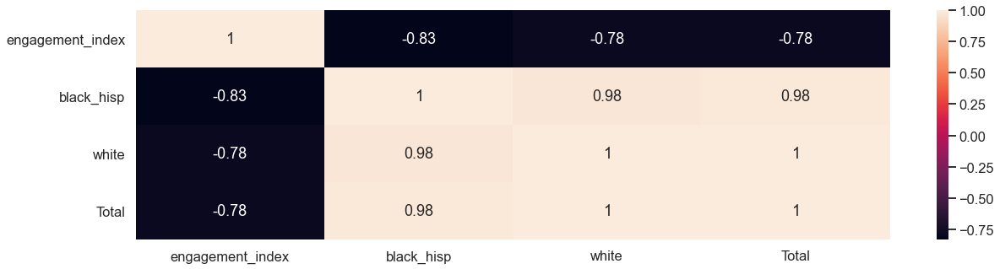

Statistic: Change in Education: Paper Distance Learning


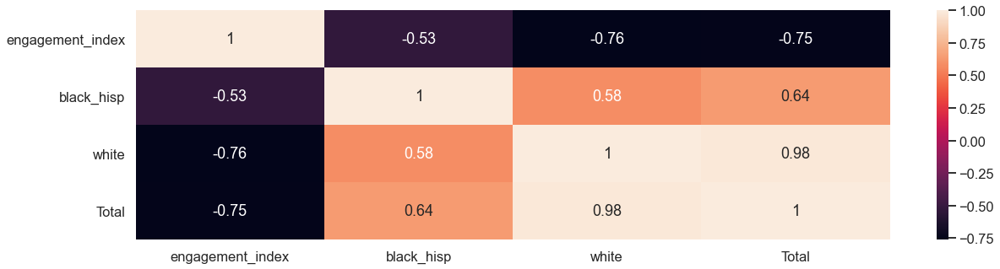

Statistic: Classes Change In Some Other Way


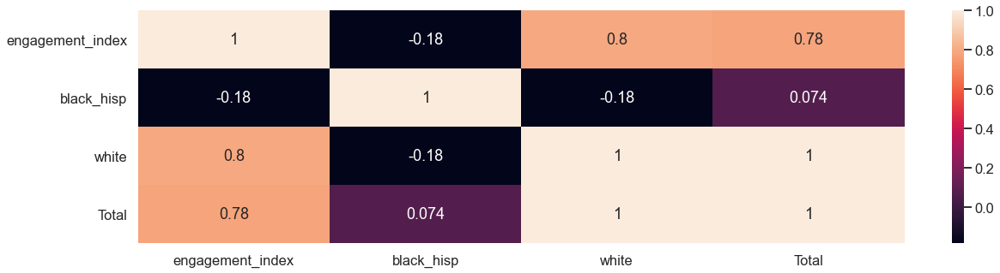

STATE: UT | DISTRICT 4668 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 22385
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


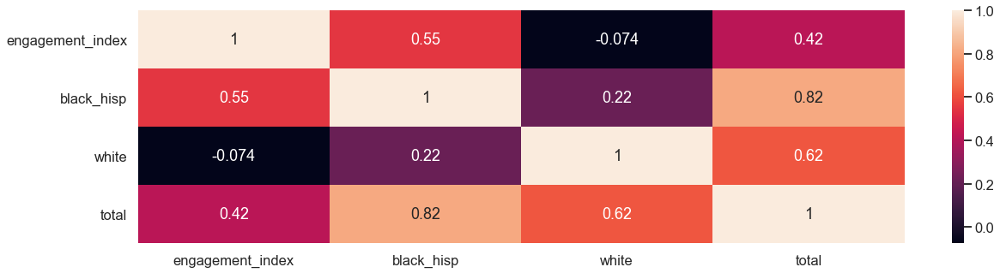

Statistic: Households With Lost Income Due To Pandemic


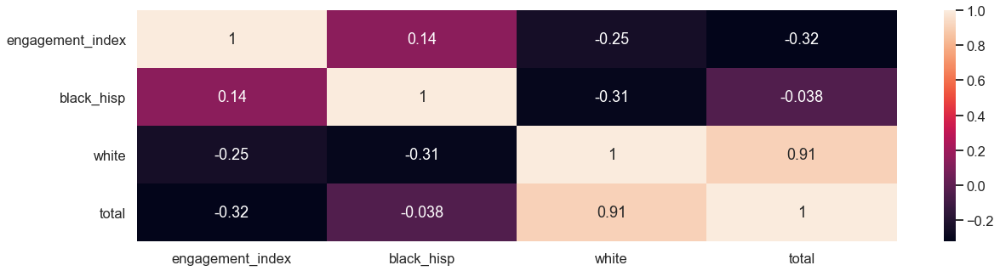

Statistic: Change in Education: Classes Cancelled


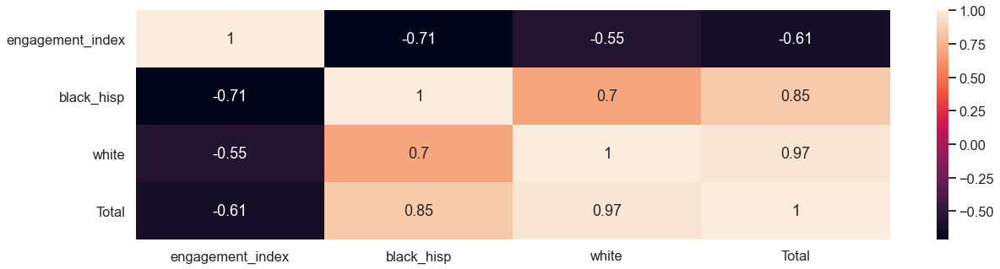

Statistic: Change in Education: Schools Open


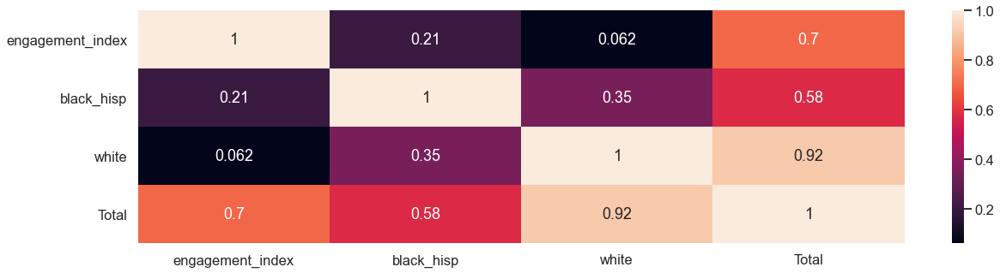

Statistic: Change in Education: Online Distance Learning


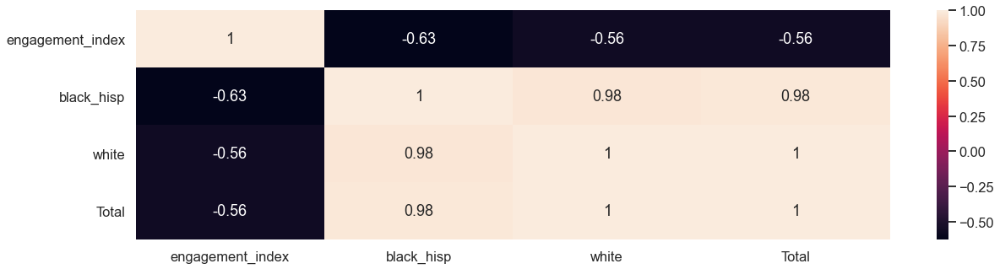

Statistic: Change in Education: Paper Distance Learning


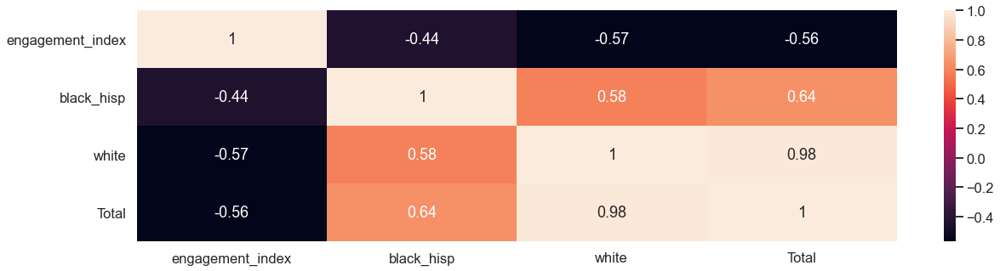

Statistic: Classes Change In Some Other Way


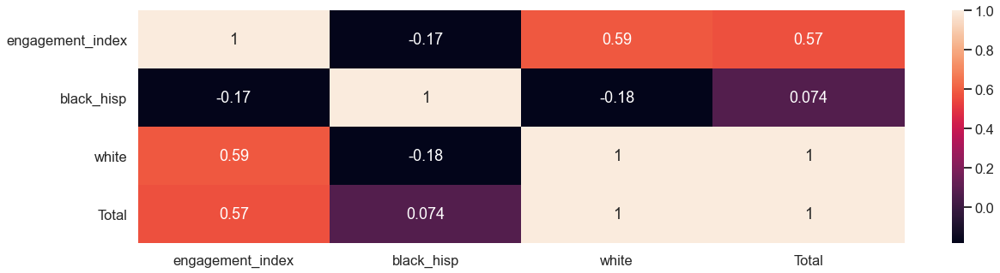

STATE: UT | DISTRICT 4921 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 21136
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


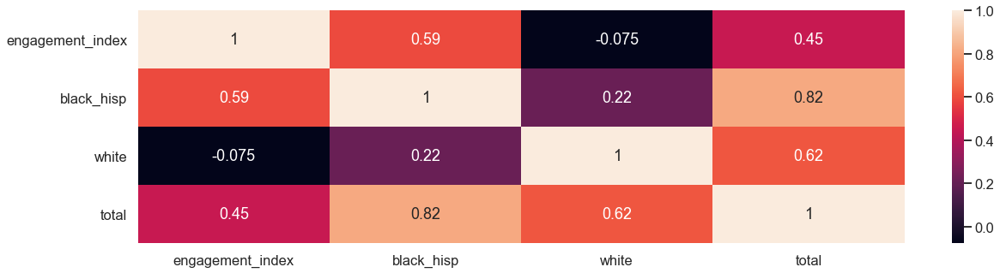

Statistic: Households With Lost Income Due To Pandemic


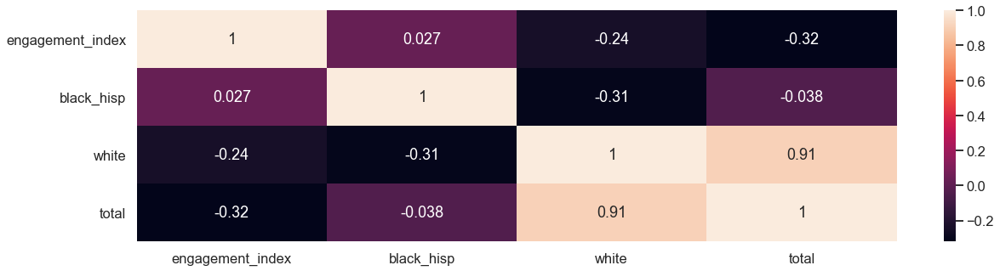

Statistic: Change in Education: Classes Cancelled


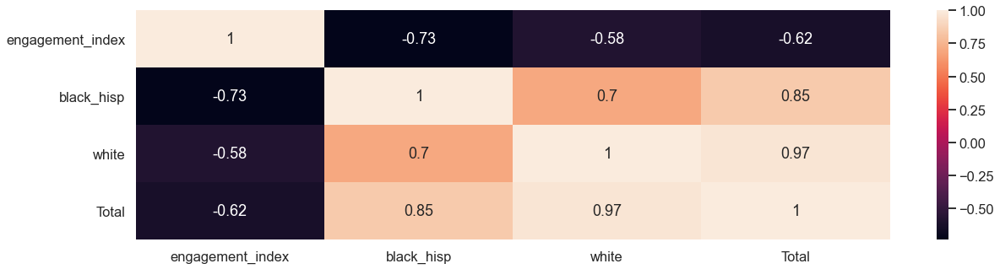

Statistic: Change in Education: Schools Open


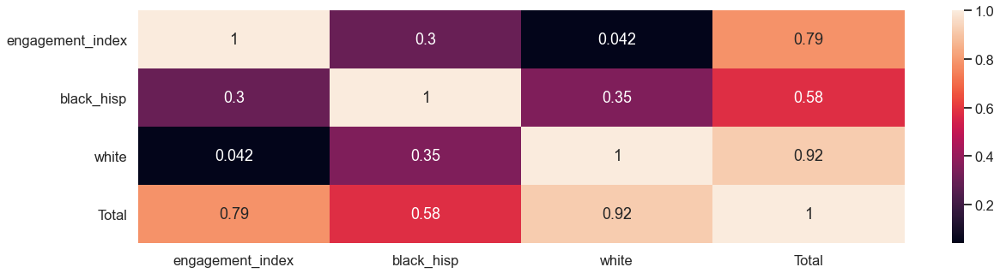

Statistic: Change in Education: Online Distance Learning


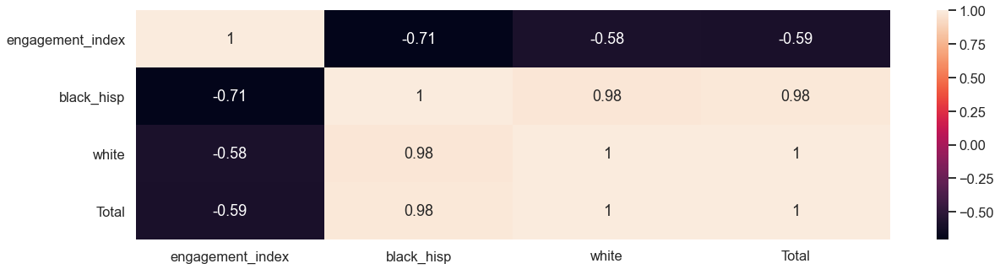

Statistic: Change in Education: Paper Distance Learning


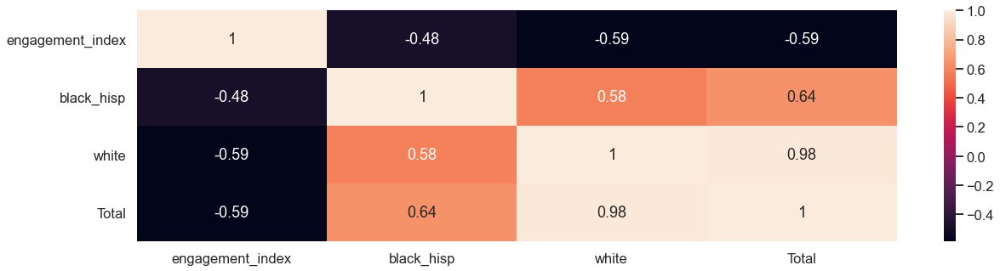

Statistic: Classes Change In Some Other Way


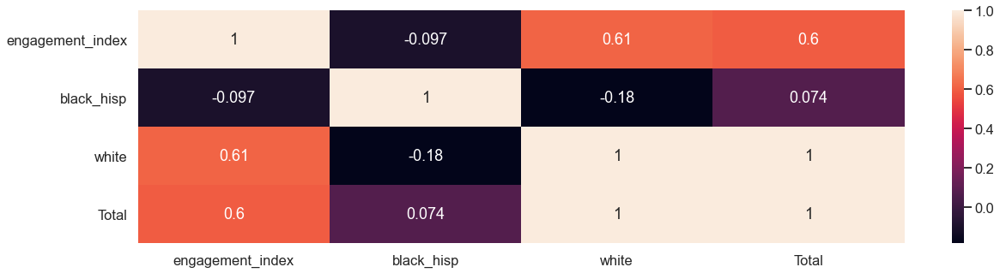

STATE: UT | DISTRICT 1772 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 20629
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: City
          
Statistic: Household Access to Device & High Speed Connection


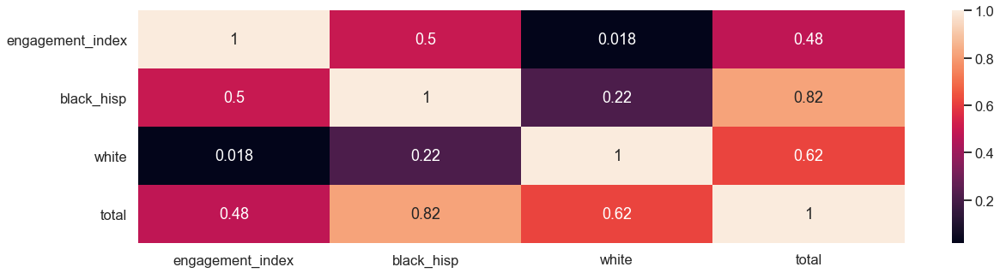

Statistic: Households With Lost Income Due To Pandemic


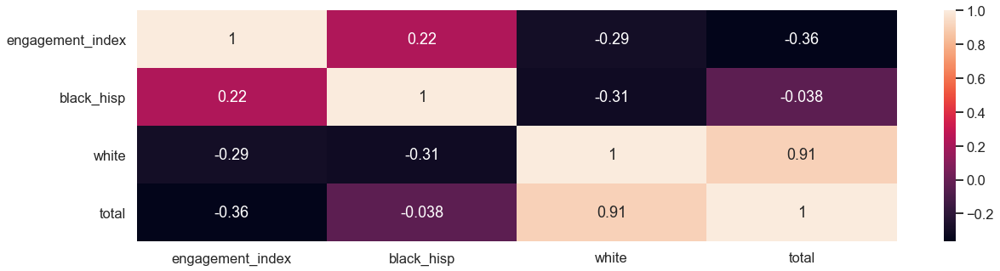

Statistic: Change in Education: Classes Cancelled


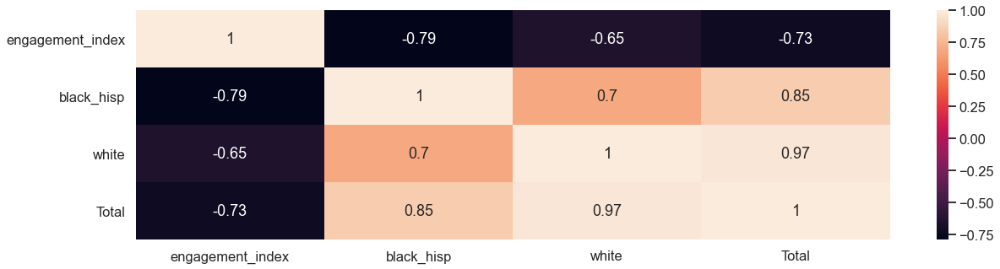

Statistic: Change in Education: Schools Open


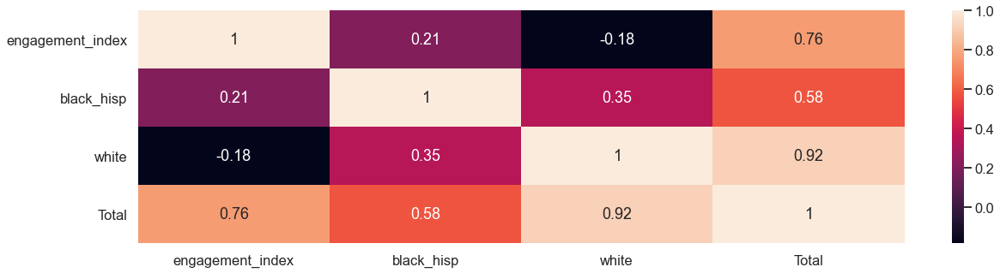

Statistic: Change in Education: Online Distance Learning


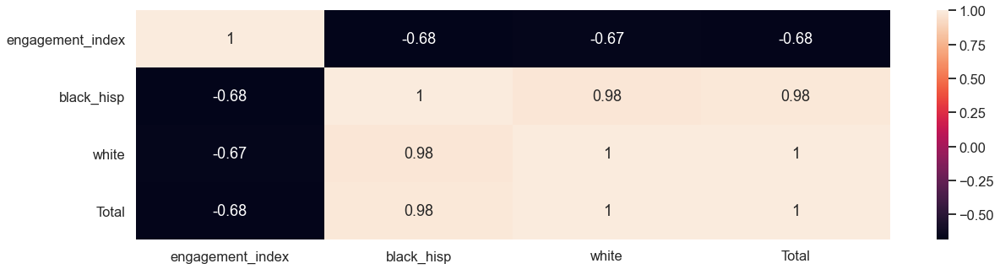

Statistic: Change in Education: Paper Distance Learning


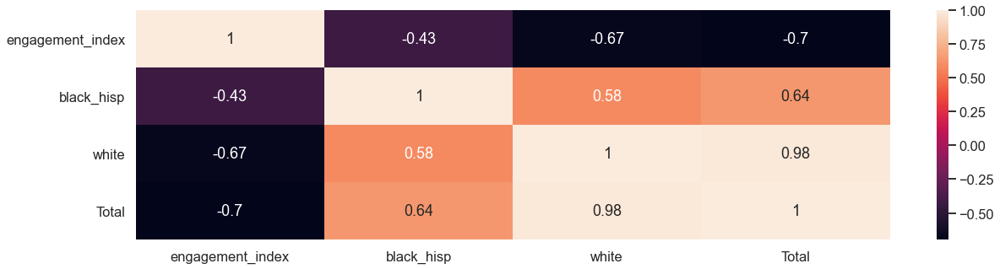

Statistic: Classes Change In Some Other Way


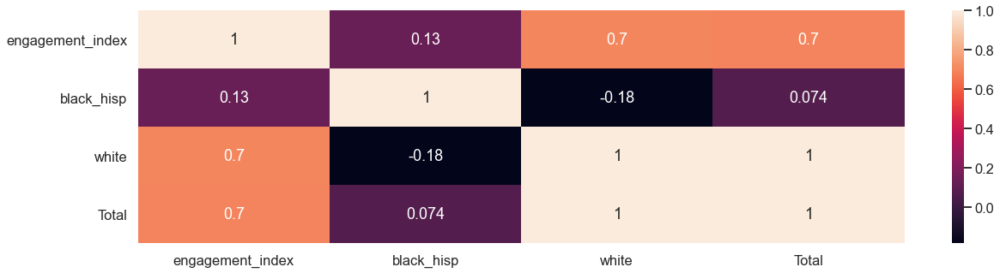

STATE: UT | DISTRICT 1270 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 20328
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


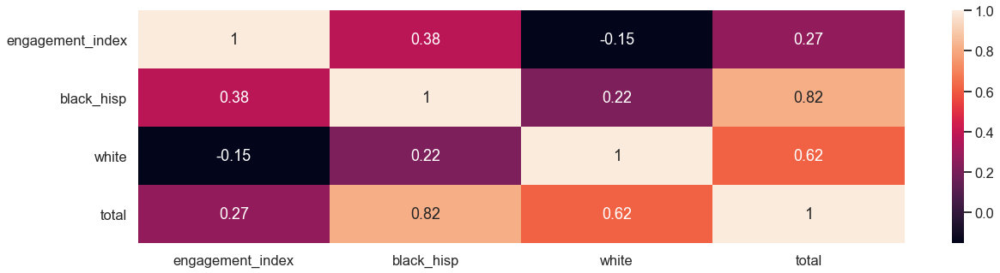

Statistic: Households With Lost Income Due To Pandemic


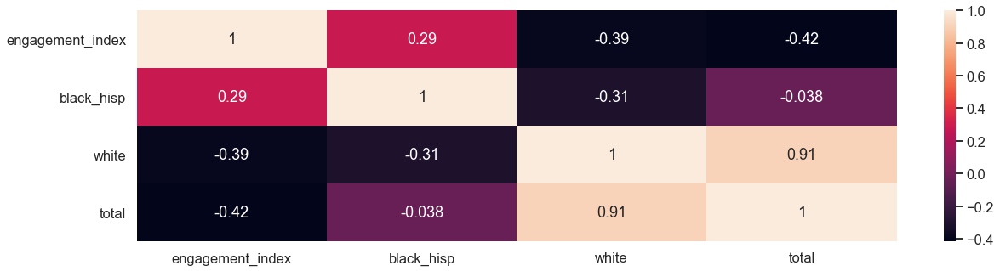

Statistic: Change in Education: Classes Cancelled


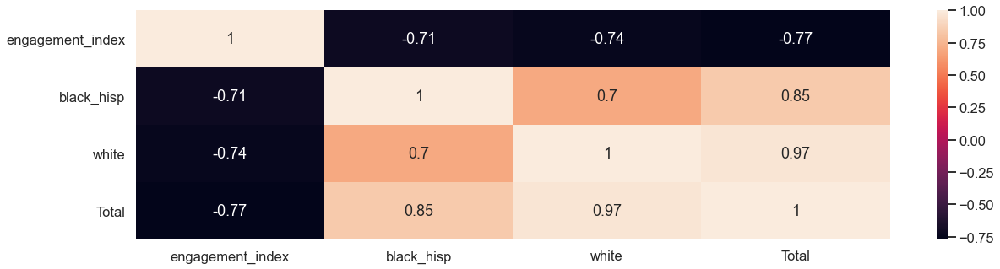

Statistic: Change in Education: Schools Open


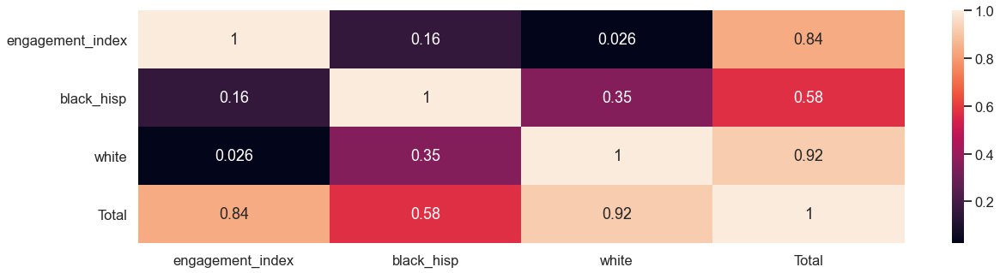

Statistic: Change in Education: Online Distance Learning


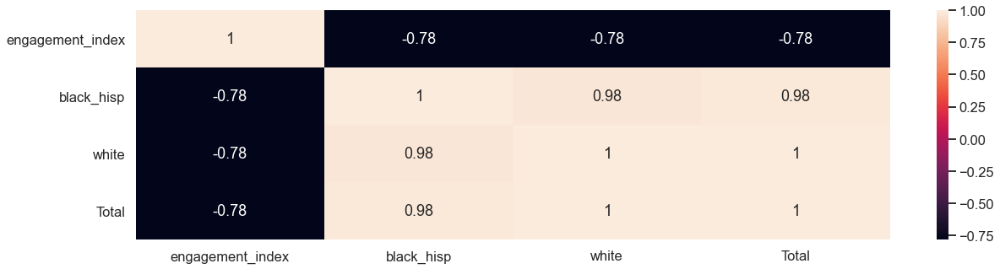

Statistic: Change in Education: Paper Distance Learning


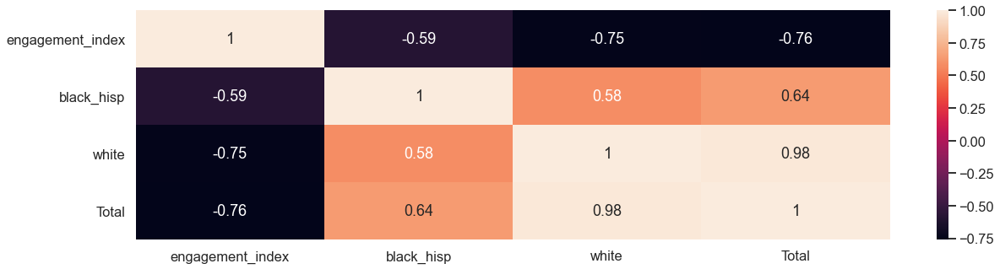

Statistic: Classes Change In Some Other Way


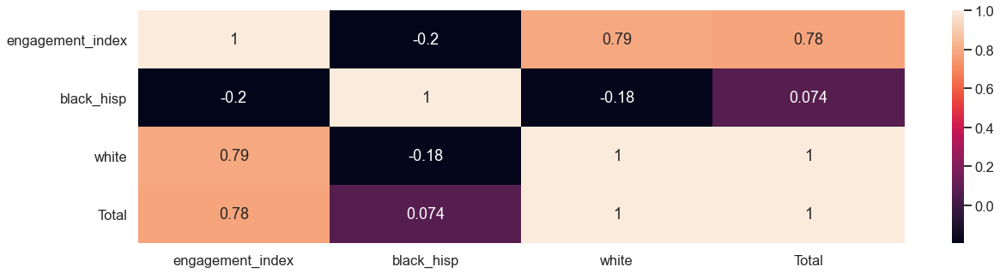

STATE: UT | DISTRICT 5600 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 18742
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


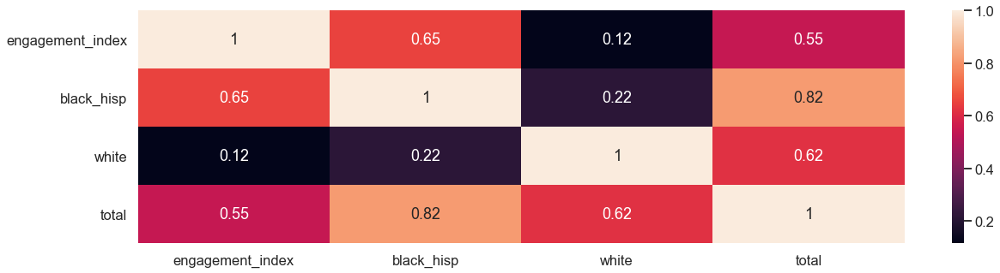

Statistic: Households With Lost Income Due To Pandemic


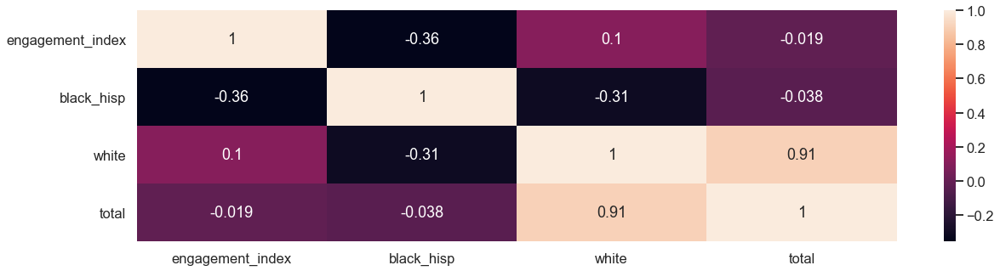

Statistic: Change in Education: Classes Cancelled


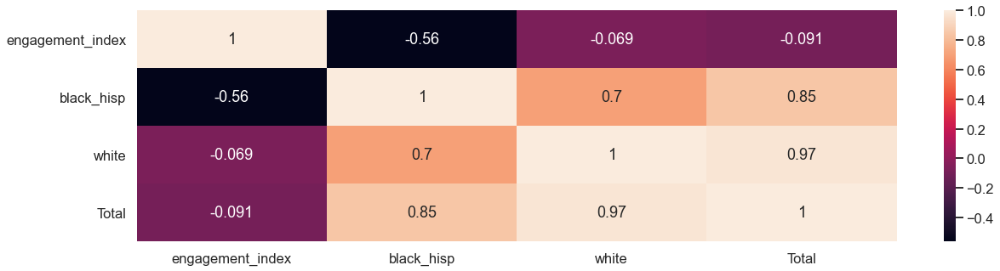

Statistic: Change in Education: Schools Open


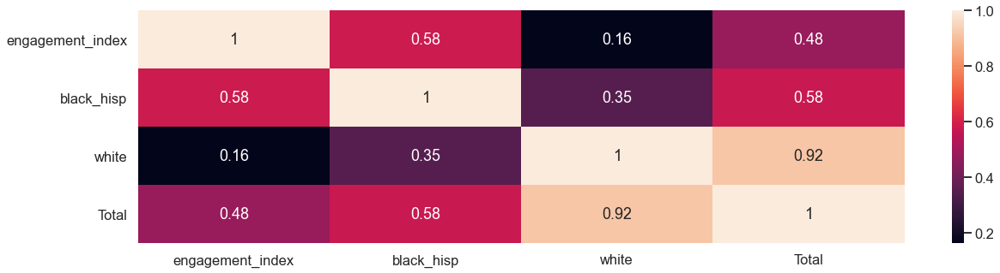

Statistic: Change in Education: Online Distance Learning


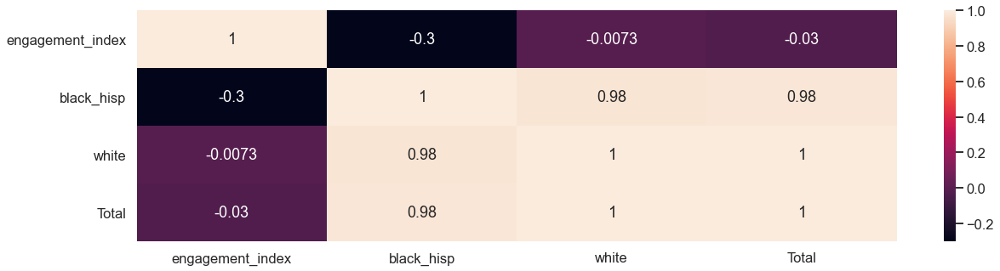

Statistic: Change in Education: Paper Distance Learning


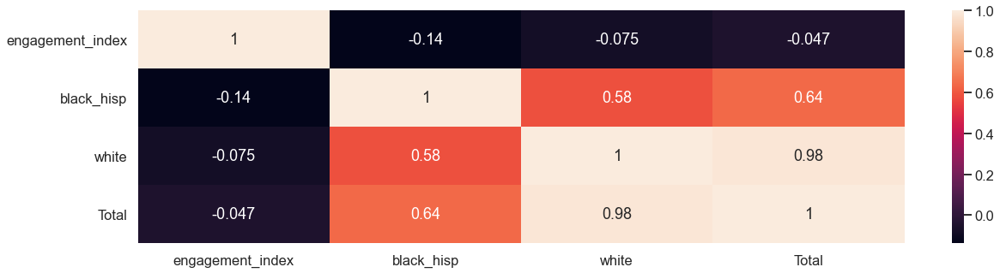

Statistic: Classes Change In Some Other Way


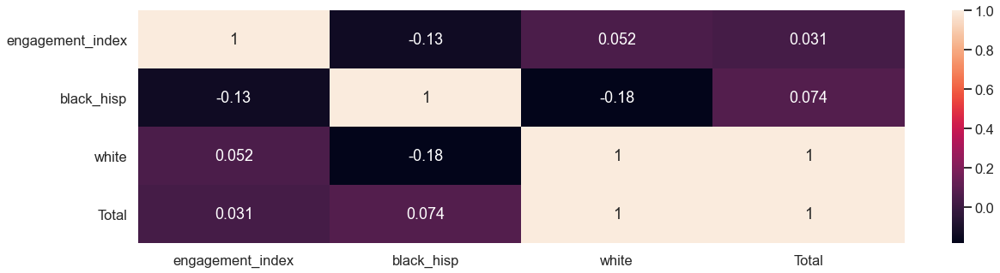

STATE: UT | DISTRICT 3160 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 18491
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


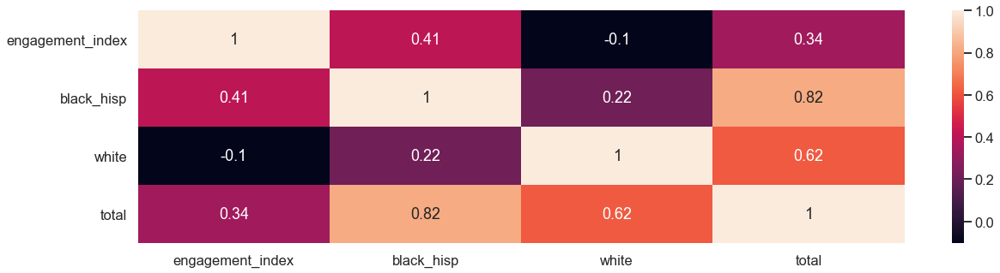

Statistic: Households With Lost Income Due To Pandemic


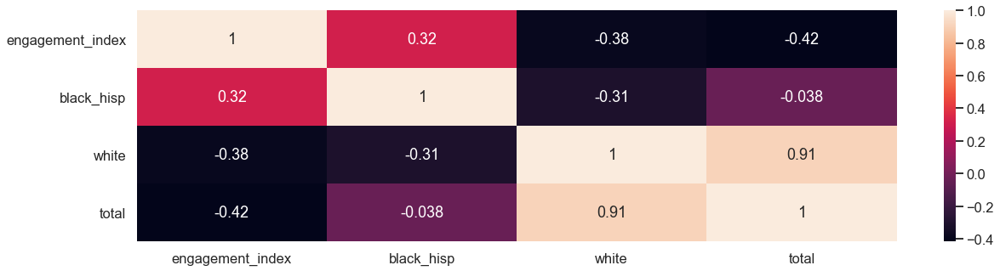

Statistic: Change in Education: Classes Cancelled


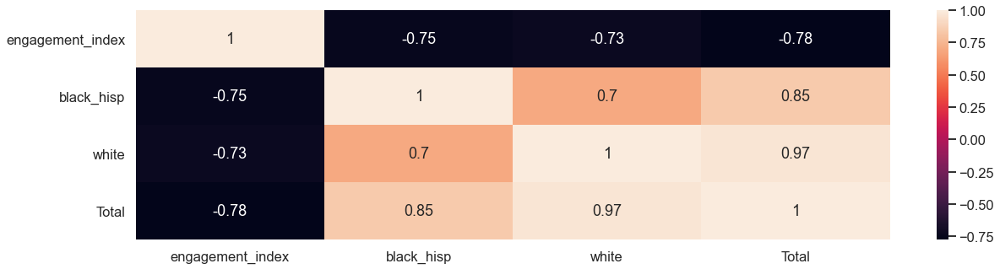

Statistic: Change in Education: Schools Open


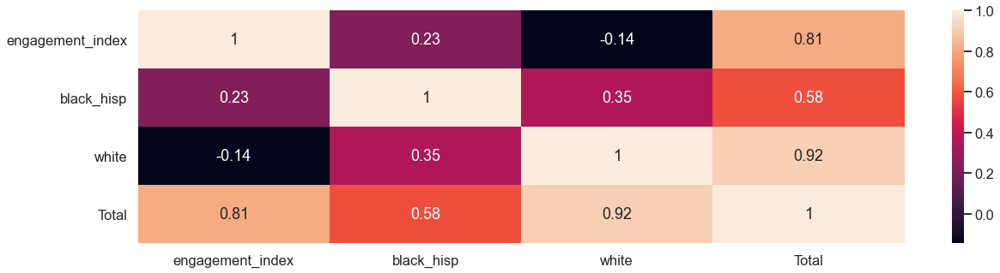

Statistic: Change in Education: Online Distance Learning


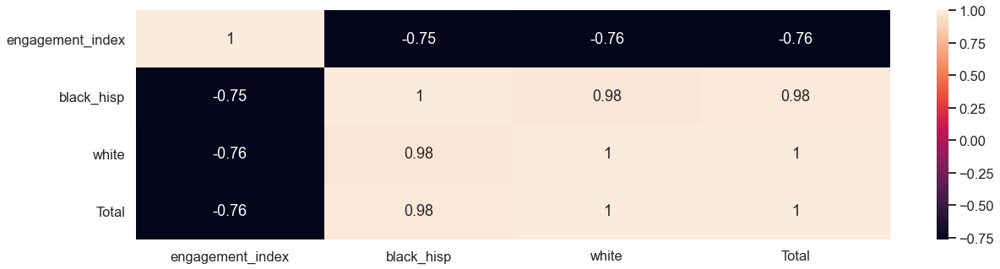

Statistic: Change in Education: Paper Distance Learning


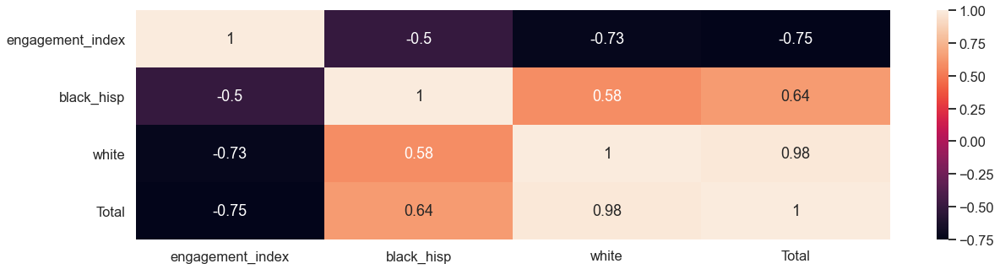

Statistic: Classes Change In Some Other Way


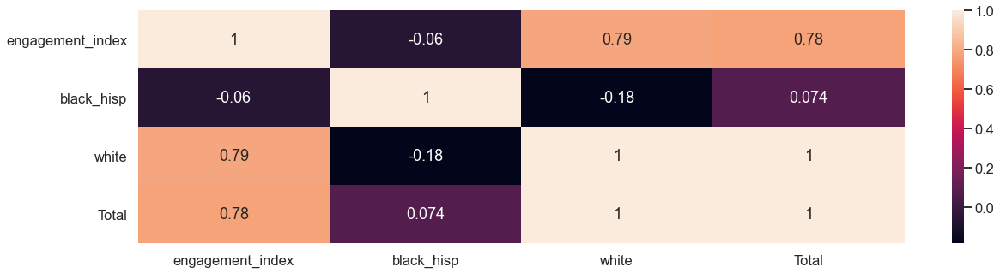

STATE: UT | DISTRICT 2441 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 18223
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Town
          
Statistic: Household Access to Device & High Speed Connection


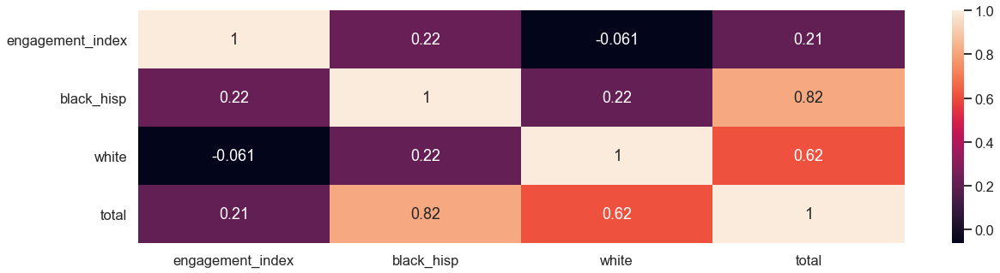

Statistic: Households With Lost Income Due To Pandemic


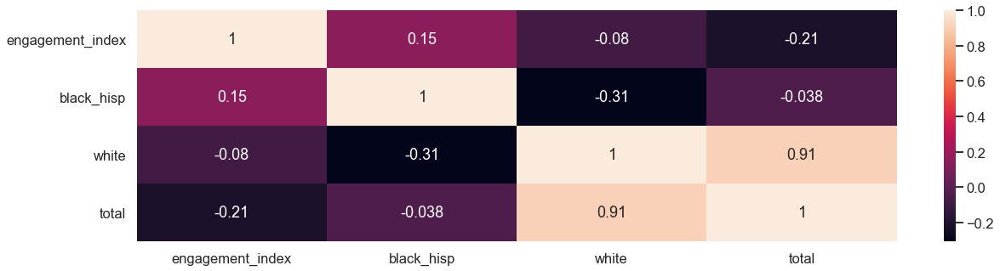

Statistic: Change in Education: Classes Cancelled


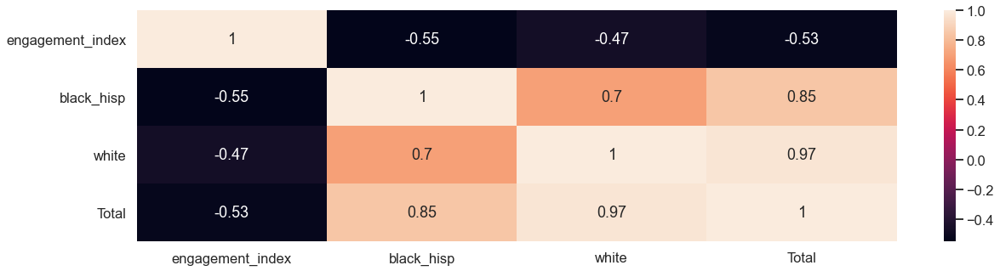

Statistic: Change in Education: Schools Open


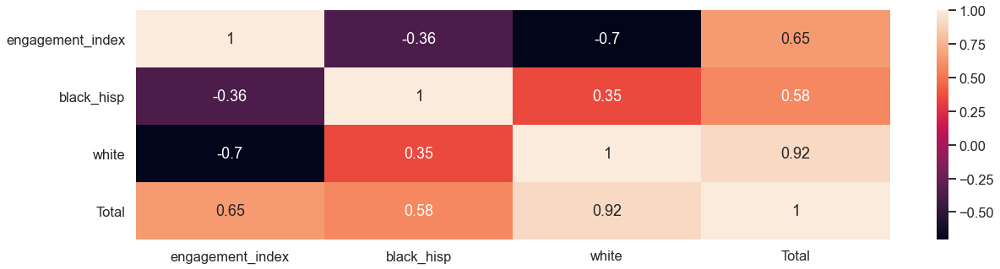

Statistic: Change in Education: Online Distance Learning


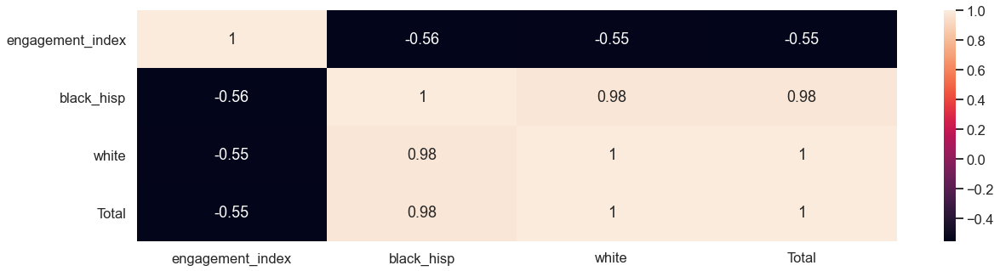

Statistic: Change in Education: Paper Distance Learning


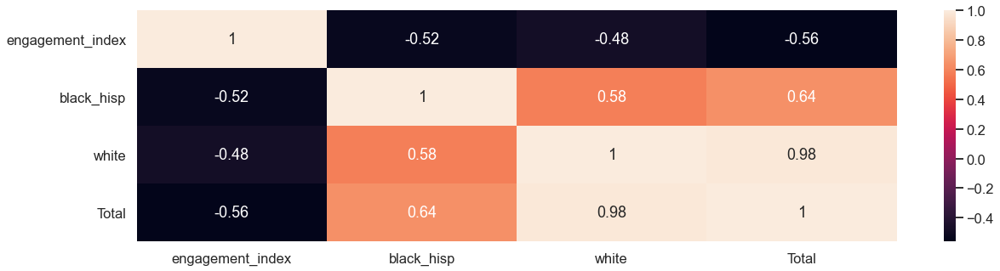

Statistic: Classes Change In Some Other Way


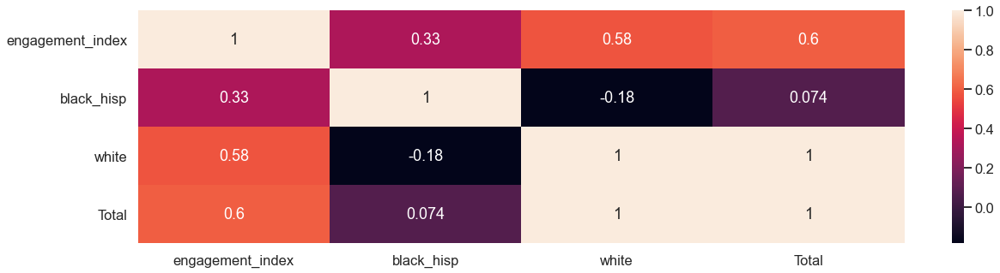

STATE: UT | DISTRICT 7387 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 17825
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: City
          
Statistic: Household Access to Device & High Speed Connection


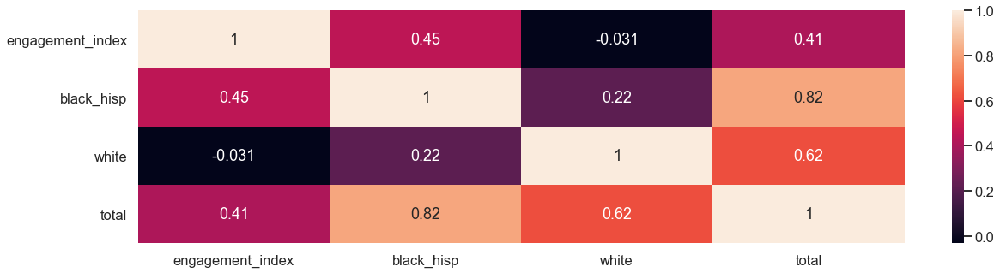

Statistic: Households With Lost Income Due To Pandemic


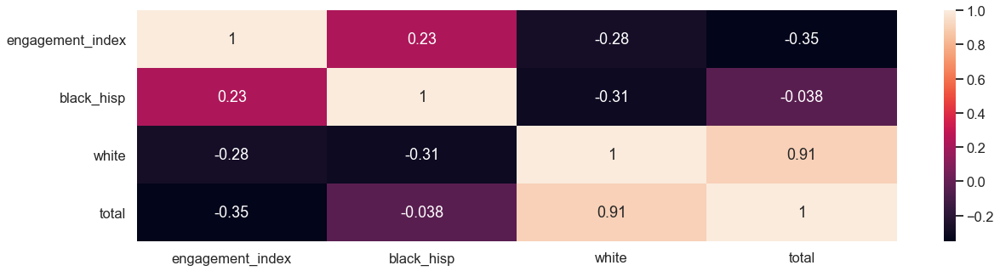

Statistic: Change in Education: Classes Cancelled


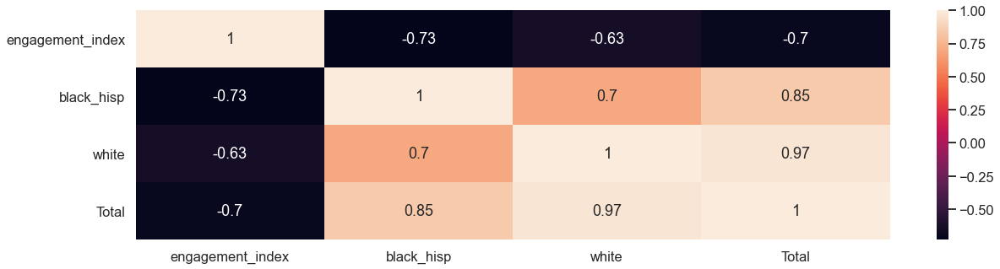

Statistic: Change in Education: Schools Open


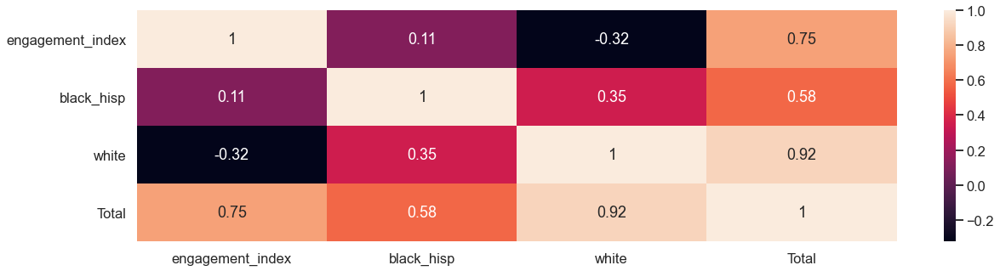

Statistic: Change in Education: Online Distance Learning


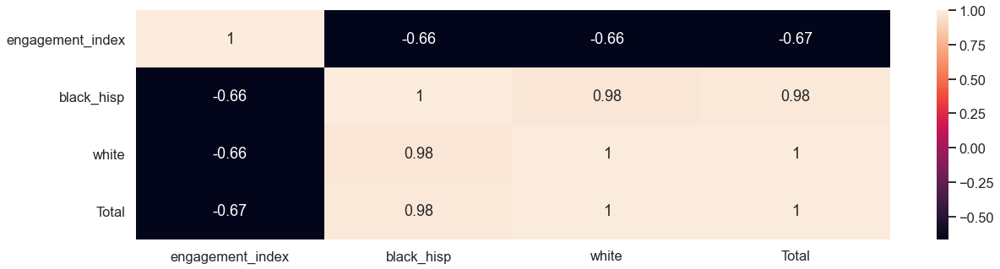

Statistic: Change in Education: Paper Distance Learning


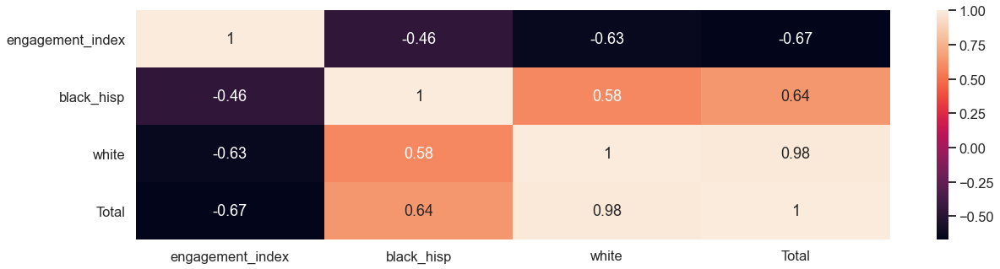

Statistic: Classes Change In Some Other Way


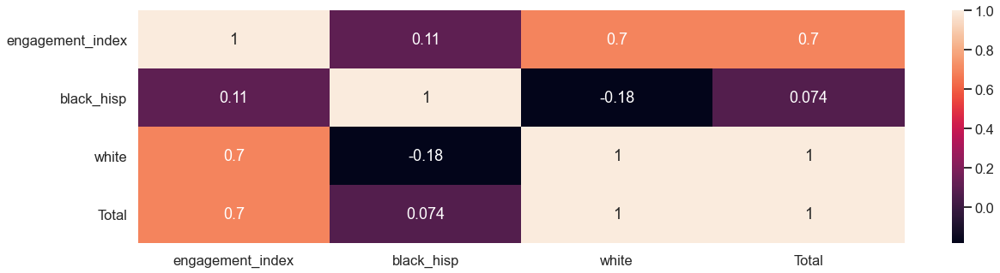

STATE: UT | DISTRICT 7660 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 17606
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


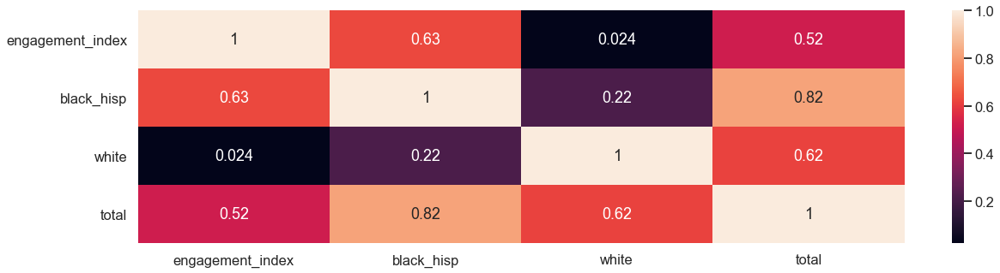

Statistic: Households With Lost Income Due To Pandemic


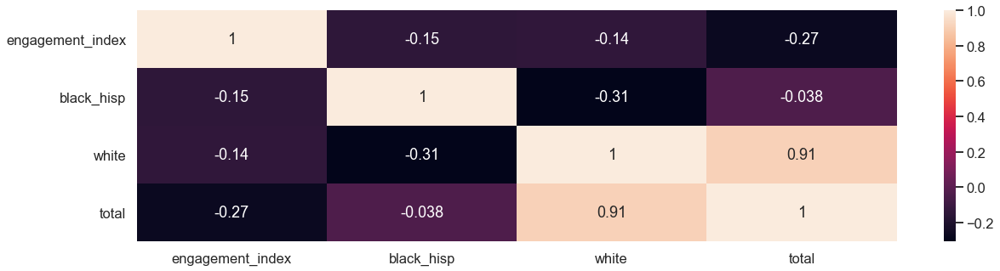

Statistic: Change in Education: Classes Cancelled


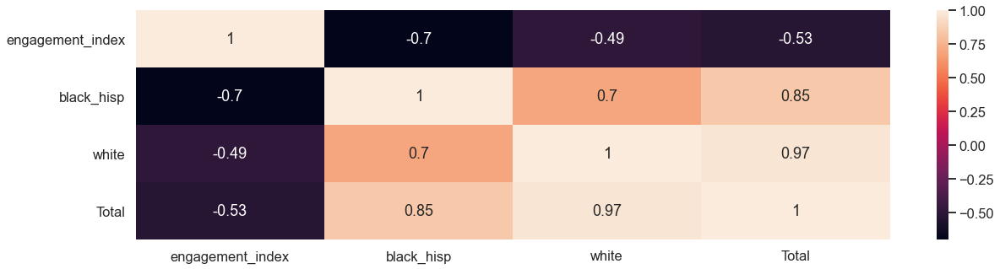

Statistic: Change in Education: Schools Open


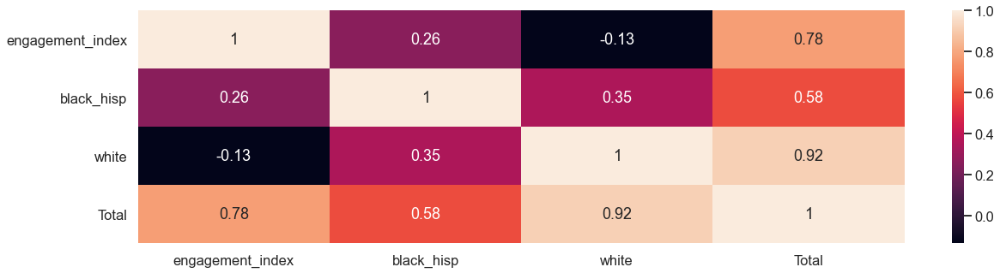

Statistic: Change in Education: Online Distance Learning


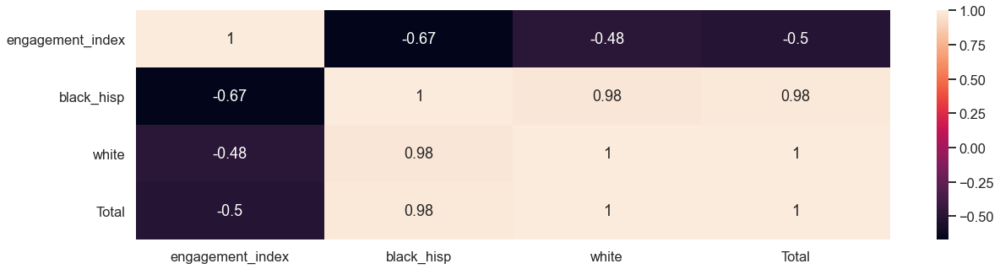

Statistic: Change in Education: Paper Distance Learning


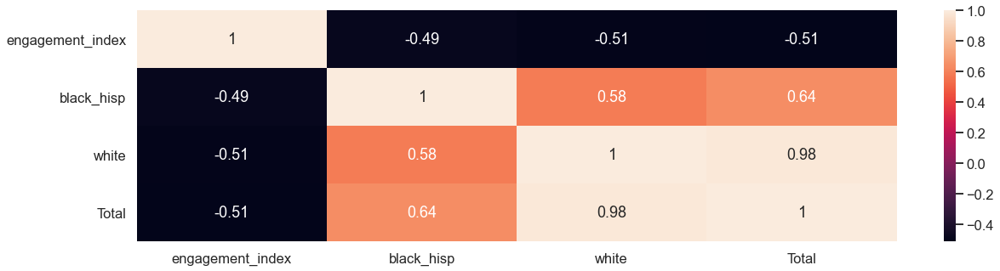

Statistic: Classes Change In Some Other Way


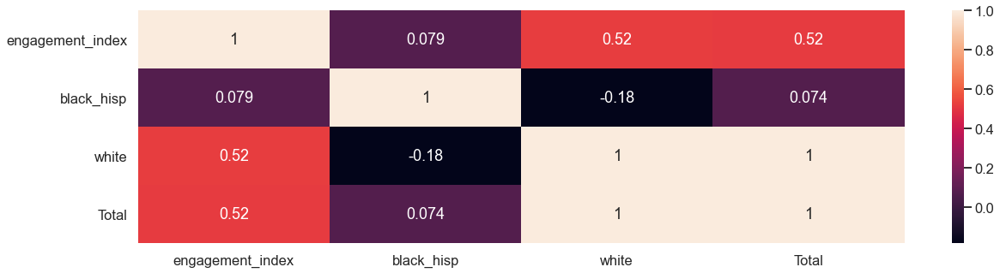

STATE: UT | DISTRICT 9230 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 16410
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Rural
          
Statistic: Household Access to Device & High Speed Connection


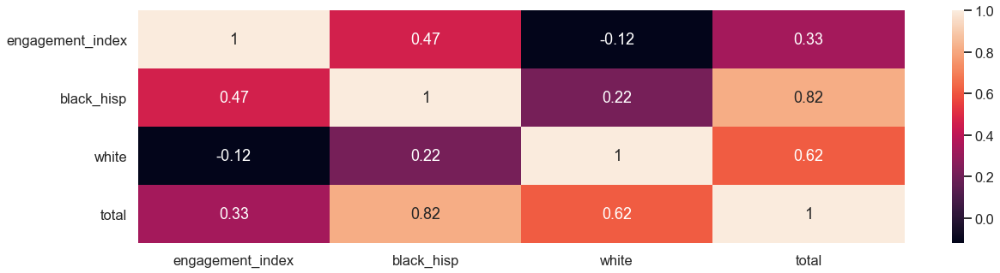

Statistic: Households With Lost Income Due To Pandemic


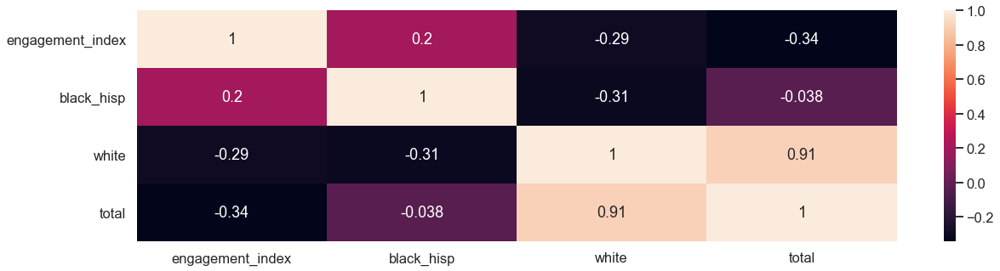

Statistic: Change in Education: Classes Cancelled


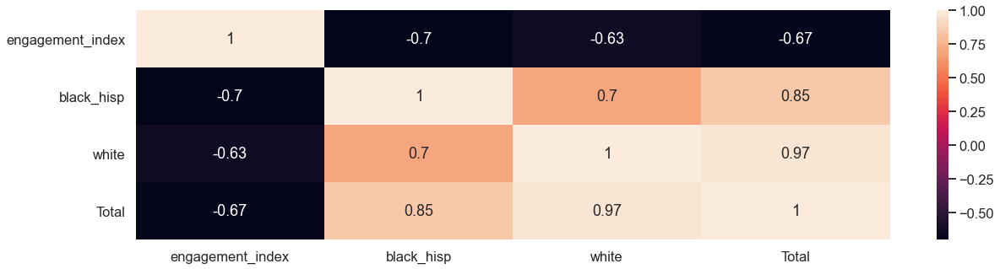

Statistic: Change in Education: Schools Open


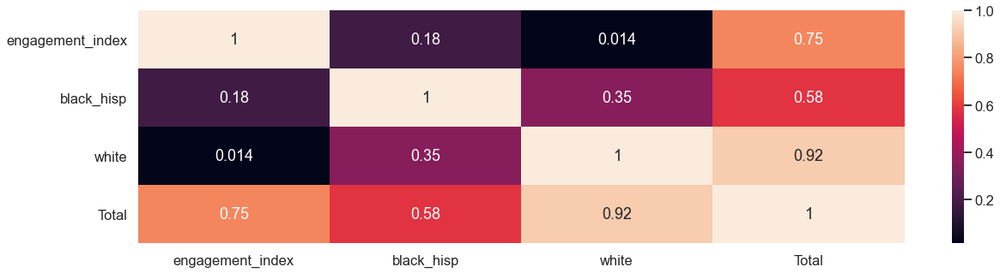

Statistic: Change in Education: Online Distance Learning


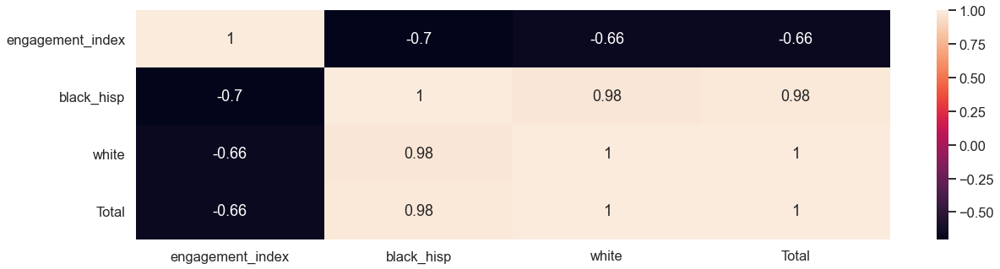

Statistic: Change in Education: Paper Distance Learning


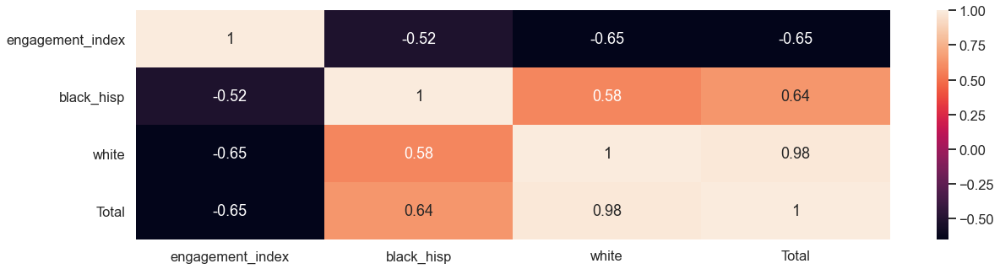

Statistic: Classes Change In Some Other Way


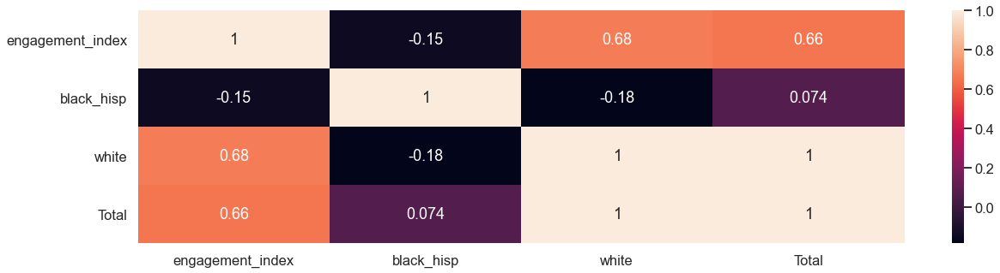

STATE: UT | DISTRICT 9778 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 16300
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Town
          
Statistic: Household Access to Device & High Speed Connection


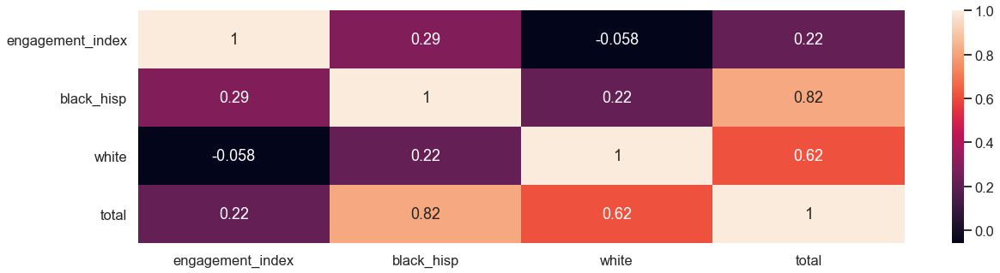

Statistic: Households With Lost Income Due To Pandemic


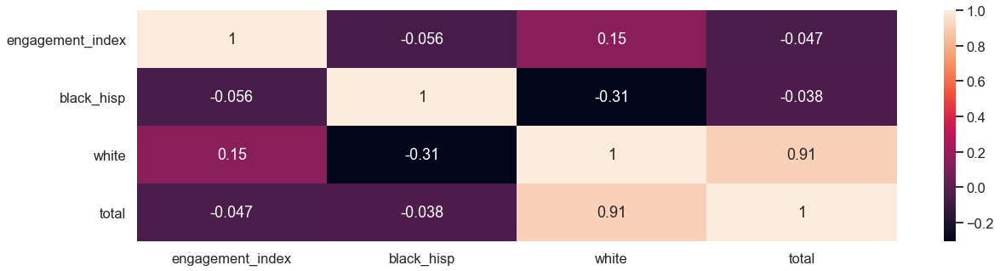

Statistic: Change in Education: Classes Cancelled


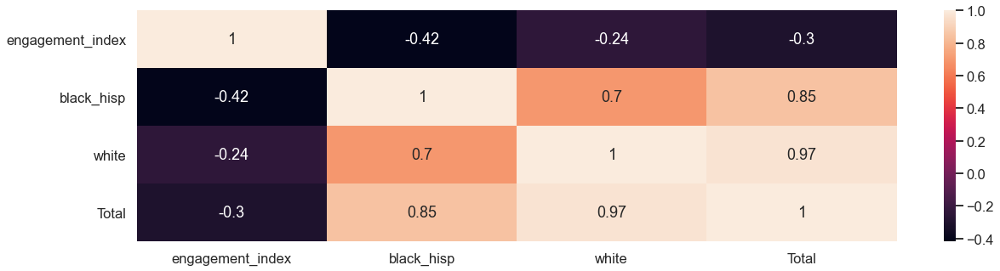

Statistic: Change in Education: Schools Open


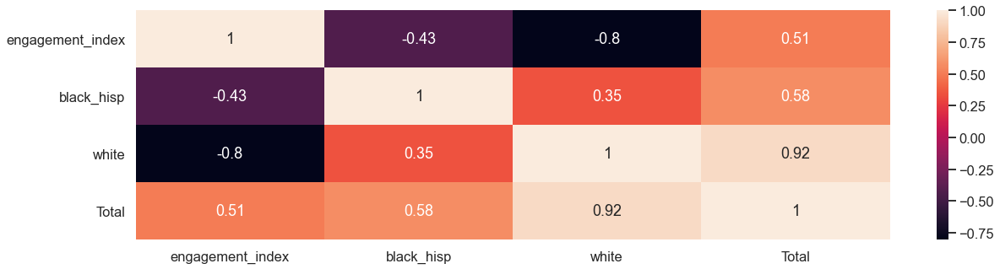

Statistic: Change in Education: Online Distance Learning


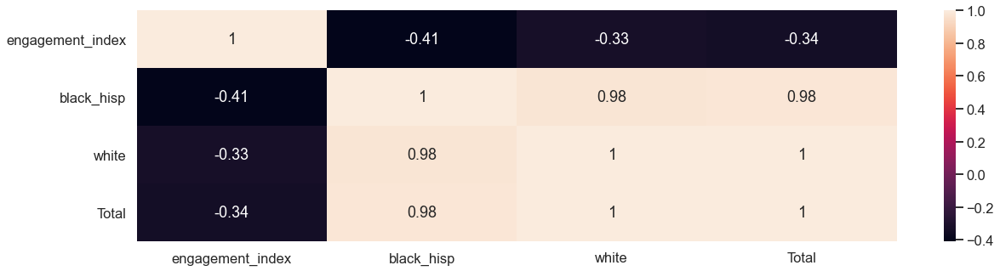

Statistic: Change in Education: Paper Distance Learning


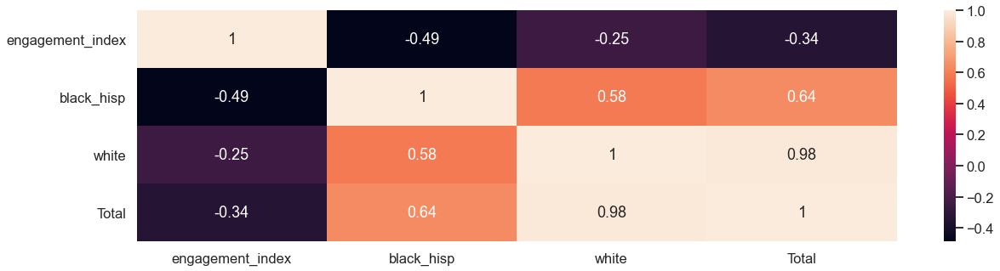

Statistic: Classes Change In Some Other Way


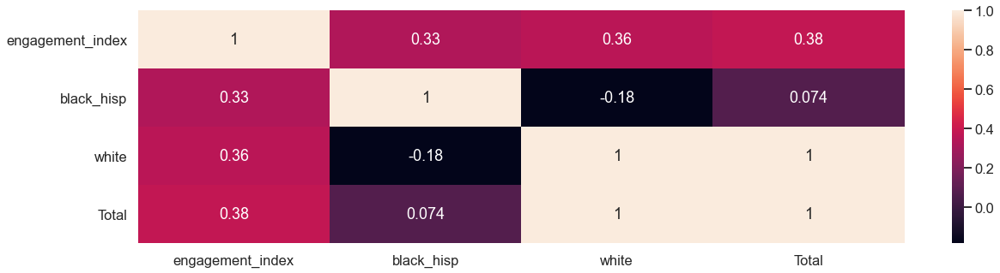

STATE: UT | DISTRICT 3710 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 15667
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


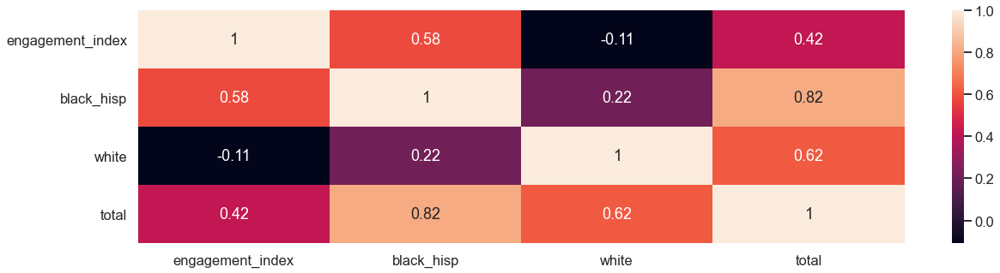

Statistic: Households With Lost Income Due To Pandemic


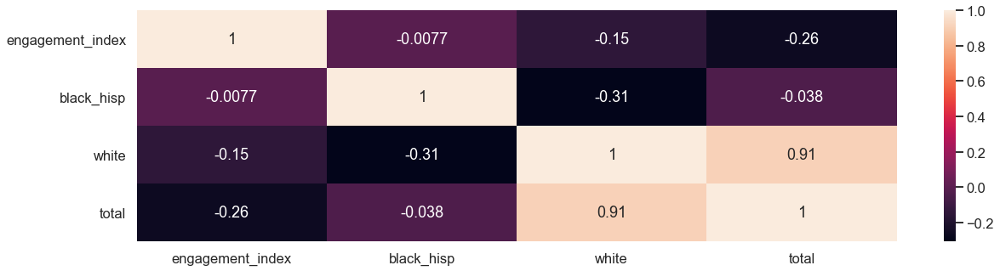

Statistic: Change in Education: Classes Cancelled


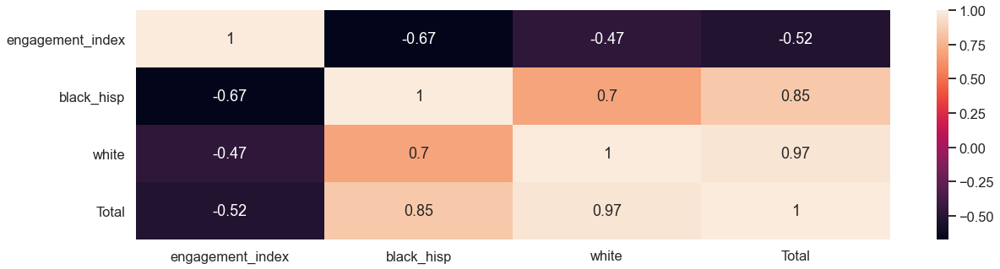

Statistic: Change in Education: Schools Open


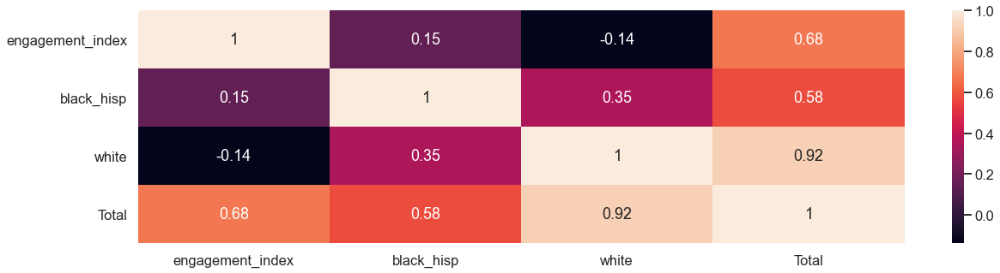

Statistic: Change in Education: Online Distance Learning


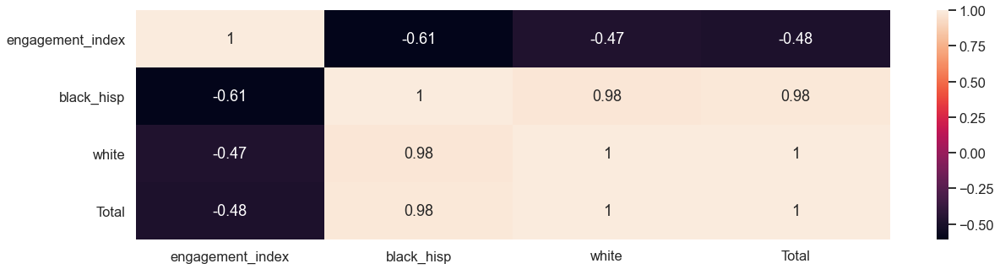

Statistic: Change in Education: Paper Distance Learning


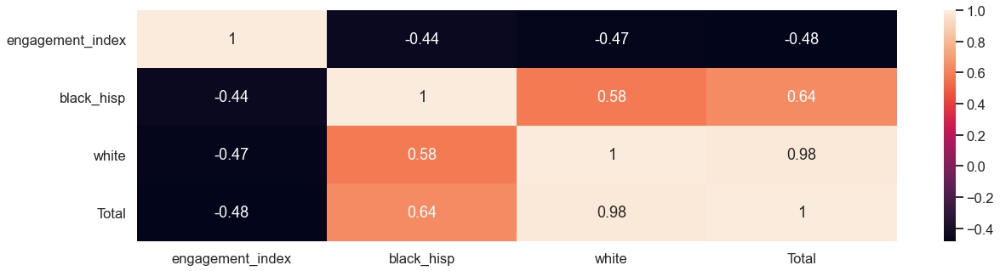

Statistic: Classes Change In Some Other Way


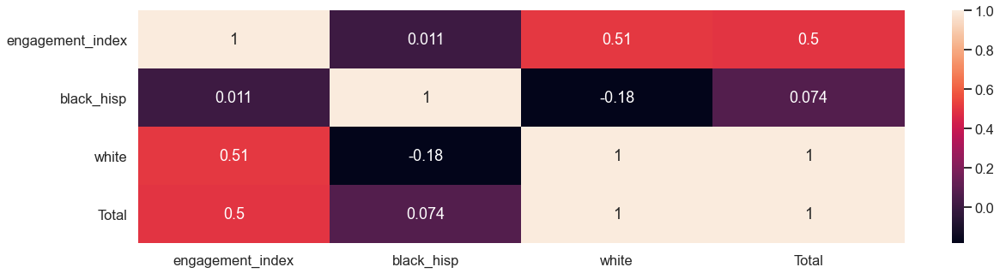

STATE: UT | DISTRICT 1204 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 15115
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


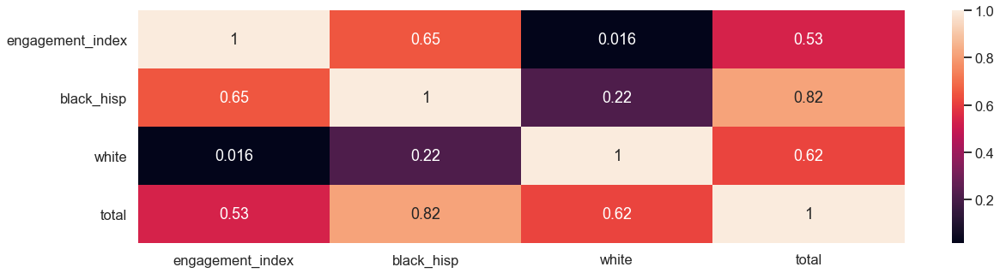

Statistic: Households With Lost Income Due To Pandemic


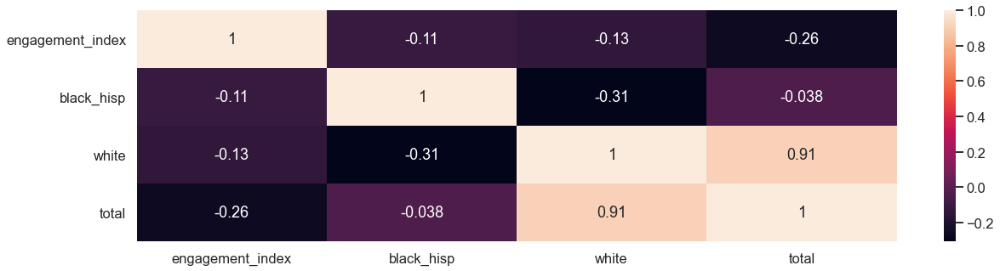

Statistic: Change in Education: Classes Cancelled


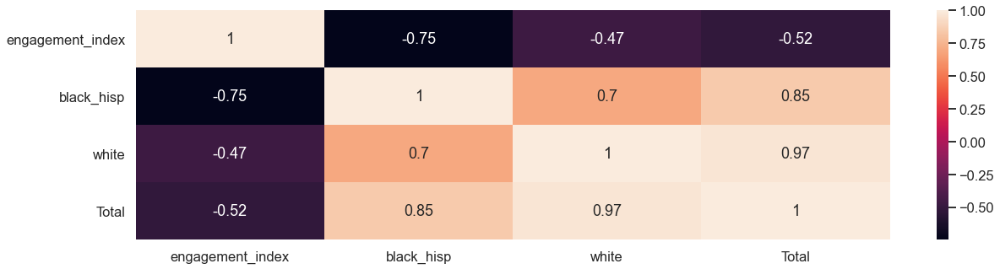

Statistic: Change in Education: Schools Open


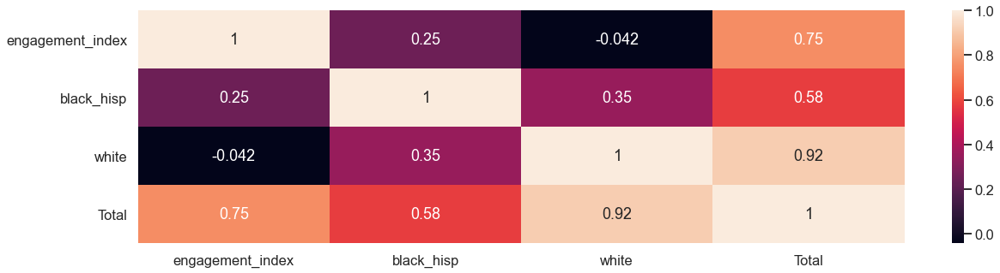

Statistic: Change in Education: Online Distance Learning


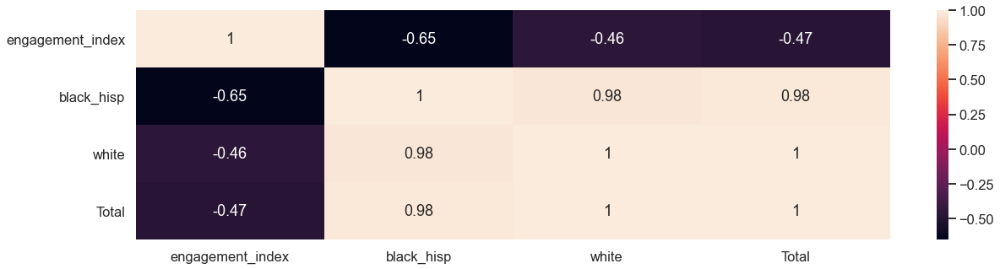

Statistic: Change in Education: Paper Distance Learning


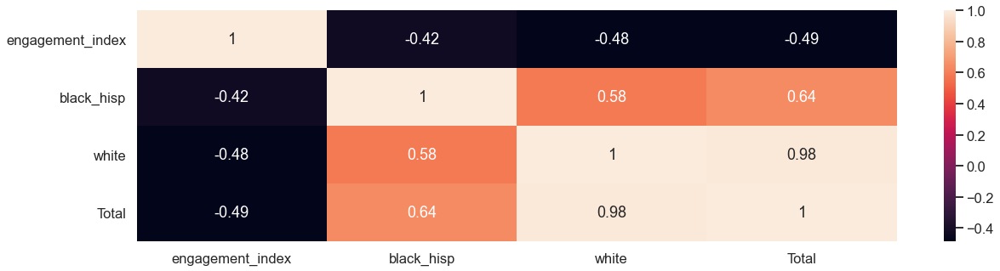

Statistic: Classes Change In Some Other Way


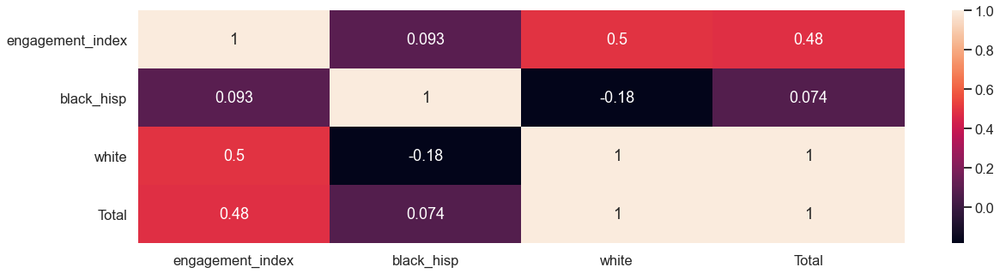

STATE: UT | DISTRICT 3772 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 11997
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


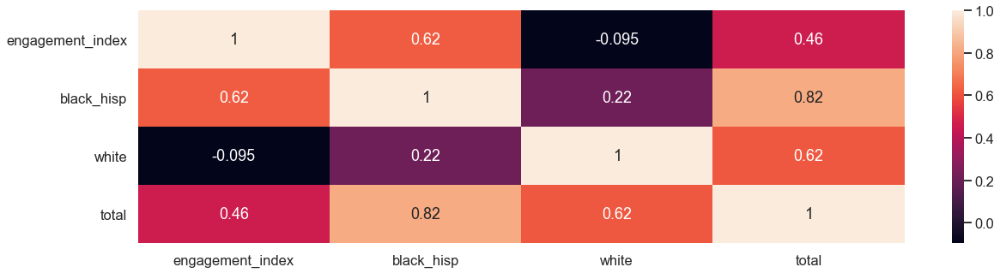

Statistic: Households With Lost Income Due To Pandemic


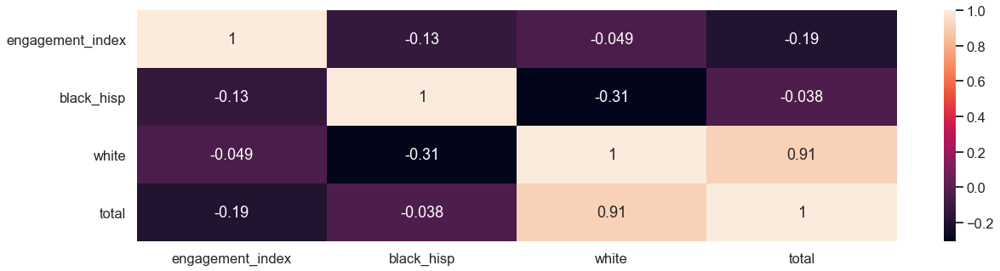

Statistic: Change in Education: Classes Cancelled


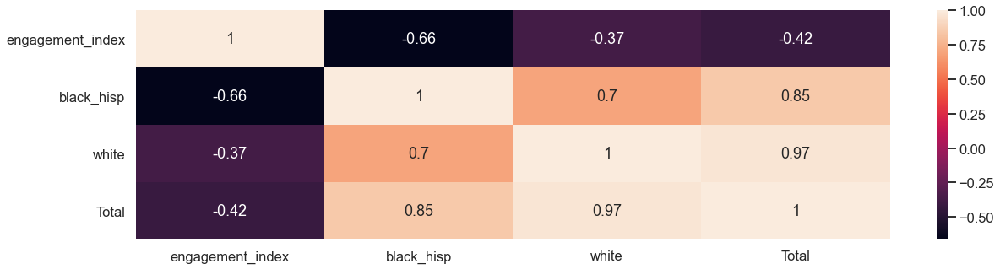

Statistic: Change in Education: Schools Open


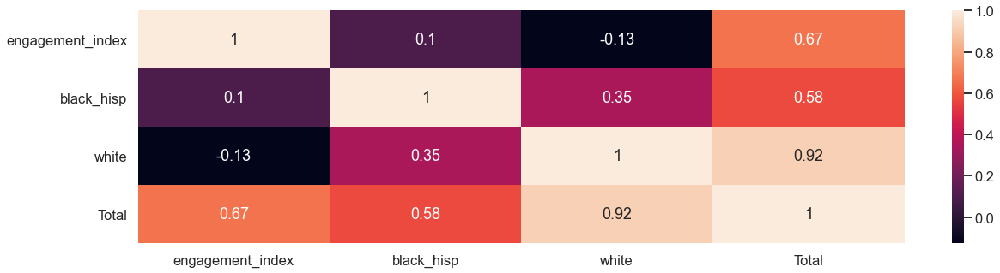

Statistic: Change in Education: Online Distance Learning


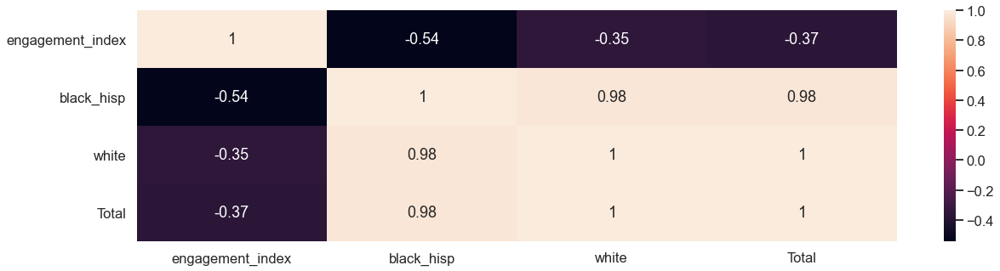

Statistic: Change in Education: Paper Distance Learning


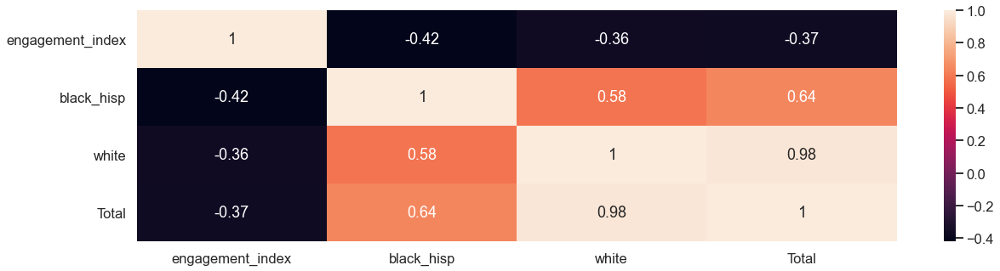

Statistic: Classes Change In Some Other Way


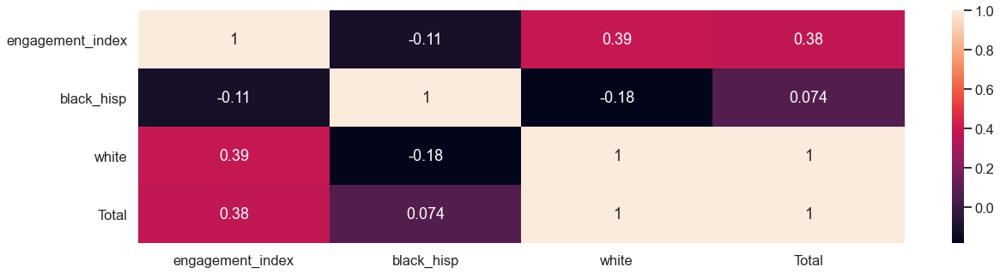

STATE: UT | DISTRICT 3864 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 11919
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


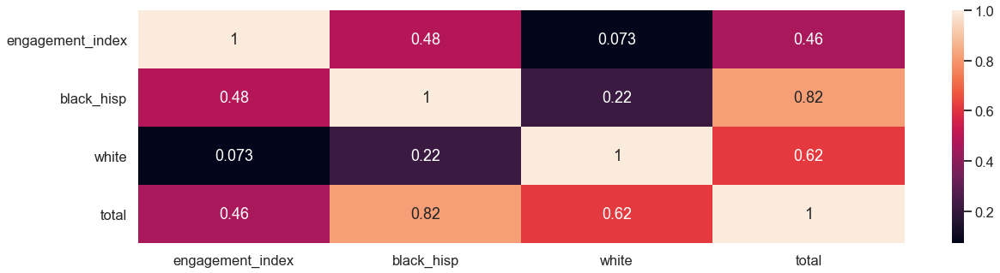

Statistic: Households With Lost Income Due To Pandemic


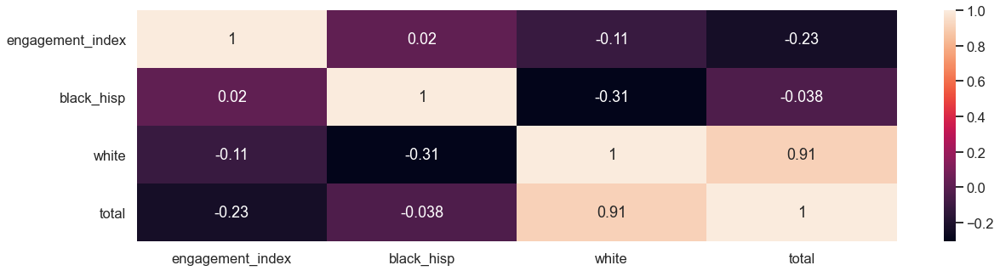

Statistic: Change in Education: Classes Cancelled


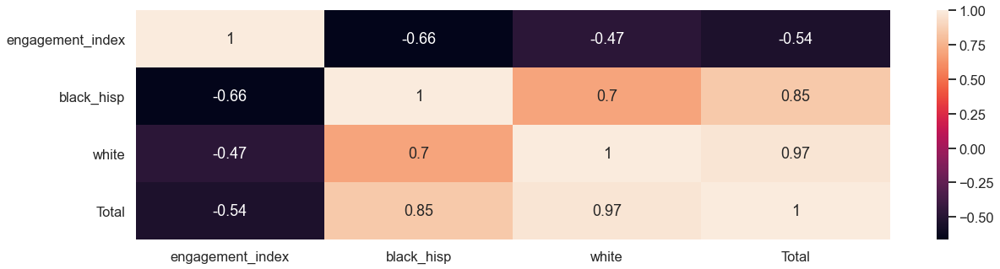

Statistic: Change in Education: Schools Open


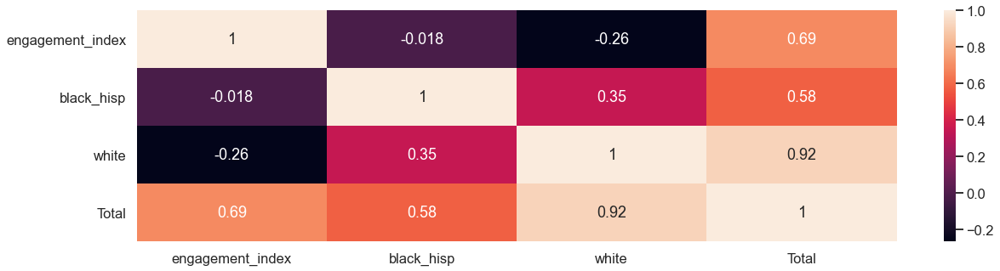

Statistic: Change in Education: Online Distance Learning


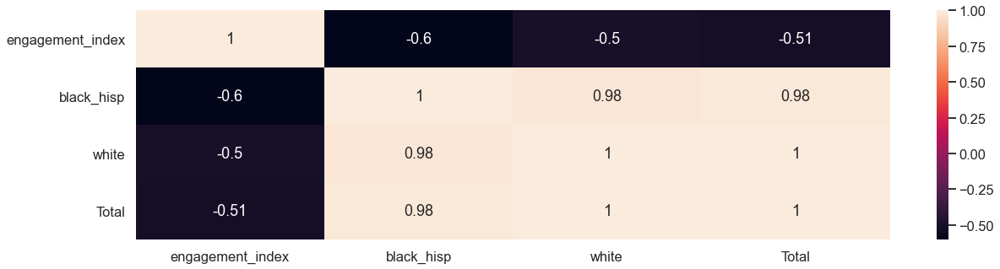

Statistic: Change in Education: Paper Distance Learning


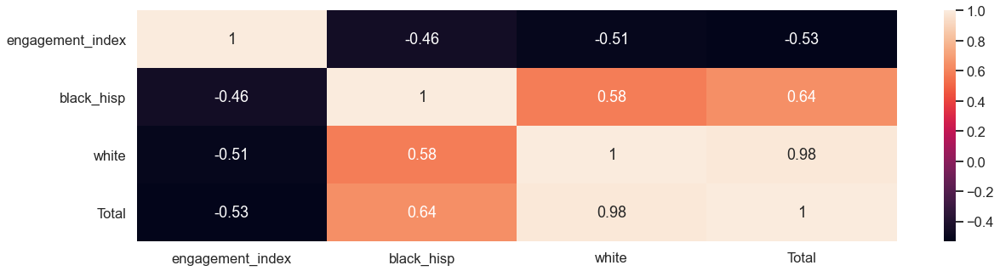

Statistic: Classes Change In Some Other Way


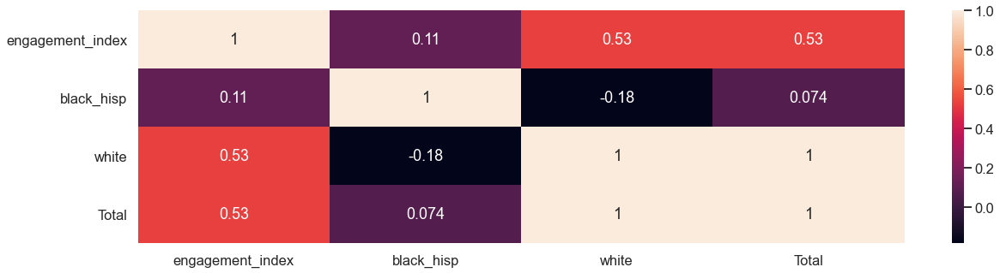

STATE: UT | DISTRICT 2165 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 8580
Black & Hispanic Students: 20% - 40%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $6000 - 8000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


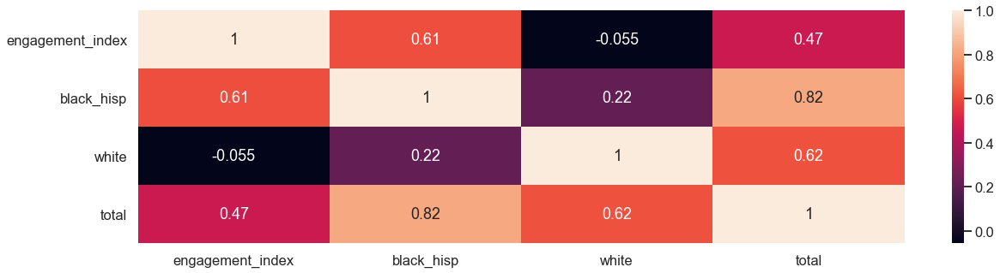

Statistic: Households With Lost Income Due To Pandemic


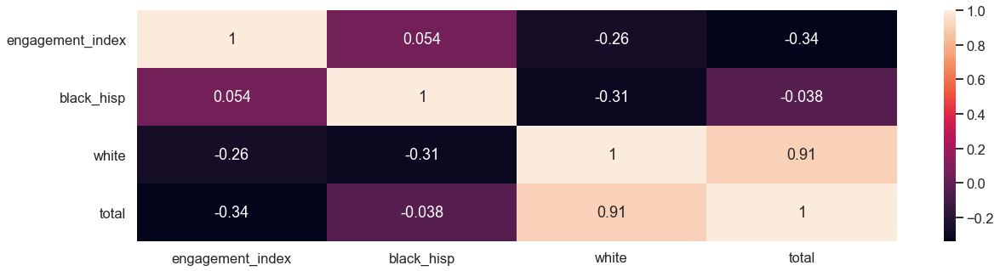

Statistic: Change in Education: Classes Cancelled


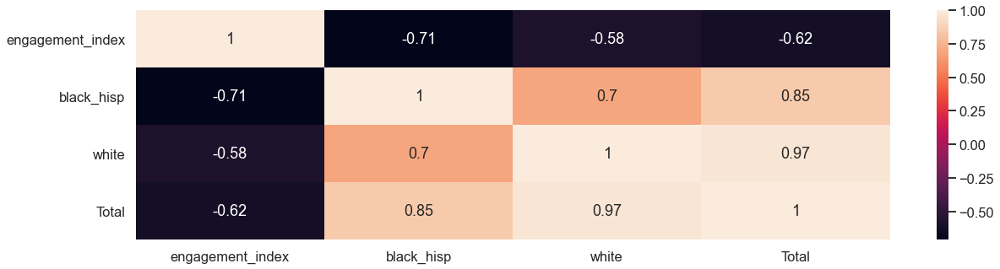

Statistic: Change in Education: Schools Open


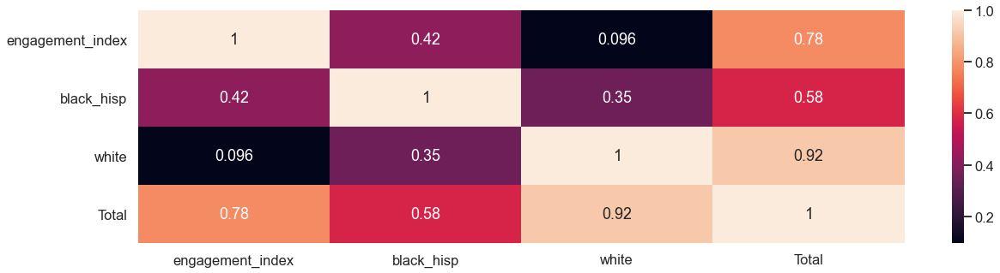

Statistic: Change in Education: Online Distance Learning


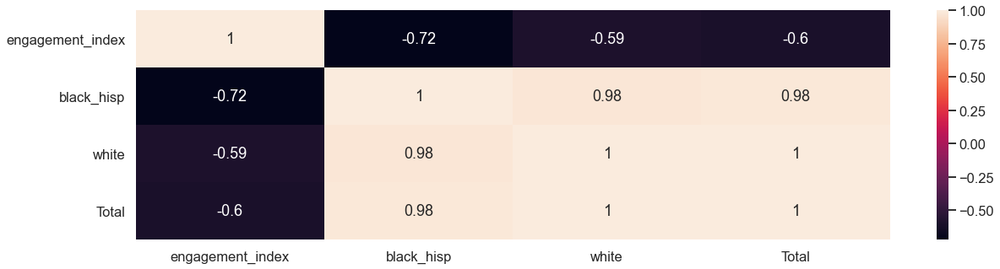

Statistic: Change in Education: Paper Distance Learning


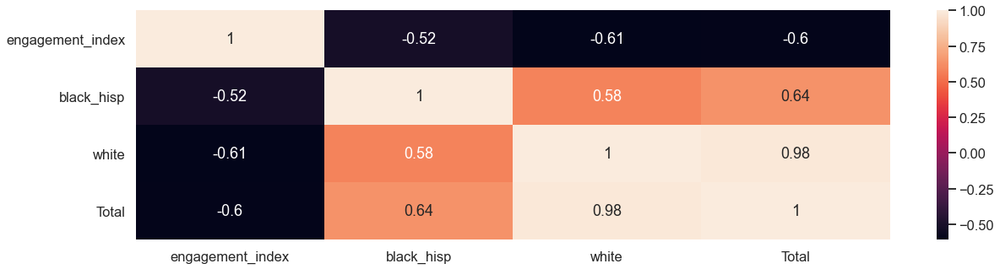

Statistic: Classes Change In Some Other Way


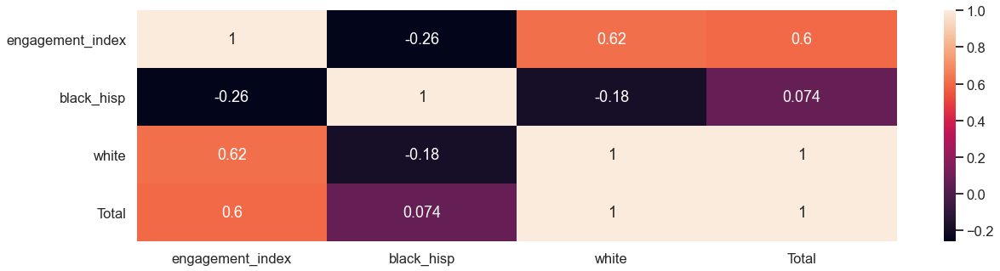

STATE: UT | DISTRICT 4183 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 7581
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 40% - 60%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: Town
          
Statistic: Household Access to Device & High Speed Connection


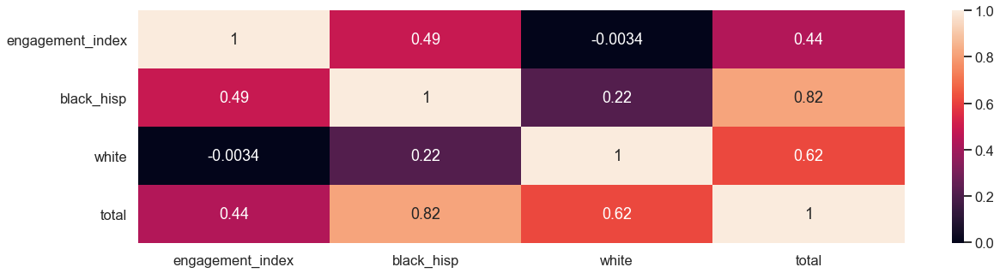

Statistic: Households With Lost Income Due To Pandemic


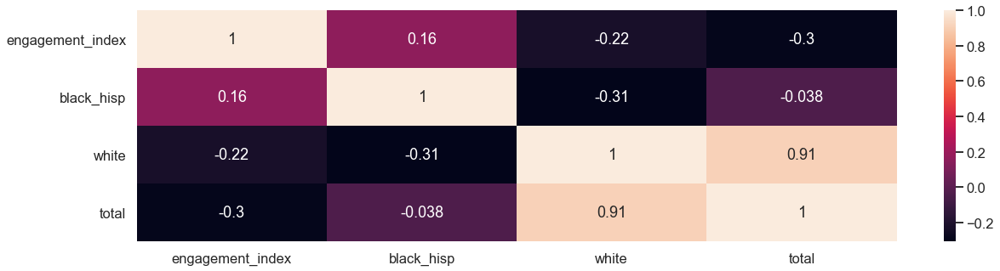

Statistic: Change in Education: Classes Cancelled


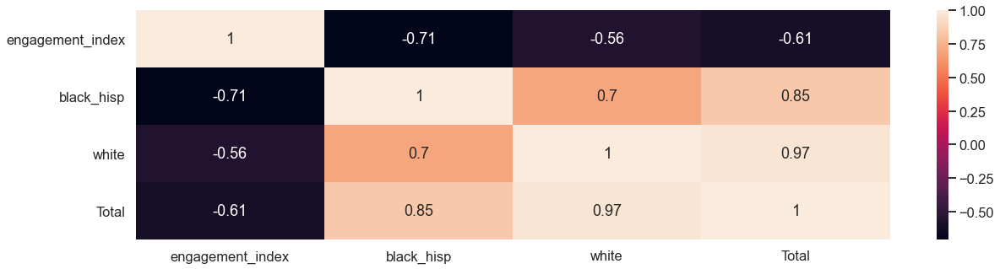

Statistic: Change in Education: Schools Open


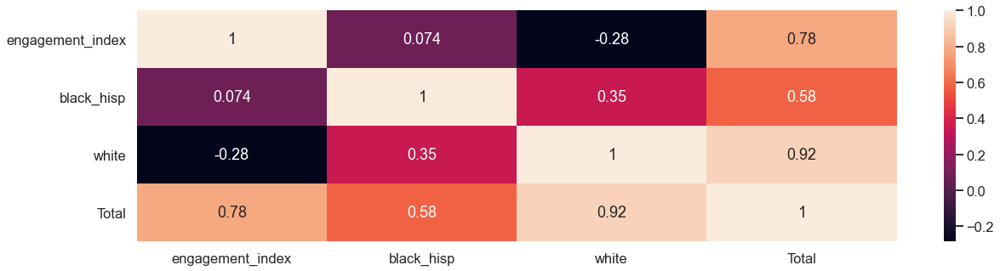

Statistic: Change in Education: Online Distance Learning


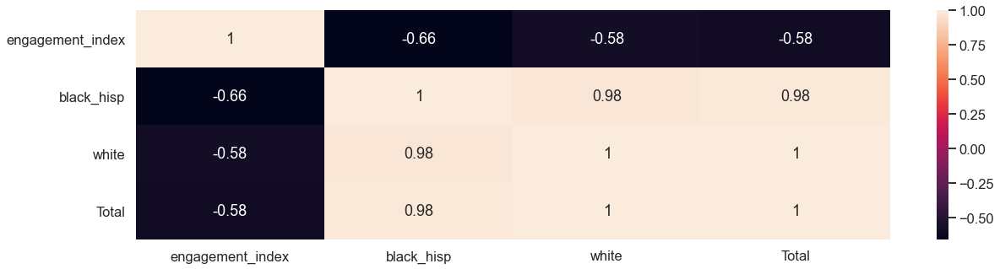

Statistic: Change in Education: Paper Distance Learning


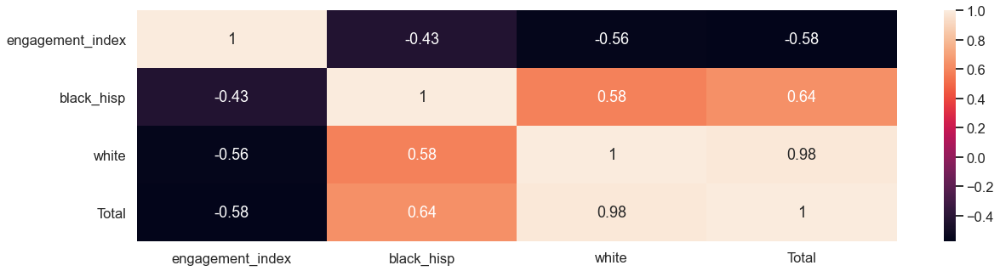

Statistic: Classes Change In Some Other Way


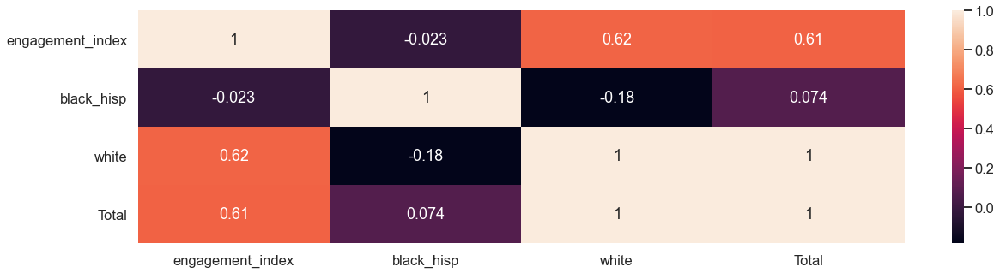

STATE: UT | DISTRICT 7308 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 6663
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 20% - 40%
Per Pupil Yearly Expenditure: $4000 - 6000
District Locale: Suburb
          
Statistic: Household Access to Device & High Speed Connection


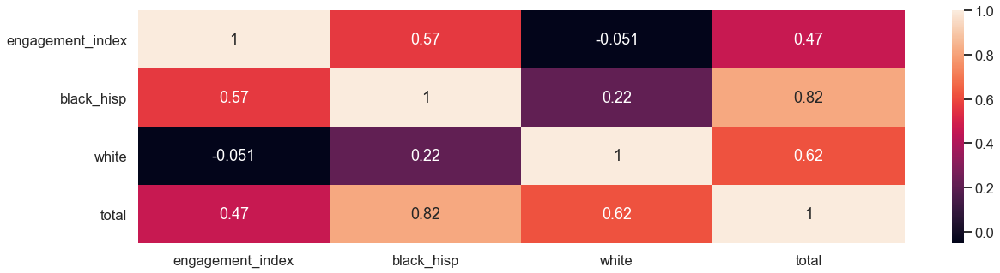

Statistic: Households With Lost Income Due To Pandemic


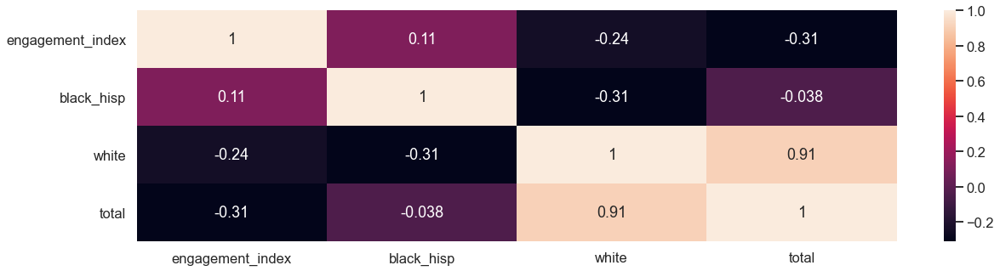

Statistic: Change in Education: Classes Cancelled


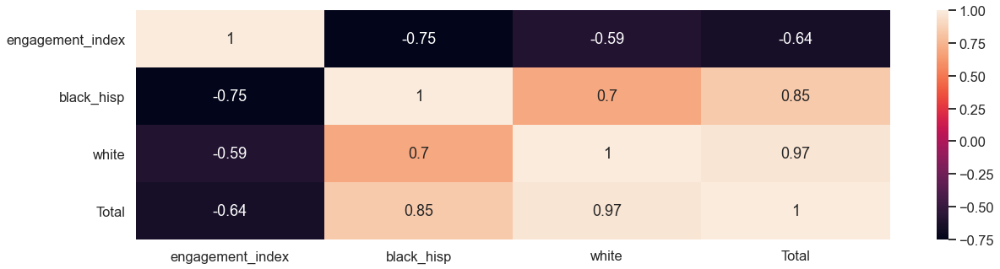

Statistic: Change in Education: Schools Open


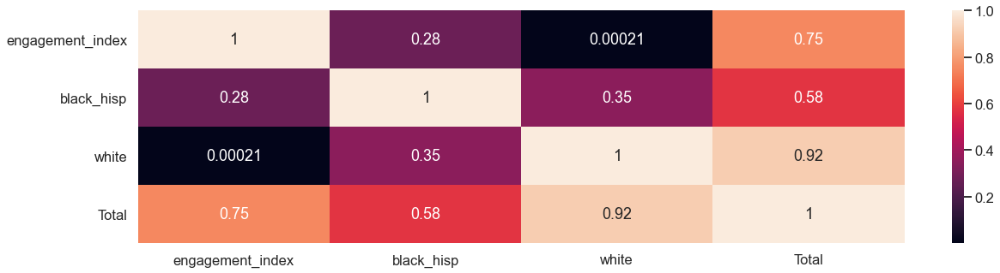

Statistic: Change in Education: Online Distance Learning


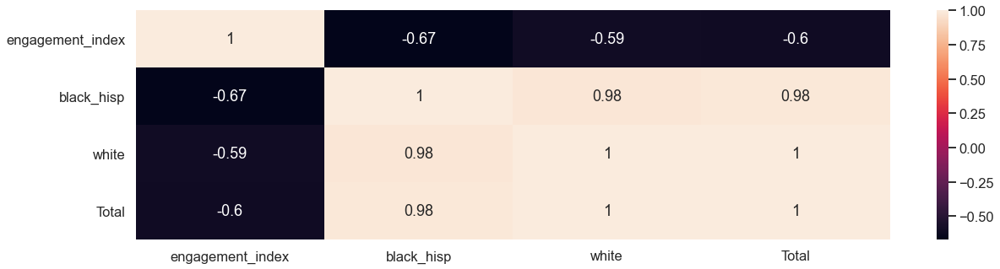

Statistic: Change in Education: Paper Distance Learning


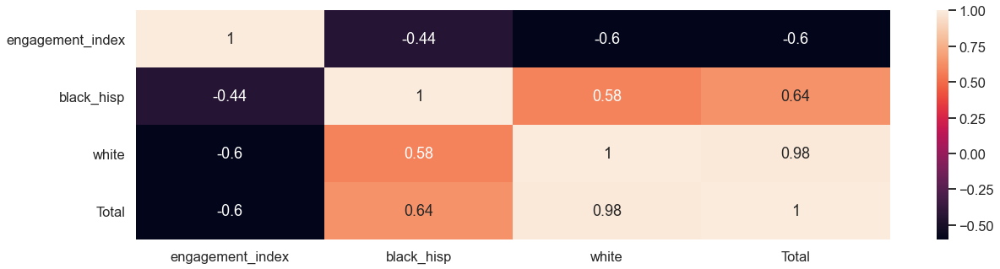

Statistic: Classes Change In Some Other Way


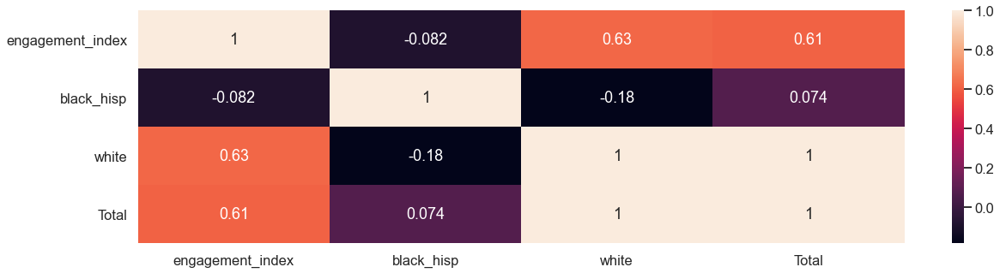

STATE: UT | DISTRICT 4373 DEMOGRAPHICS
Average Daily Page Loads Per 1000 Students: 4327
Black & Hispanic Students: 0 - 20%
Students With Free or Reduced Lunches: 0 - 20%
Per Pupil Yearly Expenditure: $8000 - 10000
District Locale: City
          
Statistic: Household Access to Device & High Speed Connection


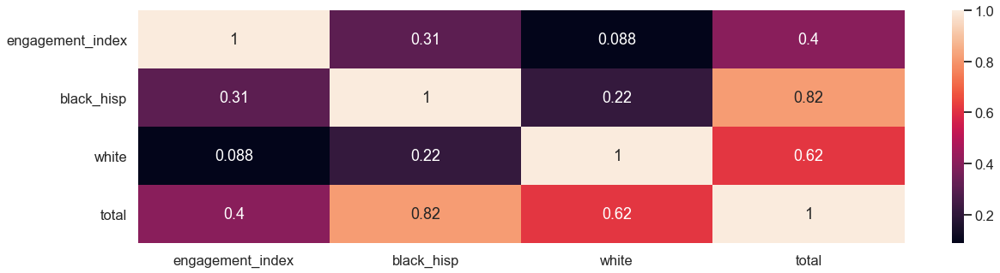

Statistic: Households With Lost Income Due To Pandemic


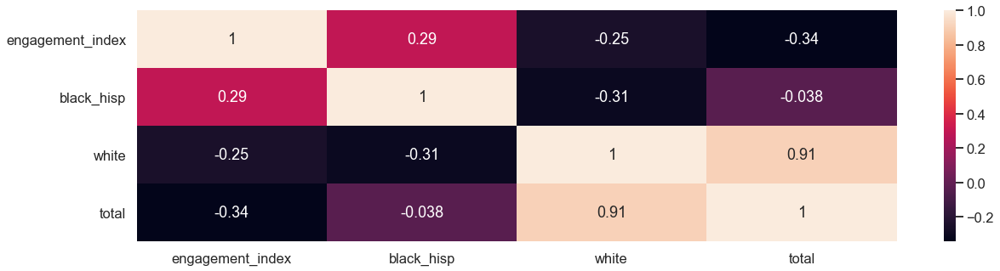

Statistic: Change in Education: Classes Cancelled


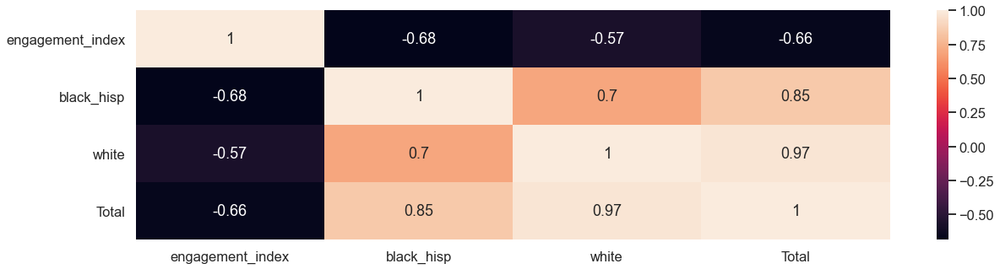

Statistic: Change in Education: Schools Open


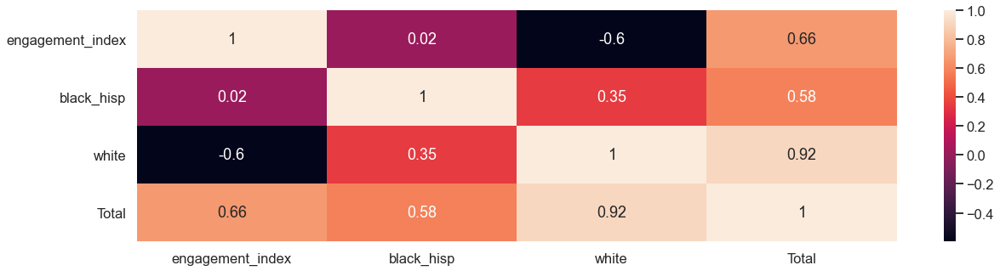

Statistic: Change in Education: Online Distance Learning


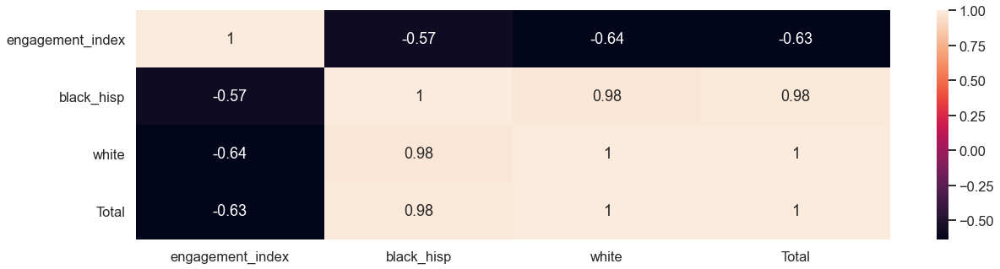

Statistic: Change in Education: Paper Distance Learning


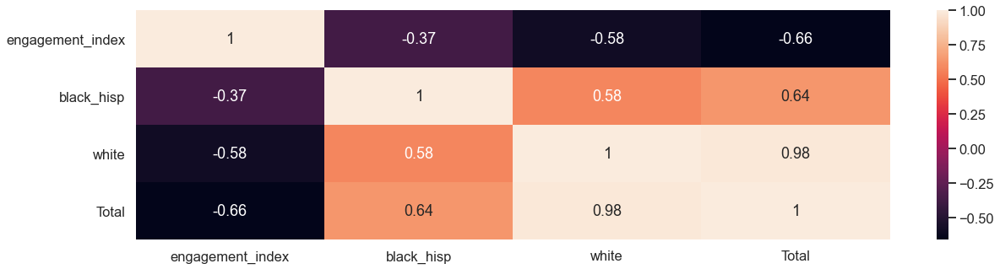

Statistic: Classes Change In Some Other Way


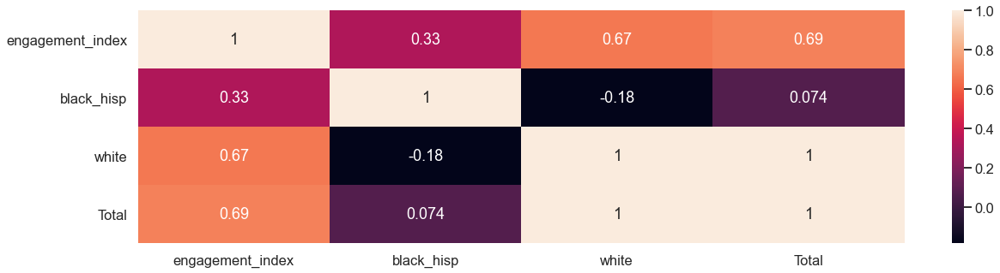

END UT CORRELATIONS
______________________________


In [216]:
#function to sort districts into a list in descending order by yearly avg. of daily engagement totals
def dist_sort(dframe):
    daysum = pd.DataFrame(dframe.groupby(['district_id', 'time']).engagement_index.sum())
    daysum = daysum.reset_index('district_id')
    distavg = pd.DataFrame(daysum.groupby([pd.Grouper (freq='Y'), 'district_id']).engagement_index.sum()/366)
    distavg = distavg.reset_index()
    distavg = distavg.drop('time', axis='columns')
    distavg = distavg.sort_values('engagement_index', ascending=False, ignore_index=True)
    x = distavg.district_id.tolist()
    y = distavg.engagement_index.tolist()
    return(x, y)



#code to create the state_level engagement data
state_corrlist = ['IL', 'NY', 'UT']
  
for state in state_corrlist:
    state_engage = engage_data[engage_data.POSTCODE == state]
    
    #get district list, sorted in descending order by daily avg. engagement for the year
    state_districts, dist_avg = dist_sort(state_engage)  
    state_daysum = pd.DataFrame(state_engage.groupby('time').engagement_index.sum())
    state_daysum = state_daysum.reset_index()
    
    #code to subset by state the Kids Count statistics for home computer and web availability, income loss, and change in education methods
    state_wd = wd_wide[wd_wide.POSTCODE == state]
    state_incloss = income_loss[income_loss.POSTCODE == state]
    state_cl_cancel = cl_cancel[cl_cancel.POSTCODE == state]
    state_cl_open = cl_open[cl_open.POSTCODE == state]
    state_cl_online = cl_online[cl_online.POSTCODE == state]
    state_cl_paper = cl_paper[cl_paper.POSTCODE == state]
    state_cl_other = cl_other[cl_other.POSTCODE == state]
    
    kcstats_list = [state_wd, state_incloss, state_cl_cancel, state_cl_open, state_cl_online, state_cl_paper, state_cl_other]
    kcstats_title = ['Household Access to Device & High Speed Connection', 
                     'Households With Lost Income Due To Pandemic', 
                     'Change in Education: Classes Cancelled', 
                     'Change in Education: Schools Open', 
                     'Change in Education: Online Distance Learning', 
                     'Change in Education: Paper Distance Learning', 
                     'Classes Change In Some Other Way']
    print('______________________________')
    print(state)
    print('                              ')
    i = 0
    for stat in kcstats_list: 
        engage_stat = state_daysum.merge(stat, how='left', left_on='time', right_on='start_range')
        engage_stat = engage_stat.drop(['start_range', 'POSTCODE'], axis='columns')
        engage_stat = engage_stat[engage_stat.time >='2020-04-23']   #the date on which Kids Count stats begin
        engage_stat = engage_stat.set_index('time')
        engage_stat = engage_stat.fillna(method='ffill', axis='rows')
        engage_stat = engage_stat.resample('W-THU').mean()        
        state_engage_corr = engage_stat.corr()        
        print('Statistic: '+ kcstats_title[i])
        g = sns.heatmap(state_engage_corr, annot=True)
        plt.show()
        i = i+1
        
    inc=0 # counter to subset district engagement values list
    #subset state engagement data by district, get demographics for each district as well. 
    for dist in state_districts:
        district_df = state_engage[state_engage.district_id==dist]  #subsets state_engage by district 
        dist_daysum = pd.DataFrame(district_df.groupby('time').engagement_index.sum())
        dist_daysum = dist_daysum.reset_index()
        dist_num = dist
    
         #these next five lines gather demographic values for the district from chosen_districts dataframe
        race_pct = chosen_districts.loc[chosen_districts.district_id==dist_num, 'pct_black_hisp'].iloc[0]
        free_lunch_pct = chosen_districts.loc[chosen_districts.district_id==dist_num, 'pct_freered_lunch'].iloc[0]
        per_pupil = chosen_districts.loc[chosen_districts.district_id==dist_num, 'ann_perpupil_exp'].iloc[0]
        locale = chosen_districts.loc[chosen_districts.district_id==dist_num, 'locale'].iloc[0]
        d_avg = int(dist_avg[inc])
        
        #Demographic info loop: prints title and any existing demographics for district
        print('\033[4mSTATE: ' + state + ' | DISTRICT '+ dist + ' DEMOGRAPHICS\033[0m')
        print('Average Daily Page Loads Per 1000 Students: '+ str(d_avg))
        inc = inc+1
        print('Black & Hispanic Students: '+ race_pct)
        print('Students With Free or Reduced Lunches: '+ free_lunch_pct)
       
        if pd.notnull(per_pupil)==True:
            print('Per Pupil Yearly Expenditure: $'+ per_pupil)
        else:
            print('Per Pupil Yearly Expenditure: Not Reported')

        print('District Locale: ' + locale)
        print('          ')
        #this code generates correlations and heatmaps for each statistic at the DISTRICT level.  
        j=0
        for stat in kcstats_list:       
            kcstat_engage = dist_daysum.merge(stat, how='left', left_on='time', right_on='start_range')
            kcstat_engage = kcstat_engage.drop(['start_range', 'POSTCODE'], axis='columns')
            kcstat_engage = kcstat_engage[kcstat_engage.time >='2020-04-23']
            kcstat_engage = kcstat_engage.set_index('time')
            kcstat_engage = kcstat_engage.fillna(method='ffill', axis='rows')
            kcstat_engage = kcstat_engage.resample('W-THU').mean()
            kcstat_corr = kcstat_engage.corr()
            print('Statistic: ' + kcstats_title[j])
            g=sns.heatmap(kcstat_corr, annot=True)
            plt.show()
            j = j+1
    print('END '+ state + ' CORRELATIONS')
    print('______________________________')



[Back To Top](#top)
<a id="corrobs"></a>

### Observations
#### State Level - Top 4 Highest Correlated Statistics  
- The heatmaps above depict correlations of weekly percentages for two ethnic groups and the total population (3 total values per week) with the weekly average page loads per 1000 students.  The highest correlation for a particular state or district is not consistently within the same ethnicity, as you can see below.  


- Illinois
  1. Classes Change in an unspecified way: 0.79 (White population) 
    - This statistic offers no clues to the change, except that it excludes the other ways that have been measured.  Speculation: one possibility could be a change in the computer applications used, but there is no way to verify this. 
  2. Web and Device Access: 0.72 (Total population)
  3. Classes Cancelled: -0.61 (Total population, negative correlation)
  4. Income Loss: -0.57 (Total population, negative correlation)  


- New York
  1. Schools Open:  0.79 (Total population)
  2. Web and Device Access: 0.67 (Black/Hispanic Population) 
  3. Classes Cancelled:  -0.54 (White population, negative corr.)
  4. Income Loss: -0.52(Black/Hispanic population, negative corr.)  


- Utah
  1. Schools Open: 0.79 (Total population)
  2. Classes Cancelled: -0.76 (Black/Hispanic population, negative corr.)
  3. Classes Changed to Online Distance Learning: -0.71 (Black/Hispanic population, negative corr.)
  4. Classes Change in an unspecified way: 0.63 (White population)  

These differences between states illustrate that each state has unique challenges regarding digital learning.  For example, in Illinois, the percent of total households with access to both a device and high speed internet is highly correlated with the engagement levels for the state, whereas in New York, the percent of Black/Hispanic households with access is more highly correlated with the state's engagement levels than either the white or total populations.  

In New York and Utah, the changing percent of the total population who attended class in school is highly correlated with changes in engagement levels, which suggests that most digital learning is done in school.  This is especially true in Utah: as the percent of households experiencing a change to online distance learning increases, engagement levels fall (the correlation is highest for Black/Hispanic households, at -0.71, but is also relatively high for the total population, at -0.61).  

Classes Cancelled has a high negative correlation to engagement levels in all three states, and this is understandable, since no engagement is occurring during those periods.   


As might be expected, individual districts have unique correlations with these statistics, influenced by their demographics; however, some interesting trends can be seen across all districts in all states. 

- Device & High Speed Access: This statistic is highly correlated in districts with higher overall engagement levels, and becomes less so as engagement levels decline.  

- Classes cancelled has a consistent, relatively high negative correlation to engagement levels, and Schools Open has a consistently positive correlation.  These correlations are more extreme in districts with weaker correlations for access to both a device and high speed connection.  

- Income Loss is a consistently mild negative correlation, with the highest values around -0.50 ± .10. I would've expected a stronger negative correlation with engagement levels than the evidence reveals.   

- Online Distance Learning: the most surprising discovery in the Kids Count statistics is the strong negative correlation between the percent of households experiencing a change to online distance learning and engagement levels.  In Illinois, for example, 10 of 18 districts have correlations above -0.50, in a state where there is a very strong <i>positive</i> correlation between engagement levels and device and web access for most districts.  Across most districts, when classes switch to online, engagement levels fall.  

[Back To Top](#top)
<a id="conclusions"></a>

---
# <span style='color:green'>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</span>
---

## <span style='color:green'><u>PART 3: CONCLUSIONS</u></span>

1. School preparedness


   - The plots of the engagement data for 53 school districts in Illinois, New York, and Utah all share one crucial similarity: prior to the pandemic, which caused school closures in early March 2020, <b>all districts have relatively low engagement levels.</b>  As 2020 progressed, each district responded to the challenges of moving education into an online environment with varying degrees of success, but across the board, engagement levels are quite low in January and February 2020 for most districts.  


   - Examining Arizona's top five most used apps for each month provides a direction for additional investigation: early in the year, Arizona's top five apps were devoted to aspects of the curriculum--English Language Arts, Math, etc. Almost immediately after the pandemic arrived, applications for coordinating real-time meetings in virtual environments entered the top five, and remained for the rest of the year, although it seems that Arizona was experimenting with different virtual platforms throughout the remainder of the year.


   - Now that all of the data is thoroughly prepared, I will be exploring the top 10 apps in use throughout the year for Illinois, New York, and Utah in Tableau. 


2. Ethnicity and economic hardship


   - The plots, which are correlated with district demographics, reveal a generally strong negative correspondence between the percentage of Black/Hispanic students and district engagement levels.  As this percentage rises, engagemenet levels tend to decrease.  


   - Similarly, as the percentage of students receiving free or reduced lunches increases, engagement levels tend to fall, in spite of often higher amounts of per pupil spending in districts with higher percentages of free and reduced lunches.  


   - The Kids Count statistics reveal that even in states like Utah, in which most districts have 20% or less Black/Hispanic students, the engagement levels are more highly correlated with fluctuations in web and device access for Black/Hispanic households in the state.  A closer look at the web and device access statistic for Utah reveals that throughout 2020, Black/Hispanic household access to both a device and a high speed connection varies from 72% to 92%, whereas the white population's access varies from just 88% to 92%--so the more extreme fluctuation for Black/Hispanic housholds is more highly correlated with fluctuations in engagement levels in Utah.  <b>These kinds of insights will be further explored in Tableau</b>  
   

   - Per Pupil Spending is generally positively correlated with engagement levels, although each state must be considered on its own.  Illinois, for example, spends far less than New York, but has higher engagement levels for the majority of its districts.  New York spends the most of the three states, but the district with highest per pupil spending in the country is in New York, and that spending is not reflected in its engagement levels.  Still, within each state, higher per pupil spending is correlated with higher engagement levels.  


Python has proved to be an efficient way to prepare data from disparate sources for analysis, and to do some in-depth exploration and gain valuable insights into the data that suggests avenues for continued analysis. Now that the data has been thoroughly prepared, it will be easy to use it in a visualization program like Tableau to flesh out the discoveries I have already made.  

---
# <b>✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥  ✥</b>
---
[Back To Top](#top)

### Exporting the data to `.csv`

    #engage_data.head(3)

    #engage_data.dtypes

    engage_data.lp_id = engage_data.lp_id.astype(int)
    engage_data.lp_id = engage_data.lp_id.astype(str)

    #engage_data.to_csv('ilnyut_engage.csv', index=False)

    income_loss.head(3)

    income_loss['stat'] = 'lost income'

    income_loss = income_loss[income_loss.POSTCODE.isin(['IL', 'NY', 'UT'])]

    income_loss.POSTCODE.unique()

    income_loss.to_csv('lost_income.csv', index=False)

    wd_wide['stat'] = 'device and high speed access'

    cl_cancel['stat'] = 'classes canceled'

    cl_online['stat'] = 'online distance learning'

    cl_paper['stat'] = 'paper distance learning'

    cl_open['stat'] = 'schools open'

    cl_other['stat'] = 'other change'

    wd_wide = wd_wide[wd_wide.POSTCODE.isin(['IL', 'NY', 'UT'])]

    wd_wide.head(3)

    wd_wide.POSTCODE.unique()

    wd_wide.to_csv('device_and_hispeed.csv', index=False)

    cl_cancel = cl_cancel[cl_cancel.POSTCODE.isin(['IL', 'NY', 'UT'])]

    cl_cancel.POSTCODE.unique()

    cl_cancel.to_csv('class_canceled.csv', index=False)

    cl_online.shape

    cl_online = cl_online[cl_online.POSTCODE.isin(['IL', 'NY', 'UT'])]

    cl_online.to_csv('class_online.csv', index=False)

    cl_paper.POSTCODE.unique()

    cl_paper = cl_paper[cl_paper.POSTCODE.isin(['IL', 'NY', 'UT'])]

    cl_paper.to_csv('class_onpaper.csv', index=False)

    cl_open.head(3)

    cl_open = cl_open[cl_open.POSTCODE.isin(['IL', 'NY', 'UT'])]

    cl_open.to_csv('schools_open.csv', index=False)

    cl_other.shape

    cl_other = cl_other[cl_other.POSTCODE.isin(['IL', 'NY', 'UT'])]

    cl_other.to_csv('class_other.csv', index=False)

In [242]:
#state_c19_dates.head(3)

In [243]:
#state_c19_dates = state_c19_dates.reset_index()

In [244]:
#state_c19_dates = state_c19_dates.drop('index', axis='columns')

In [245]:
#income_loss = income_loss.rename_axis(None, axis=1)
#state_c19_dates = state_c19_dates.rename_axis(None, axis=1)

In [246]:
#state_c19_dates.to_csv('state_covid_dates.csv', index=False)

In [247]:
#pcode_state.head(3)

In [248]:
#pcode_state.to_csv('pc_state.csv', index=False)

In [249]:
#lp_products.head(3)

In [250]:
#lp_products.dtypes

In [251]:
#lp_products.lp_id = lp_products.lp_id.astype(str)

In [252]:
#lp_products.to_csv('products.csv', index=False)

In [253]:
#lp_product_cats.head(3)

In [254]:
#lp_product_cats.dtypes

In [255]:
#lp_product_cats.lp_id = lp_product_cats.lp_id.astype(str)

In [256]:
#lp_product_cats.to_csv('short_products.csv', index=False)

In [21]:
ilnyut_engage = pd.read_csv('ilnyut_engage.csv', parse_dates=['time'])

In [5]:
ilnyut_engage.shape

(3941357, 6)

In [6]:
ilnyut_engage.POSTCODE.unique()

array(['IL', 'NY', 'UT'], dtype=object)

In [22]:
ilnyut_resample = ilnyut_engage[ilnyut_engage.time >= '2020-04-23']

In [28]:
ilnyut_resample.head()

engagement_index  district_id
POSTCODE district_id time                                     
IL       1052        2020-04-23        371.651034       1052.0
                     2020-04-30        291.370556       1052.0
                     2020-05-07        248.418900       1052.0
                     2020-05-14        278.738506       1052.0
                     2020-05-21        210.778881       1052.0

In [36]:
ilnyut_resample.dtypes

POSTCODE                    object
district_id                  int64
time                datetime64[ns]
engagement_index           float64
dtype: object

In [25]:
ilnyut_resample = ilnyut_resample.set_index('time')

In [26]:
ilnyut_resample = ilnyut_resample.groupby(['POSTCODE', 'district_id']).resample('W-THU').mean()

In [27]:
ilnyut_resample = ilnyut_resample.drop('pct_access', axis='columns')

In [35]:
ilnyut_resample.head(3)

,POSTCODE,district_id,time,engagement_index
0,IL,1052,2020-04-23,371.651034
1,IL,1052,2020-04-30,291.370556
2,IL,1052,2020-05-07,248.418900


In [32]:
ilnyut_resample = ilnyut_resample.drop('district_id', axis='columns')

In [34]:
ilnyut_resample = ilnyut_resample.reset_index()

In [37]:
ilnyut_resample.to_csv('ilnyut_resample.csv', index=False)

[Back To Top](#top)